<a href="https://colab.research.google.com/github/KangGao1997/NeuroAI_project/blob/main/infant_act_2_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from keras.models import Sequential
from keras.layers import Dense
import pandas as pd
import numpy as np
import keras
from sklearn.model_selection import train_test_split
import tensorflow as tf
from keras.utils import plot_model
from sklearn.metrics import mean_squared_error
keras.utils.set_random_seed(42)
np.random.seed(42)


data = pd.read_csv("Sit_vs_rest.csv")
data = data.to_numpy()

train_data_, test_data, train_label_, test_label = train_test_split(
    data[:, :75], data[:, -1], test_size=0.2, random_state=42
)

train_data_.shape, test_data.shape, train_label_.shape, test_label.shape

## 4 Layer

### 1-D AE (4 Layers)

#### 12 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


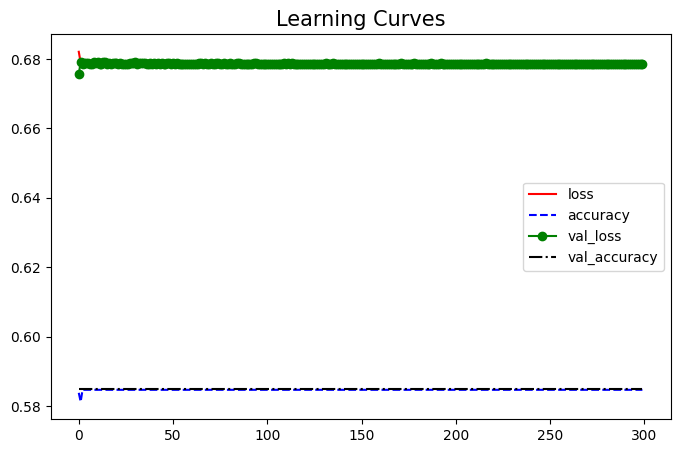

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


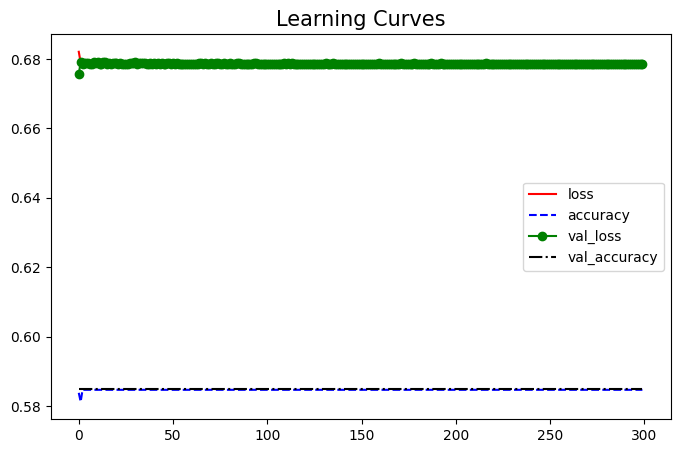

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


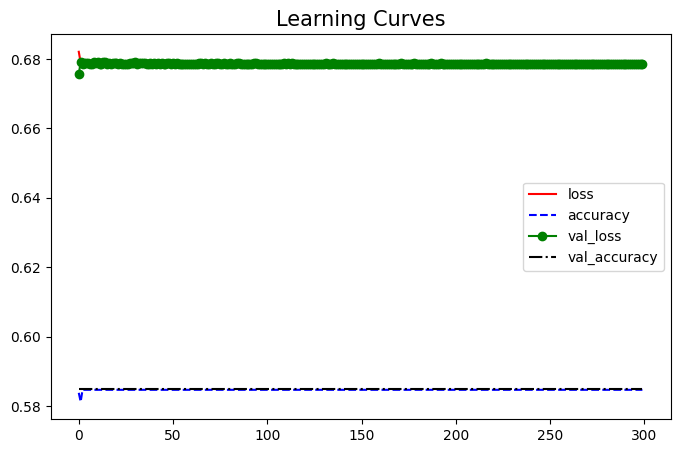

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


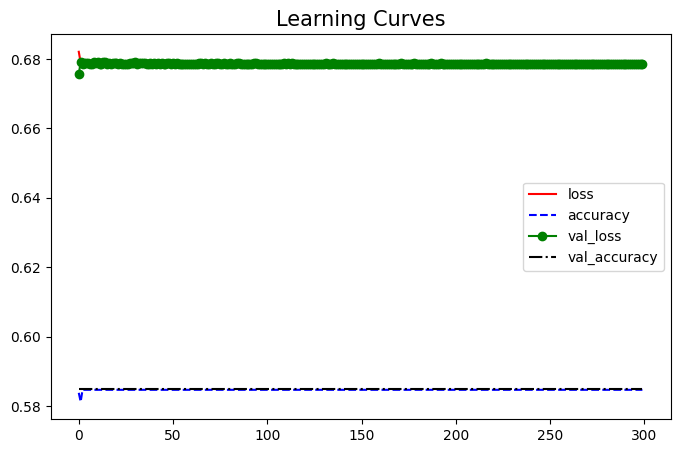

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


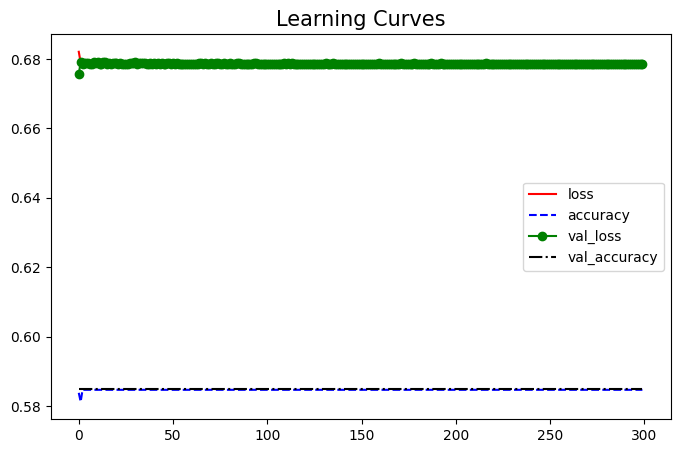

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


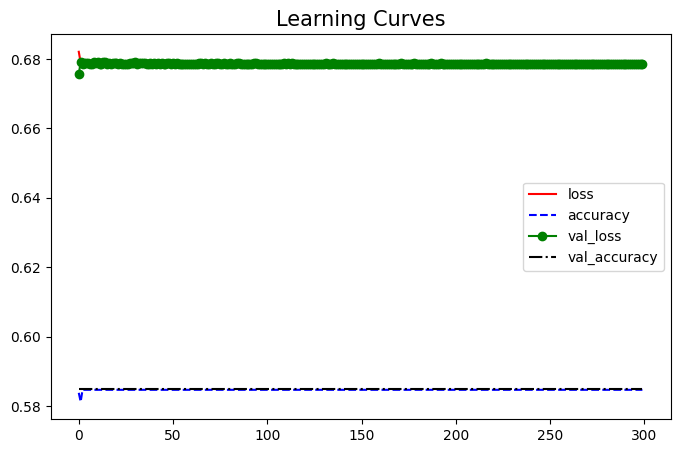

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


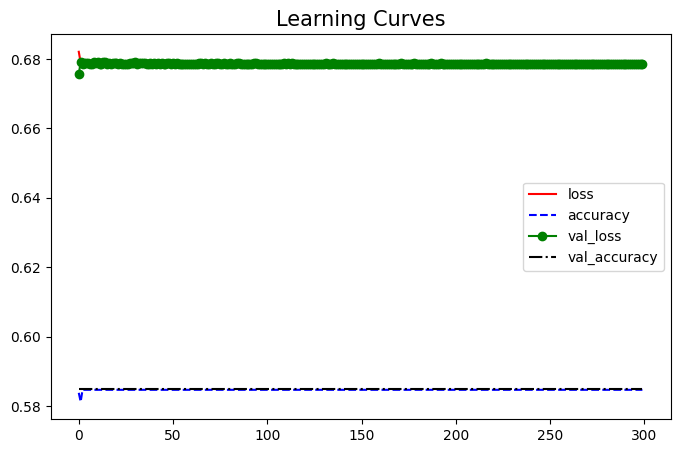

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


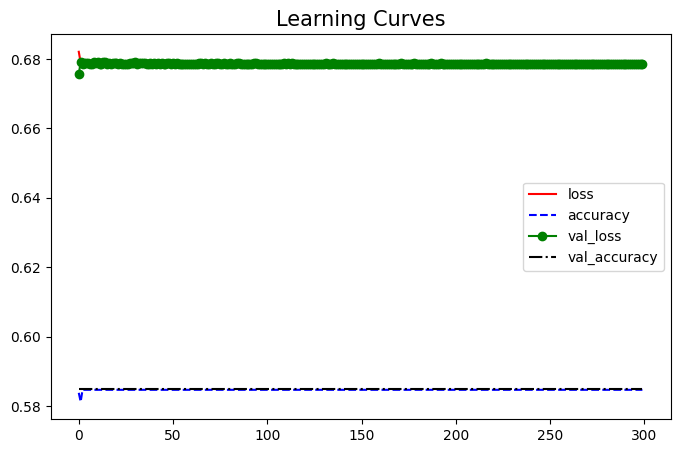

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


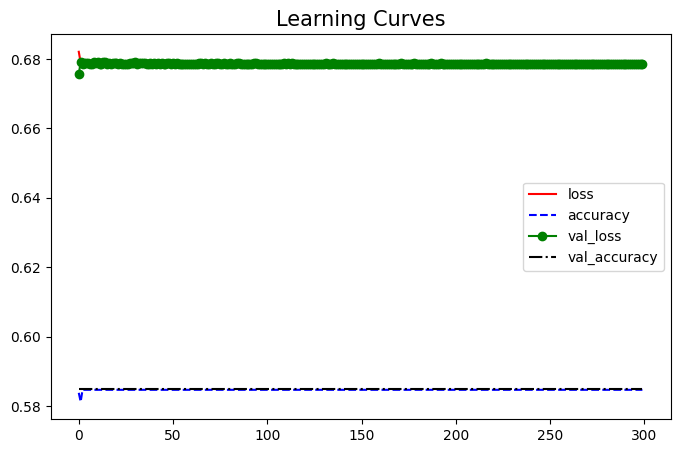

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


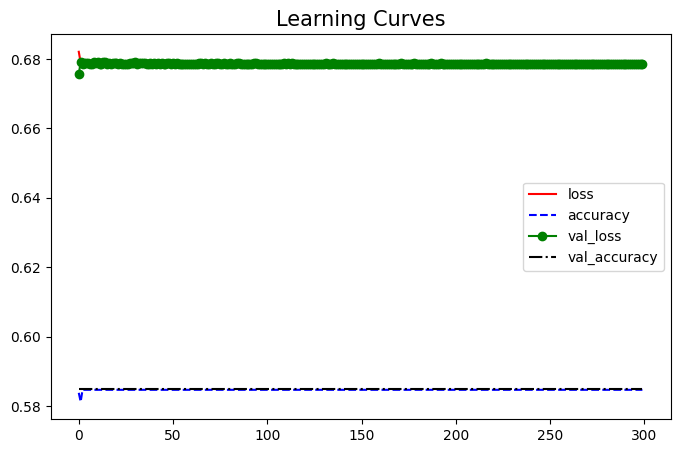

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


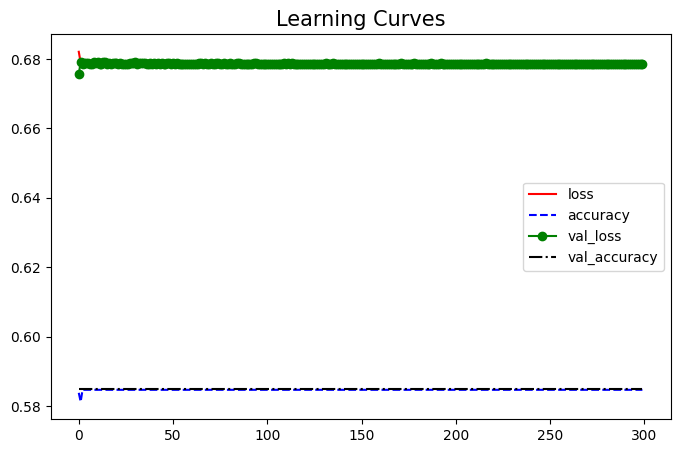

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 2-D AE (4 Layers)

#### 12 Layers Decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_48 (Dense)            (None, 60)                4560      
                                                                 
 dense_49 (Dense)            (None, 30)                1830      
                                                                 
 dense_50 (Dense)            (None, 15)                465       
                                                                 
 dense_51 (Dense)            (None, 2)                 32        
                                                                 
 dense_52 (Dense)            (None, 10)                30        
                                                                 
 dense_53 (Dense)            (None, 20)                220       
                                                                 
 dense_54 (Dense)            (None, 40)              

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 4s 6ms/step - loss: 0.6811 - accuracy: 0.5844 - val_loss: 0.6722 - val_accuracy: 0.5975
Epoch 2/300
349/349 [==============================] - 2s 5ms/step - loss: 0.6773 - accuracy: 0.5838 - val_loss: 0.6787 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 3s 8ms/step - loss: 0.6720 - accuracy: 0.5870 - val_loss: 0.6738 - val_accuracy: 0.5505
Epoch 4/300
349/349 [==============================] - 2s 5ms/step - loss: 0.6709 - accuracy: 0.5801 - val_loss: 0.6687 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 2s 5ms/step - loss: 0.6642 - accuracy: 0.5985 - val_loss: 0.6511 - val_accuracy: 0.6273
Epoch 6/300
349/349 [==============================] - 2s 5ms/step - loss: 0.6566 - accuracy: 0.6139 - val_loss: 0.6526 - val_accuracy: 0.6502
Epoch 7/300
349/349 [==============================] - 2s 5ms/step - loss: 0.6506 - accuracy: 0.6312 - val_loss: 0.6564 - val_accuracy: 0.6365

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 2ms/step
The accuracy on testing dataset:  0.8330275229357799


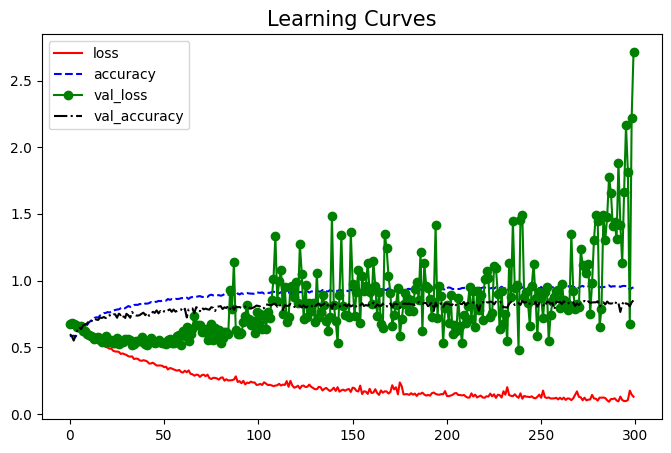

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


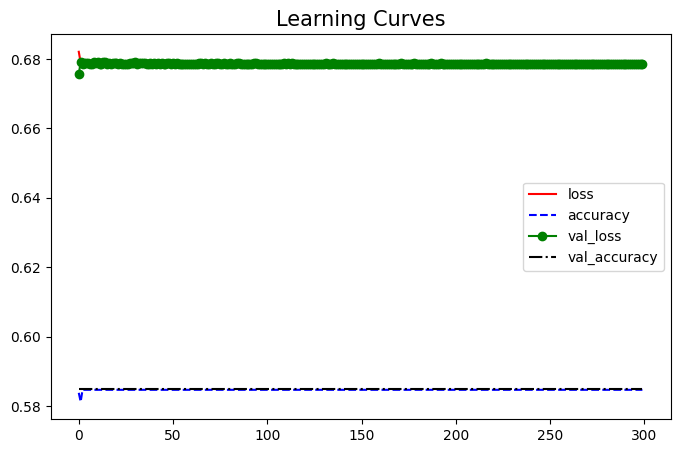

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


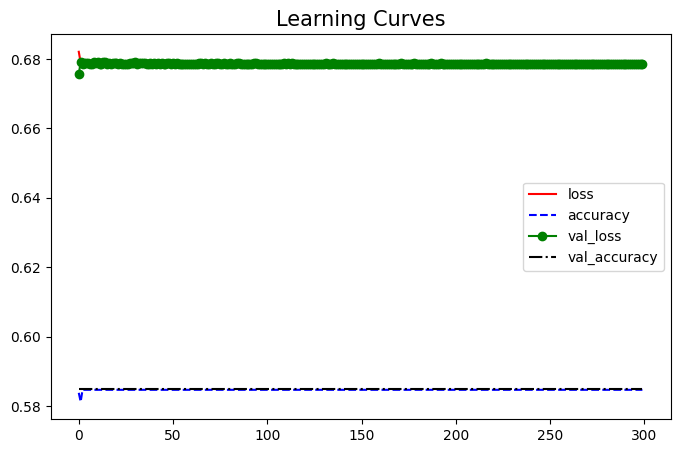

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


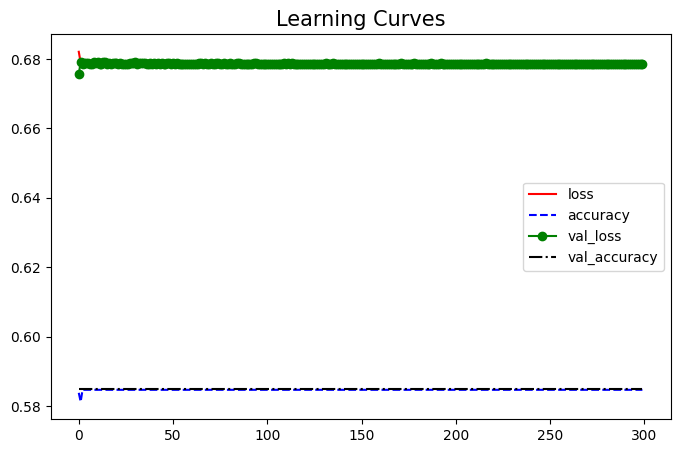

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


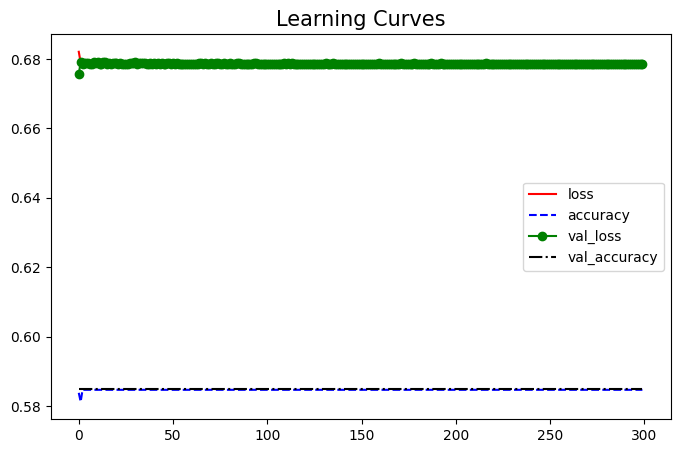

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


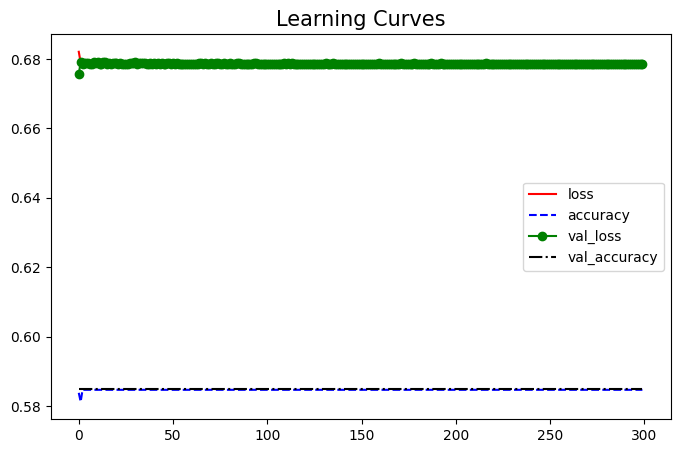

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


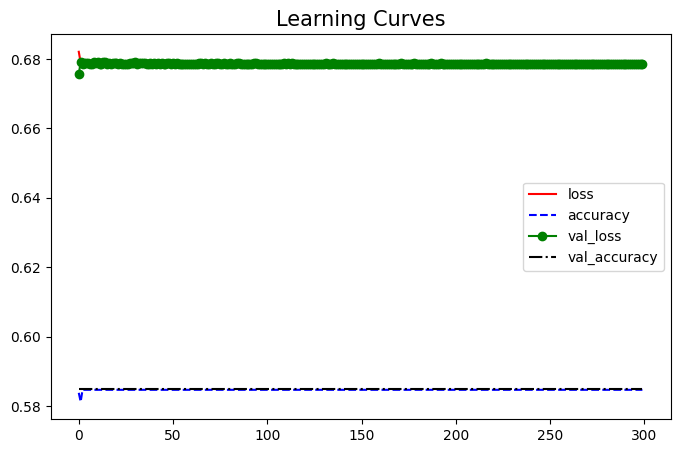

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


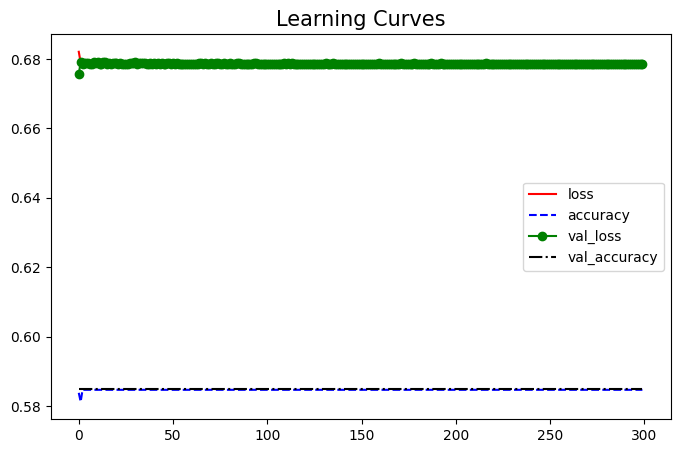

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


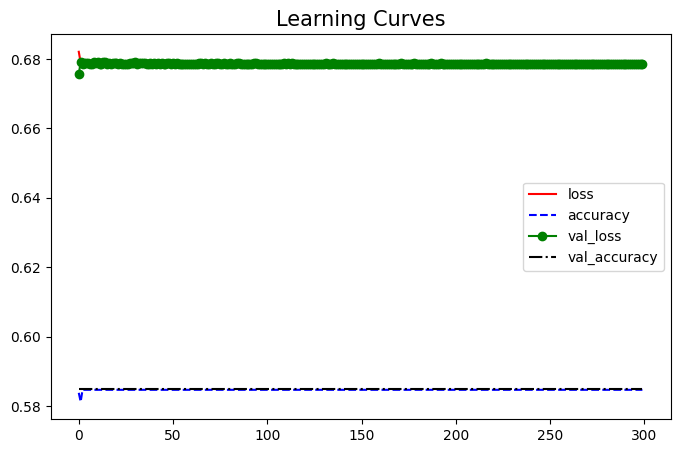

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


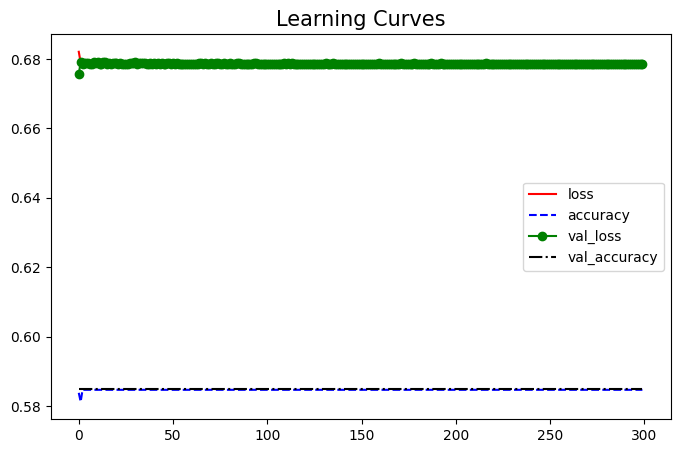

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


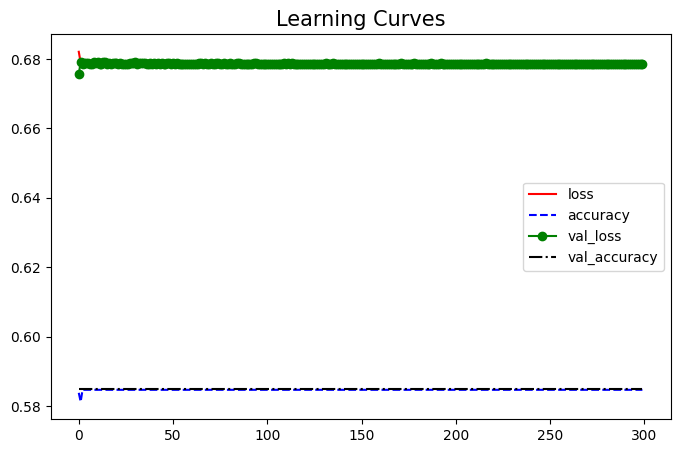

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


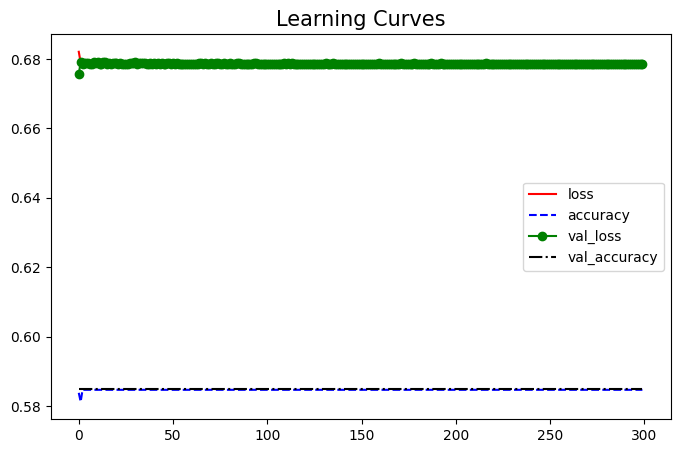

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 3-D AE (4 Layers)

#### 12 layer decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_26 (Dense)            (None, 60)                4560      
                                                                 
 dense_27 (Dense)            (None, 30)                1830      
                                                                 
 dense_28 (Dense)            (None, 15)                465       
                                                                 
 dense_29 (Dense)            (None, 3)                 48        
                                                                 
 dense_30 (Dense)            (None, 10)                40        
                                                                 
 dense_31 (Dense)            (None, 20)                220       
                                                                 
 dense_32 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 11s 20ms/step - loss: 0.6785 - accuracy: 0.5784 - val_loss: 0.6770 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6728 - accuracy: 0.5852 - val_loss: 0.6596 - val_accuracy: 0.6376
Epoch 3/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6798 - accuracy: 0.5801 - val_loss: 0.6559 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6727 - accuracy: 0.5832 - val_loss: 0.6766 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6702 - accuracy: 0.5801 - val_loss: 0.6599 - val_accuracy: 0.5860
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6780 - accuracy: 0.5847 - val_loss: 0.6790 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6761 - accuracy: 0.5850 - val_loss: 0.6618 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 6ms/step
The accuracy on testing dataset:  0.810091743119266


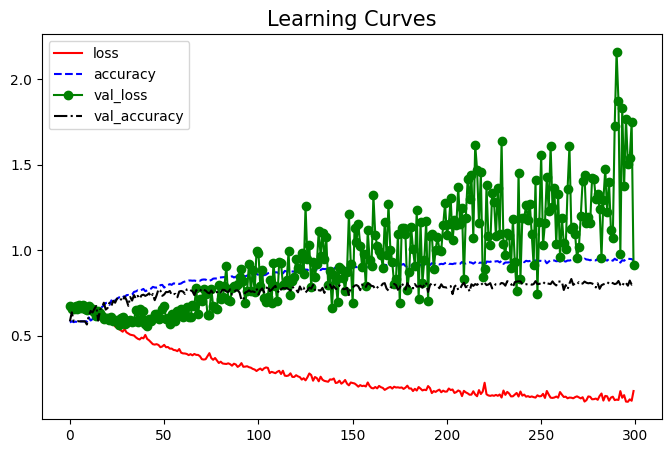

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


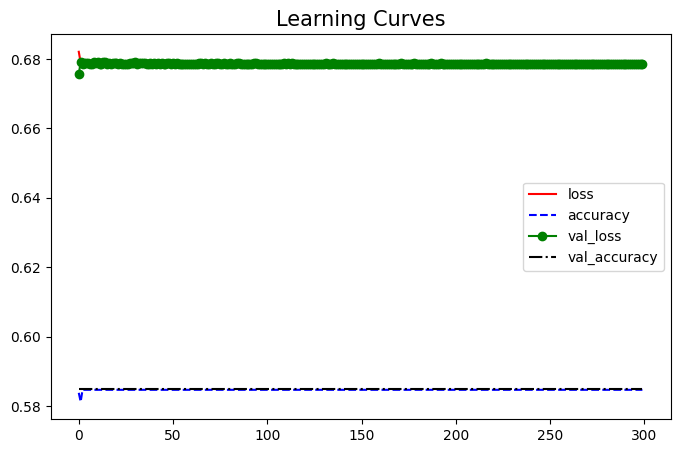

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


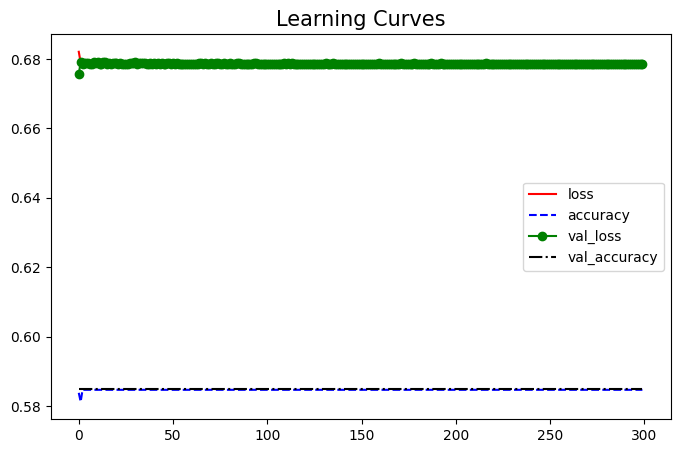

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


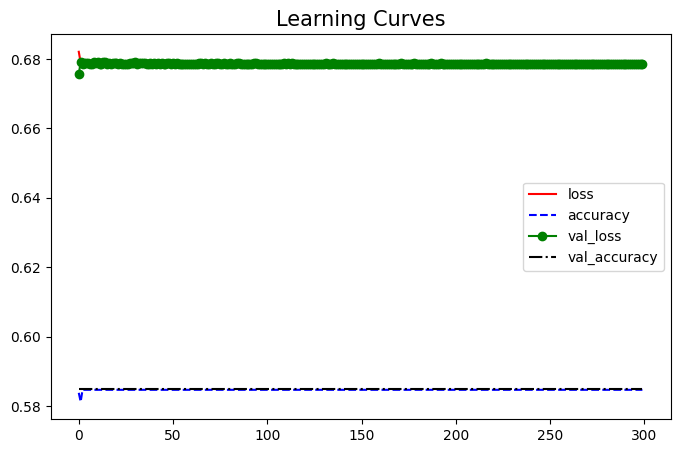

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


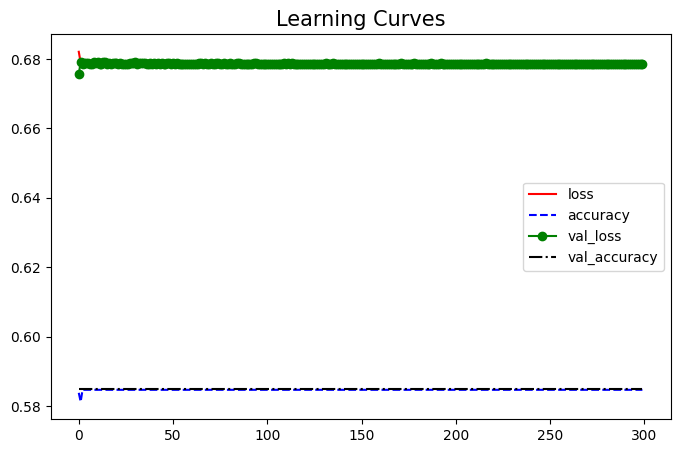

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


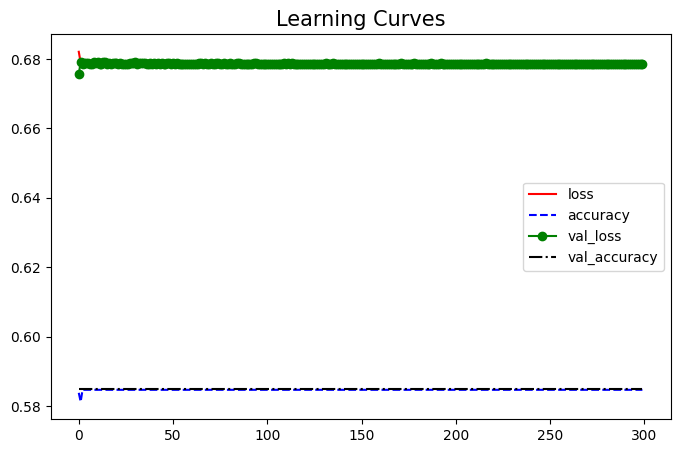

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


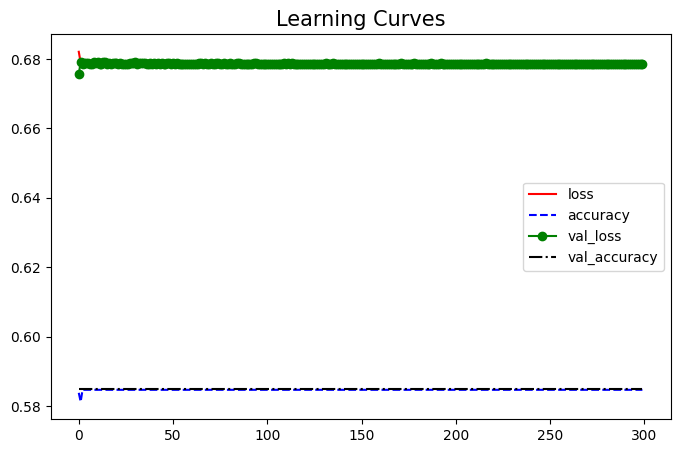

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


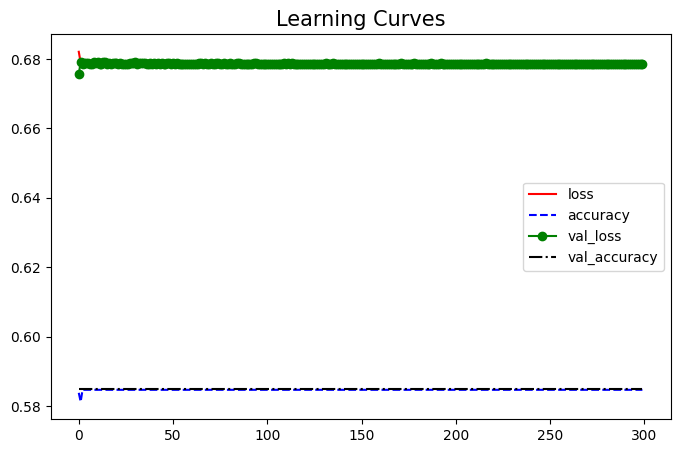

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


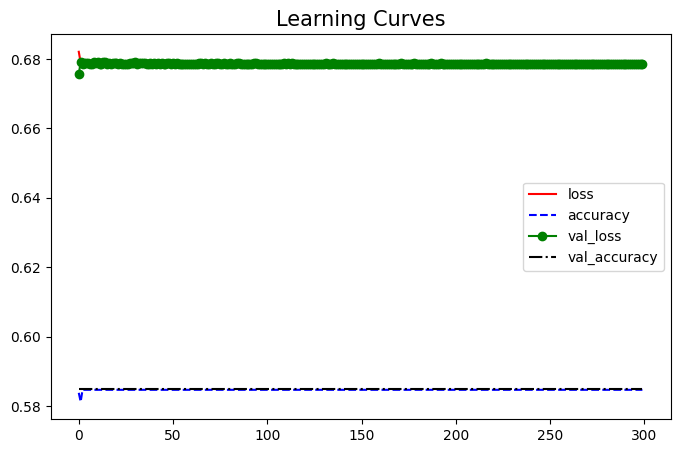

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


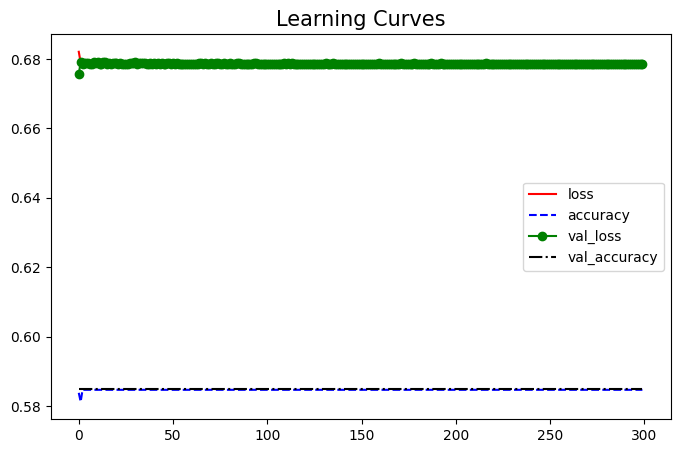

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


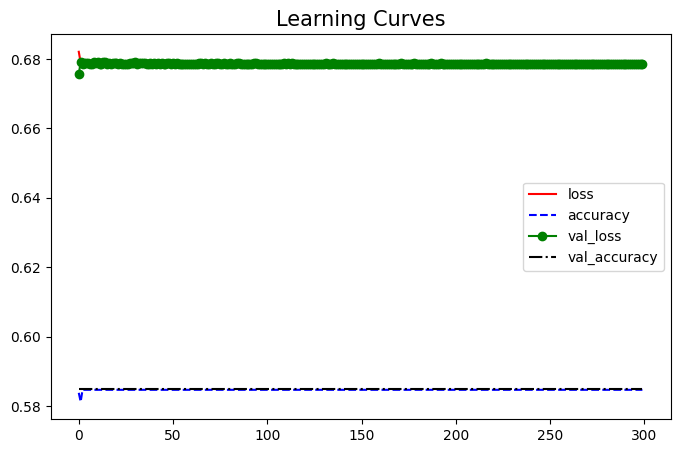

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 4-D AE (4 Layers)

#### 12 layer decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(4))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_26 (Dense)            (None, 60)                4560      
                                                                 
 dense_27 (Dense)            (None, 30)                1830      
                                                                 
 dense_28 (Dense)            (None, 15)                465       
                                                                 
 dense_29 (Dense)            (None, 3)                 48        
                                                                 
 dense_30 (Dense)            (None, 10)                40        
                                                                 
 dense_31 (Dense)            (None, 20)                220       
                                                                 
 dense_32 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 11s 20ms/step - loss: 0.6785 - accuracy: 0.5784 - val_loss: 0.6770 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6728 - accuracy: 0.5852 - val_loss: 0.6596 - val_accuracy: 0.6376
Epoch 3/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6798 - accuracy: 0.5801 - val_loss: 0.6559 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6727 - accuracy: 0.5832 - val_loss: 0.6766 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6702 - accuracy: 0.5801 - val_loss: 0.6599 - val_accuracy: 0.5860
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6780 - accuracy: 0.5847 - val_loss: 0.6790 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6761 - accuracy: 0.5850 - val_loss: 0.6618 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 6ms/step
The accuracy on testing dataset:  0.810091743119266


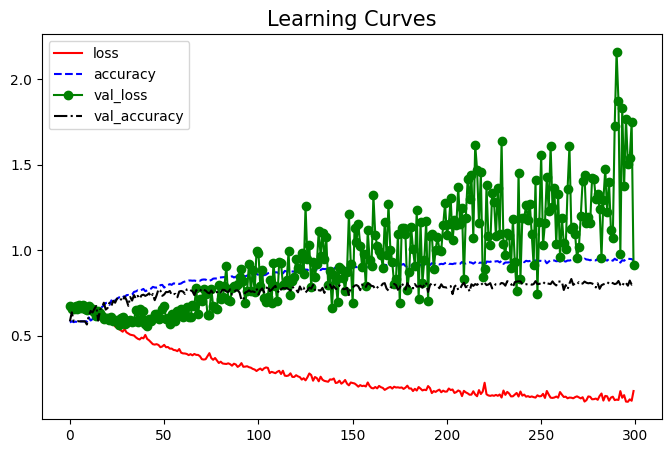

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(4))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


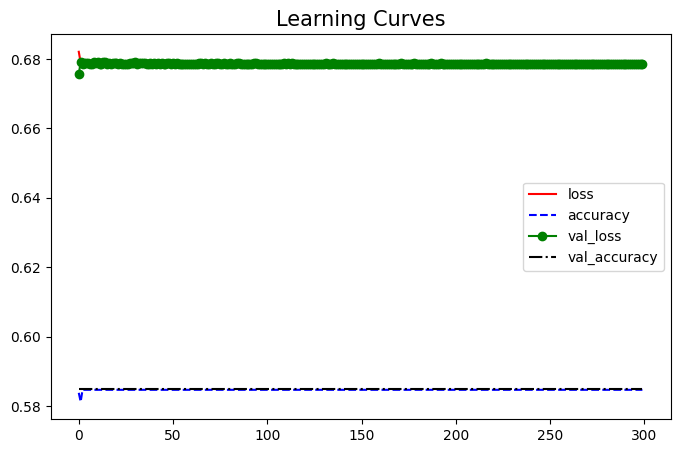

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(4))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


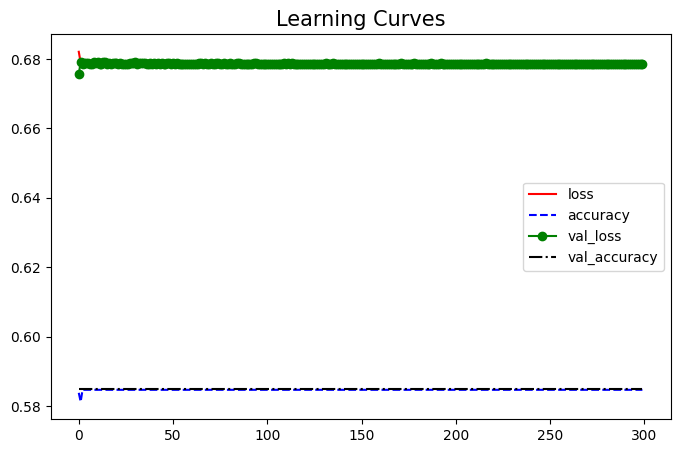

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(4))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


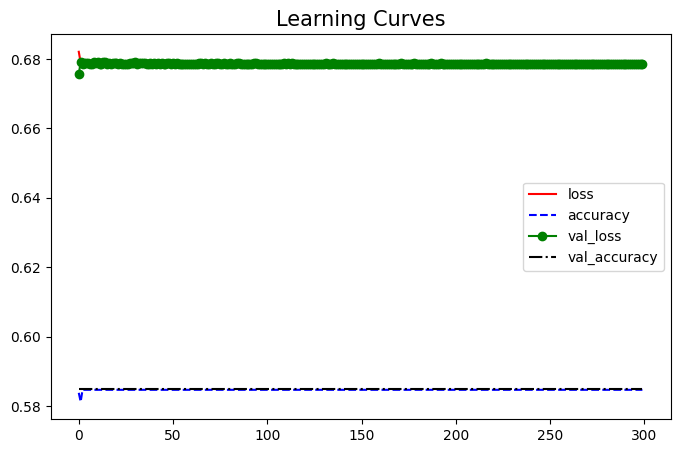

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(4))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


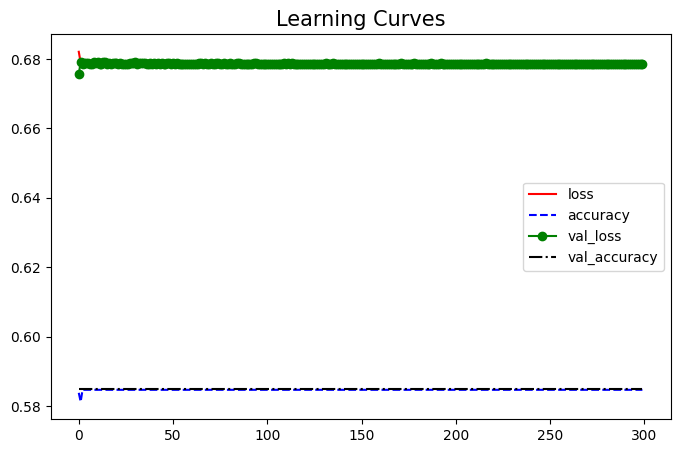

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(4))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


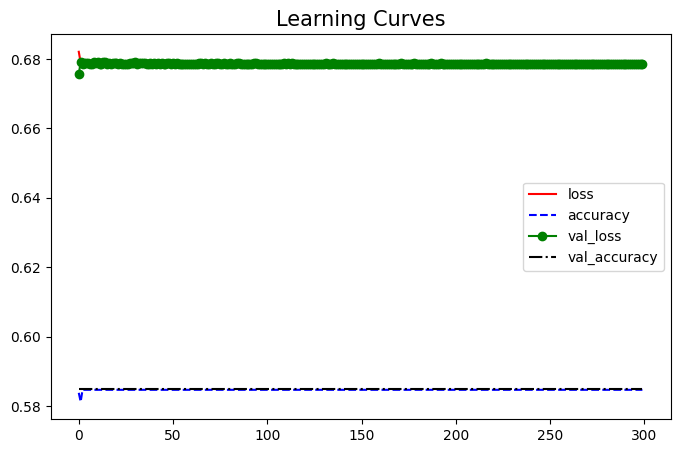

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(4))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


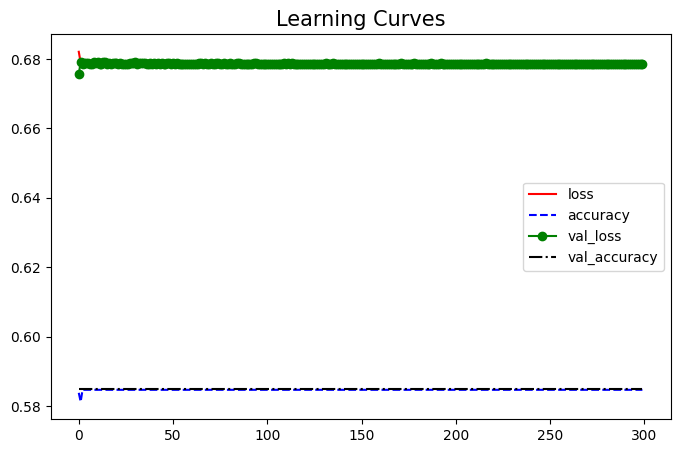

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(4))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


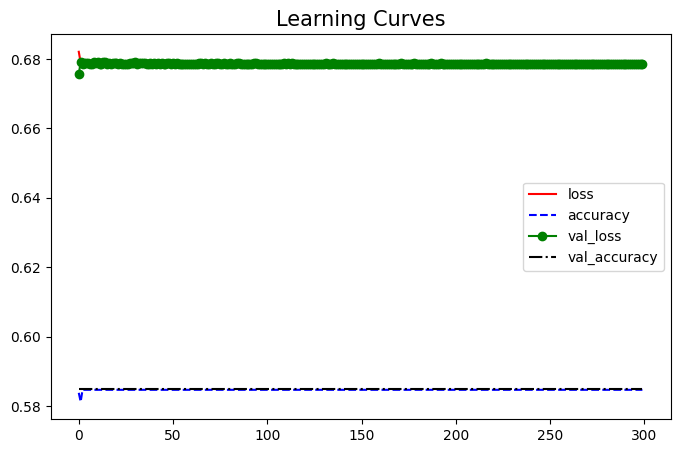

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(4))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


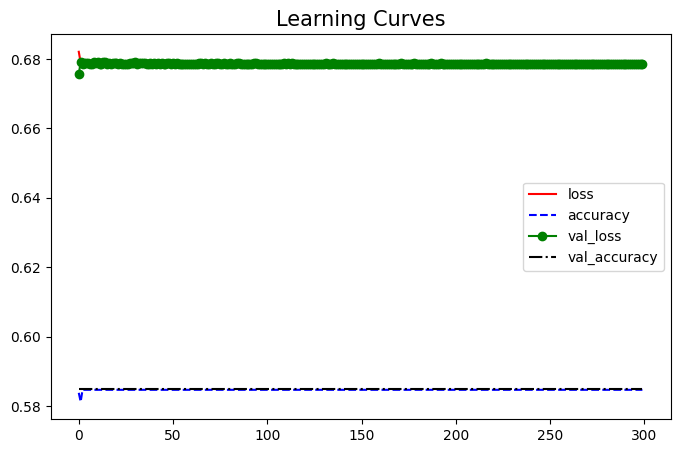

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(4))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


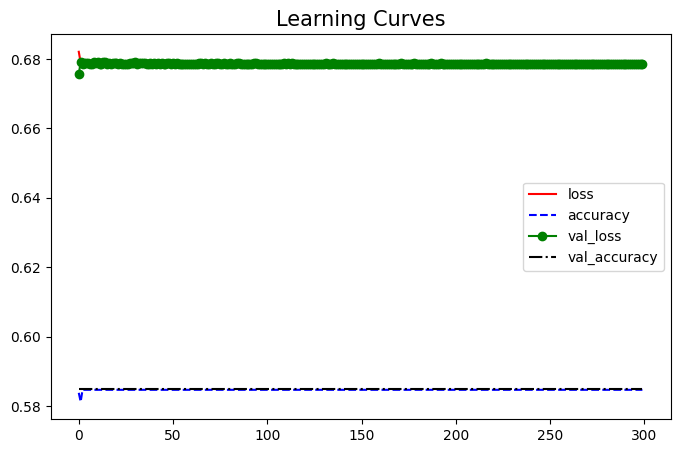

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(4))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


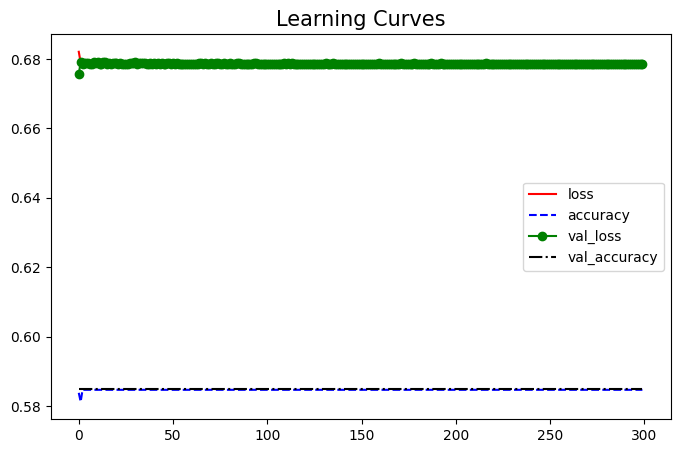

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 5-D AE (4 Layers)

#### 12 Layer Decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_41 (Dense)            (None, 60)                4560      
                                                                 
 dense_42 (Dense)            (None, 30)                1830      
                                                                 
 dense_43 (Dense)            (None, 15)                465       
                                                                 
 dense_44 (Dense)            (None, 5)                 80        
                                                                 
 dense_45 (Dense)            (None, 10)                60        
                                                                 
 dense_46 (Dense)            (None, 20)                220       
                                                                 
 dense_47 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 12s 20ms/step - loss: 0.6822 - accuracy: 0.5844 - val_loss: 0.6699 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6773 - accuracy: 0.5847 - val_loss: 0.6691 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6768 - accuracy: 0.5847 - val_loss: 0.6643 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 8s 22ms/step - loss: 0.6709 - accuracy: 0.5847 - val_loss: 0.6599 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6655 - accuracy: 0.5847 - val_loss: 0.6568 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 20ms/step - loss: 0.6645 - accuracy: 0.5847 - val_loss: 0.6573 - val_accuracy: 0.6411
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6481 - accuracy: 0.6332 - val_loss: 0.6297 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8412844036697248


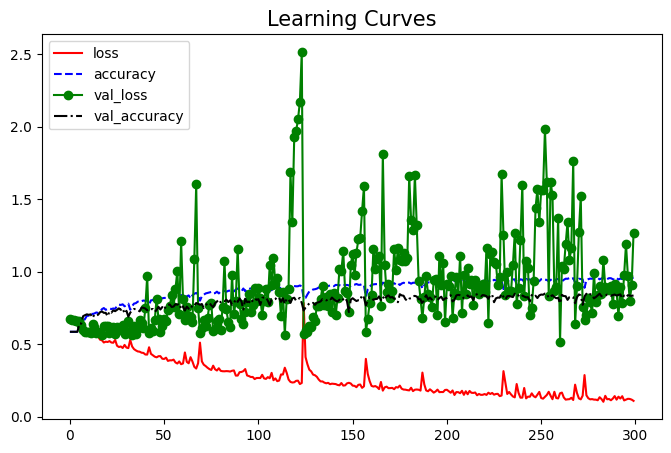

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


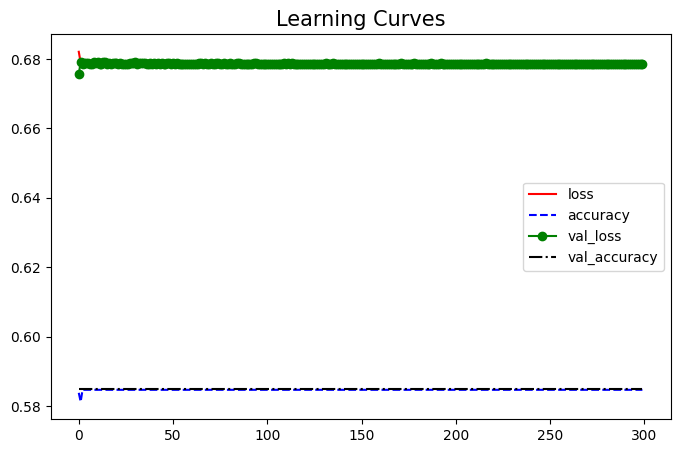

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


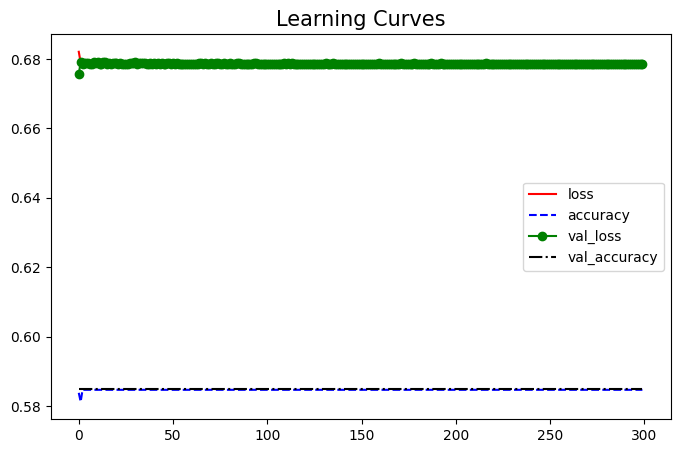

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


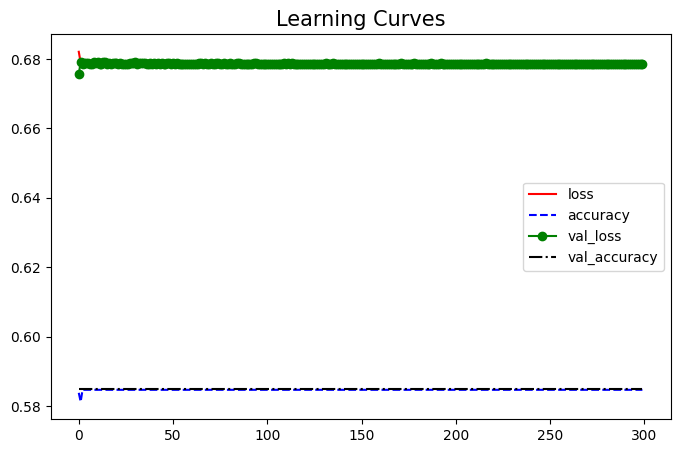

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


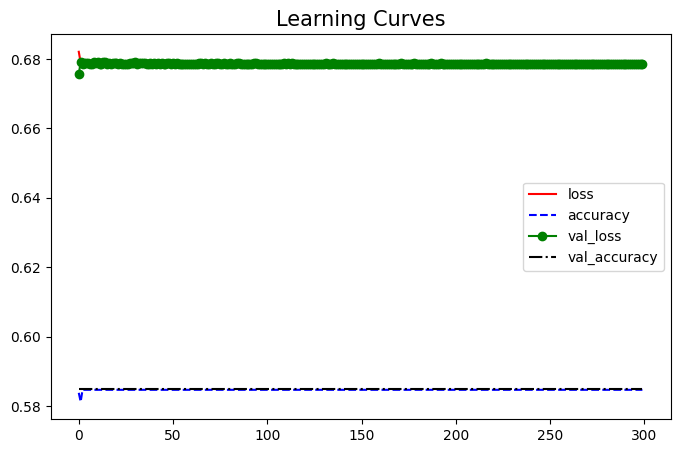

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


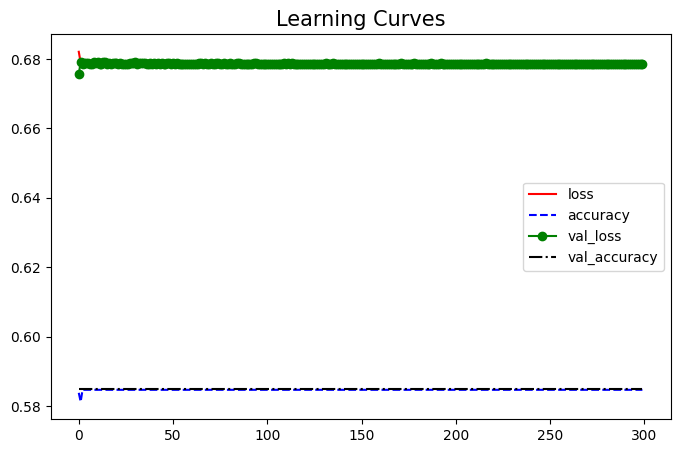

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


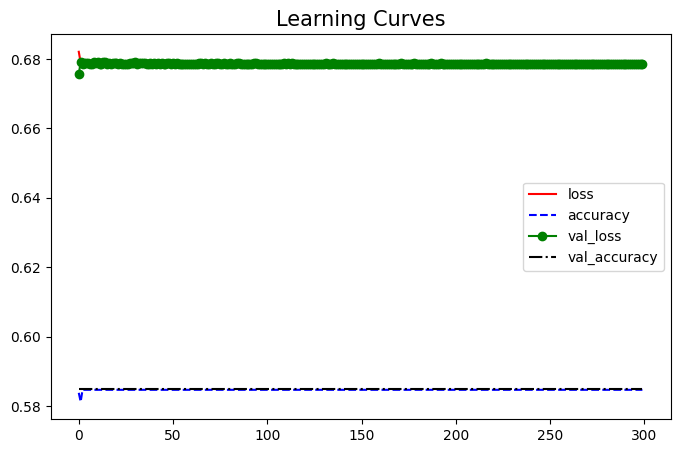

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


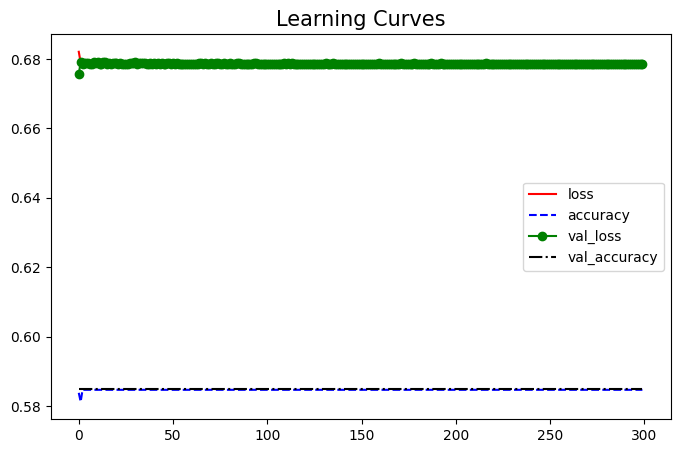

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


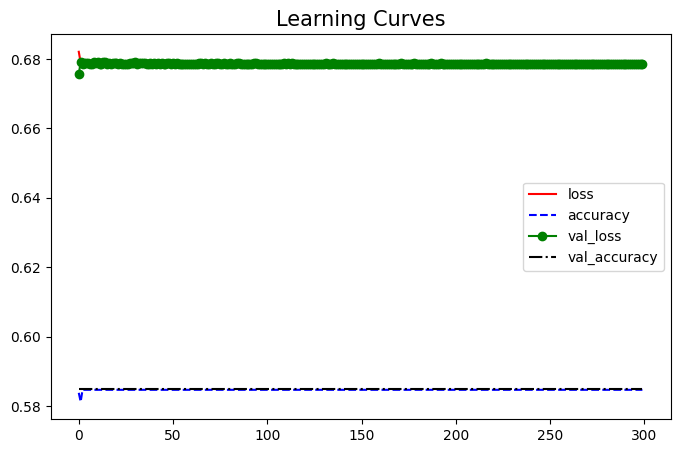

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


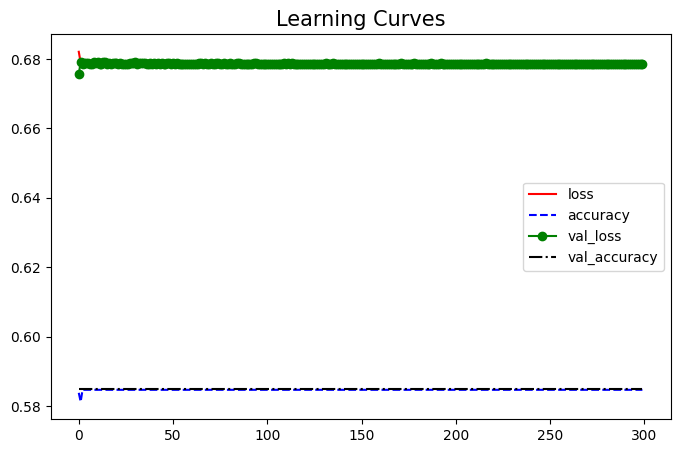

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


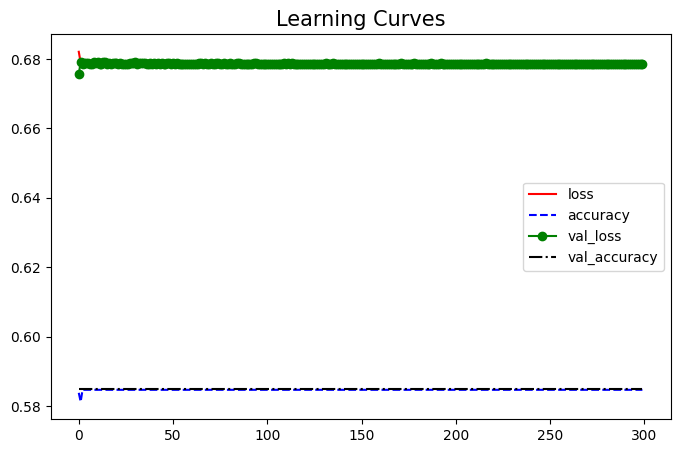

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 6-D AE (4 Layers)

#### 12 Layer Decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(6))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_41 (Dense)            (None, 60)                4560      
                                                                 
 dense_42 (Dense)            (None, 30)                1830      
                                                                 
 dense_43 (Dense)            (None, 15)                465       
                                                                 
 dense_44 (Dense)            (None, 5)                 80        
                                                                 
 dense_45 (Dense)            (None, 10)                60        
                                                                 
 dense_46 (Dense)            (None, 20)                220       
                                                                 
 dense_47 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 12s 20ms/step - loss: 0.6822 - accuracy: 0.5844 - val_loss: 0.6699 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6773 - accuracy: 0.5847 - val_loss: 0.6691 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6768 - accuracy: 0.5847 - val_loss: 0.6643 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 8s 22ms/step - loss: 0.6709 - accuracy: 0.5847 - val_loss: 0.6599 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6655 - accuracy: 0.5847 - val_loss: 0.6568 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 20ms/step - loss: 0.6645 - accuracy: 0.5847 - val_loss: 0.6573 - val_accuracy: 0.6411
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6481 - accuracy: 0.6332 - val_loss: 0.6297 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8412844036697248


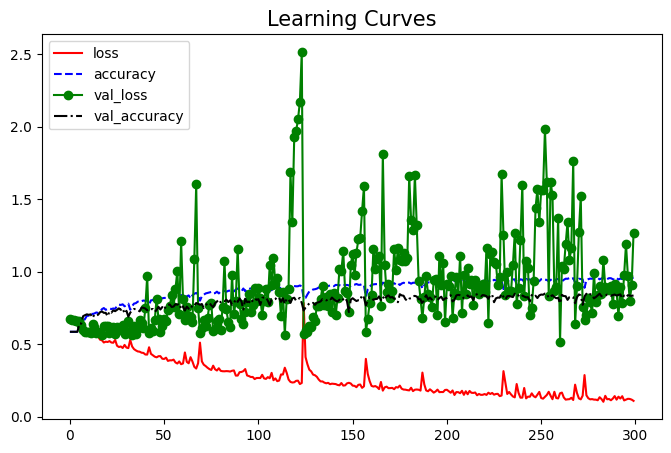

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(6))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


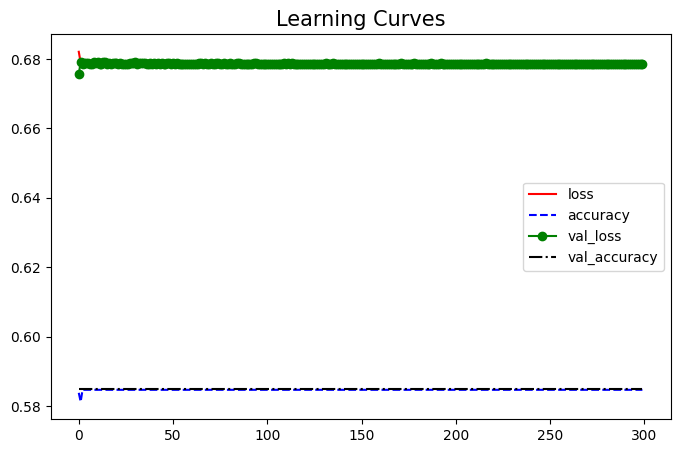

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(6))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


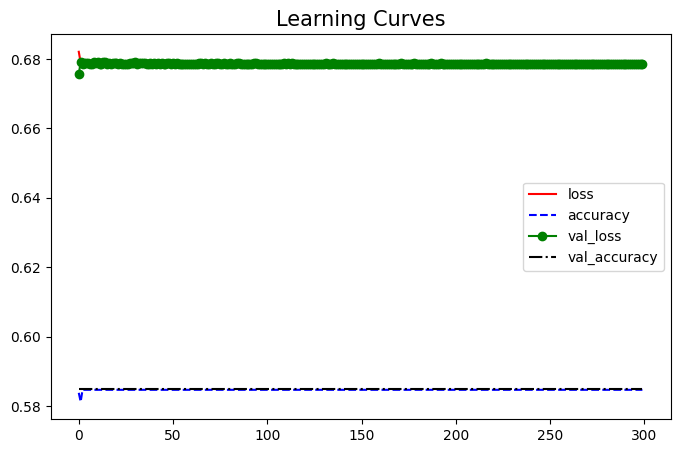

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(6))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


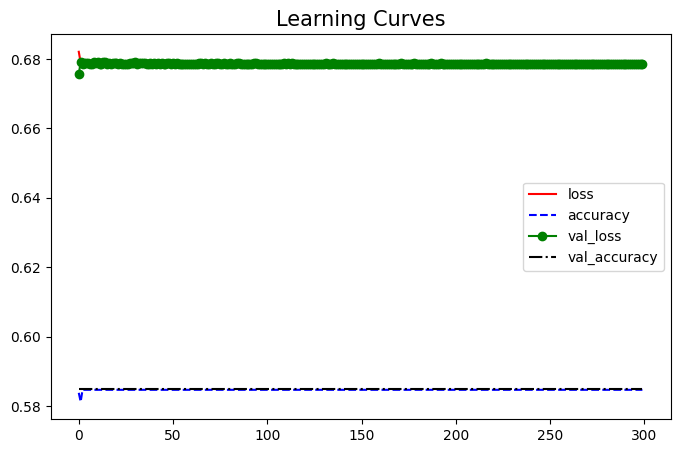

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(6))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


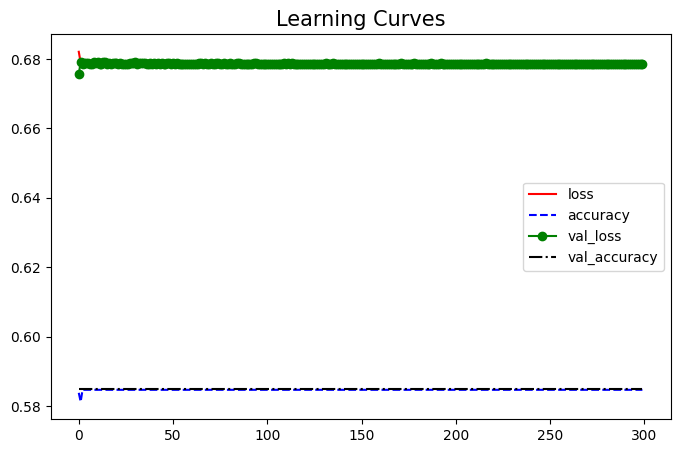

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(6))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


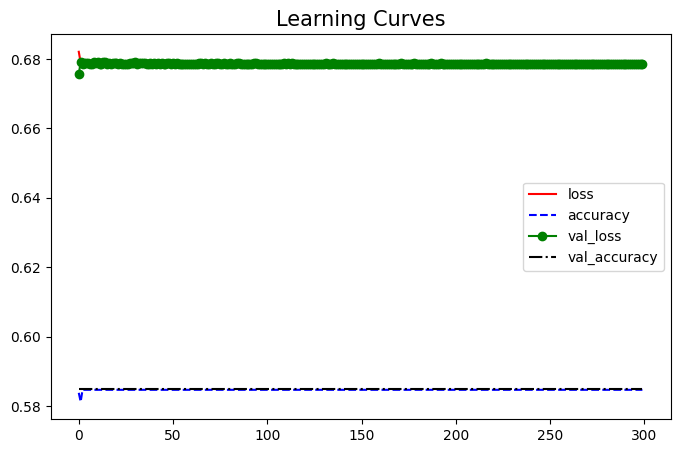

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(6))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


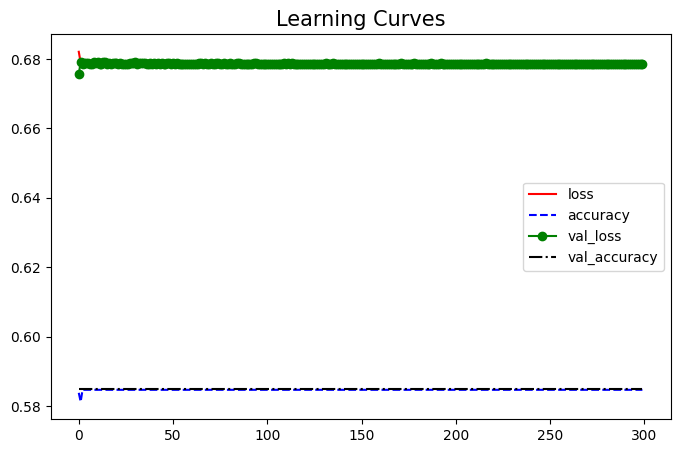

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(6))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


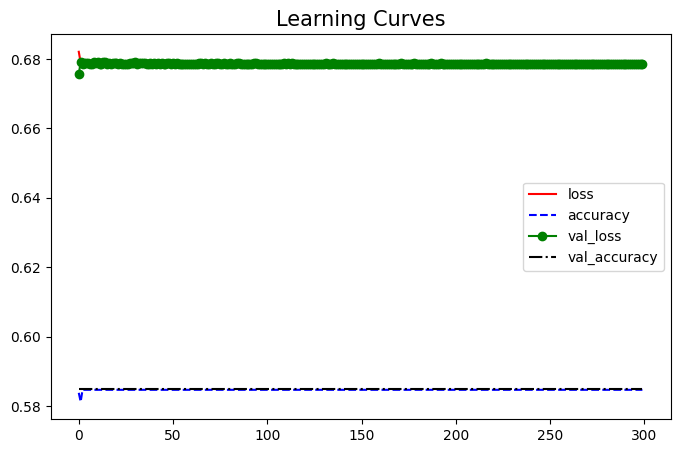

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(6))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


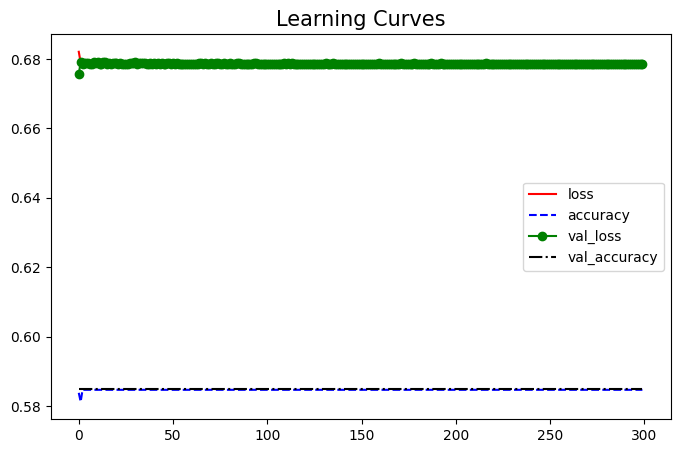

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(6))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


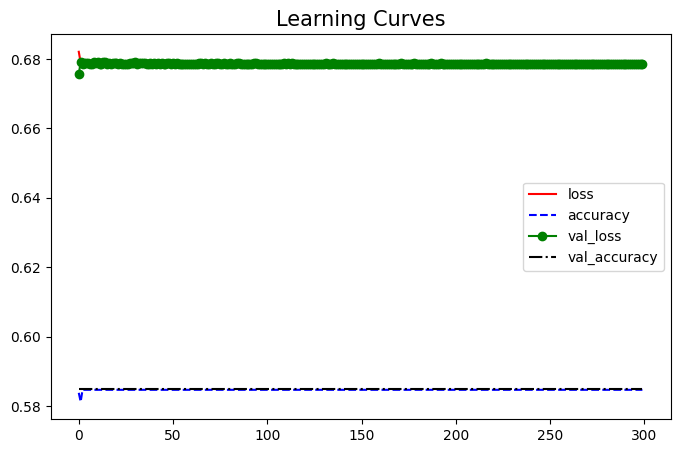

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(6))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


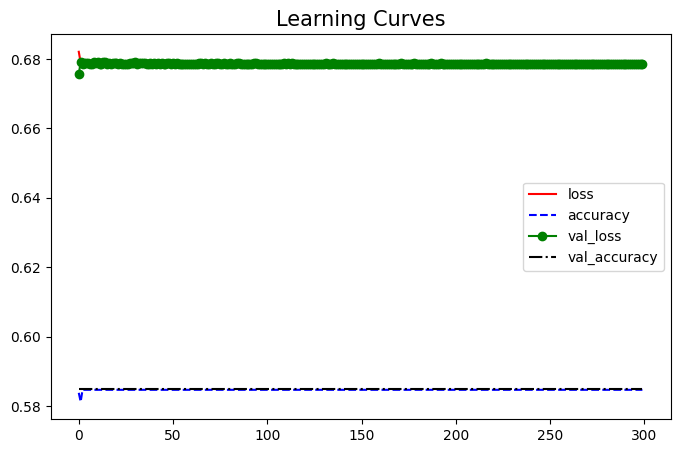

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 7-D AE (4 Layers)

#### 12 Layer Decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(7))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_41 (Dense)            (None, 60)                4560      
                                                                 
 dense_42 (Dense)            (None, 30)                1830      
                                                                 
 dense_43 (Dense)            (None, 15)                465       
                                                                 
 dense_44 (Dense)            (None, 5)                 80        
                                                                 
 dense_45 (Dense)            (None, 10)                60        
                                                                 
 dense_46 (Dense)            (None, 20)                220       
                                                                 
 dense_47 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 12s 20ms/step - loss: 0.6822 - accuracy: 0.5844 - val_loss: 0.6699 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6773 - accuracy: 0.5847 - val_loss: 0.6691 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6768 - accuracy: 0.5847 - val_loss: 0.6643 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 8s 22ms/step - loss: 0.6709 - accuracy: 0.5847 - val_loss: 0.6599 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6655 - accuracy: 0.5847 - val_loss: 0.6568 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 20ms/step - loss: 0.6645 - accuracy: 0.5847 - val_loss: 0.6573 - val_accuracy: 0.6411
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6481 - accuracy: 0.6332 - val_loss: 0.6297 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8412844036697248


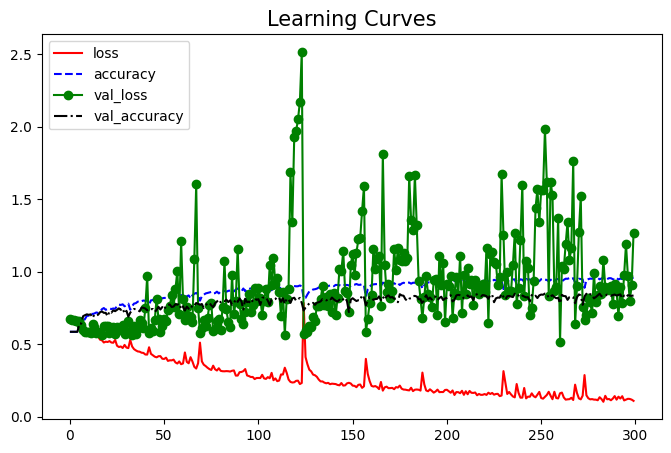

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(7))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


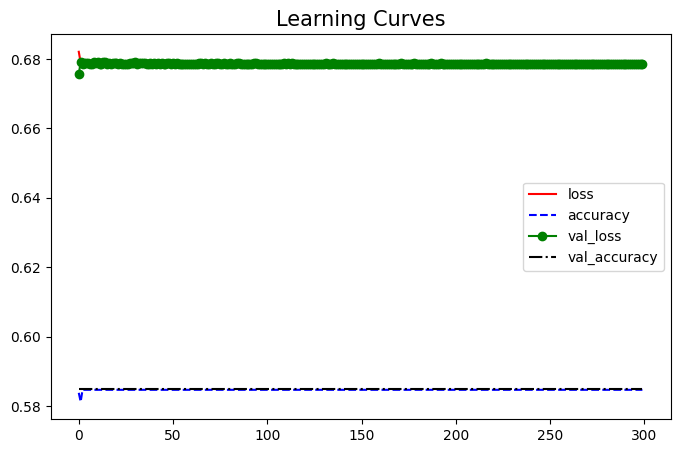

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(7))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


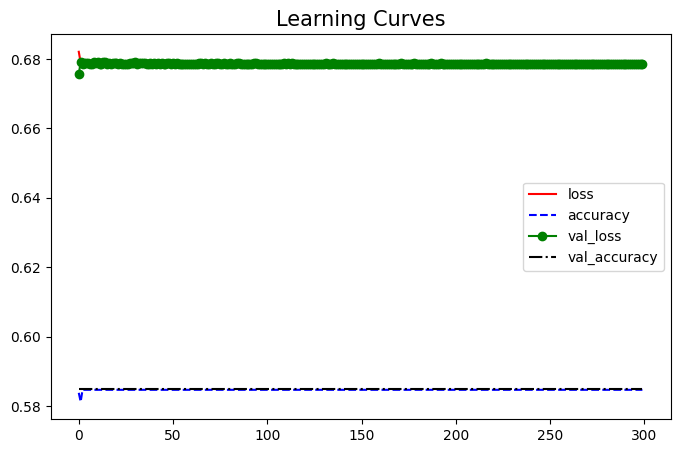

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(7))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


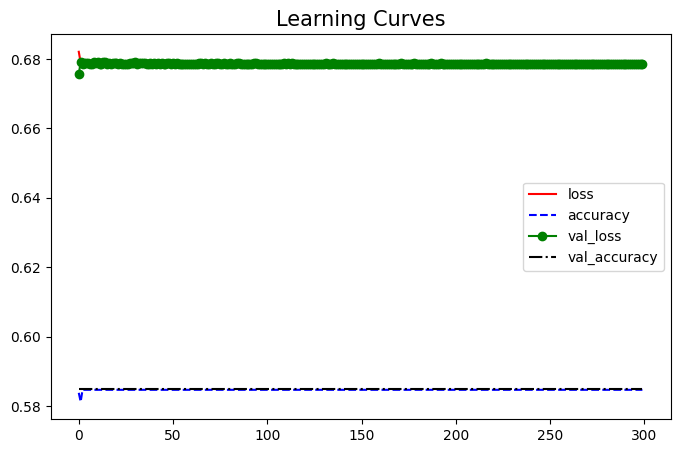

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(7))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


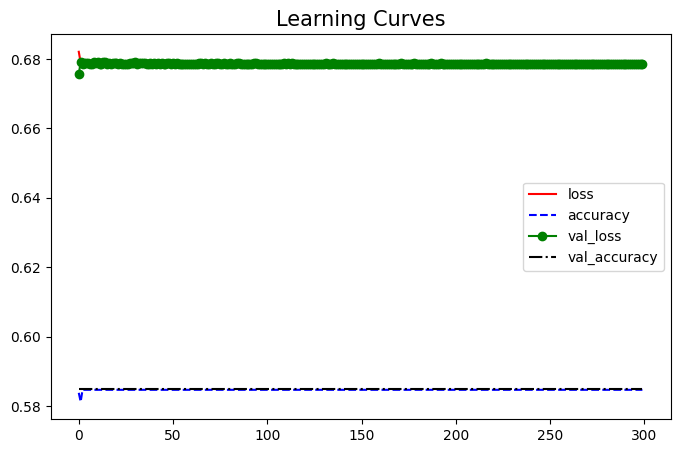

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(7))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


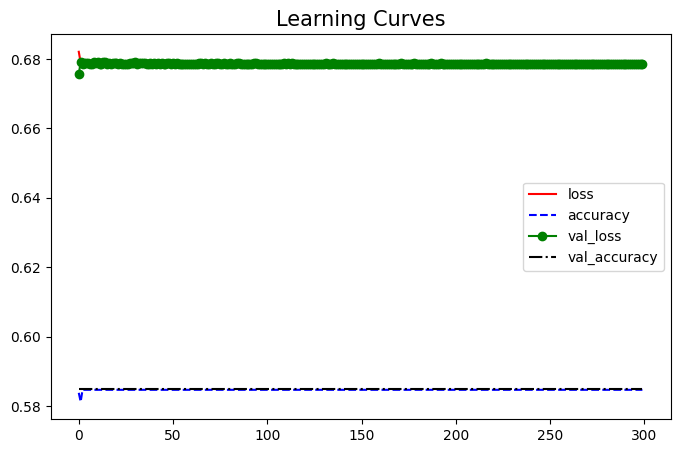

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(7))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


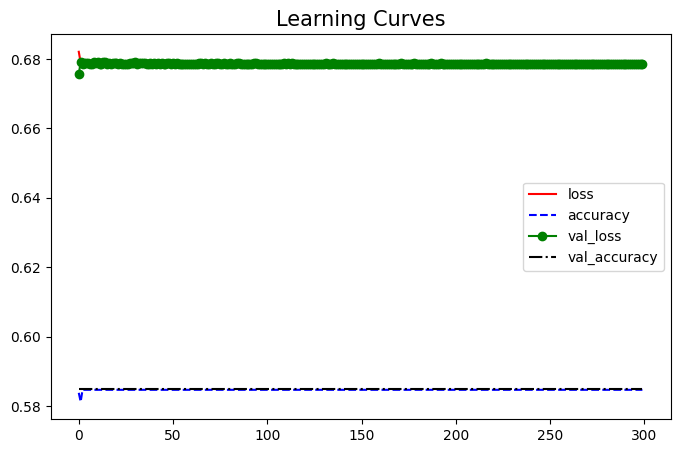

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(7))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


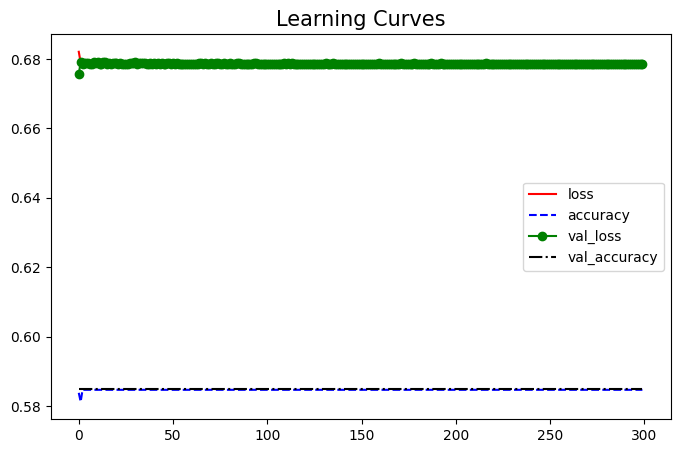

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(7))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


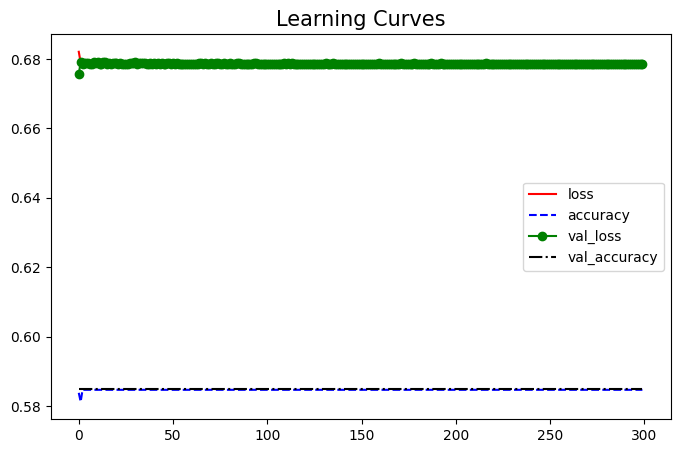

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(7))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


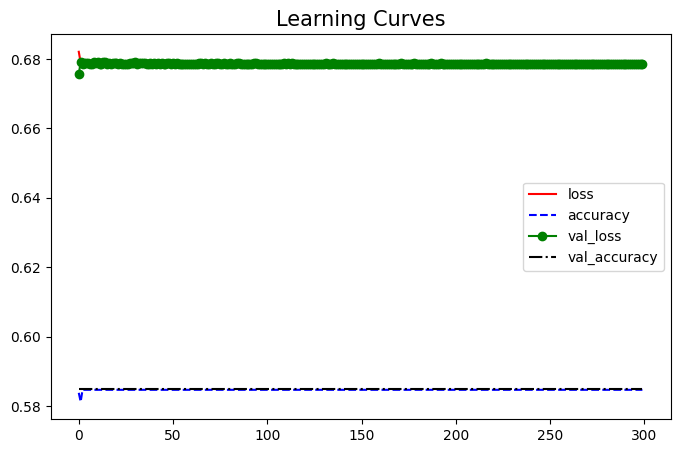

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(7))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


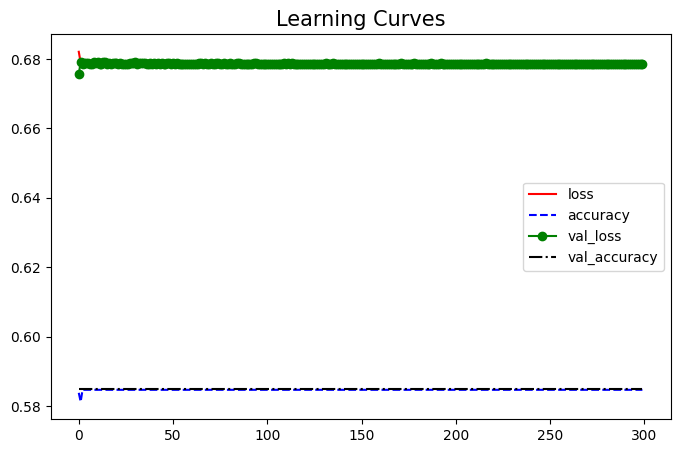

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 8-D AE (4 Layers)

#### 12 Layer Decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(8))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_41 (Dense)            (None, 60)                4560      
                                                                 
 dense_42 (Dense)            (None, 30)                1830      
                                                                 
 dense_43 (Dense)            (None, 15)                465       
                                                                 
 dense_44 (Dense)            (None, 5)                 80        
                                                                 
 dense_45 (Dense)            (None, 10)                60        
                                                                 
 dense_46 (Dense)            (None, 20)                220       
                                                                 
 dense_47 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 12s 20ms/step - loss: 0.6822 - accuracy: 0.5844 - val_loss: 0.6699 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6773 - accuracy: 0.5847 - val_loss: 0.6691 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6768 - accuracy: 0.5847 - val_loss: 0.6643 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 8s 22ms/step - loss: 0.6709 - accuracy: 0.5847 - val_loss: 0.6599 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6655 - accuracy: 0.5847 - val_loss: 0.6568 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 20ms/step - loss: 0.6645 - accuracy: 0.5847 - val_loss: 0.6573 - val_accuracy: 0.6411
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6481 - accuracy: 0.6332 - val_loss: 0.6297 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8412844036697248


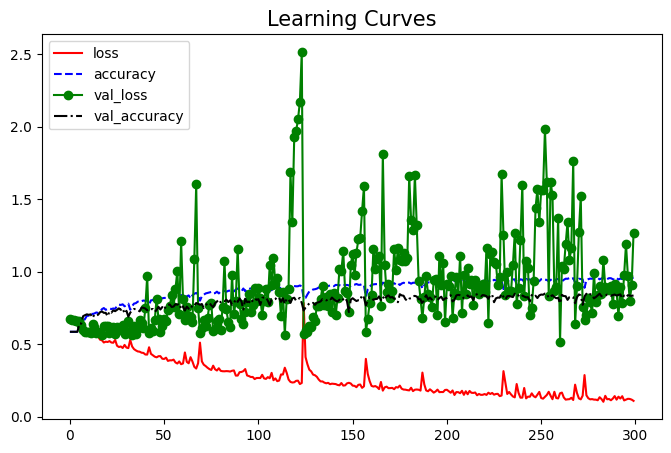

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(8))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


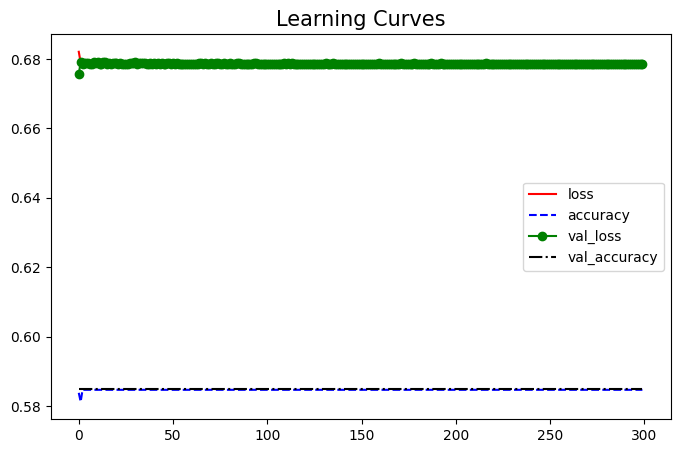

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(8))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


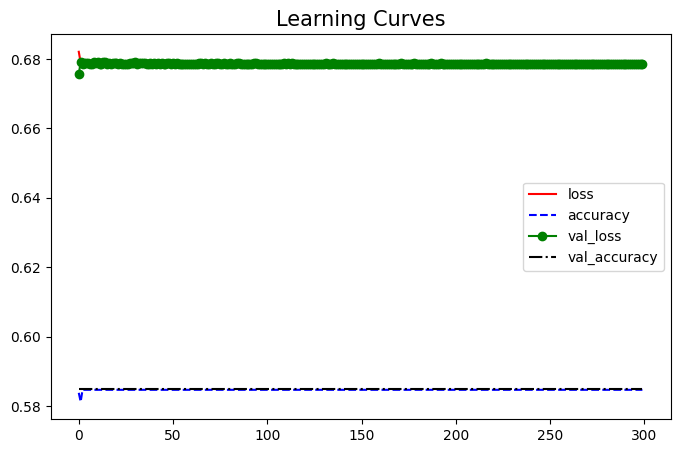

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(8))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


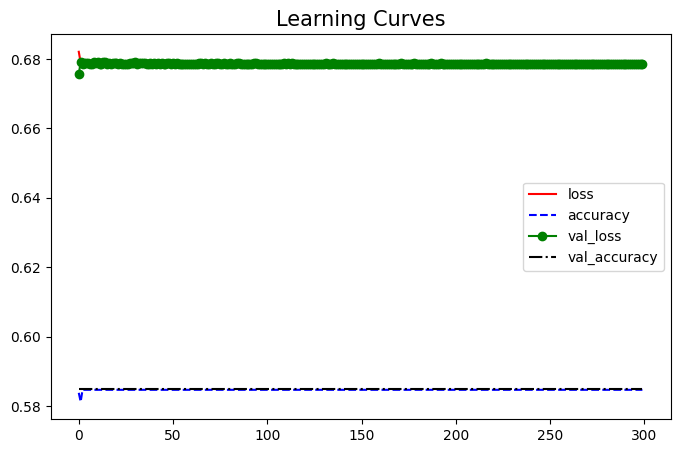

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(8))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


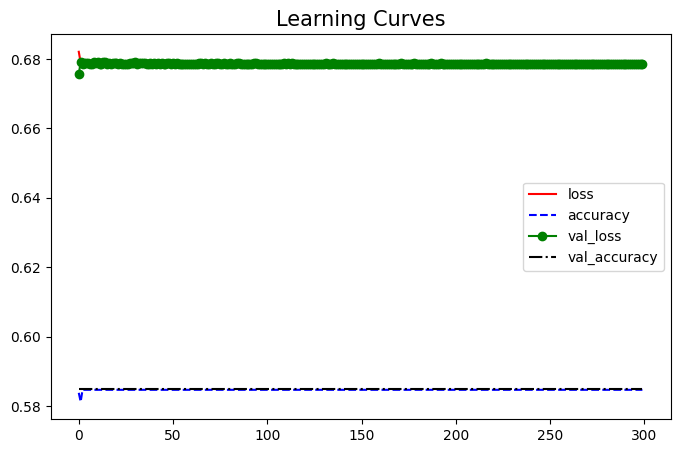

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(8))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


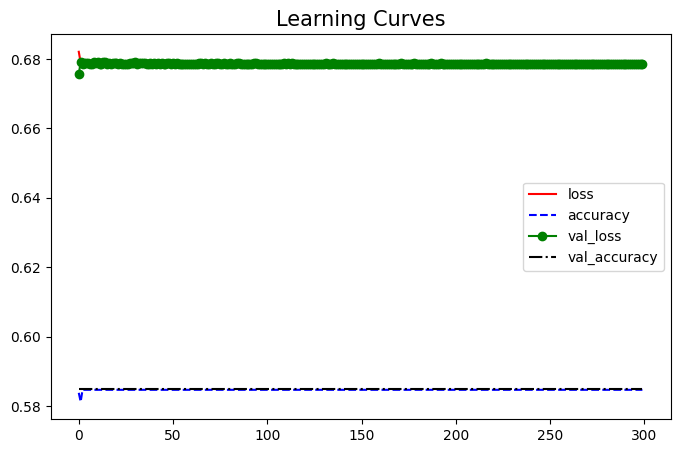

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(8))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


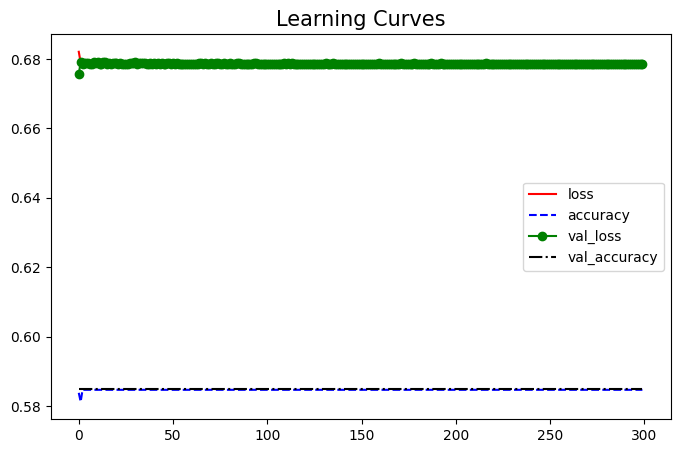

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(8))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


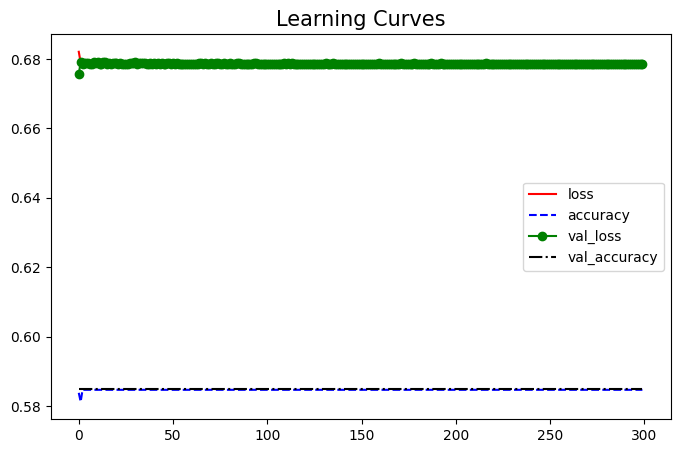

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(8))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


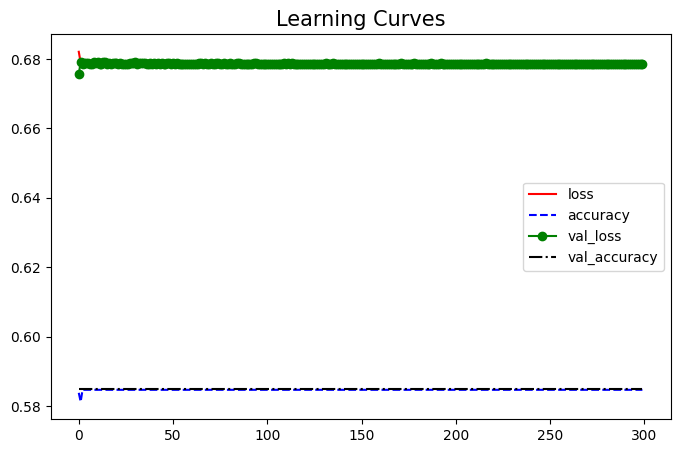

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(8))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


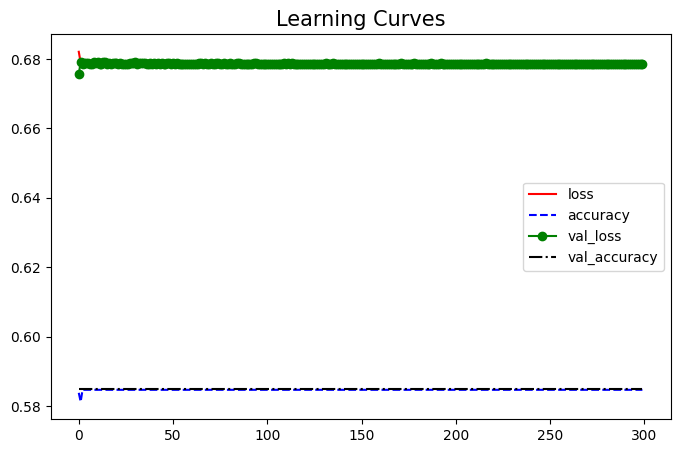

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(8))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


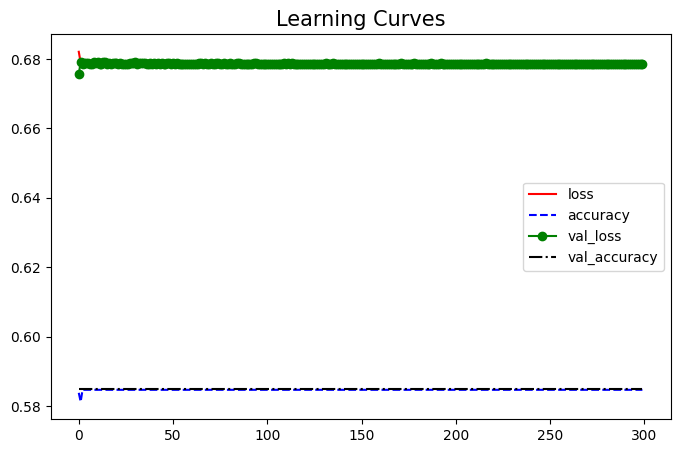

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 9-D AE (4 Layers)

#### 12 Layer Decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(9))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_41 (Dense)            (None, 60)                4560      
                                                                 
 dense_42 (Dense)            (None, 30)                1830      
                                                                 
 dense_43 (Dense)            (None, 15)                465       
                                                                 
 dense_44 (Dense)            (None, 5)                 80        
                                                                 
 dense_45 (Dense)            (None, 10)                60        
                                                                 
 dense_46 (Dense)            (None, 20)                220       
                                                                 
 dense_47 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 12s 20ms/step - loss: 0.6822 - accuracy: 0.5844 - val_loss: 0.6699 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6773 - accuracy: 0.5847 - val_loss: 0.6691 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6768 - accuracy: 0.5847 - val_loss: 0.6643 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 8s 22ms/step - loss: 0.6709 - accuracy: 0.5847 - val_loss: 0.6599 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6655 - accuracy: 0.5847 - val_loss: 0.6568 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 20ms/step - loss: 0.6645 - accuracy: 0.5847 - val_loss: 0.6573 - val_accuracy: 0.6411
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6481 - accuracy: 0.6332 - val_loss: 0.6297 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8412844036697248


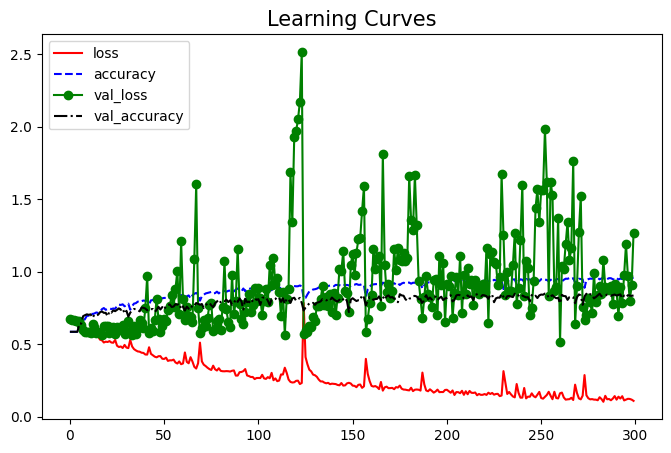

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(9))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


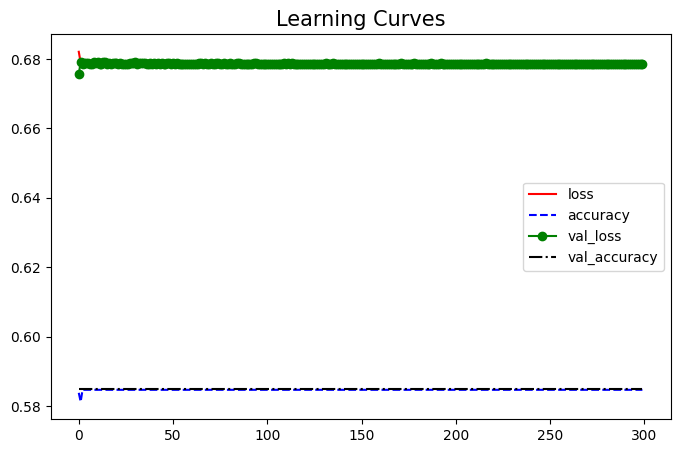

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(9))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


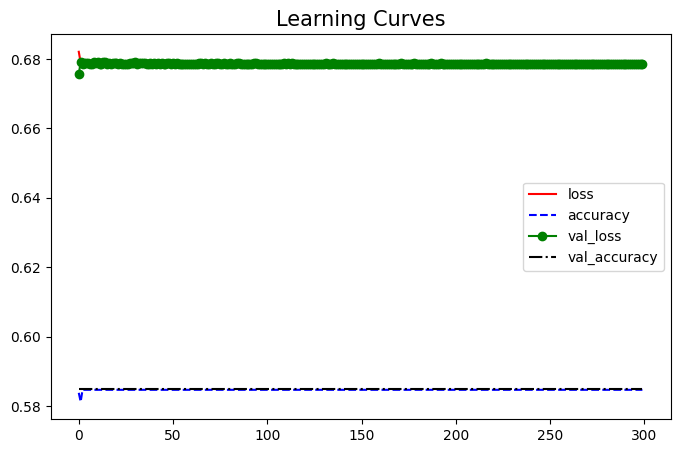

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(9))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


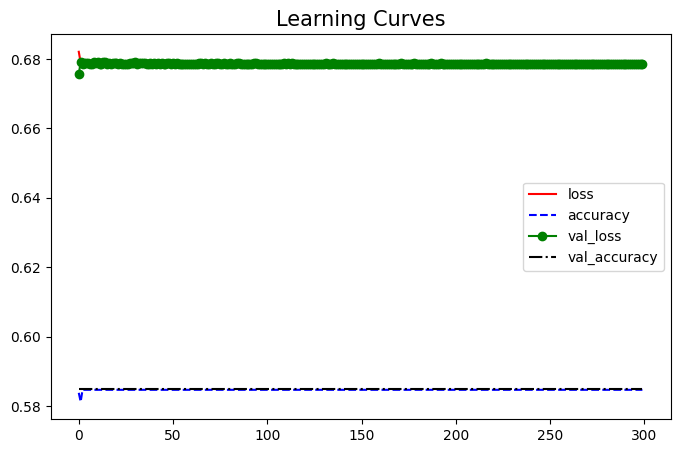

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(9))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


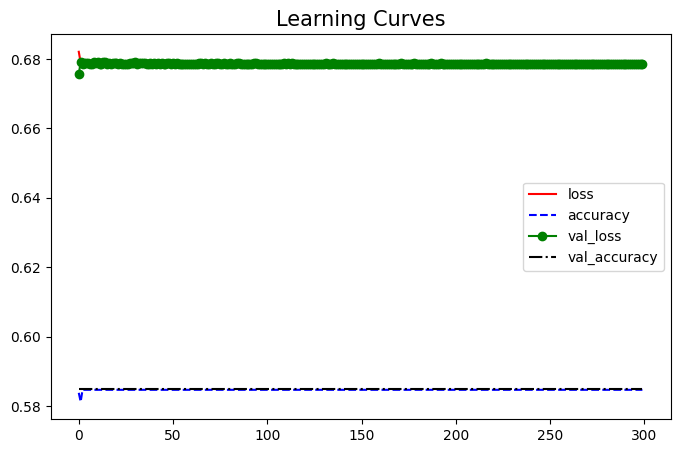

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(9))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


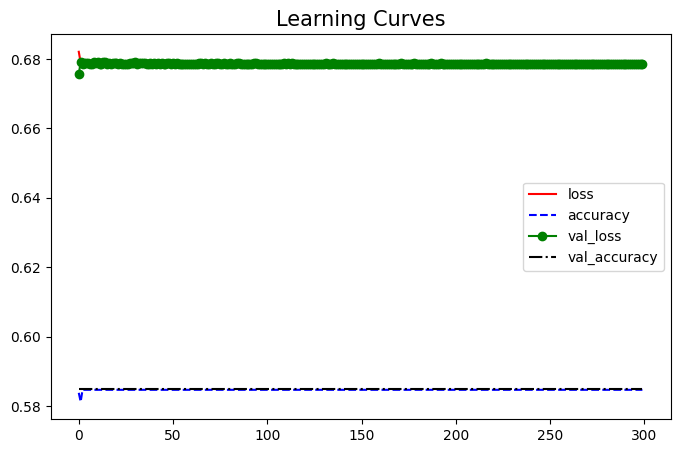

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(9))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


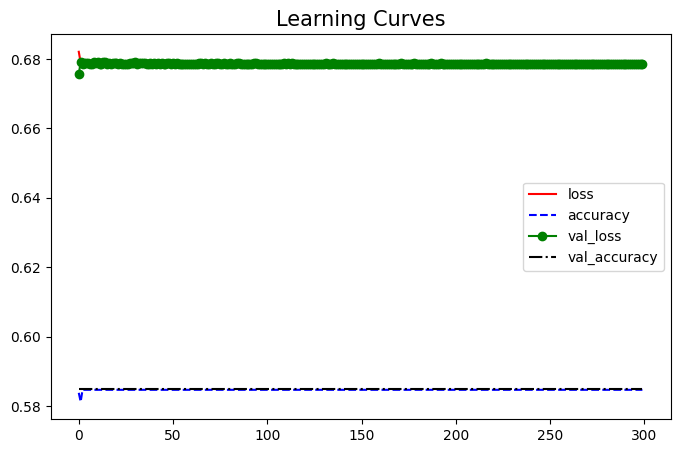

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(9))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


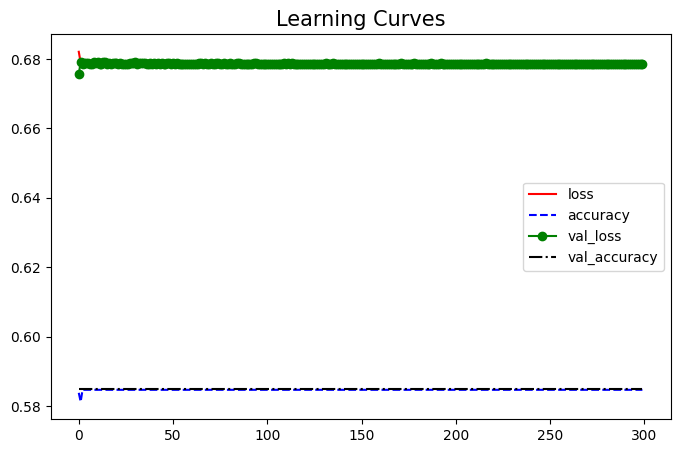

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(9))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


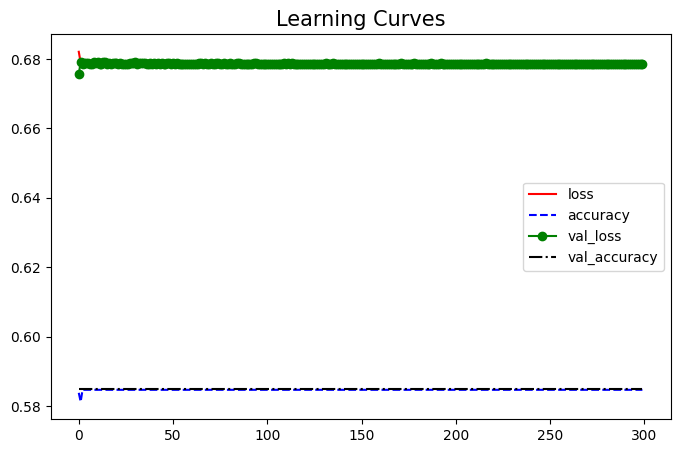

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(9))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


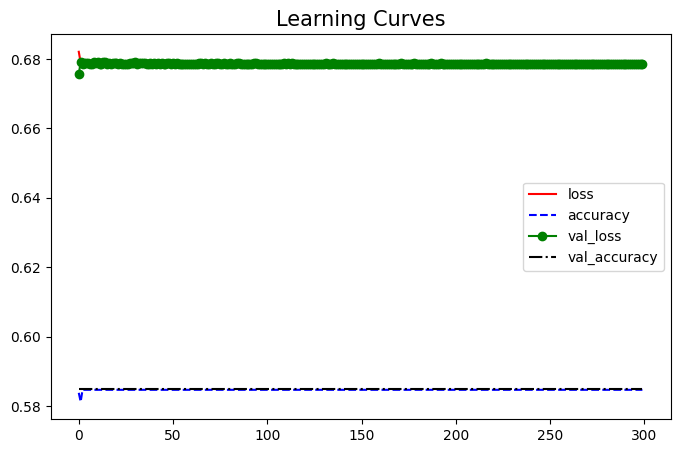

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(9))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


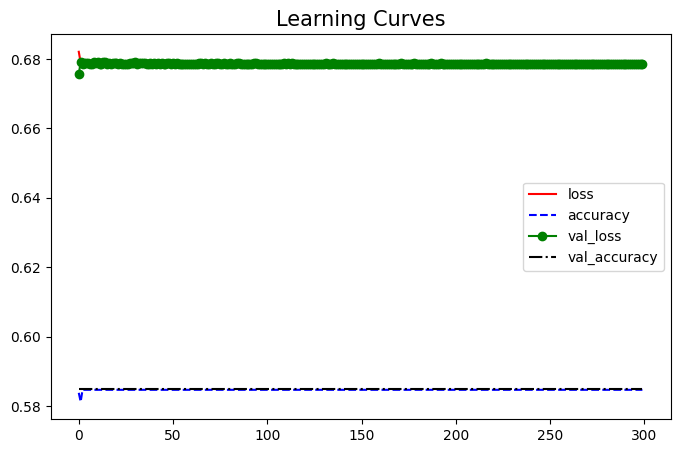

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 10-D AE (4 Layers)

#### 12 layer decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_56 (Dense)            (None, 60)                4560      
                                                                 
 dense_57 (Dense)            (None, 30)                1830      
                                                                 
 dense_58 (Dense)            (None, 15)                465       
                                                                 
 dense_59 (Dense)            (None, 10)                160       
                                                                 
 dense_60 (Dense)            (None, 10)                110       
                                                                 
 dense_61 (Dense)            (None, 20)                220       
                                                                 
 dense_62 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 7s 14ms/step - loss: 0.6793 - accuracy: 0.5824 - val_loss: 0.6741 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 3s 10ms/step - loss: 0.6722 - accuracy: 0.5832 - val_loss: 0.6594 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 3s 9ms/step - loss: 0.6715 - accuracy: 0.5933 - val_loss: 0.6529 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 3s 9ms/step - loss: 0.6648 - accuracy: 0.5847 - val_loss: 0.6489 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 5s 14ms/step - loss: 0.6617 - accuracy: 0.5927 - val_loss: 0.6486 - val_accuracy: 0.6021
Epoch 6/300
349/349 [==============================] - 4s 10ms/step - loss: 0.6743 - accuracy: 0.5852 - val_loss: 0.6699 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 3s 10ms/step - loss: 0.6645 - accuracy: 0.5847 - val_loss: 0.6547 - val_accuracy: 0

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8321100917431192


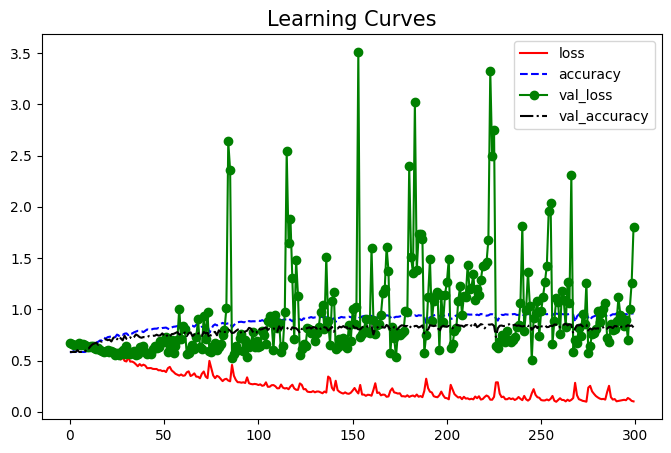

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


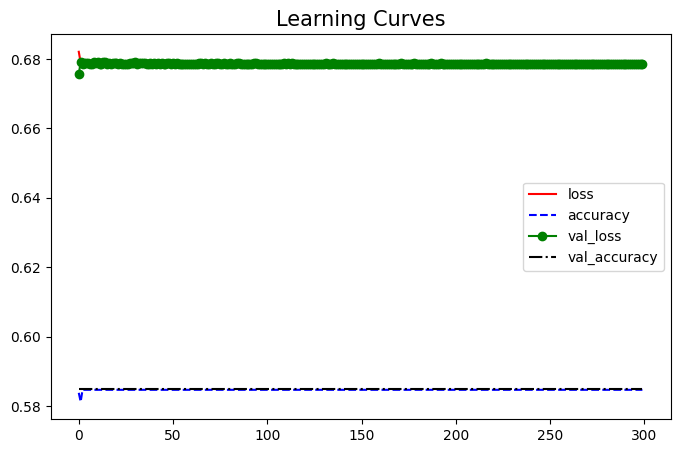

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


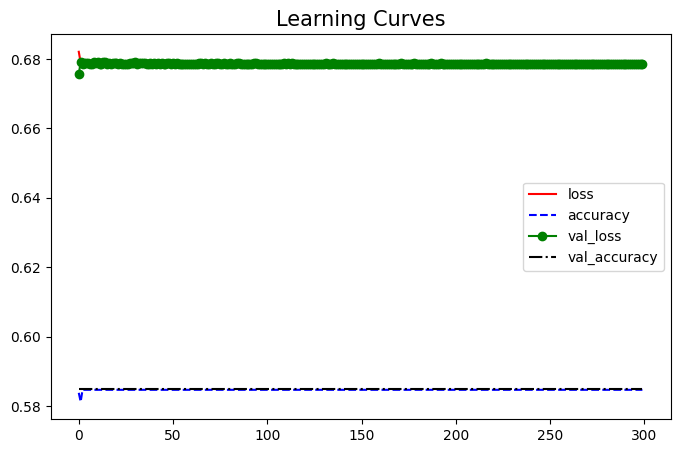

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


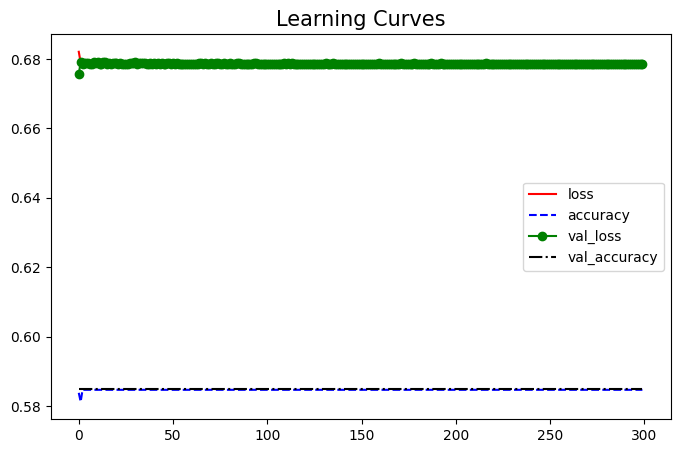

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


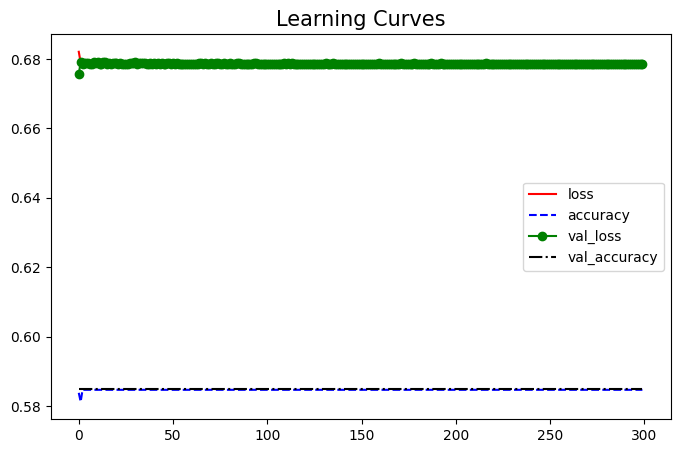

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


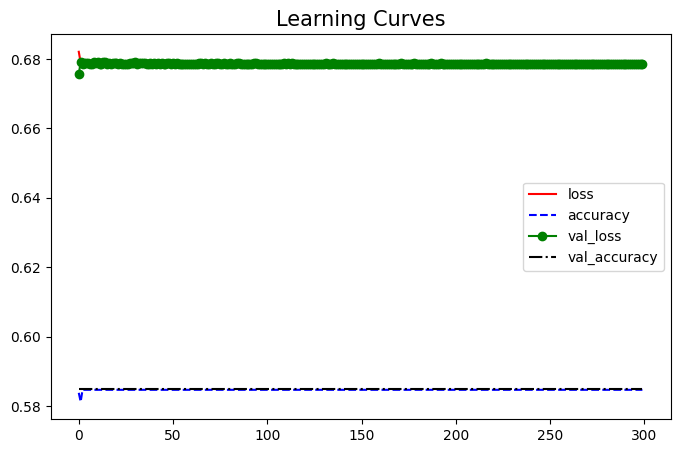

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


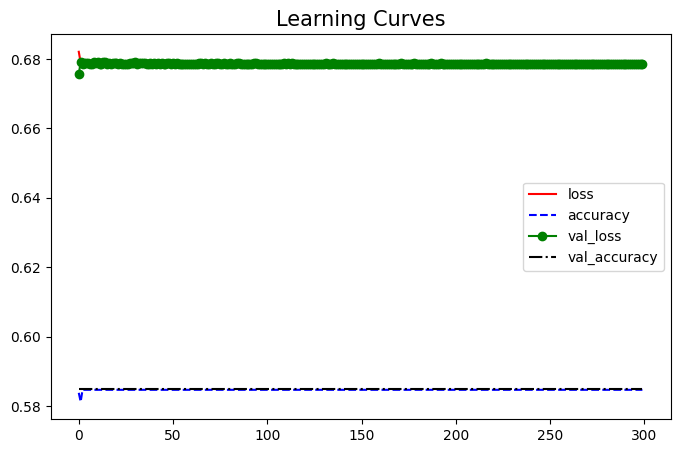

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


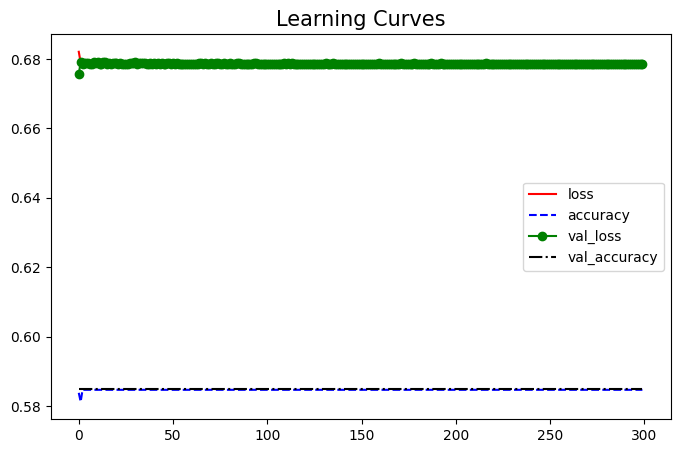

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


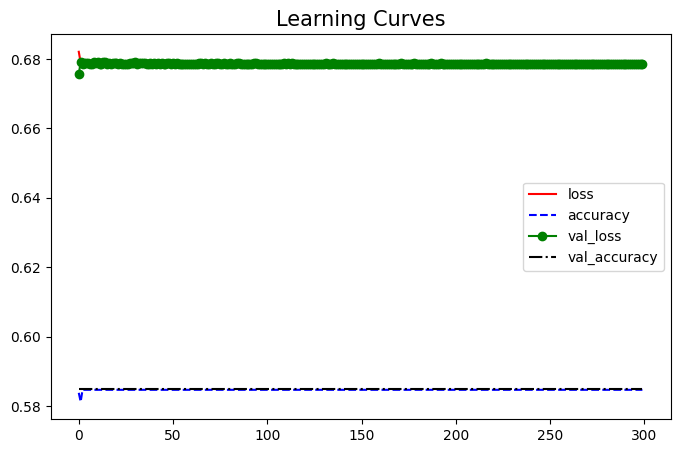

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


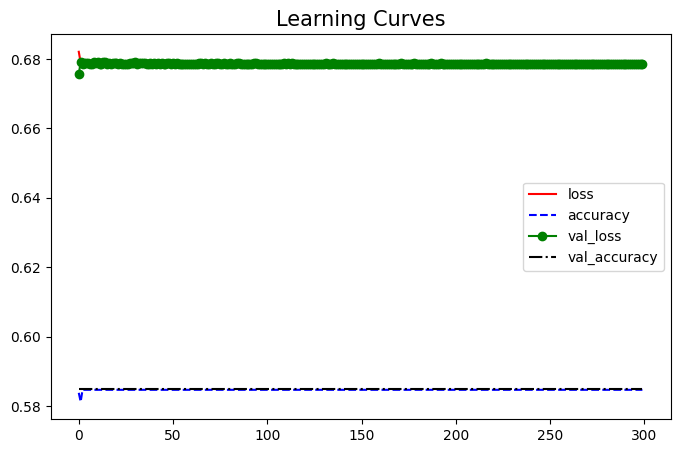

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


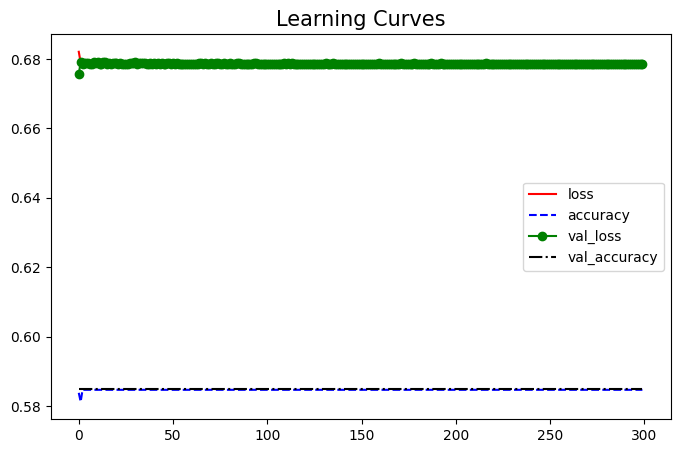

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 11-D AE (4 Layers)

#### 12 Layer Decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(11))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_41 (Dense)            (None, 60)                4560      
                                                                 
 dense_42 (Dense)            (None, 30)                1830      
                                                                 
 dense_43 (Dense)            (None, 15)                465       
                                                                 
 dense_44 (Dense)            (None, 5)                 80        
                                                                 
 dense_45 (Dense)            (None, 10)                60        
                                                                 
 dense_46 (Dense)            (None, 20)                220       
                                                                 
 dense_47 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 12s 20ms/step - loss: 0.6822 - accuracy: 0.5844 - val_loss: 0.6699 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6773 - accuracy: 0.5847 - val_loss: 0.6691 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6768 - accuracy: 0.5847 - val_loss: 0.6643 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 8s 22ms/step - loss: 0.6709 - accuracy: 0.5847 - val_loss: 0.6599 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6655 - accuracy: 0.5847 - val_loss: 0.6568 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 20ms/step - loss: 0.6645 - accuracy: 0.5847 - val_loss: 0.6573 - val_accuracy: 0.6411
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6481 - accuracy: 0.6332 - val_loss: 0.6297 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8412844036697248


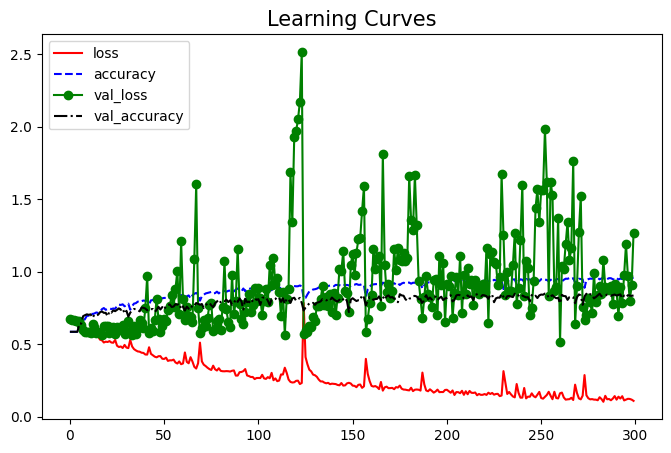

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(11))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


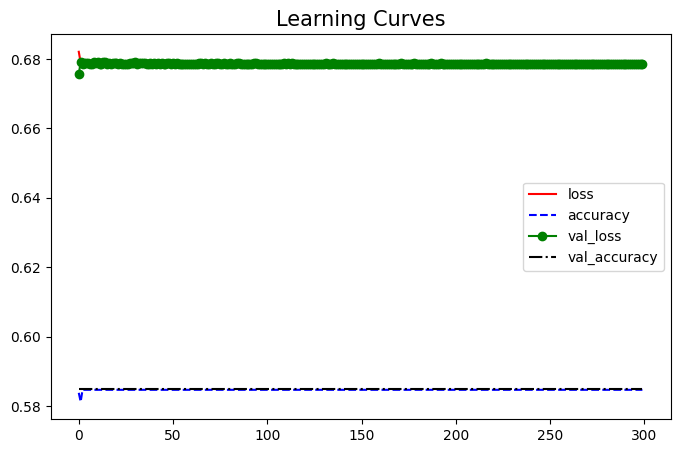

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(11))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


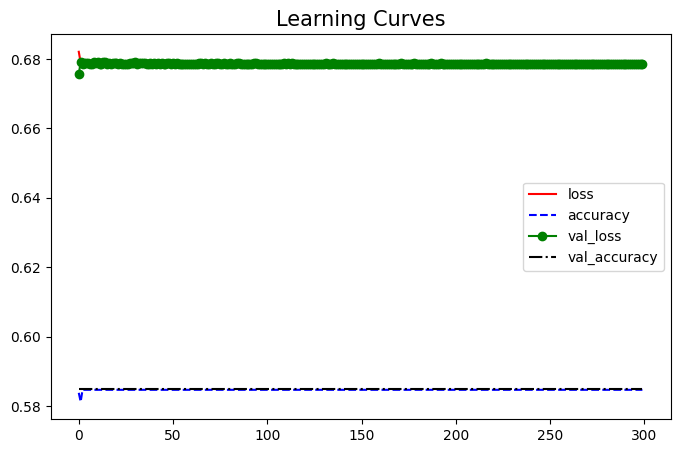

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(11))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


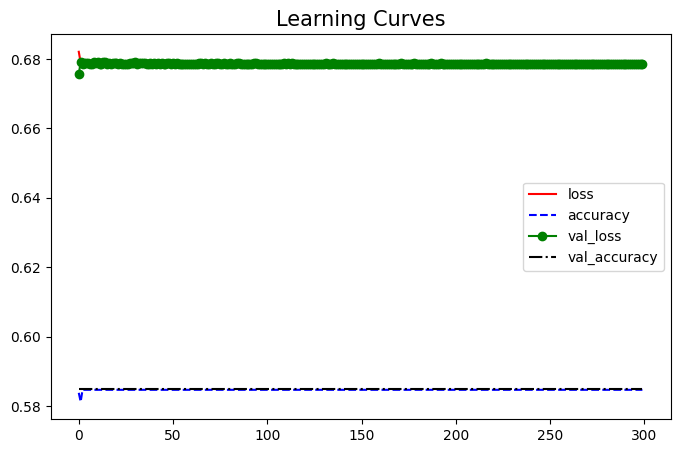

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(11))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


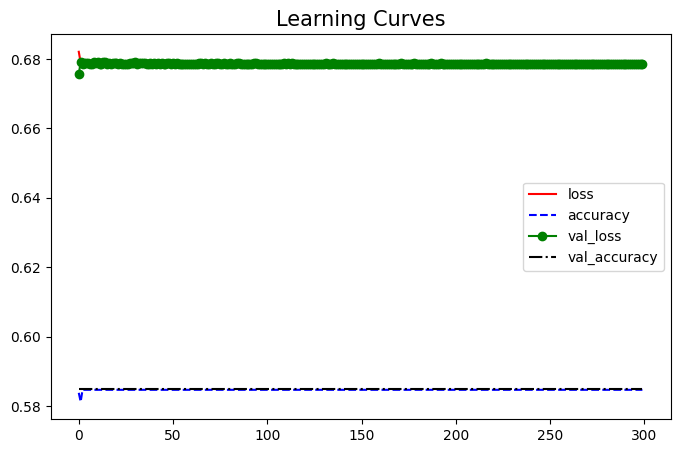

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(11))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


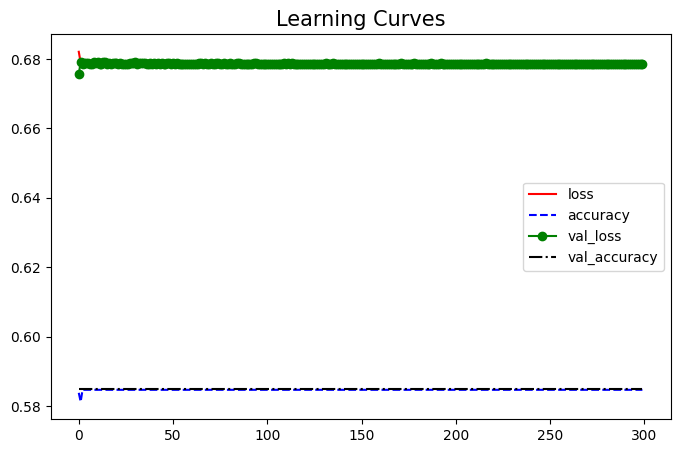

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(11))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


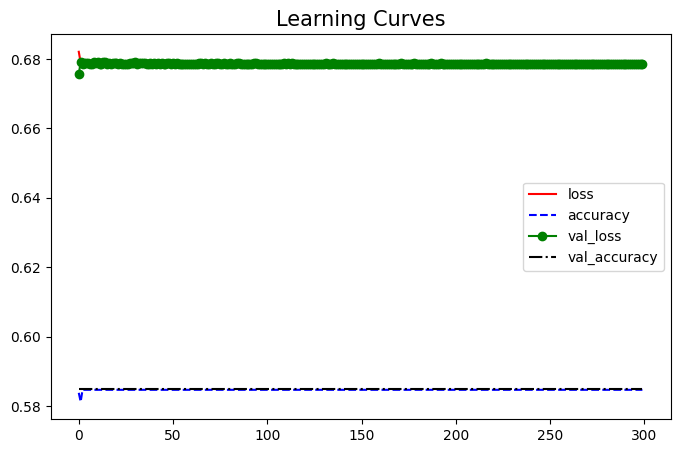

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(11))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


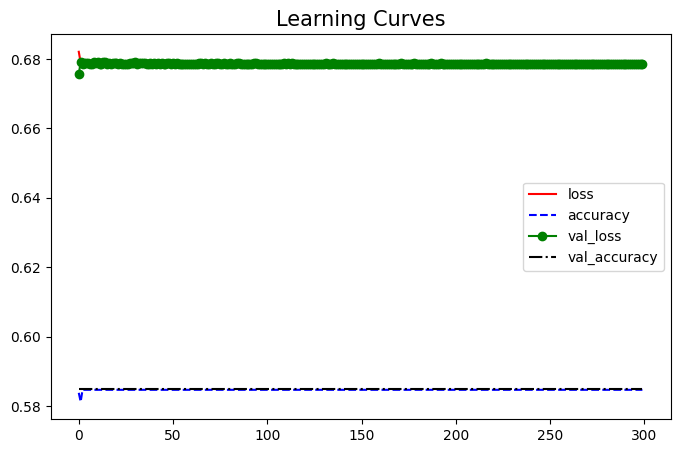

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(11))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


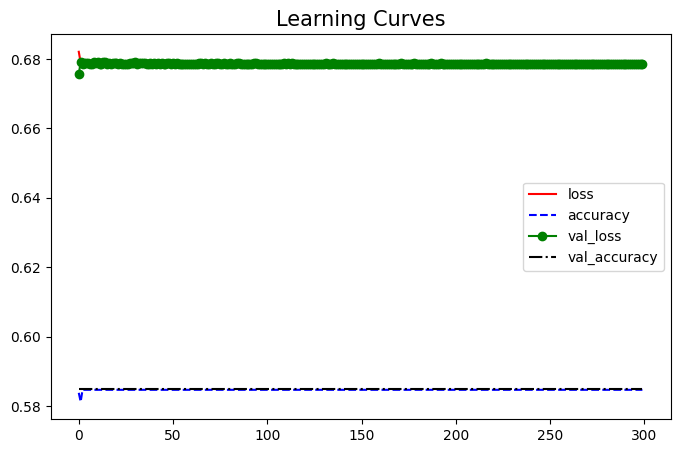

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(11))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


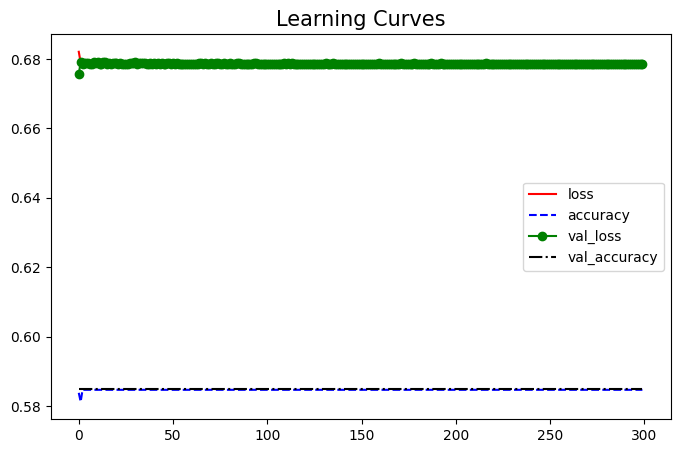

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(11))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


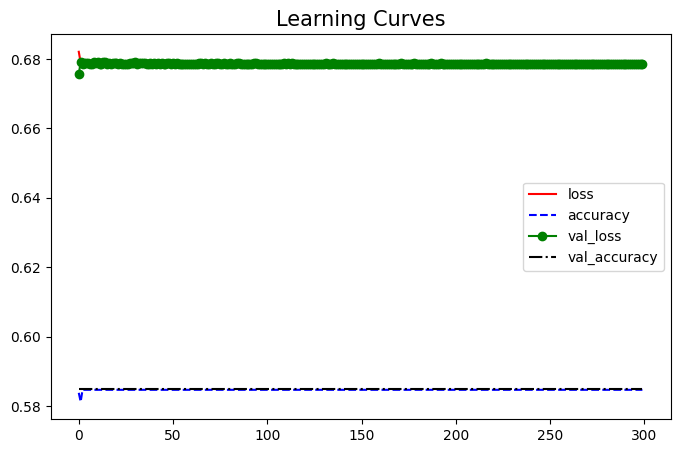

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 12-D AE (4 Layers)

#### 12 Layer Decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(12))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_41 (Dense)            (None, 60)                4560      
                                                                 
 dense_42 (Dense)            (None, 30)                1830      
                                                                 
 dense_43 (Dense)            (None, 15)                465       
                                                                 
 dense_44 (Dense)            (None, 5)                 80        
                                                                 
 dense_45 (Dense)            (None, 10)                60        
                                                                 
 dense_46 (Dense)            (None, 20)                220       
                                                                 
 dense_47 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 12s 20ms/step - loss: 0.6822 - accuracy: 0.5844 - val_loss: 0.6699 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6773 - accuracy: 0.5847 - val_loss: 0.6691 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6768 - accuracy: 0.5847 - val_loss: 0.6643 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 8s 22ms/step - loss: 0.6709 - accuracy: 0.5847 - val_loss: 0.6599 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6655 - accuracy: 0.5847 - val_loss: 0.6568 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 20ms/step - loss: 0.6645 - accuracy: 0.5847 - val_loss: 0.6573 - val_accuracy: 0.6411
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6481 - accuracy: 0.6332 - val_loss: 0.6297 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8412844036697248


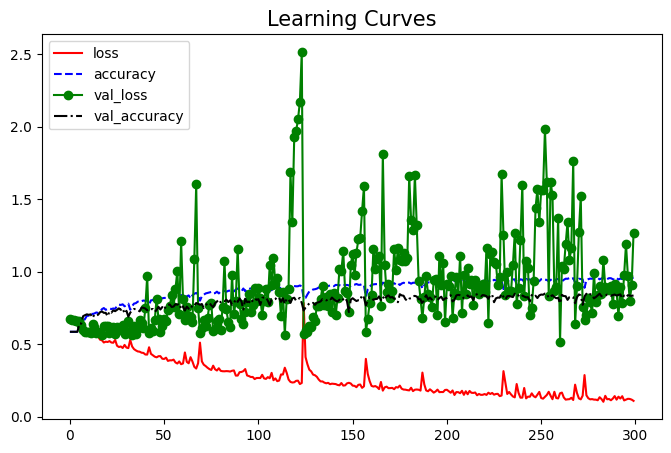

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(12))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


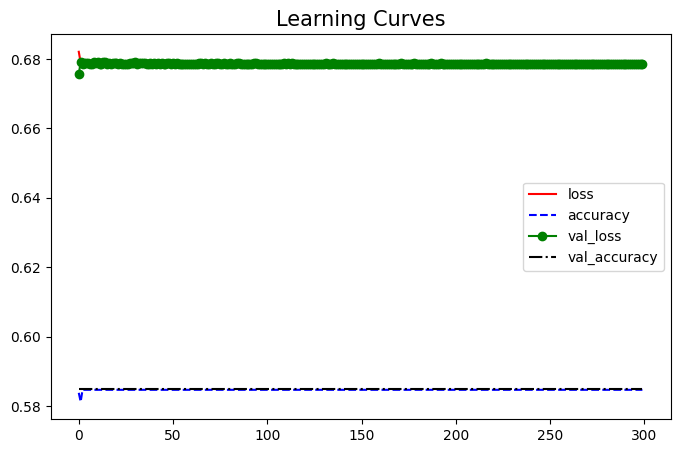

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(12))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


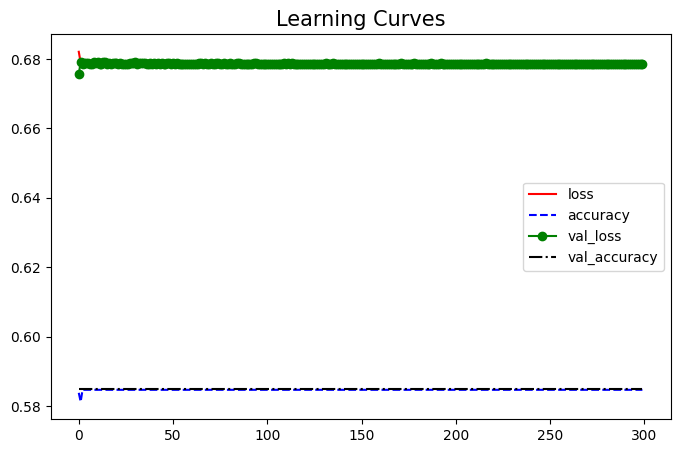

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(12))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


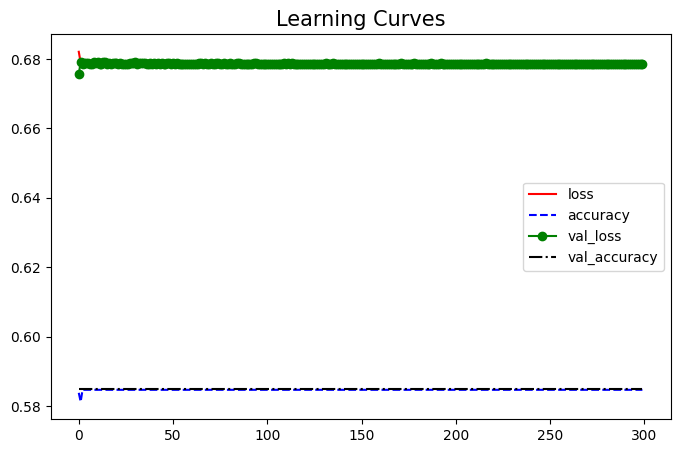

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(12))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


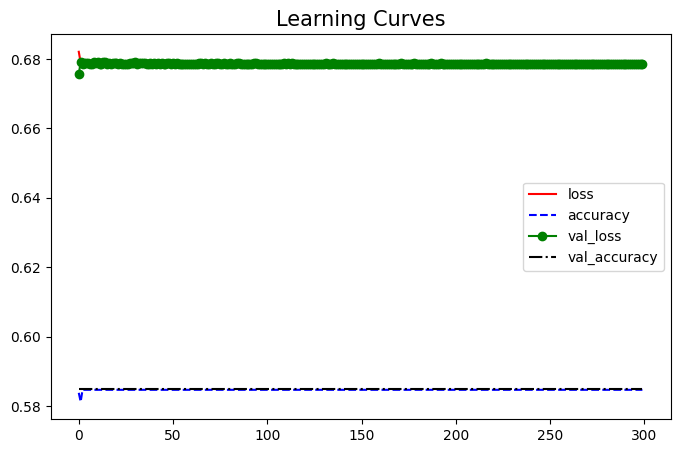

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(12))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


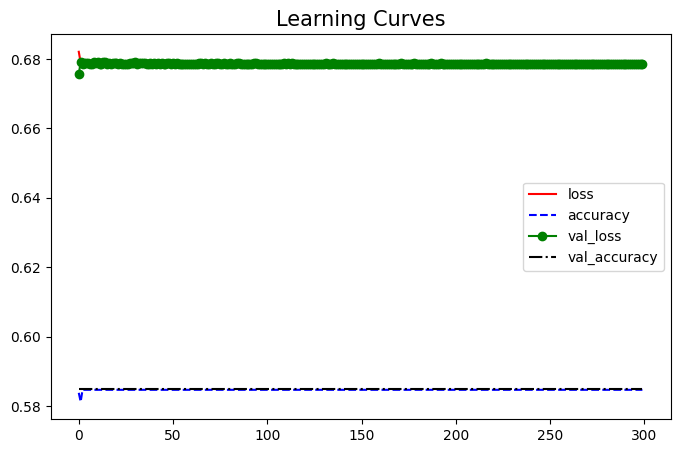

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(12))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


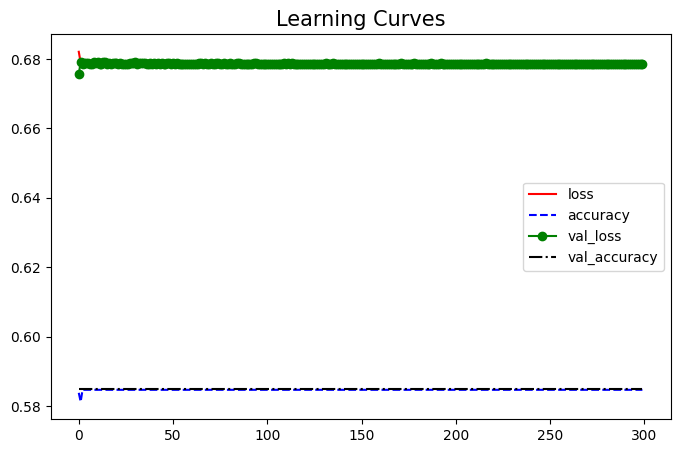

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(12))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


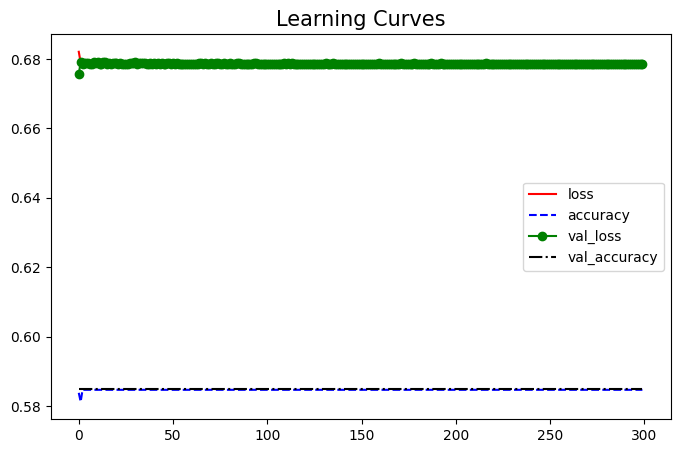

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(12))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


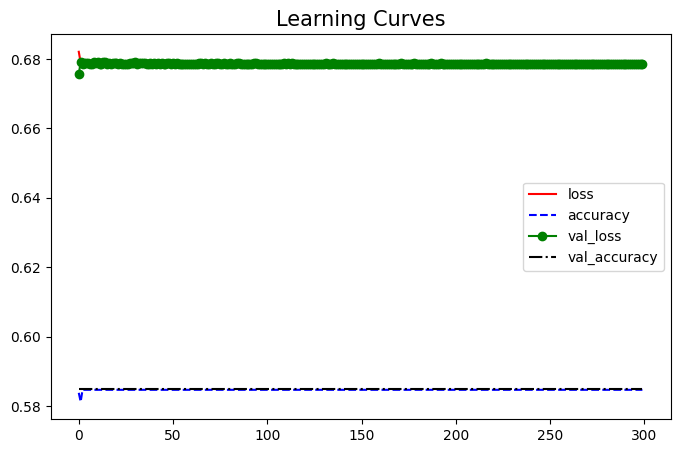

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(12))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


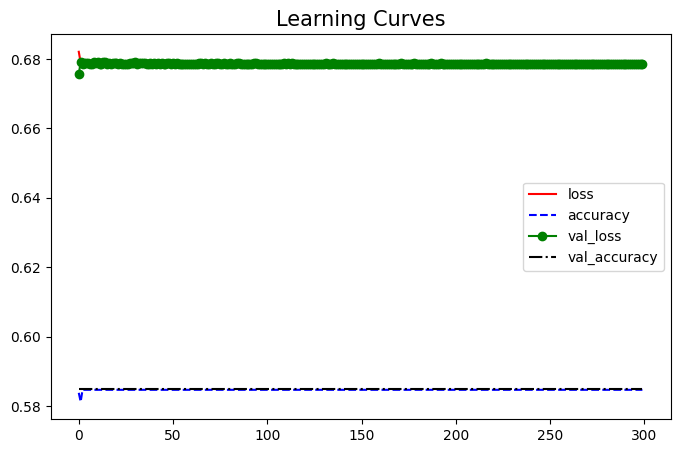

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(12))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


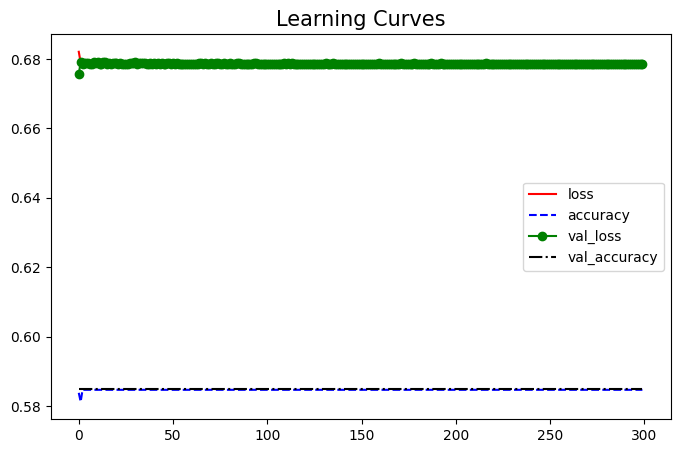

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 13-D AE (4 Layers)

#### 12 Layer Decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(13))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_41 (Dense)            (None, 60)                4560      
                                                                 
 dense_42 (Dense)            (None, 30)                1830      
                                                                 
 dense_43 (Dense)            (None, 15)                465       
                                                                 
 dense_44 (Dense)            (None, 5)                 80        
                                                                 
 dense_45 (Dense)            (None, 10)                60        
                                                                 
 dense_46 (Dense)            (None, 20)                220       
                                                                 
 dense_47 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 12s 20ms/step - loss: 0.6822 - accuracy: 0.5844 - val_loss: 0.6699 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6773 - accuracy: 0.5847 - val_loss: 0.6691 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6768 - accuracy: 0.5847 - val_loss: 0.6643 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 8s 22ms/step - loss: 0.6709 - accuracy: 0.5847 - val_loss: 0.6599 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6655 - accuracy: 0.5847 - val_loss: 0.6568 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 20ms/step - loss: 0.6645 - accuracy: 0.5847 - val_loss: 0.6573 - val_accuracy: 0.6411
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6481 - accuracy: 0.6332 - val_loss: 0.6297 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8412844036697248


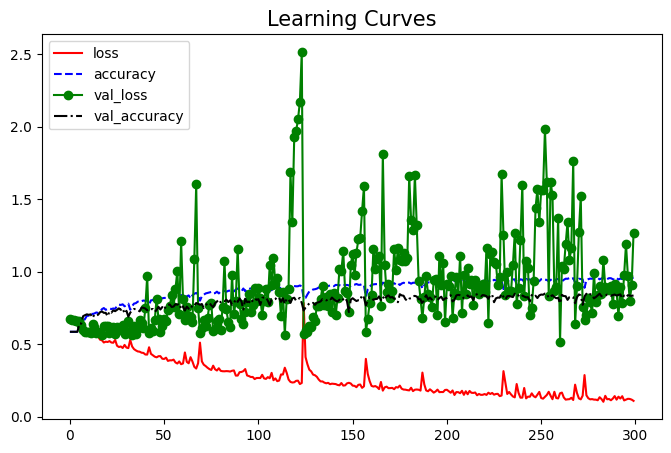

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(13))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


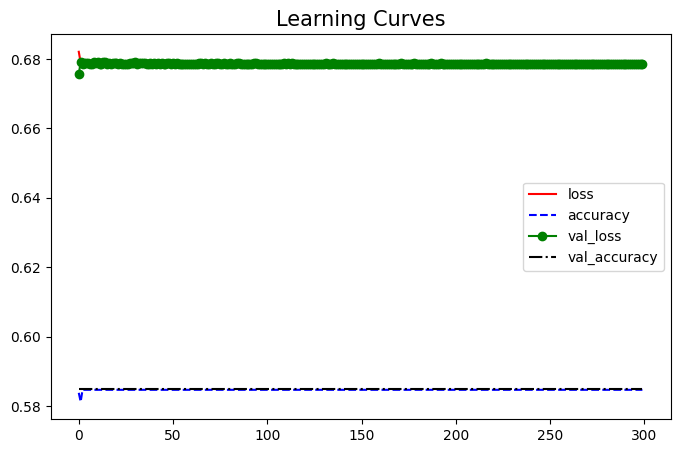

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(13))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


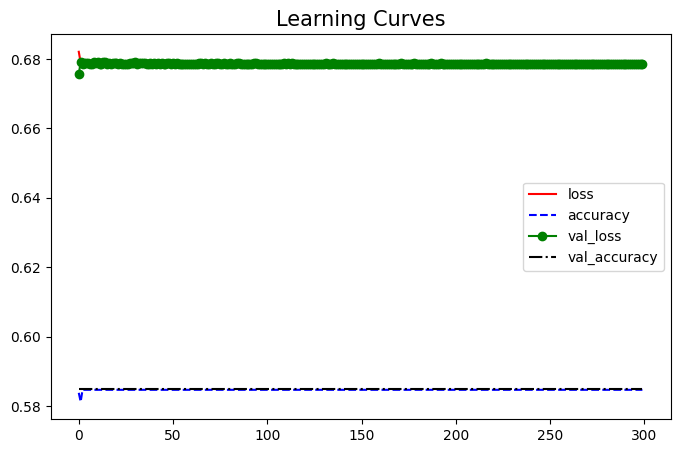

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(13))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


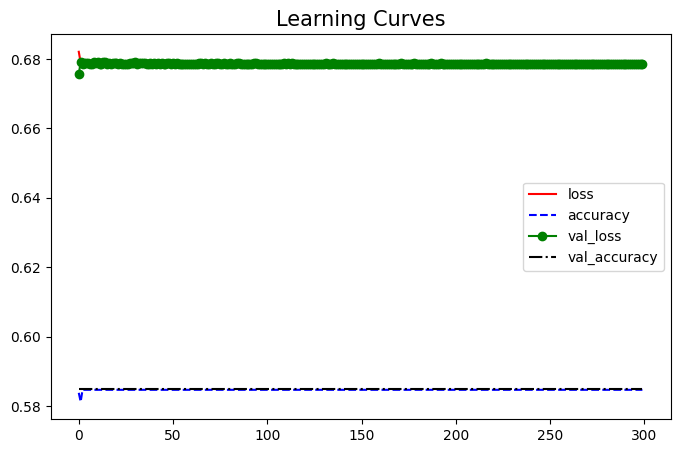

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(13))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


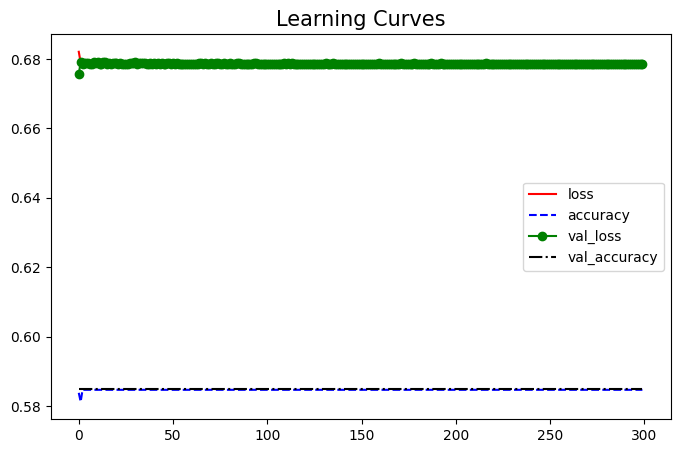

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(13))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


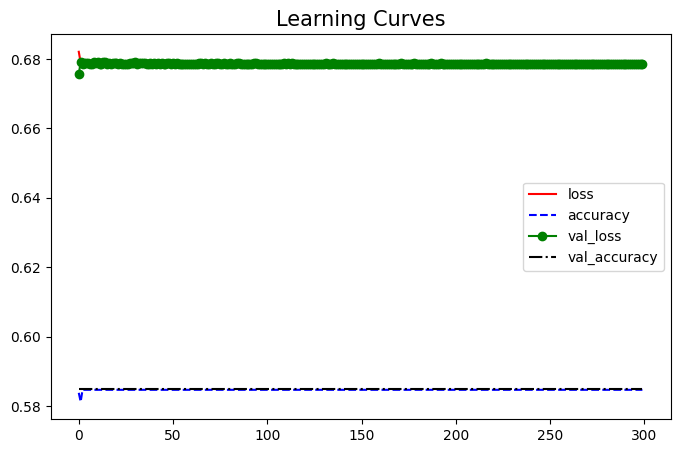

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(13))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


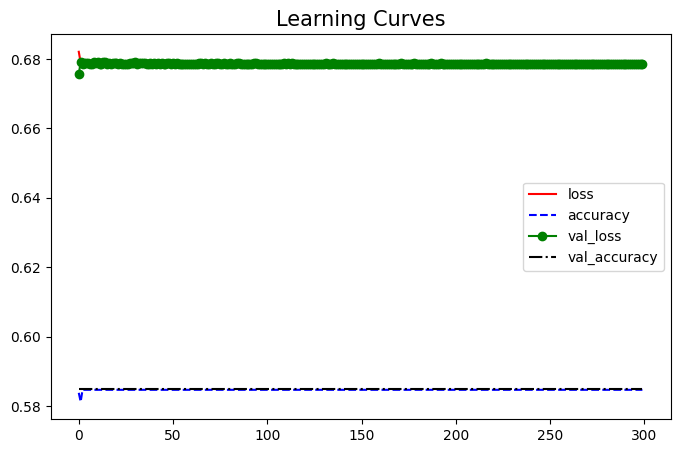

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(13))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


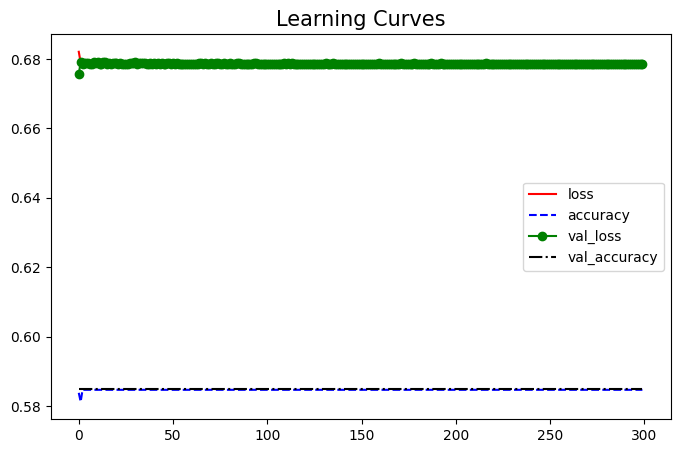

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(13))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


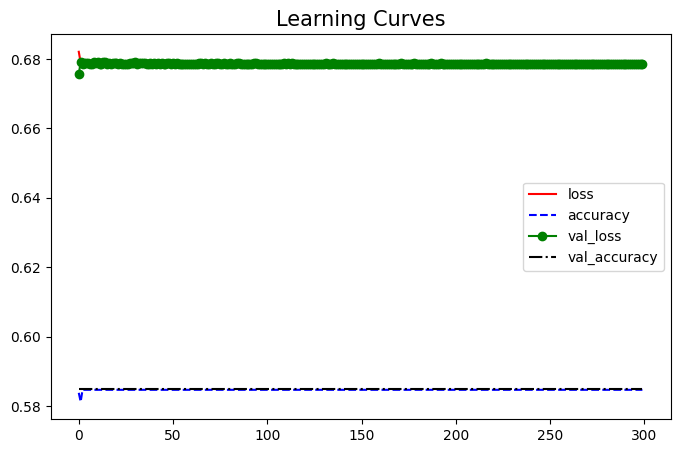

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(13))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


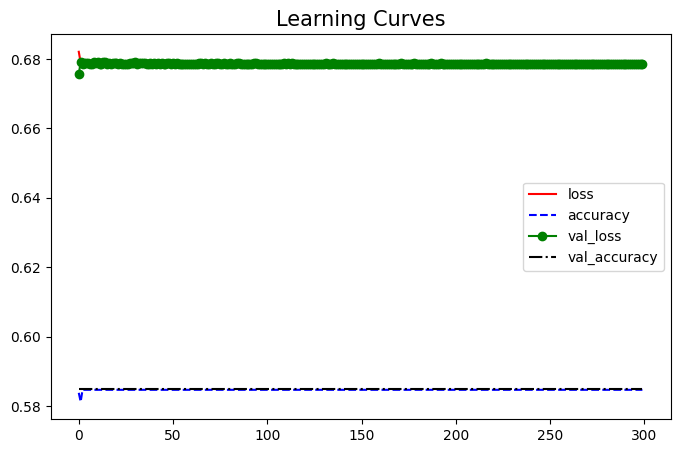

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(13))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


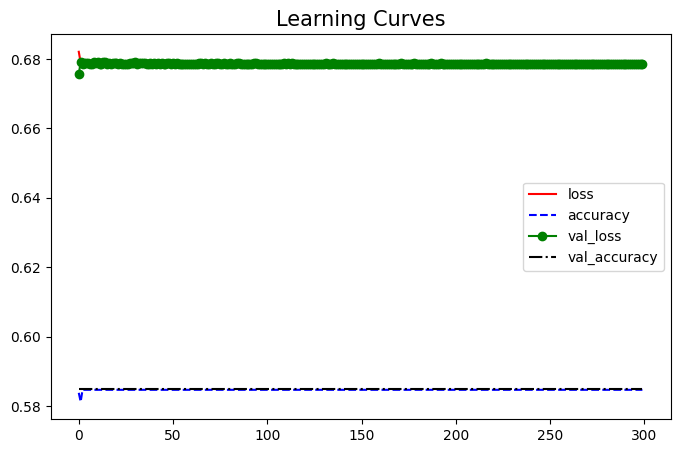

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 14-D AE (4 Layers)

#### 12 Layer Decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(14))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_41 (Dense)            (None, 60)                4560      
                                                                 
 dense_42 (Dense)            (None, 30)                1830      
                                                                 
 dense_43 (Dense)            (None, 15)                465       
                                                                 
 dense_44 (Dense)            (None, 5)                 80        
                                                                 
 dense_45 (Dense)            (None, 10)                60        
                                                                 
 dense_46 (Dense)            (None, 20)                220       
                                                                 
 dense_47 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 12s 20ms/step - loss: 0.6822 - accuracy: 0.5844 - val_loss: 0.6699 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6773 - accuracy: 0.5847 - val_loss: 0.6691 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6768 - accuracy: 0.5847 - val_loss: 0.6643 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 8s 22ms/step - loss: 0.6709 - accuracy: 0.5847 - val_loss: 0.6599 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6655 - accuracy: 0.5847 - val_loss: 0.6568 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 20ms/step - loss: 0.6645 - accuracy: 0.5847 - val_loss: 0.6573 - val_accuracy: 0.6411
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6481 - accuracy: 0.6332 - val_loss: 0.6297 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8412844036697248


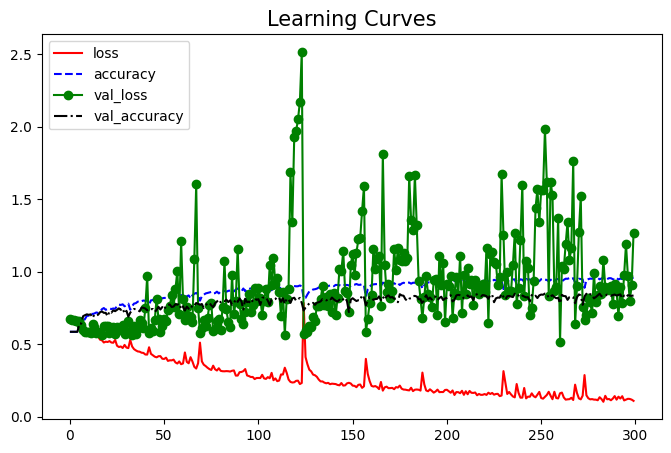

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(14))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


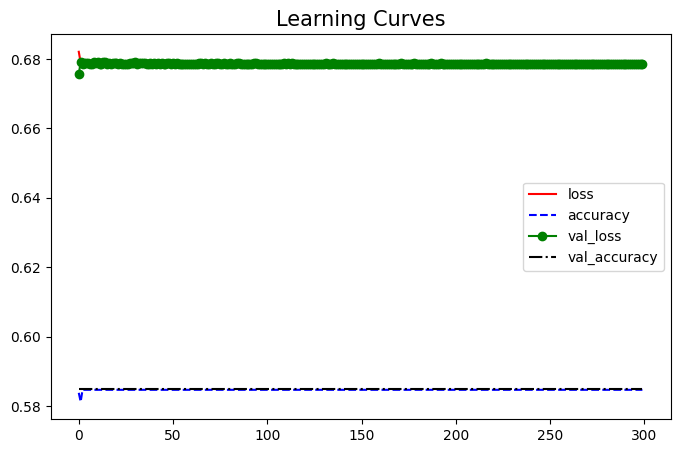

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(14))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


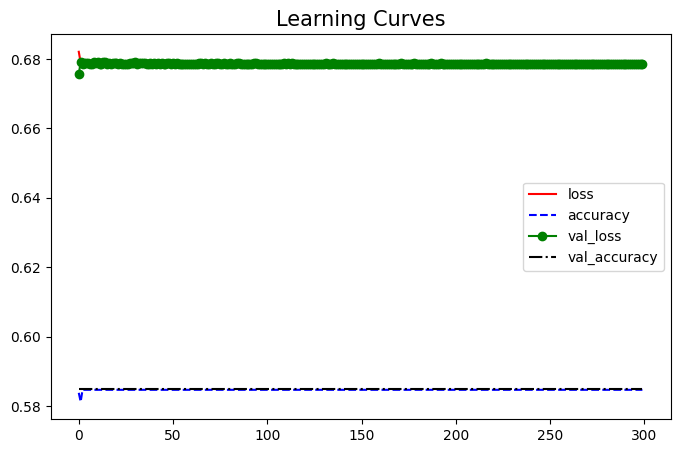

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(14))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


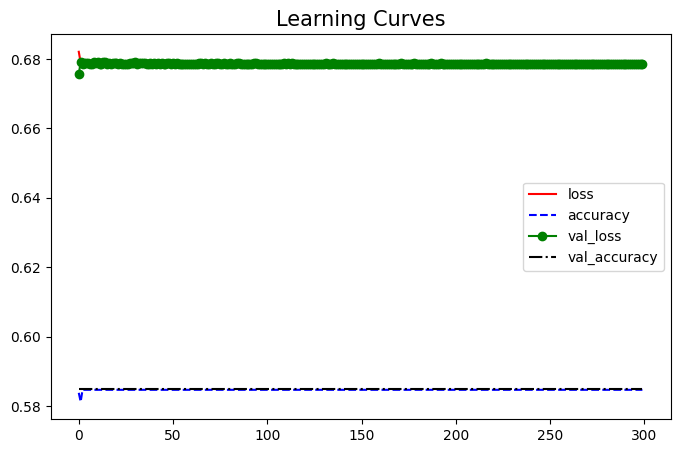

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(14))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


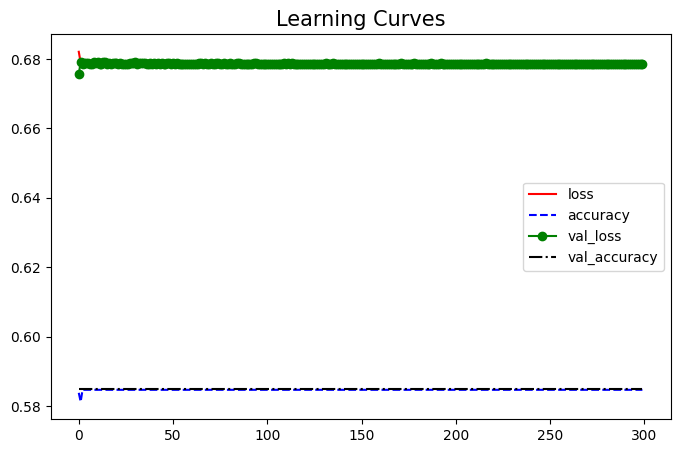

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(14))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


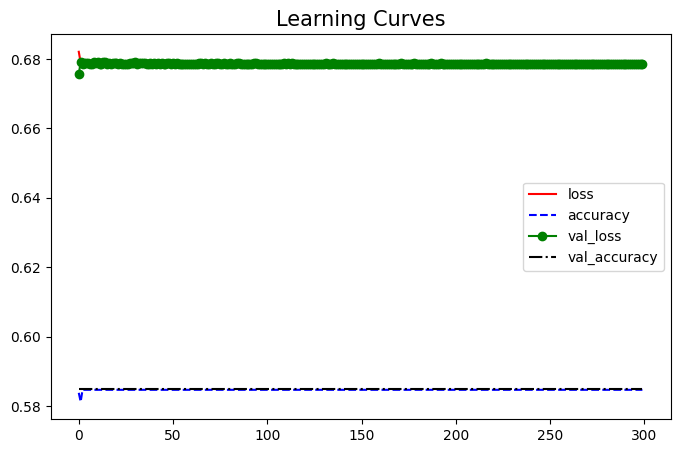

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(14))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


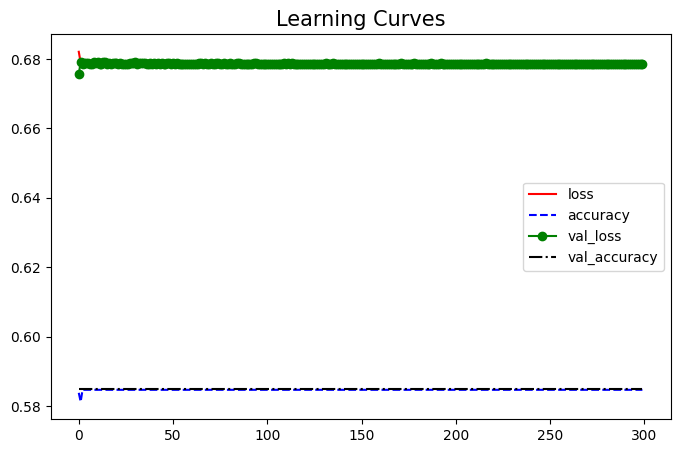

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(14))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


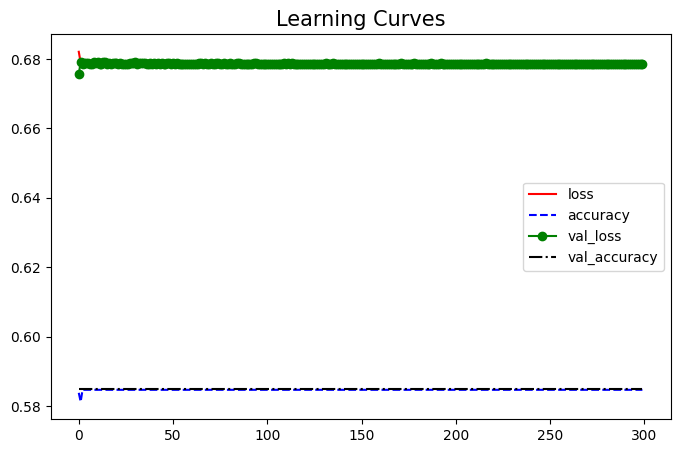

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(14))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


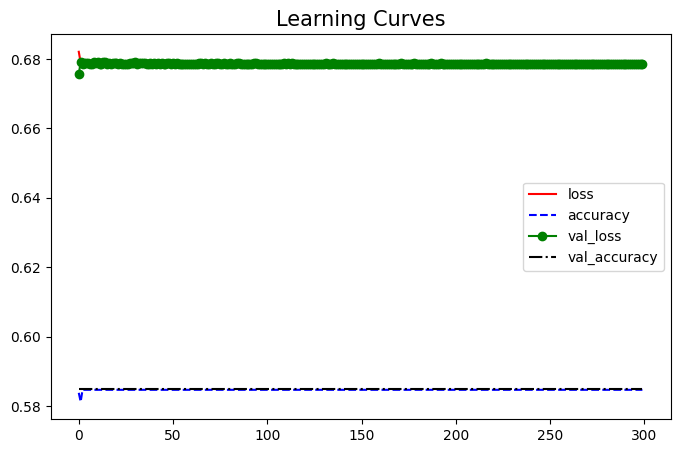

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(14))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


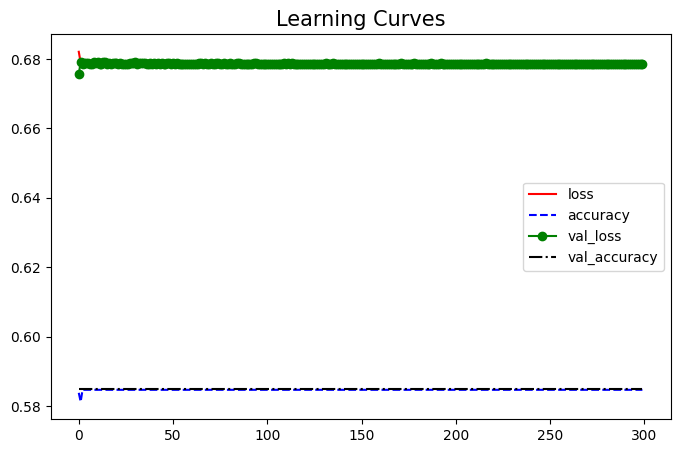

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(14))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


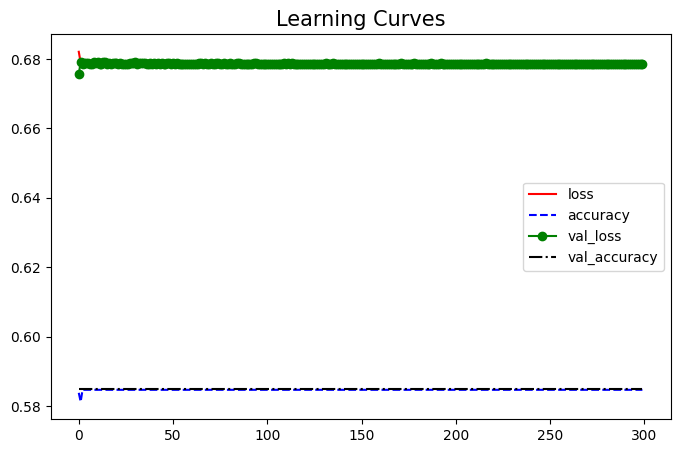

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 15-D AE (4 Layers)

#### 12 layer decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_71 (Dense)            (None, 60)                4560      
                                                                 
 dense_72 (Dense)            (None, 30)                1830      
                                                                 
 dense_73 (Dense)            (None, 20)                620       
                                                                 
 dense_74 (Dense)            (None, 15)                315       
                                                                 
 dense_75 (Dense)            (None, 10)                160       
                                                                 
 dense_76 (Dense)            (None, 20)                220       
                                                                 
 dense_77 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 8s 15ms/step - loss: 0.6797 - accuracy: 0.5838 - val_loss: 0.6666 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 3s 9ms/step - loss: 0.6729 - accuracy: 0.5881 - val_loss: 0.6690 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 3s 10ms/step - loss: 0.6666 - accuracy: 0.5993 - val_loss: 0.6733 - val_accuracy: 0.6227
Epoch 4/300
349/349 [==============================] - 4s 10ms/step - loss: 0.6645 - accuracy: 0.6019 - val_loss: 0.6616 - val_accuracy: 0.6170
Epoch 5/300
349/349 [==============================] - 5s 14ms/step - loss: 0.6546 - accuracy: 0.6237 - val_loss: 0.6422 - val_accuracy: 0.6468
Epoch 6/300
349/349 [==============================] - 3s 9ms/step - loss: 0.6454 - accuracy: 0.6470 - val_loss: 0.6479 - val_accuracy: 0.6330
Epoch 7/300
349/349 [==============================] - 3s 9ms/step - loss: 0.6515 - accuracy: 0.6217 - val_loss: 0.6711 - val_accuracy: 0.

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8174311926605504


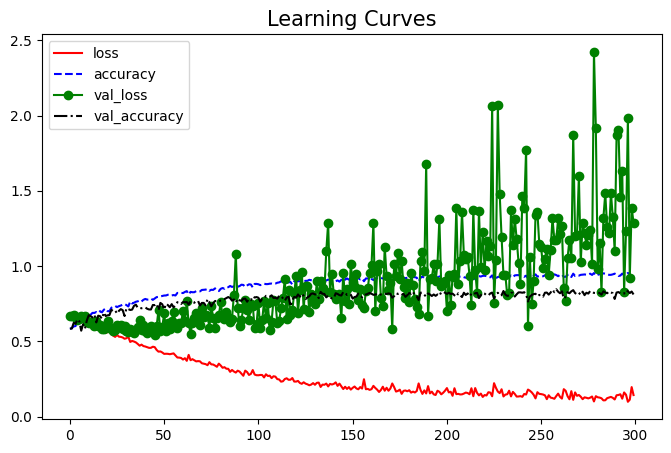

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


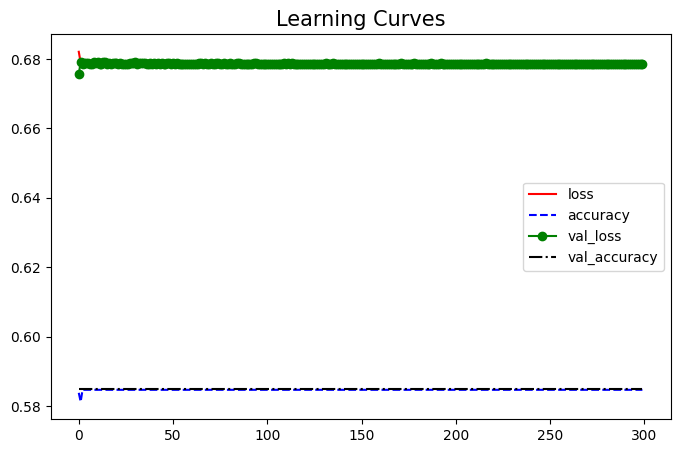

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


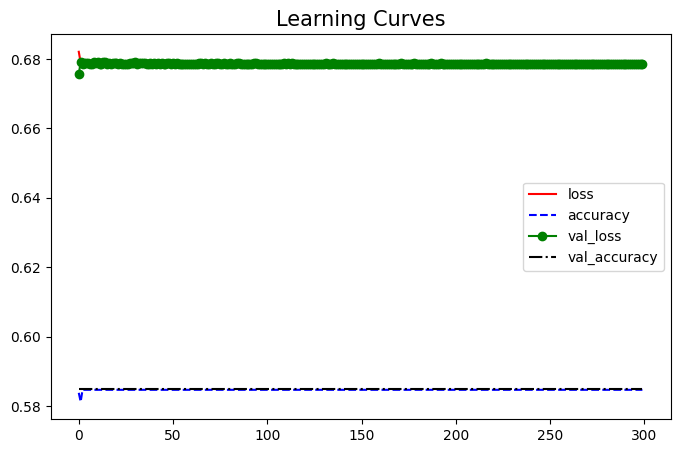

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


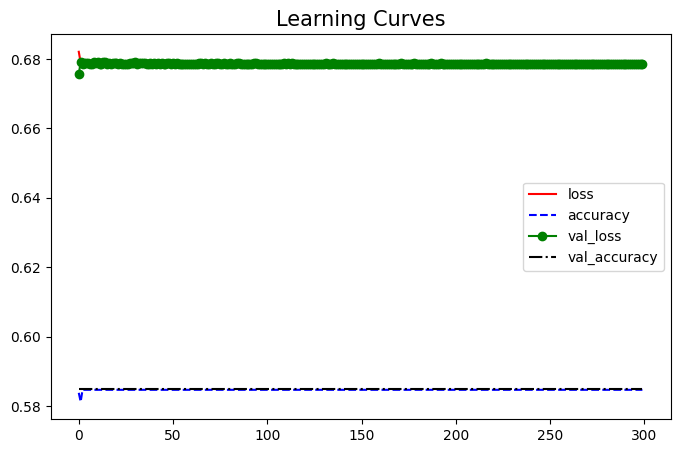

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


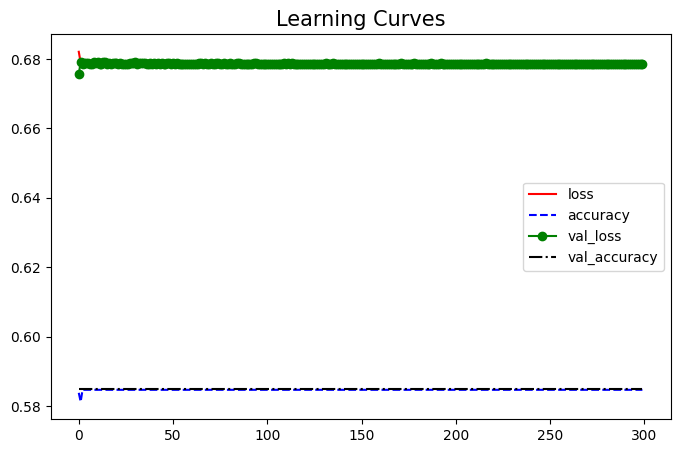

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


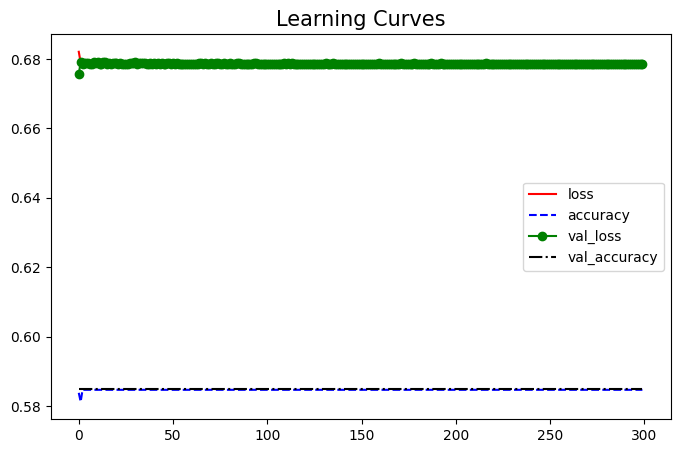

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


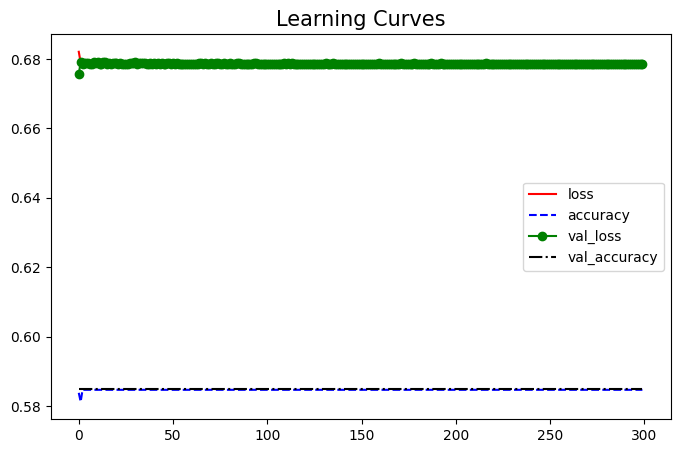

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


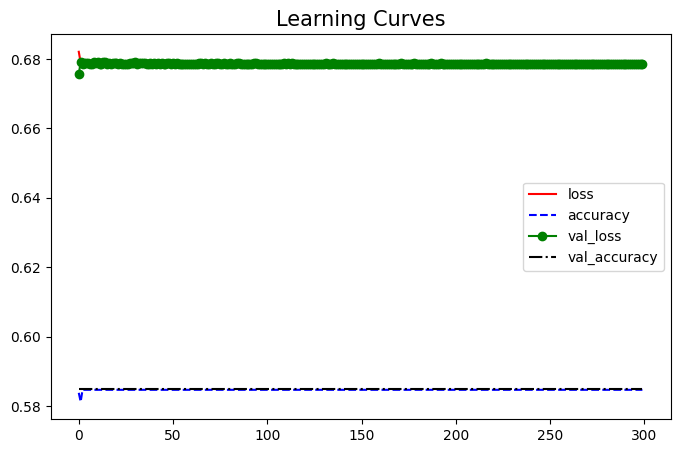

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


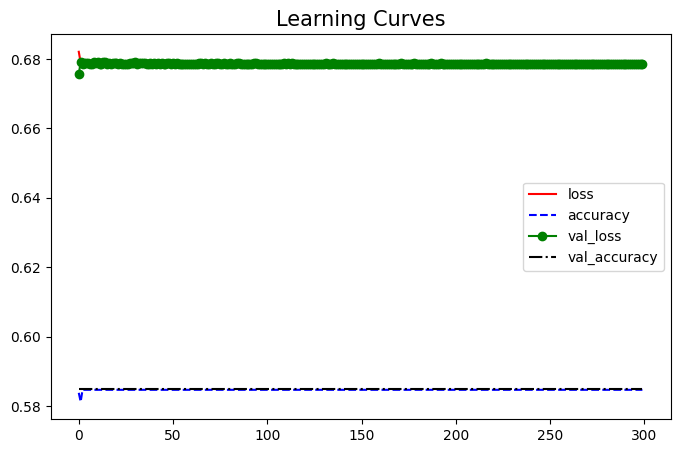

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


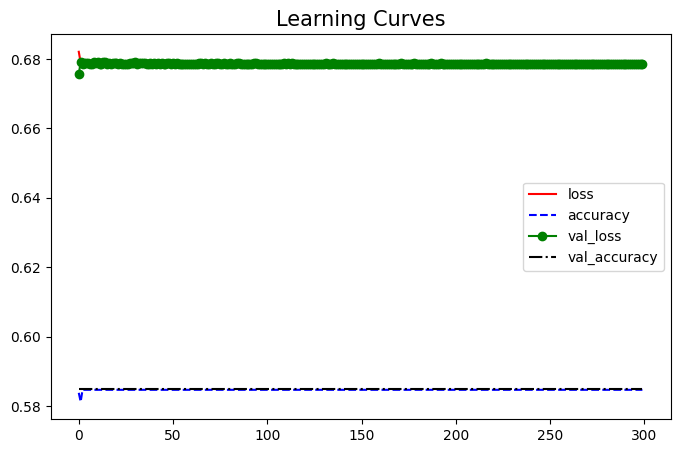

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


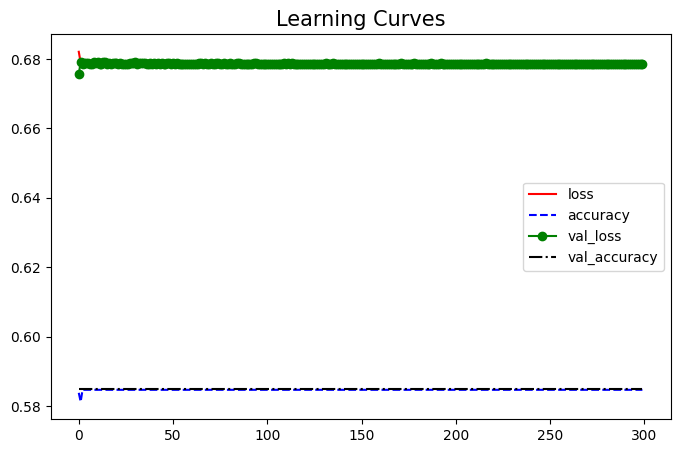

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 1-D AE (4 Layers)

#### 12 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


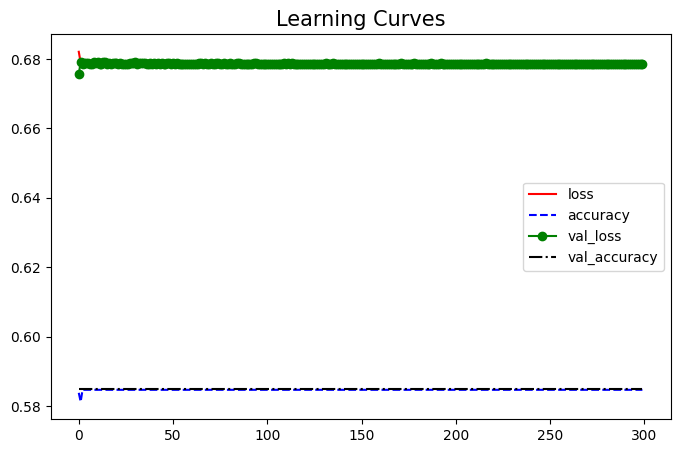

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


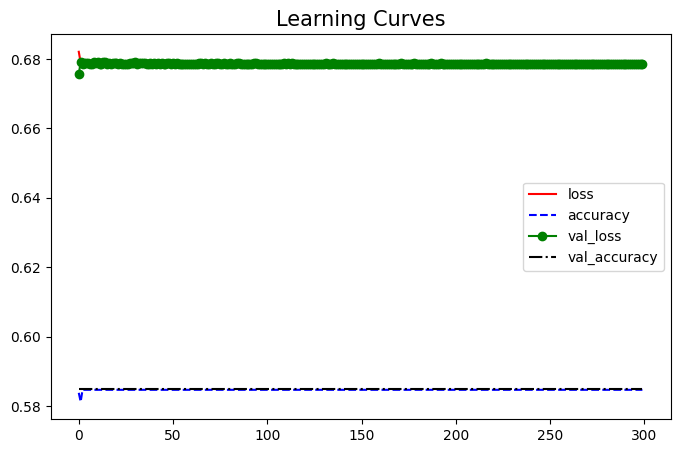

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


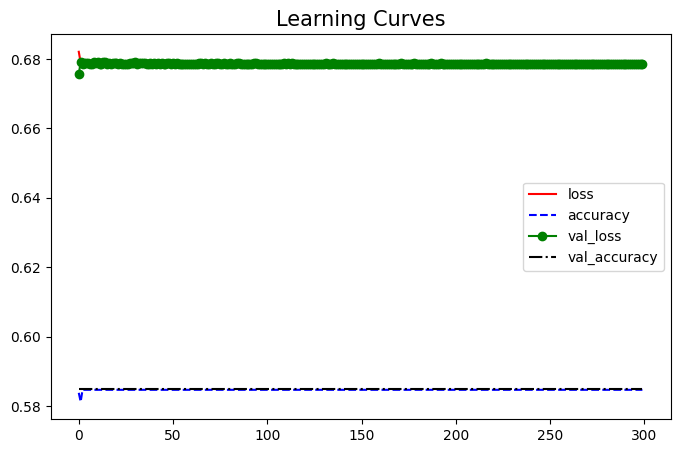

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


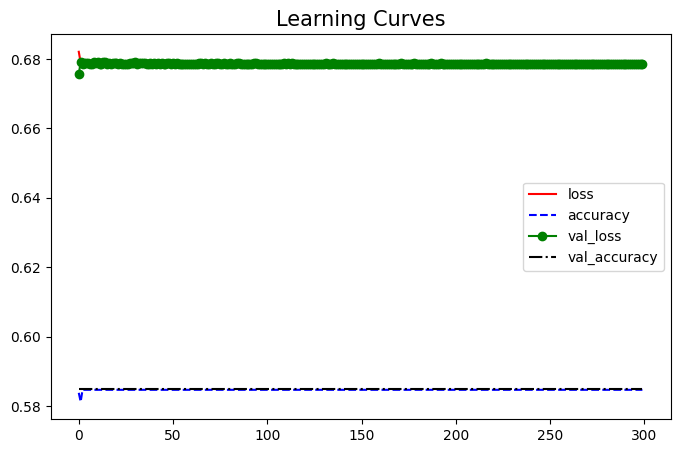

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


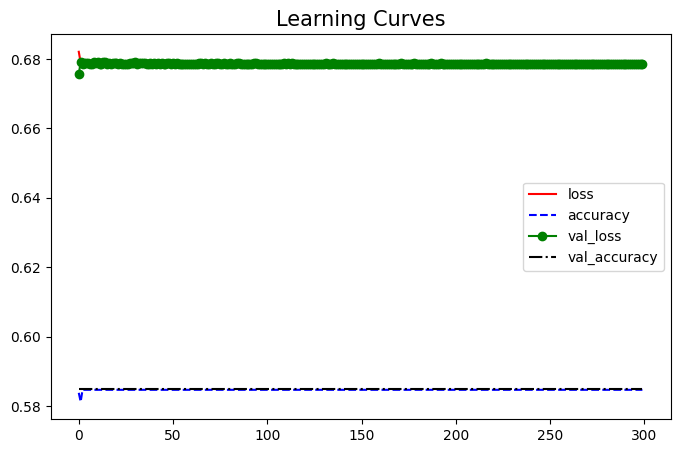

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


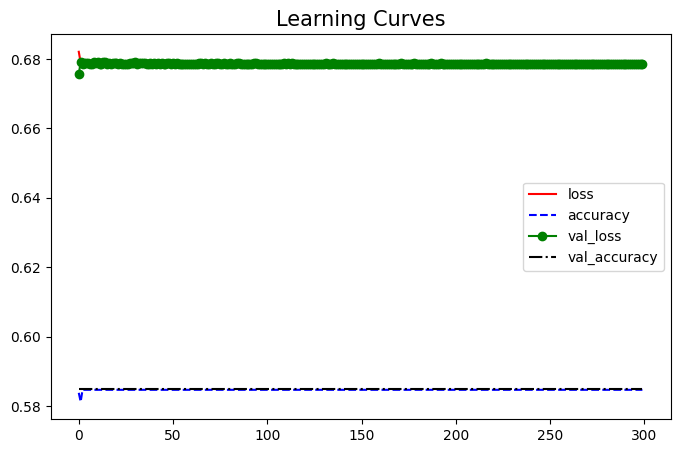

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


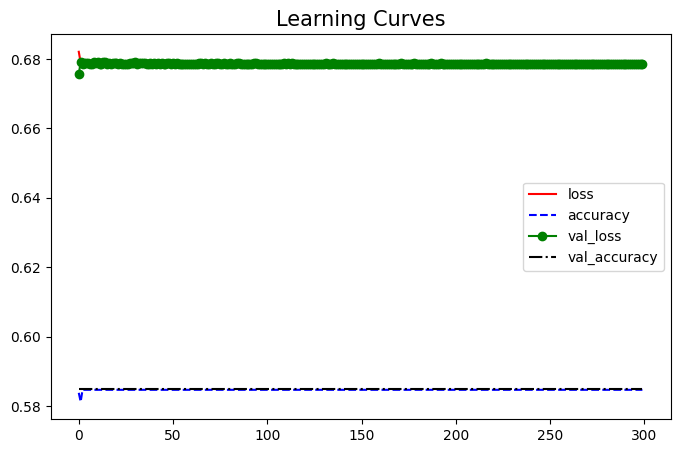

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


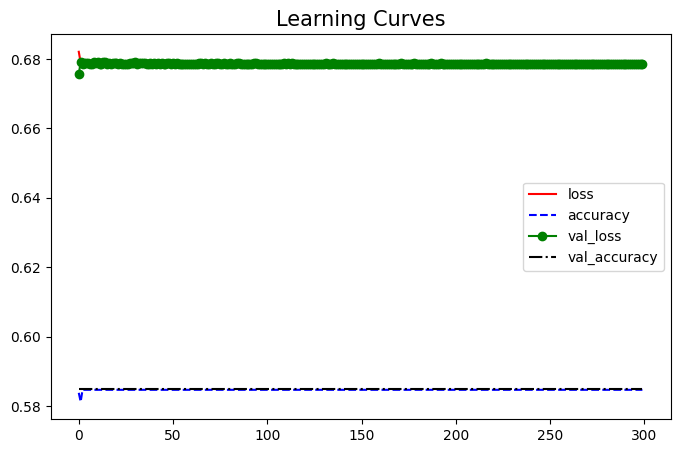

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


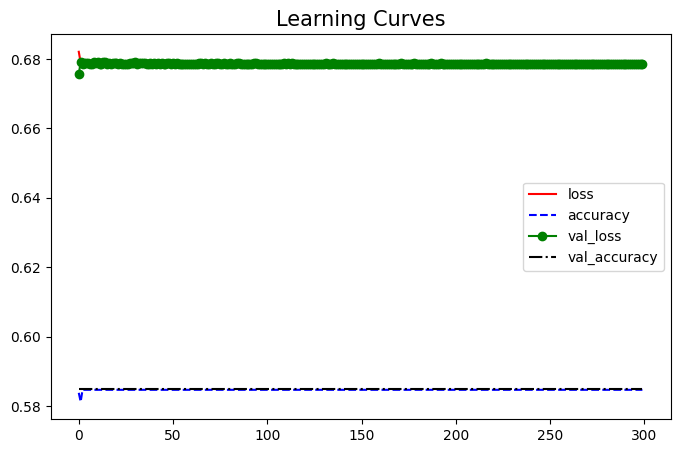

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


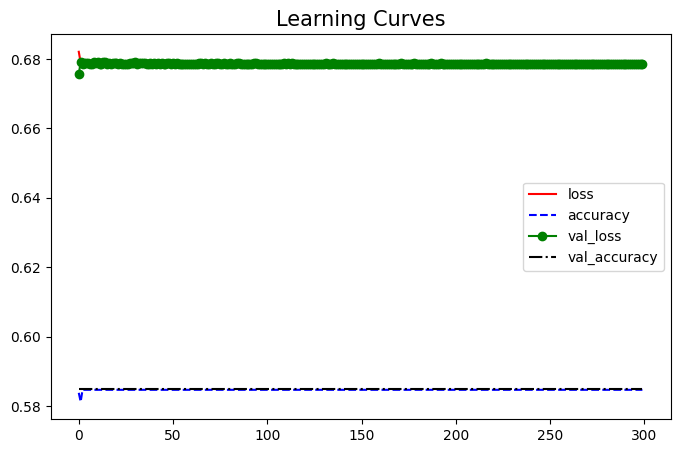

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


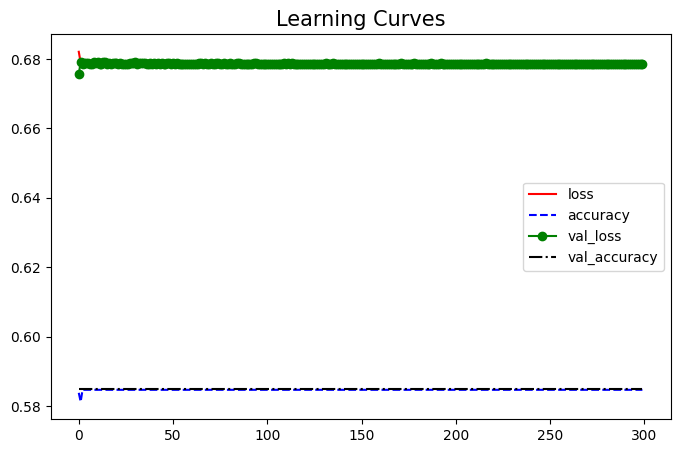

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 2-D AE (4 Layers)

#### 12 Layers Decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_48 (Dense)            (None, 60)                4560      
                                                                 
 dense_49 (Dense)            (None, 30)                1830      
                                                                 
 dense_50 (Dense)            (None, 15)                465       
                                                                 
 dense_51 (Dense)            (None, 2)                 32        
                                                                 
 dense_52 (Dense)            (None, 10)                30        
                                                                 
 dense_53 (Dense)            (None, 20)                220       
                                                                 
 dense_54 (Dense)            (None, 40)              

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 4s 6ms/step - loss: 0.6811 - accuracy: 0.5844 - val_loss: 0.6722 - val_accuracy: 0.5975
Epoch 2/300
349/349 [==============================] - 2s 5ms/step - loss: 0.6773 - accuracy: 0.5838 - val_loss: 0.6787 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 3s 8ms/step - loss: 0.6720 - accuracy: 0.5870 - val_loss: 0.6738 - val_accuracy: 0.5505
Epoch 4/300
349/349 [==============================] - 2s 5ms/step - loss: 0.6709 - accuracy: 0.5801 - val_loss: 0.6687 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 2s 5ms/step - loss: 0.6642 - accuracy: 0.5985 - val_loss: 0.6511 - val_accuracy: 0.6273
Epoch 6/300
349/349 [==============================] - 2s 5ms/step - loss: 0.6566 - accuracy: 0.6139 - val_loss: 0.6526 - val_accuracy: 0.6502
Epoch 7/300
349/349 [==============================] - 2s 5ms/step - loss: 0.6506 - accuracy: 0.6312 - val_loss: 0.6564 - val_accuracy: 0.6365

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 2ms/step
The accuracy on testing dataset:  0.8330275229357799


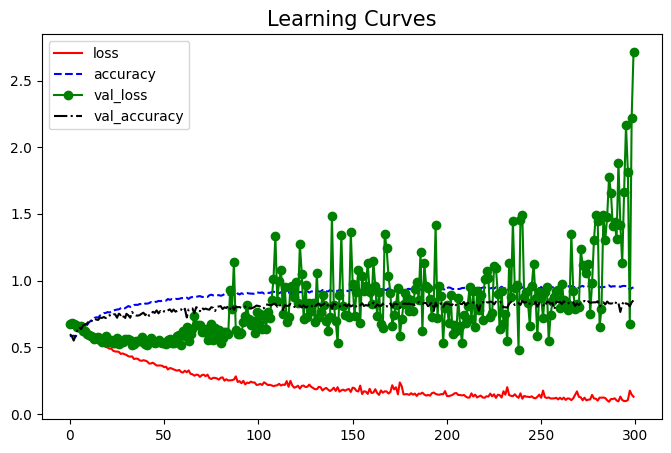

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


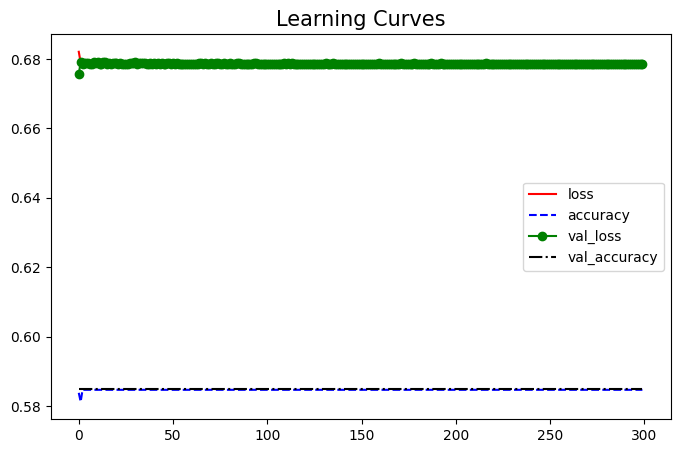

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


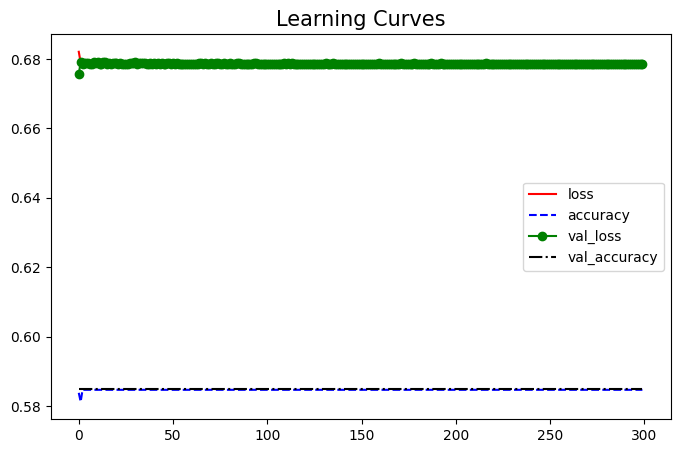

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


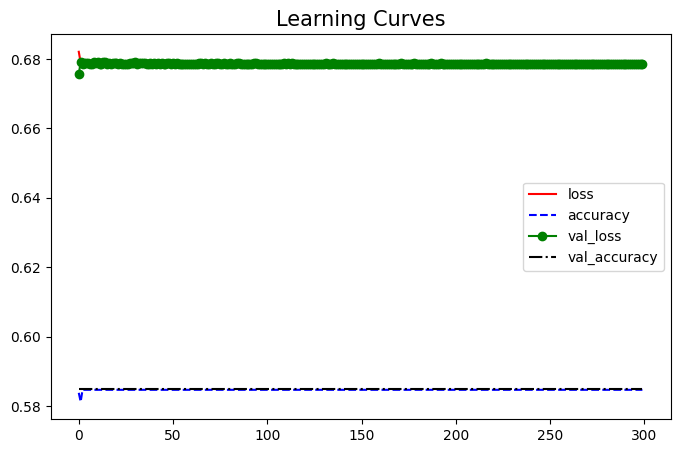

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


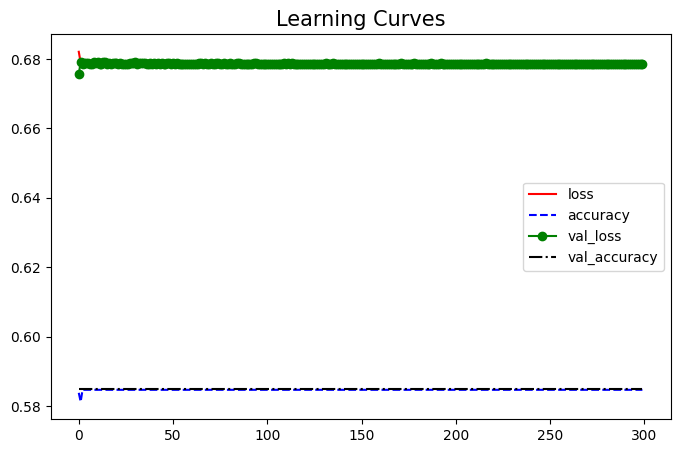

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


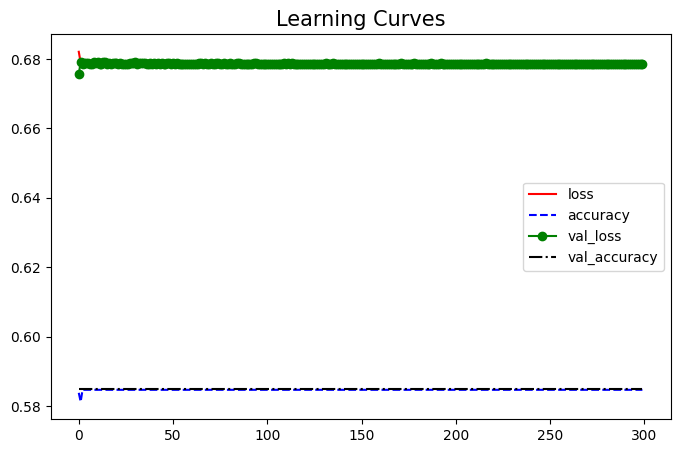

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


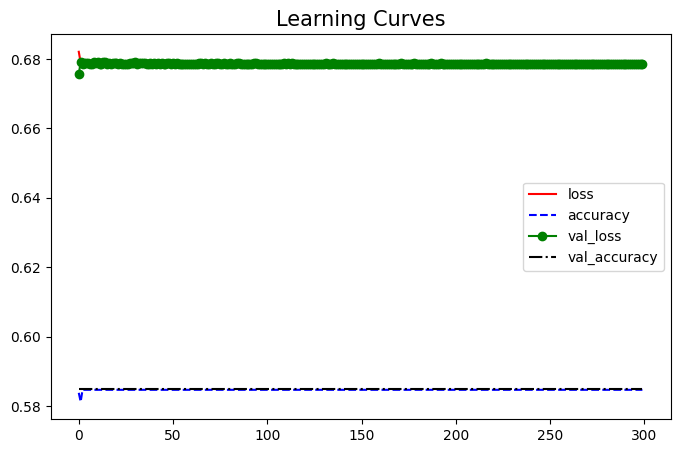

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


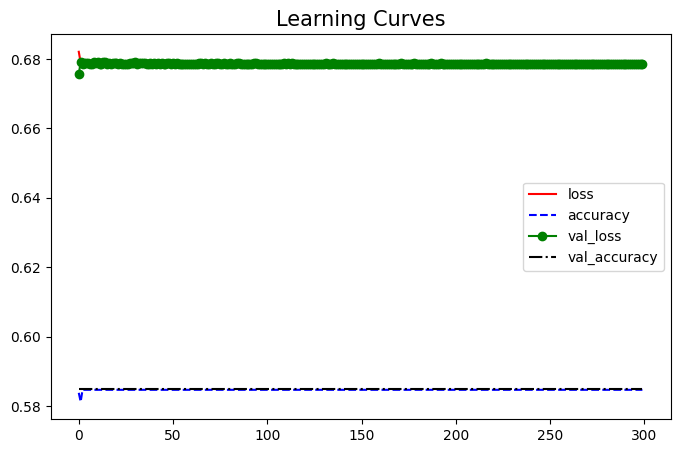

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


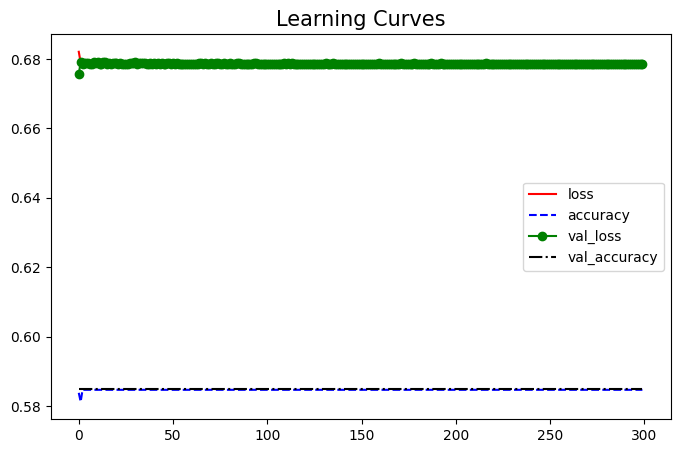

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


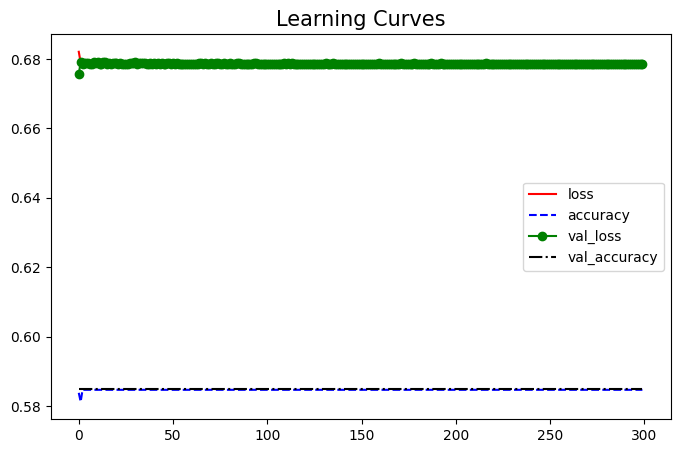

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


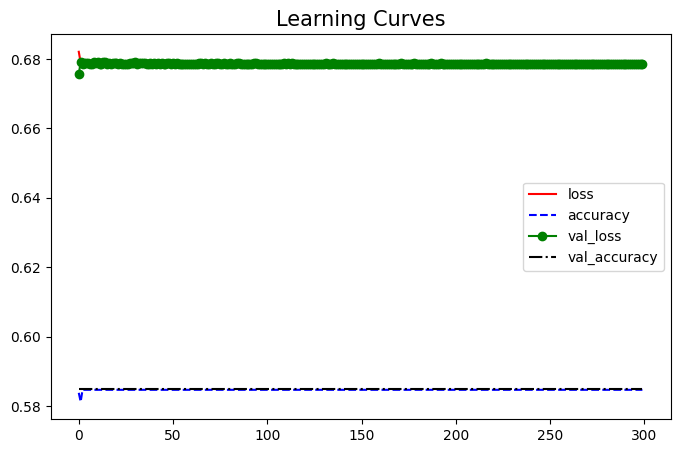

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


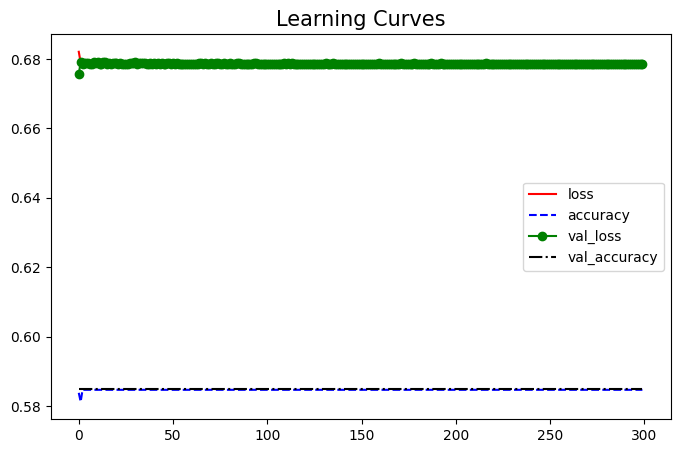

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 3-D AE (4 Layers)

#### 12 layer decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_26 (Dense)            (None, 60)                4560      
                                                                 
 dense_27 (Dense)            (None, 30)                1830      
                                                                 
 dense_28 (Dense)            (None, 15)                465       
                                                                 
 dense_29 (Dense)            (None, 3)                 48        
                                                                 
 dense_30 (Dense)            (None, 10)                40        
                                                                 
 dense_31 (Dense)            (None, 20)                220       
                                                                 
 dense_32 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 11s 20ms/step - loss: 0.6785 - accuracy: 0.5784 - val_loss: 0.6770 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6728 - accuracy: 0.5852 - val_loss: 0.6596 - val_accuracy: 0.6376
Epoch 3/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6798 - accuracy: 0.5801 - val_loss: 0.6559 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6727 - accuracy: 0.5832 - val_loss: 0.6766 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6702 - accuracy: 0.5801 - val_loss: 0.6599 - val_accuracy: 0.5860
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6780 - accuracy: 0.5847 - val_loss: 0.6790 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6761 - accuracy: 0.5850 - val_loss: 0.6618 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 6ms/step
The accuracy on testing dataset:  0.810091743119266


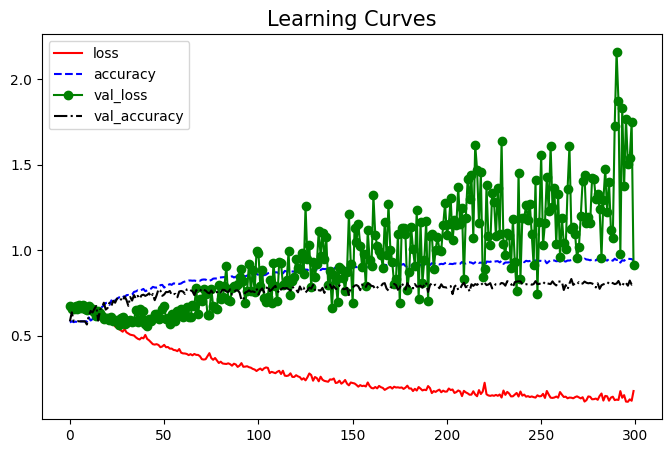

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


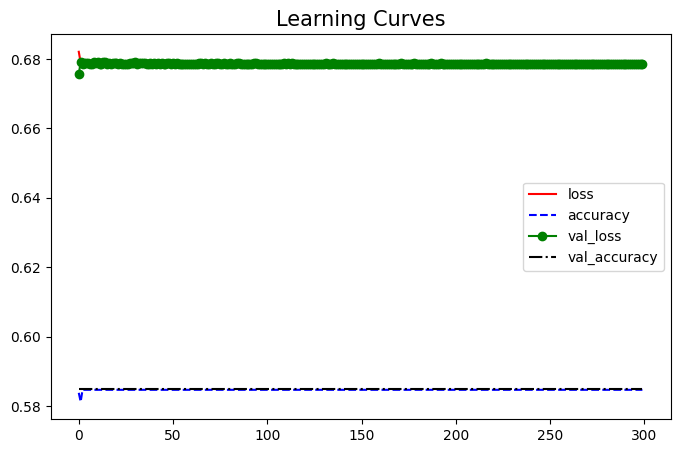

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


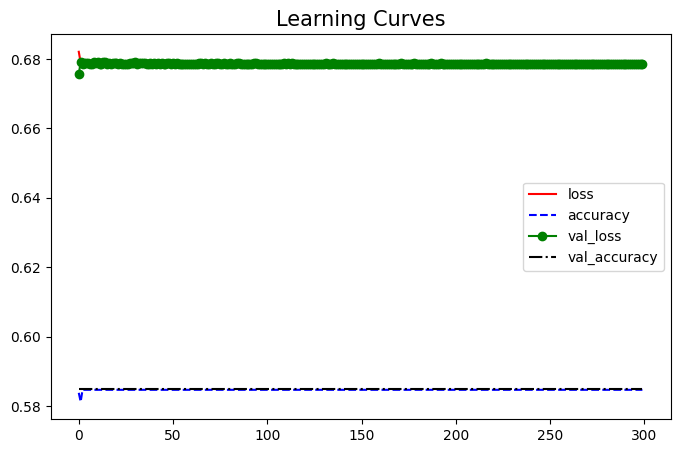

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


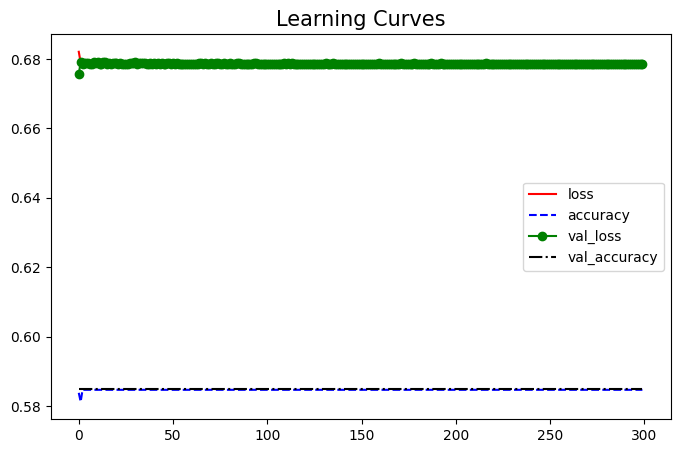

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


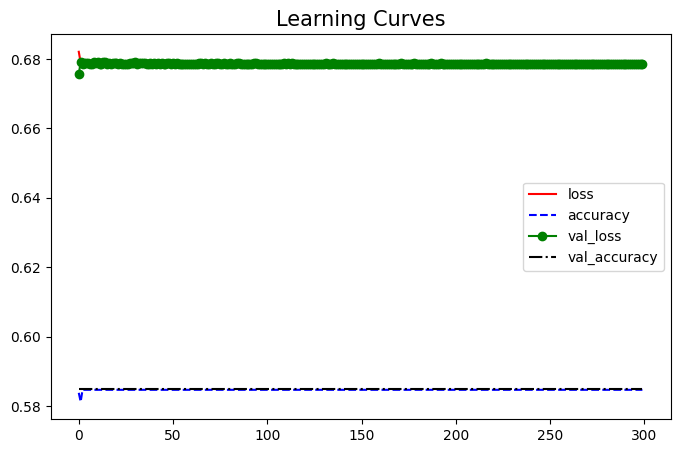

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


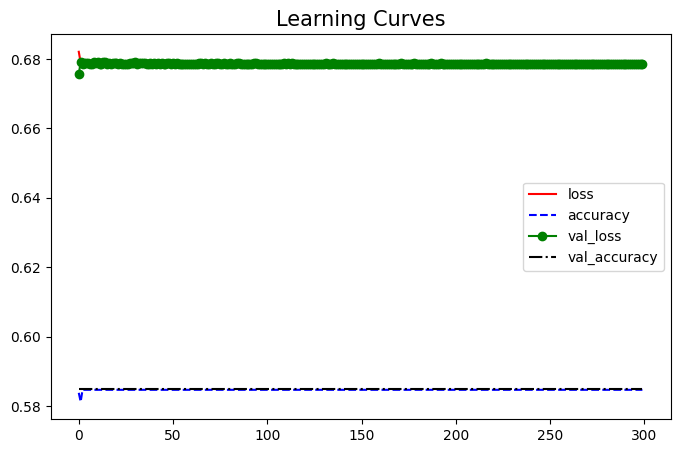

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


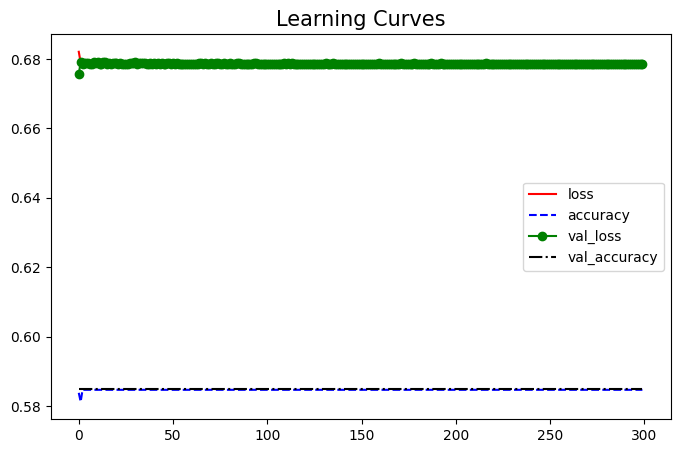

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


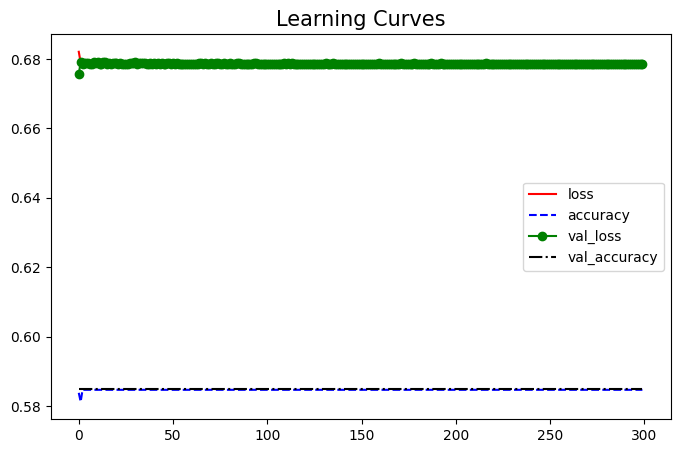

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


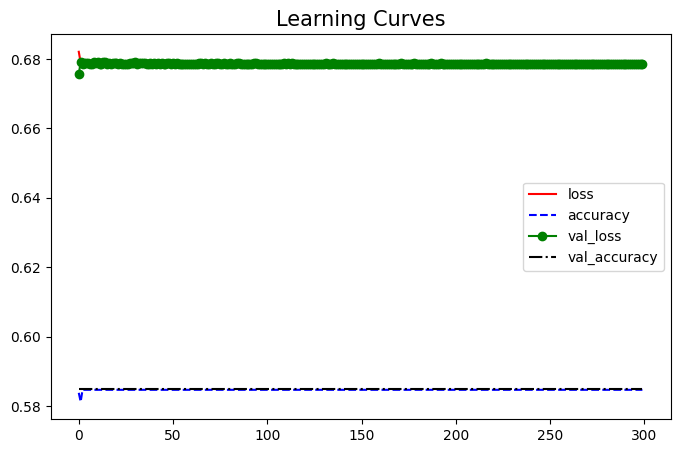

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


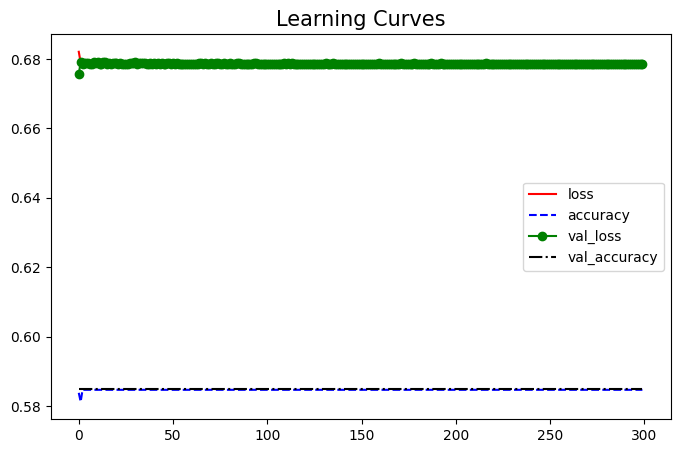

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


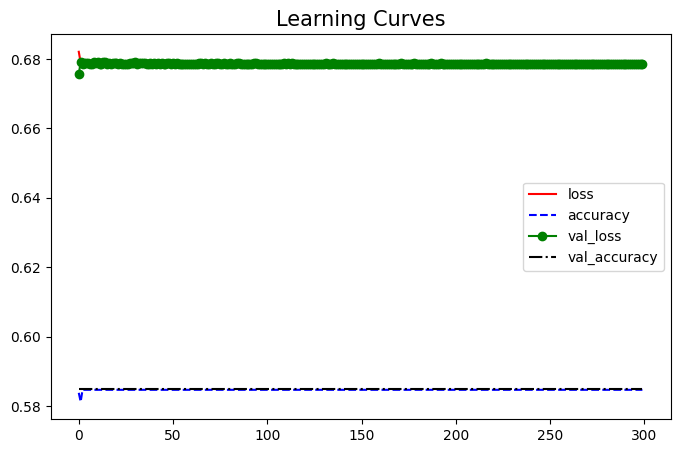

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 5-D AE (4 Layers)

#### 12 Layer Decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_41 (Dense)            (None, 60)                4560      
                                                                 
 dense_42 (Dense)            (None, 30)                1830      
                                                                 
 dense_43 (Dense)            (None, 15)                465       
                                                                 
 dense_44 (Dense)            (None, 5)                 80        
                                                                 
 dense_45 (Dense)            (None, 10)                60        
                                                                 
 dense_46 (Dense)            (None, 20)                220       
                                                                 
 dense_47 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 12s 20ms/step - loss: 0.6822 - accuracy: 0.5844 - val_loss: 0.6699 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6773 - accuracy: 0.5847 - val_loss: 0.6691 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6768 - accuracy: 0.5847 - val_loss: 0.6643 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 8s 22ms/step - loss: 0.6709 - accuracy: 0.5847 - val_loss: 0.6599 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6655 - accuracy: 0.5847 - val_loss: 0.6568 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 20ms/step - loss: 0.6645 - accuracy: 0.5847 - val_loss: 0.6573 - val_accuracy: 0.6411
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6481 - accuracy: 0.6332 - val_loss: 0.6297 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8412844036697248


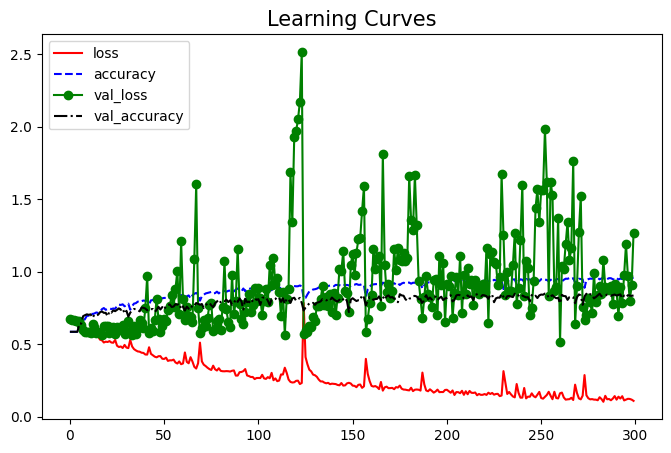

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


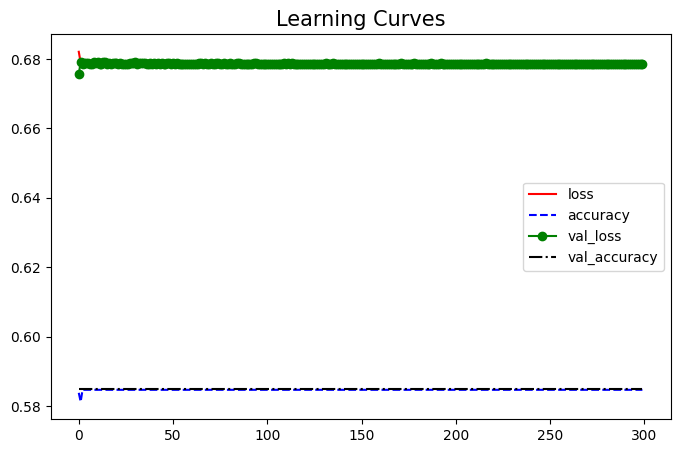

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


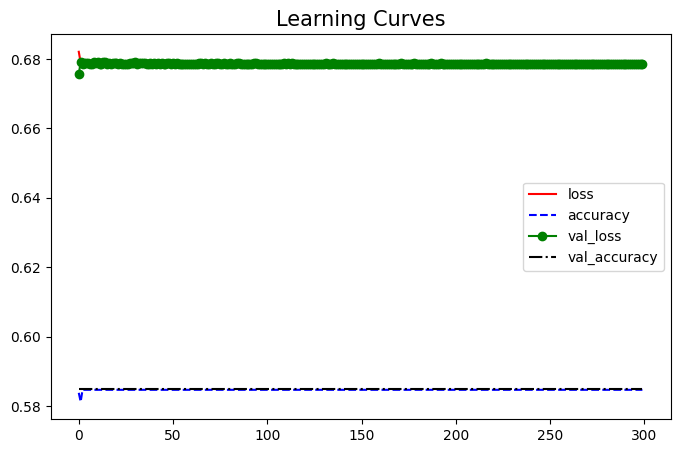

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


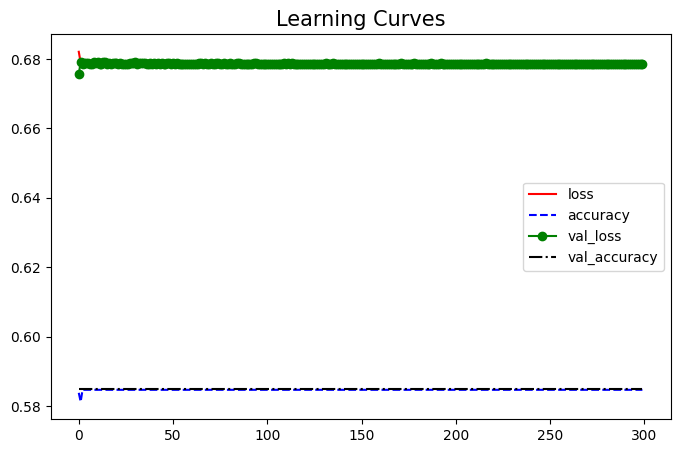

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


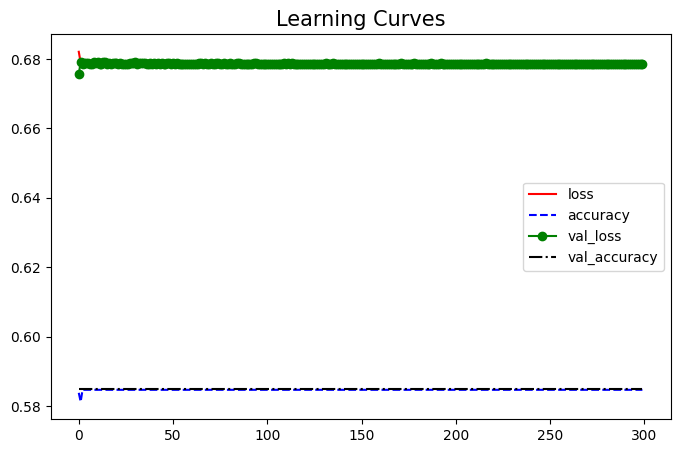

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


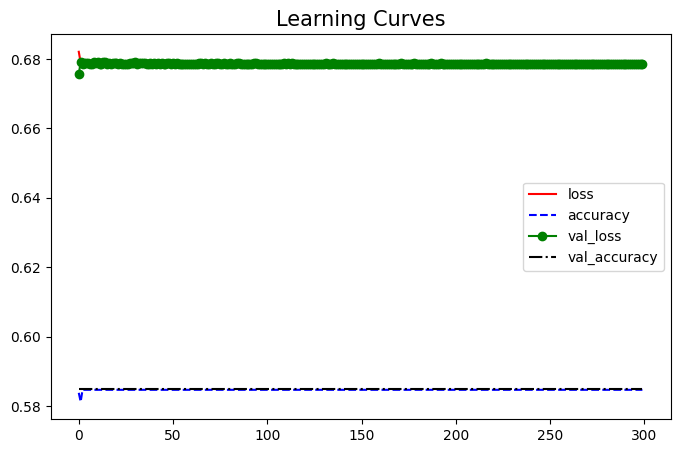

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


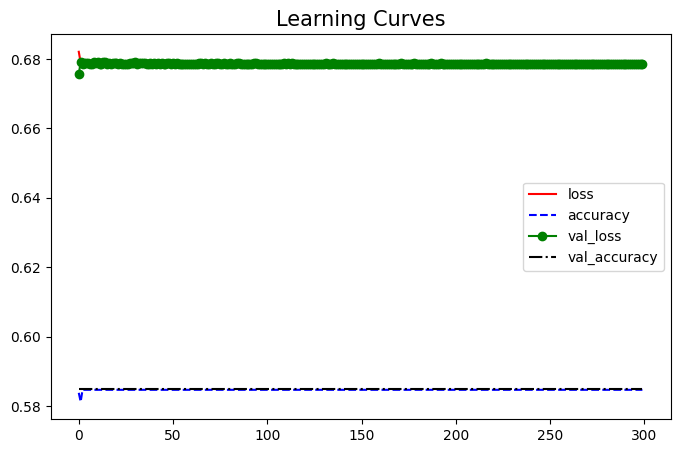

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


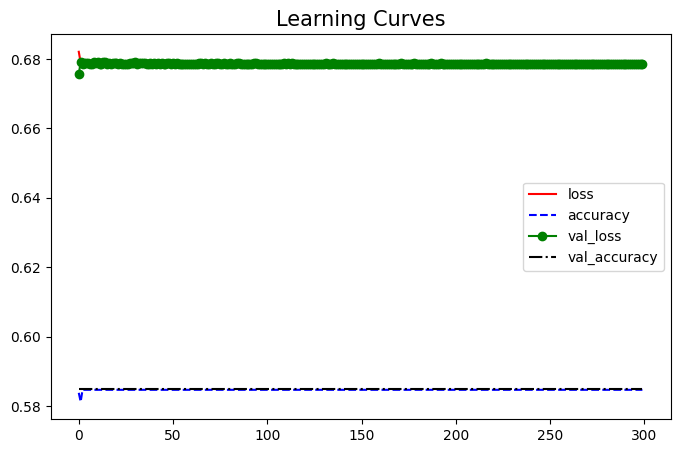

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


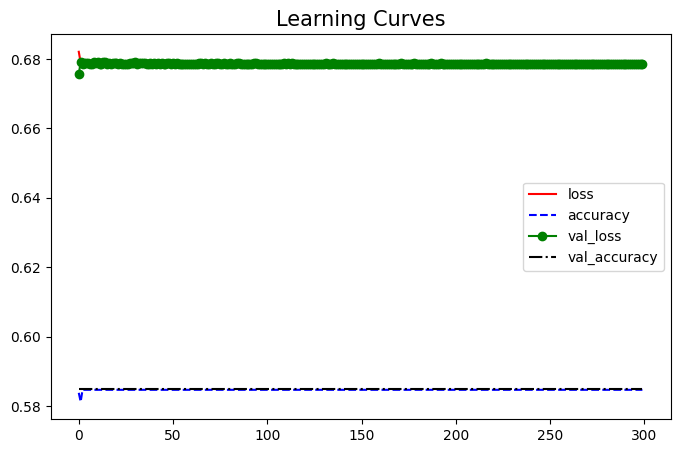

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


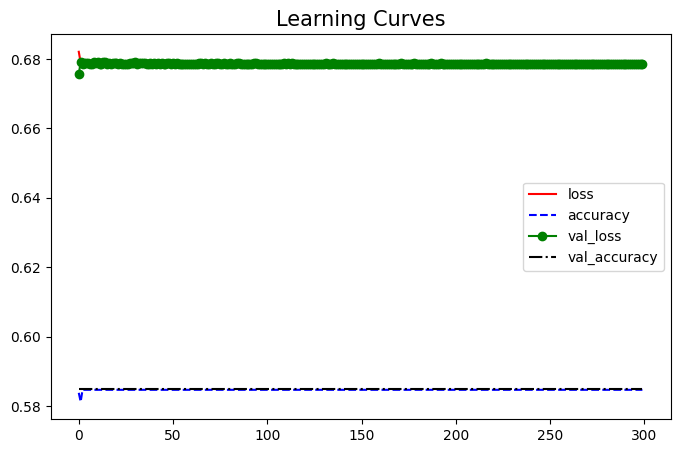

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


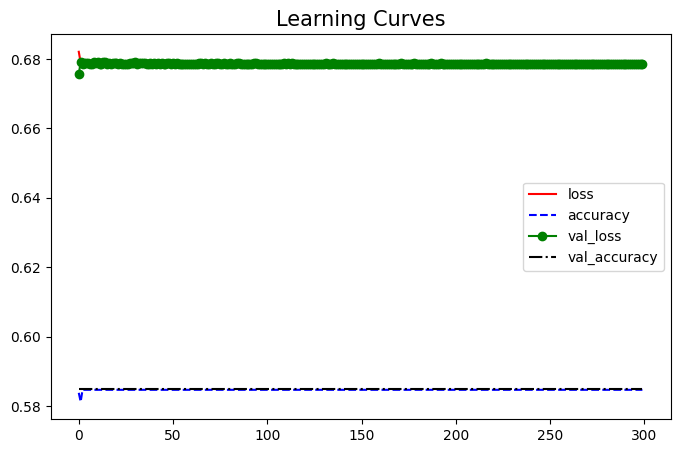

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 10-D AE (4 Layers)

#### 12 layer decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_56 (Dense)            (None, 60)                4560      
                                                                 
 dense_57 (Dense)            (None, 30)                1830      
                                                                 
 dense_58 (Dense)            (None, 15)                465       
                                                                 
 dense_59 (Dense)            (None, 10)                160       
                                                                 
 dense_60 (Dense)            (None, 10)                110       
                                                                 
 dense_61 (Dense)            (None, 20)                220       
                                                                 
 dense_62 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 7s 14ms/step - loss: 0.6793 - accuracy: 0.5824 - val_loss: 0.6741 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 3s 10ms/step - loss: 0.6722 - accuracy: 0.5832 - val_loss: 0.6594 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 3s 9ms/step - loss: 0.6715 - accuracy: 0.5933 - val_loss: 0.6529 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 3s 9ms/step - loss: 0.6648 - accuracy: 0.5847 - val_loss: 0.6489 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 5s 14ms/step - loss: 0.6617 - accuracy: 0.5927 - val_loss: 0.6486 - val_accuracy: 0.6021
Epoch 6/300
349/349 [==============================] - 4s 10ms/step - loss: 0.6743 - accuracy: 0.5852 - val_loss: 0.6699 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 3s 10ms/step - loss: 0.6645 - accuracy: 0.5847 - val_loss: 0.6547 - val_accuracy: 0

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8321100917431192


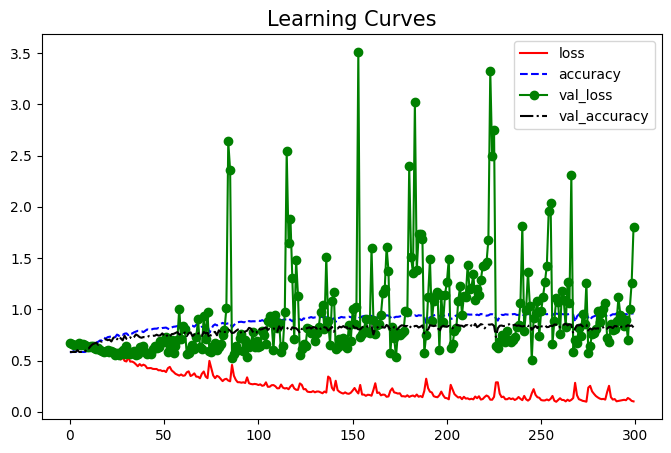

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


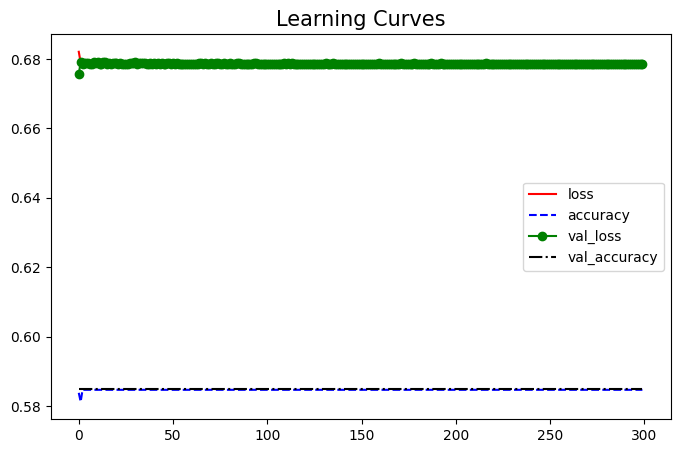

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


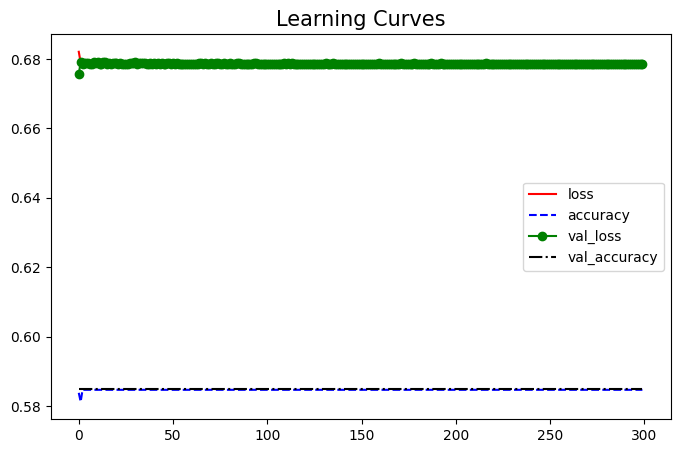

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


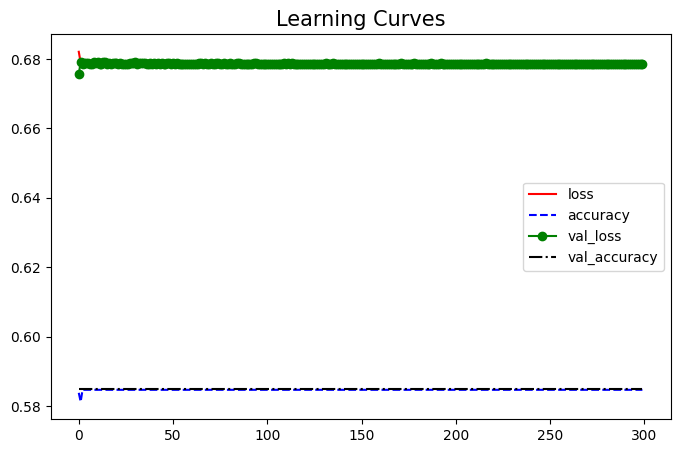

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


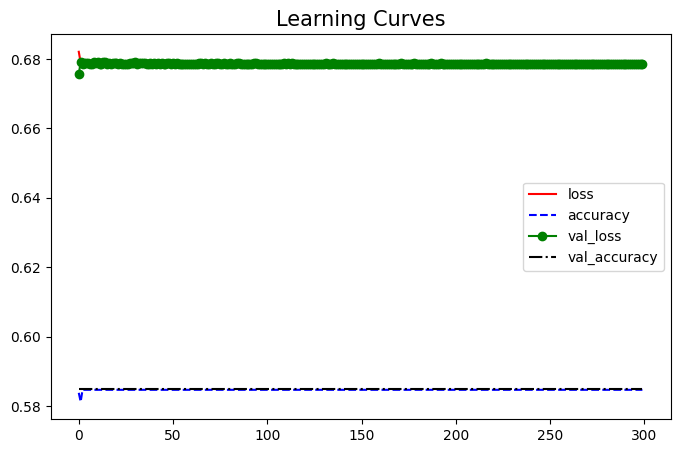

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


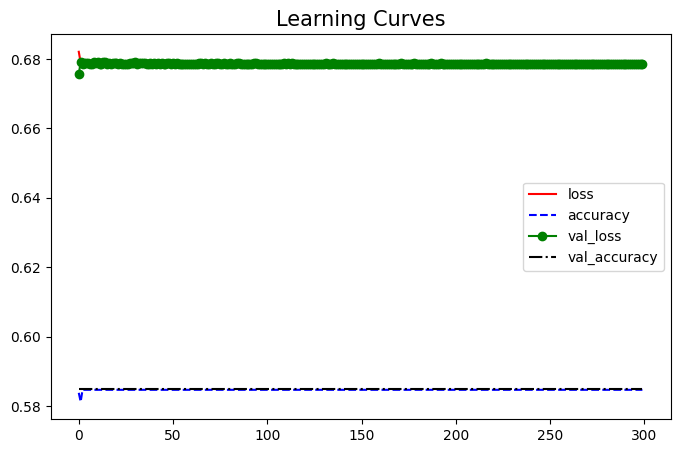

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


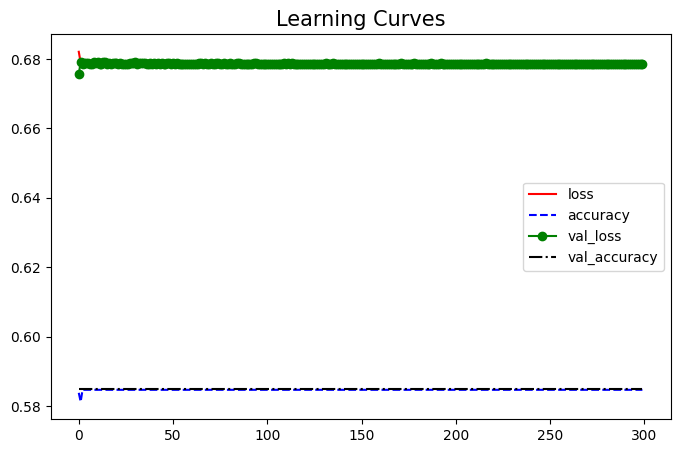

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


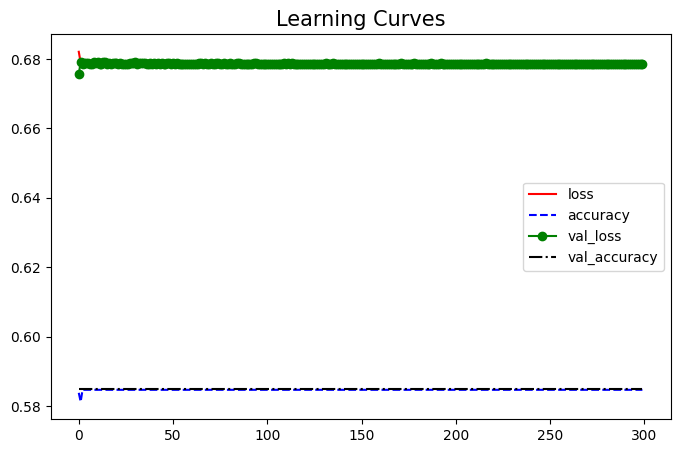

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


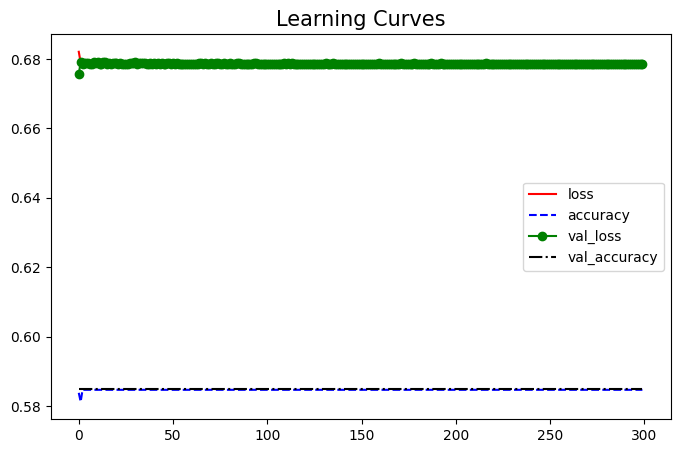

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


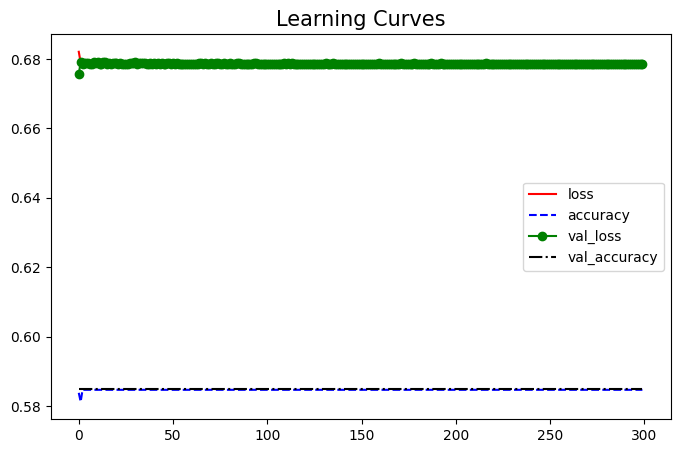

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


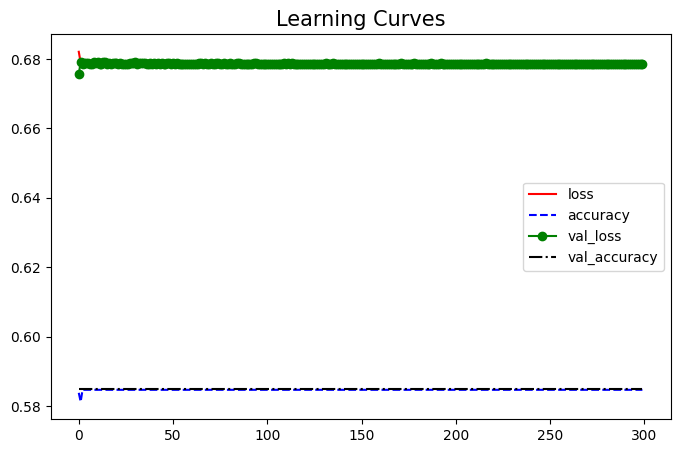

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 15-D AE (4 Layers)

#### 12 layer decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_71 (Dense)            (None, 60)                4560      
                                                                 
 dense_72 (Dense)            (None, 30)                1830      
                                                                 
 dense_73 (Dense)            (None, 20)                620       
                                                                 
 dense_74 (Dense)            (None, 15)                315       
                                                                 
 dense_75 (Dense)            (None, 10)                160       
                                                                 
 dense_76 (Dense)            (None, 20)                220       
                                                                 
 dense_77 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 8s 15ms/step - loss: 0.6797 - accuracy: 0.5838 - val_loss: 0.6666 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 3s 9ms/step - loss: 0.6729 - accuracy: 0.5881 - val_loss: 0.6690 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 3s 10ms/step - loss: 0.6666 - accuracy: 0.5993 - val_loss: 0.6733 - val_accuracy: 0.6227
Epoch 4/300
349/349 [==============================] - 4s 10ms/step - loss: 0.6645 - accuracy: 0.6019 - val_loss: 0.6616 - val_accuracy: 0.6170
Epoch 5/300
349/349 [==============================] - 5s 14ms/step - loss: 0.6546 - accuracy: 0.6237 - val_loss: 0.6422 - val_accuracy: 0.6468
Epoch 6/300
349/349 [==============================] - 3s 9ms/step - loss: 0.6454 - accuracy: 0.6470 - val_loss: 0.6479 - val_accuracy: 0.6330
Epoch 7/300
349/349 [==============================] - 3s 9ms/step - loss: 0.6515 - accuracy: 0.6217 - val_loss: 0.6711 - val_accuracy: 0.

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8174311926605504


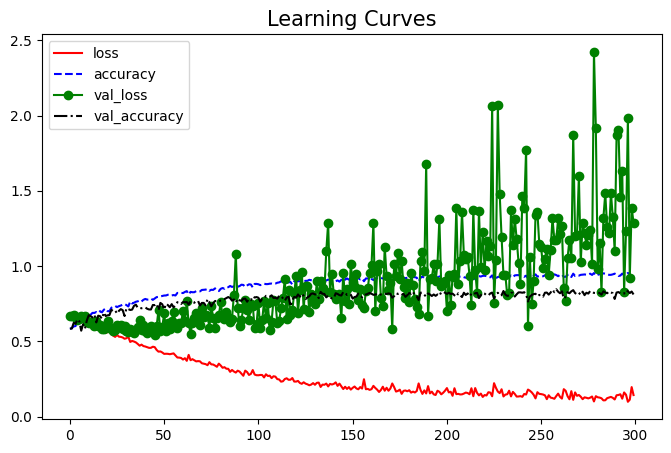

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


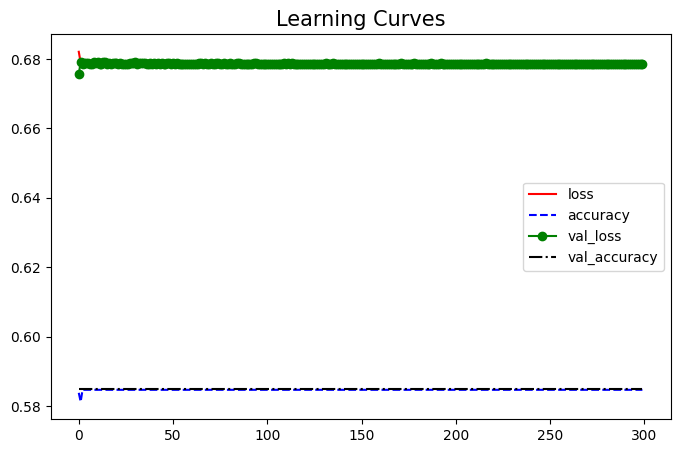

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


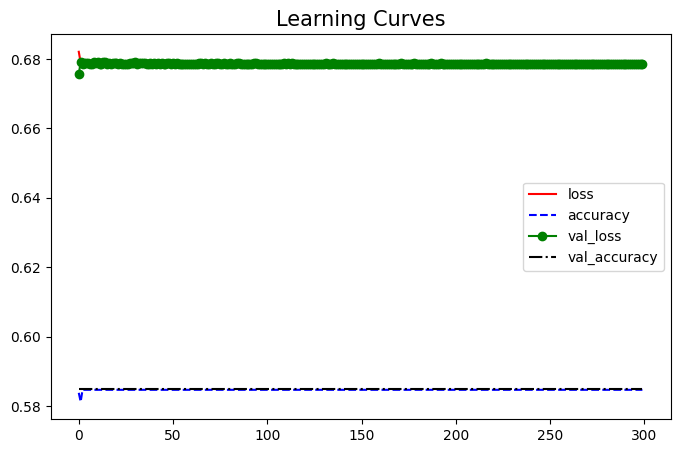

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


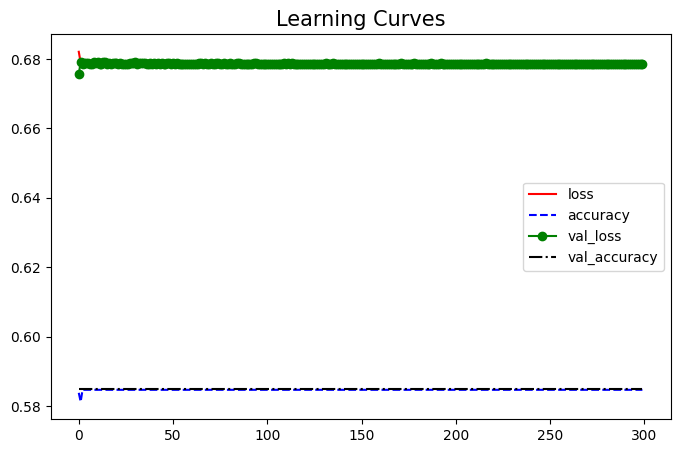

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


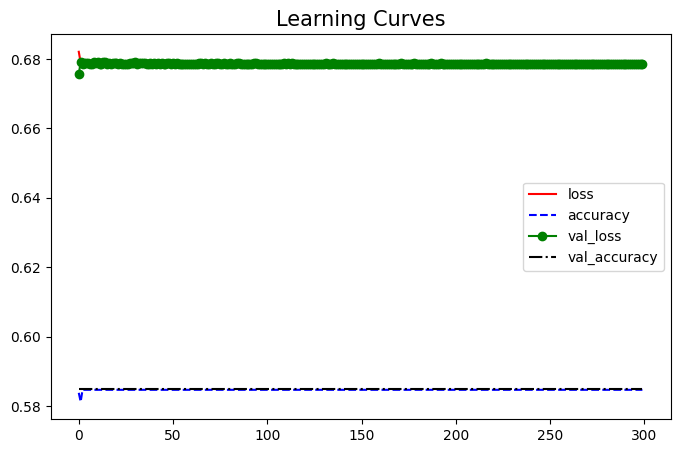

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


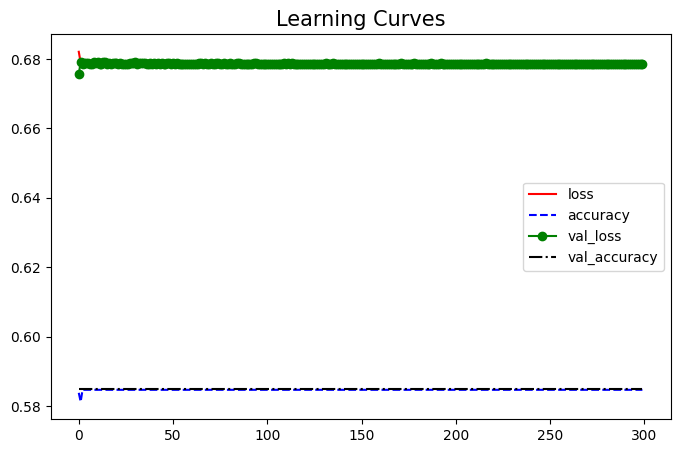

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


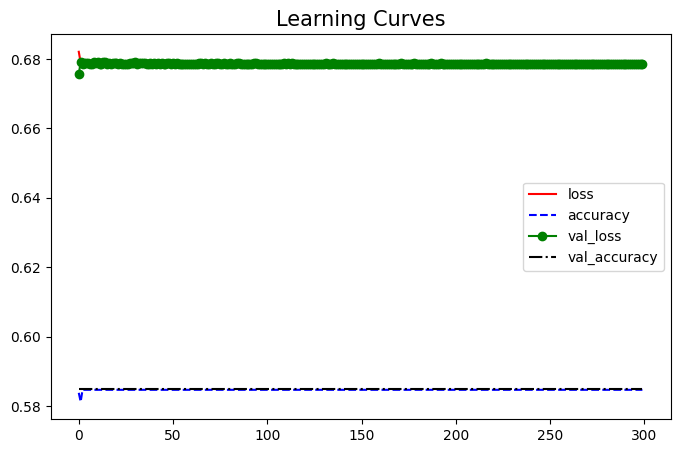

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


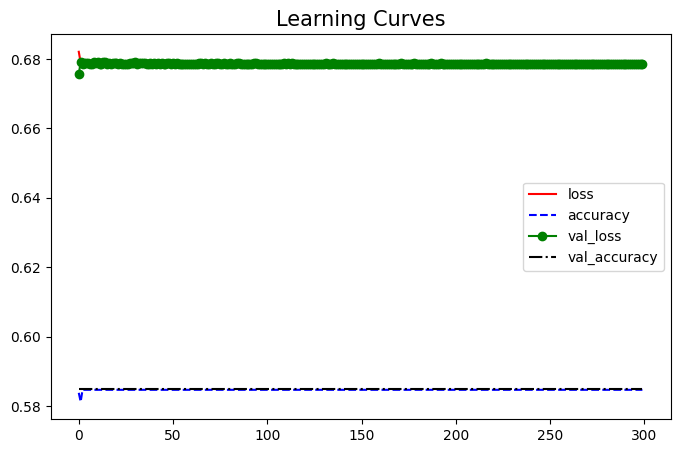

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


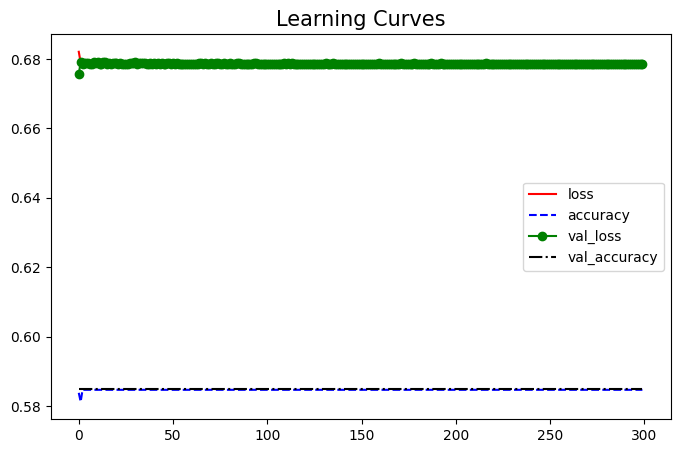

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


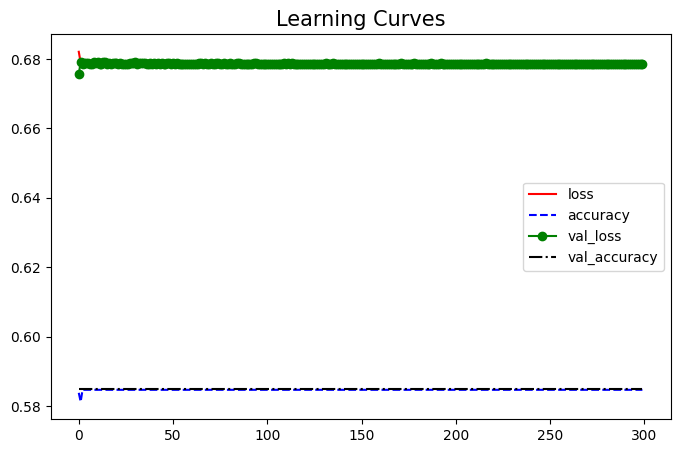

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


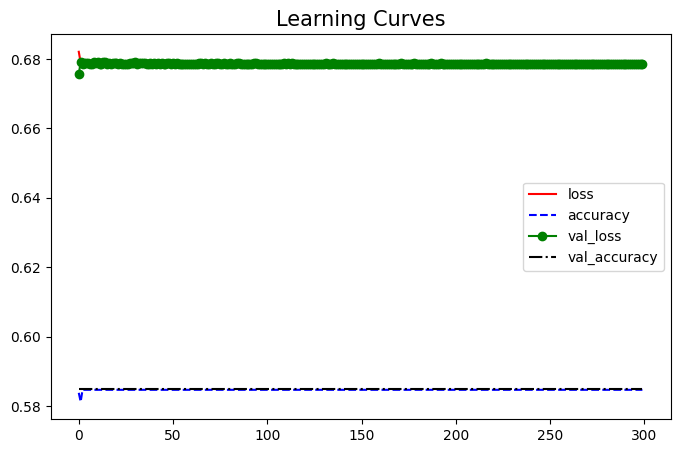

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

## 3 Layer

### 1-D AE (4 Layers)

#### 12 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


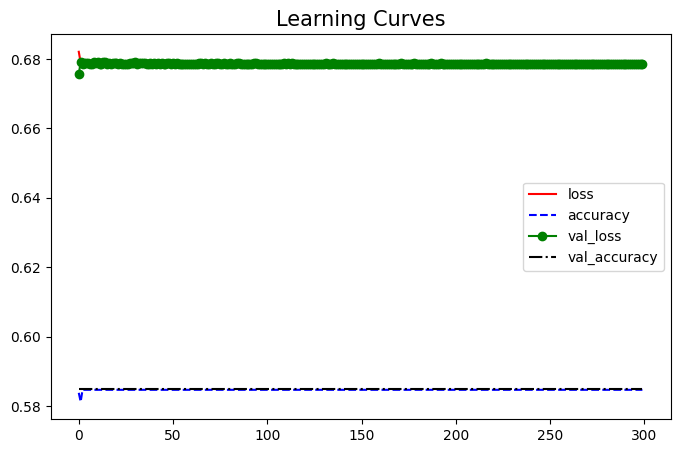

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


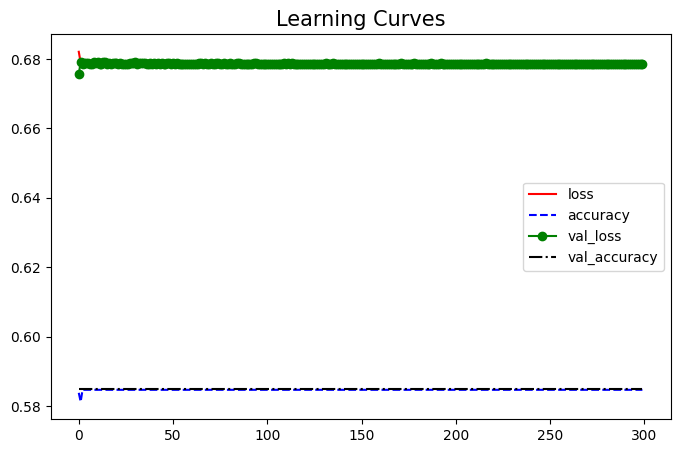

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


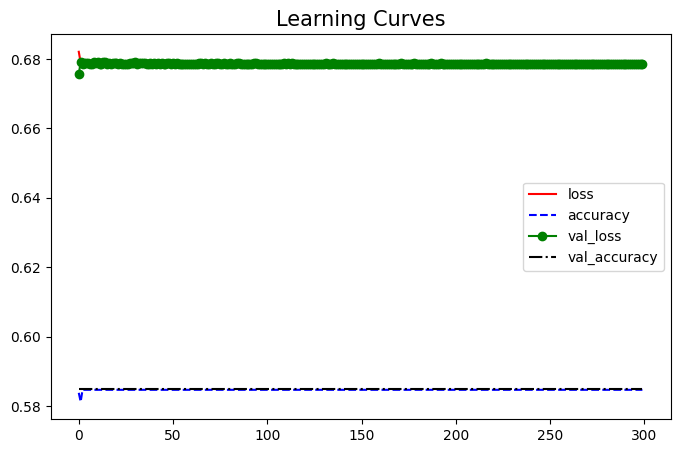

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


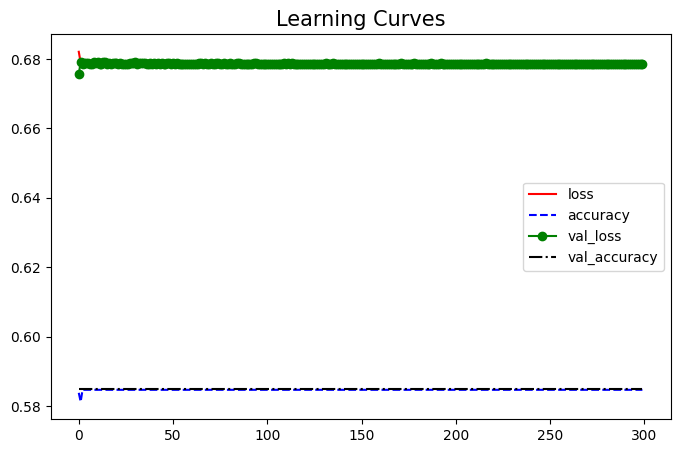

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


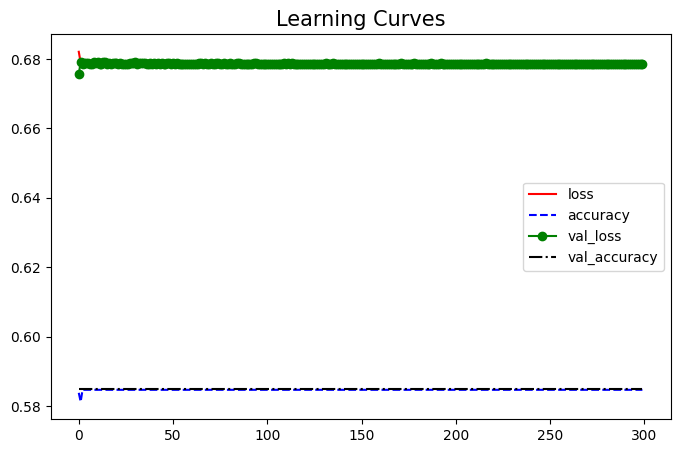

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


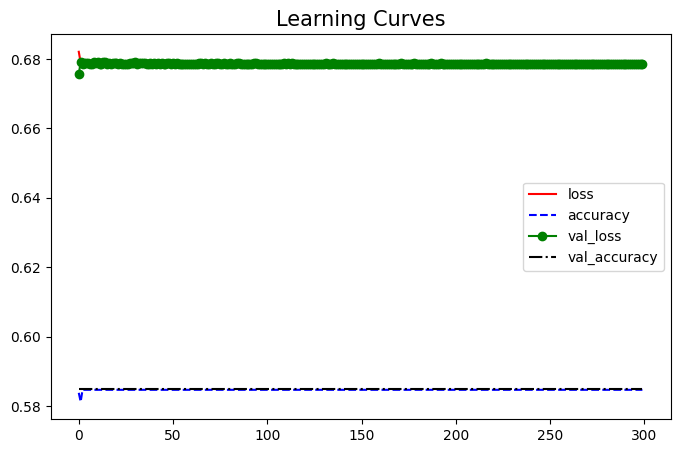

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


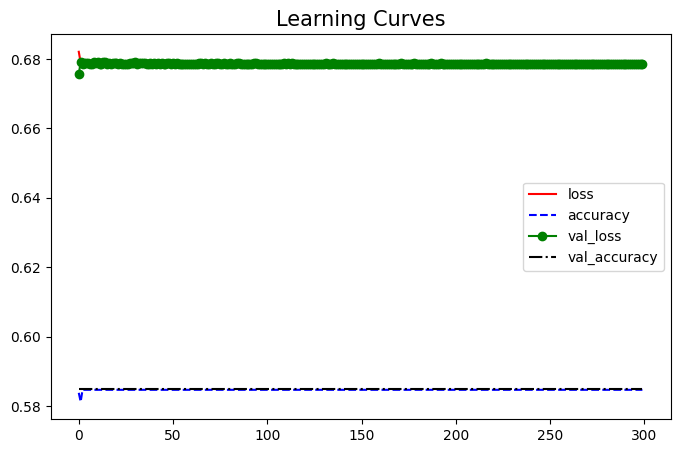

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


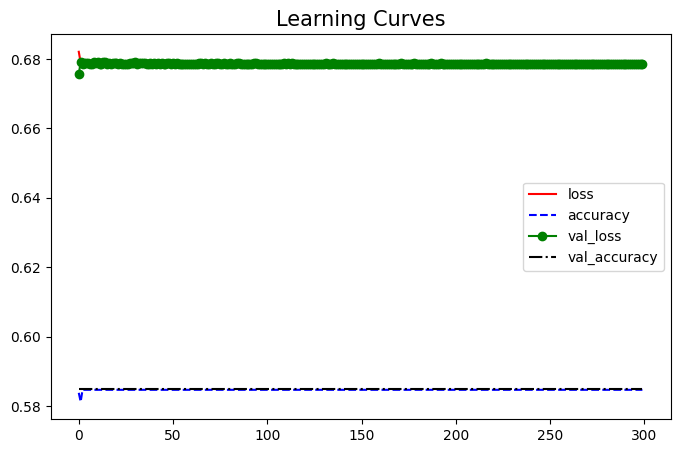

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


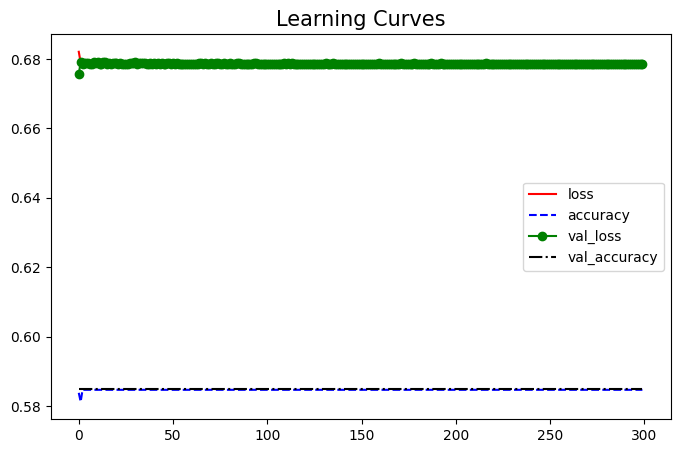

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


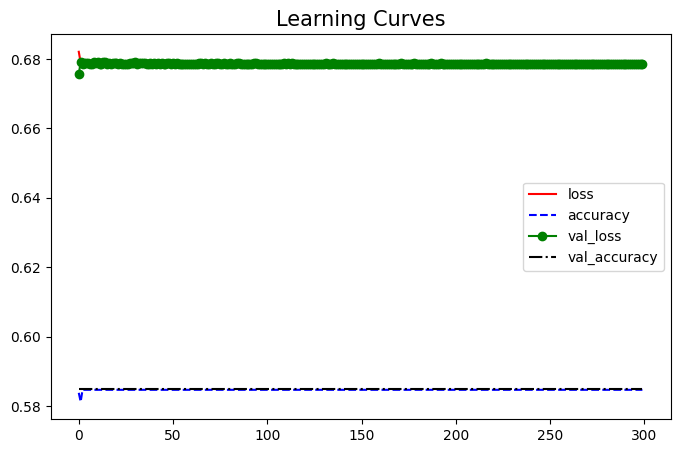

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


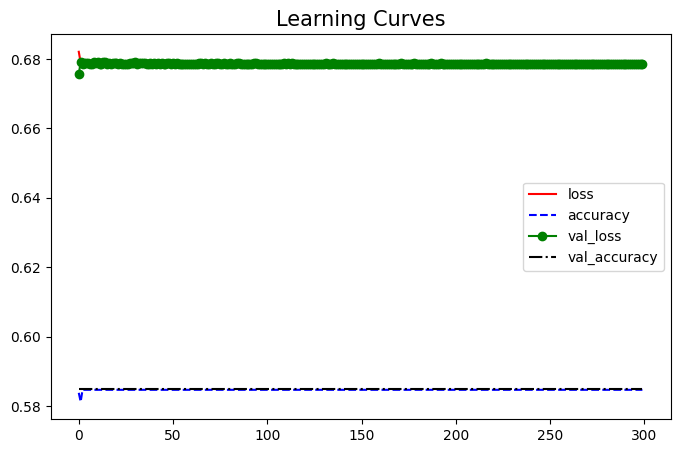

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 2-D AE (4 Layers)

#### 12 Layers Decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_48 (Dense)            (None, 60)                4560      
                                                                 
 dense_49 (Dense)            (None, 30)                1830      
                                                                 
 dense_50 (Dense)            (None, 15)                465       
                                                                 
 dense_51 (Dense)            (None, 2)                 32        
                                                                 
 dense_52 (Dense)            (None, 10)                30        
                                                                 
 dense_53 (Dense)            (None, 20)                220       
                                                                 
 dense_54 (Dense)            (None, 40)              

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 4s 6ms/step - loss: 0.6811 - accuracy: 0.5844 - val_loss: 0.6722 - val_accuracy: 0.5975
Epoch 2/300
349/349 [==============================] - 2s 5ms/step - loss: 0.6773 - accuracy: 0.5838 - val_loss: 0.6787 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 3s 8ms/step - loss: 0.6720 - accuracy: 0.5870 - val_loss: 0.6738 - val_accuracy: 0.5505
Epoch 4/300
349/349 [==============================] - 2s 5ms/step - loss: 0.6709 - accuracy: 0.5801 - val_loss: 0.6687 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 2s 5ms/step - loss: 0.6642 - accuracy: 0.5985 - val_loss: 0.6511 - val_accuracy: 0.6273
Epoch 6/300
349/349 [==============================] - 2s 5ms/step - loss: 0.6566 - accuracy: 0.6139 - val_loss: 0.6526 - val_accuracy: 0.6502
Epoch 7/300
349/349 [==============================] - 2s 5ms/step - loss: 0.6506 - accuracy: 0.6312 - val_loss: 0.6564 - val_accuracy: 0.6365

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 2ms/step
The accuracy on testing dataset:  0.8330275229357799


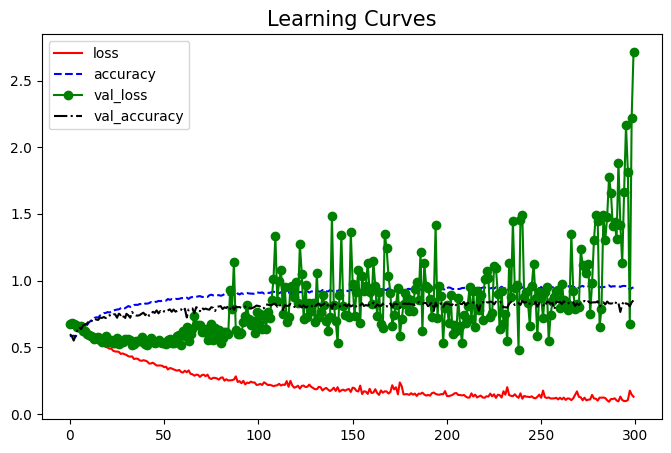

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


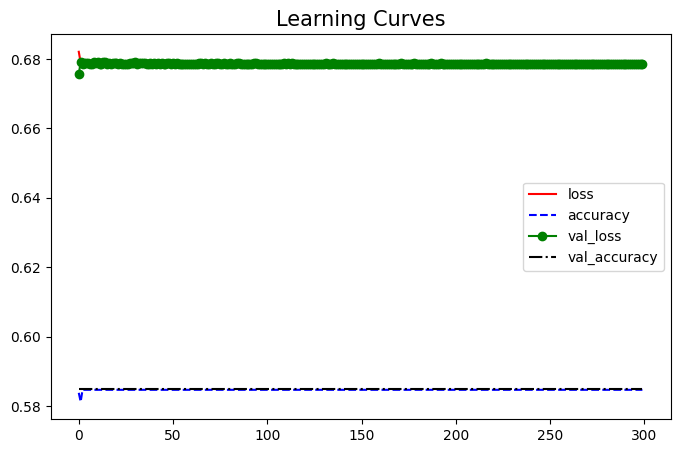

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


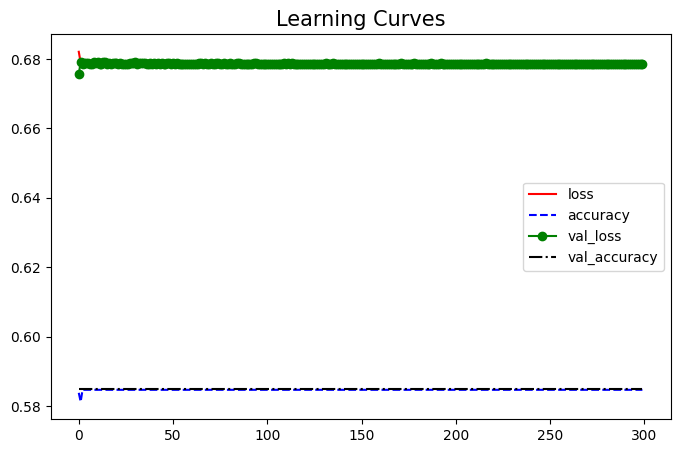

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


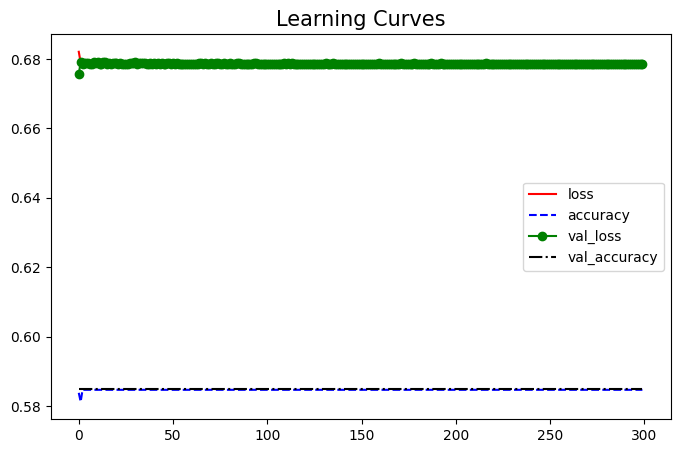

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


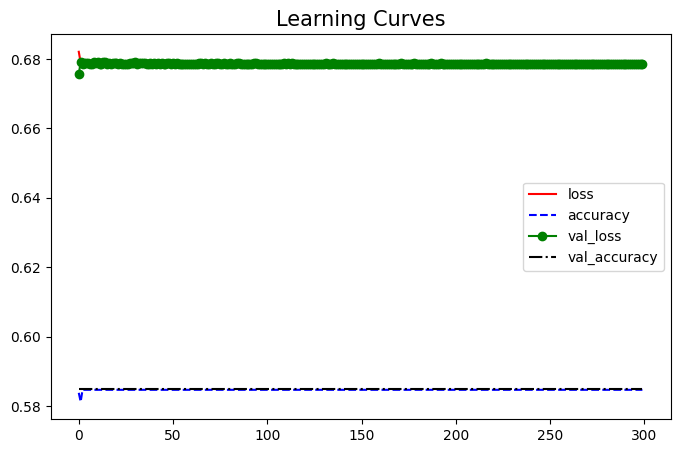

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


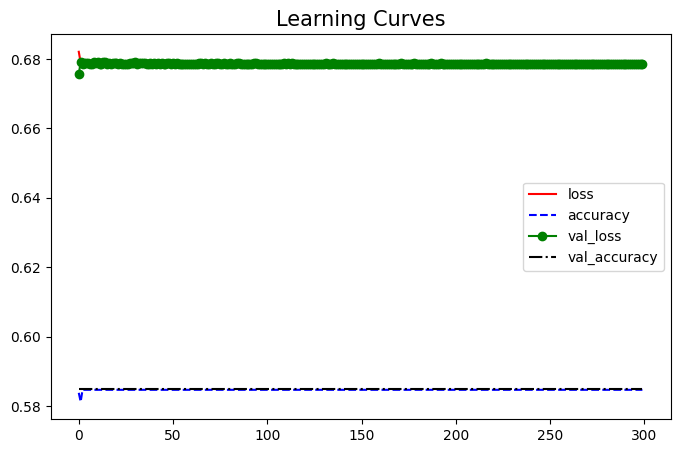

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


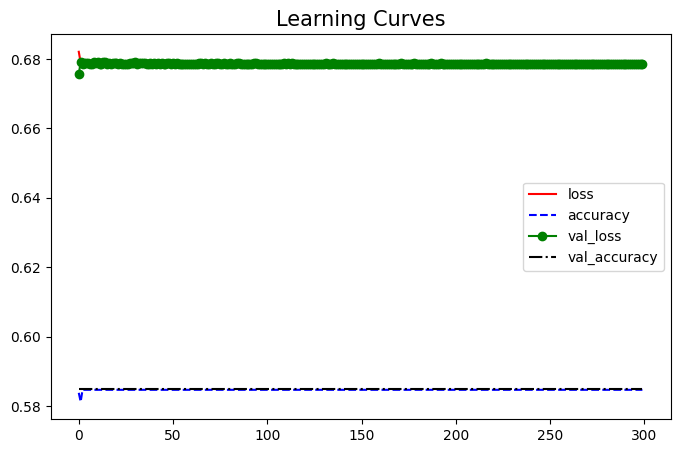

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


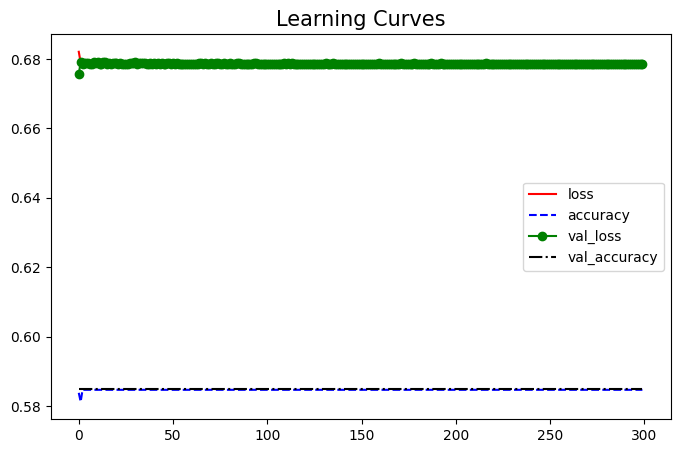

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


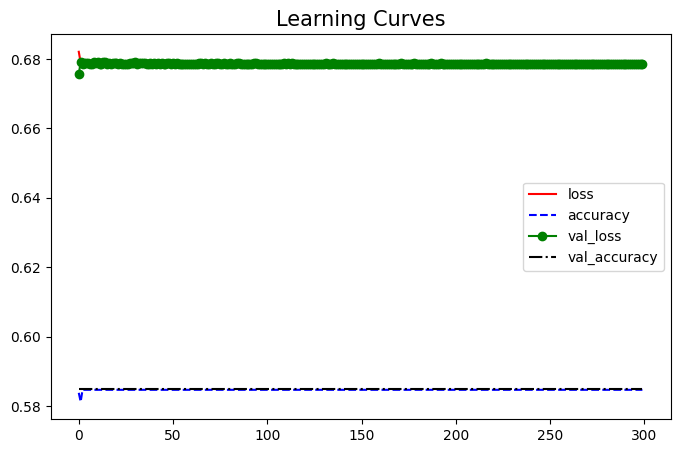

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


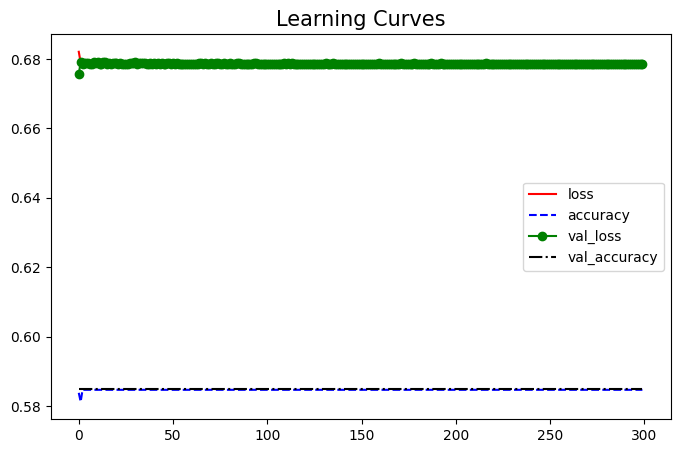

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


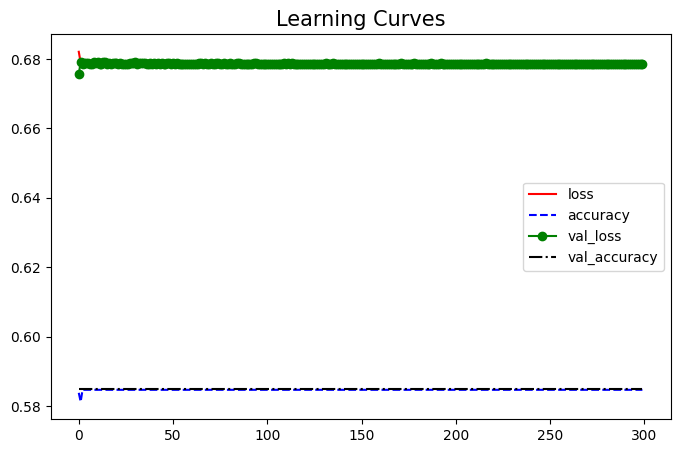

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


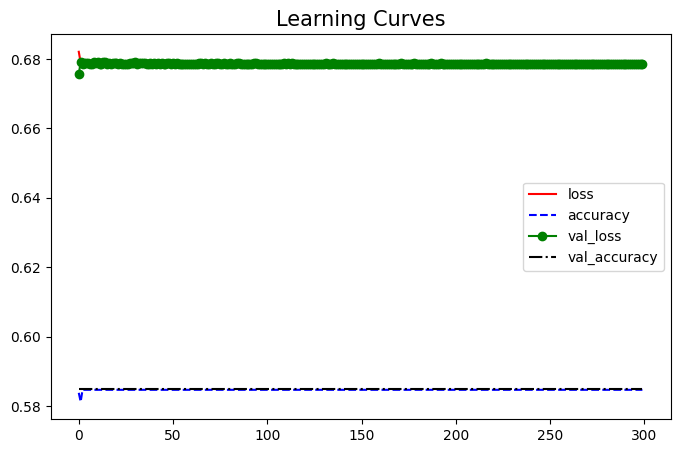

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 3-D AE (4 Layers)

#### 12 layer decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_26 (Dense)            (None, 60)                4560      
                                                                 
 dense_27 (Dense)            (None, 30)                1830      
                                                                 
 dense_28 (Dense)            (None, 15)                465       
                                                                 
 dense_29 (Dense)            (None, 3)                 48        
                                                                 
 dense_30 (Dense)            (None, 10)                40        
                                                                 
 dense_31 (Dense)            (None, 20)                220       
                                                                 
 dense_32 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 11s 20ms/step - loss: 0.6785 - accuracy: 0.5784 - val_loss: 0.6770 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6728 - accuracy: 0.5852 - val_loss: 0.6596 - val_accuracy: 0.6376
Epoch 3/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6798 - accuracy: 0.5801 - val_loss: 0.6559 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6727 - accuracy: 0.5832 - val_loss: 0.6766 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6702 - accuracy: 0.5801 - val_loss: 0.6599 - val_accuracy: 0.5860
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6780 - accuracy: 0.5847 - val_loss: 0.6790 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6761 - accuracy: 0.5850 - val_loss: 0.6618 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 6ms/step
The accuracy on testing dataset:  0.810091743119266


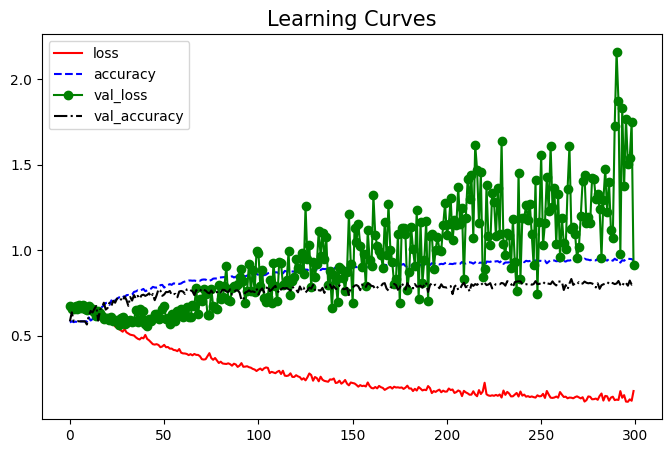

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


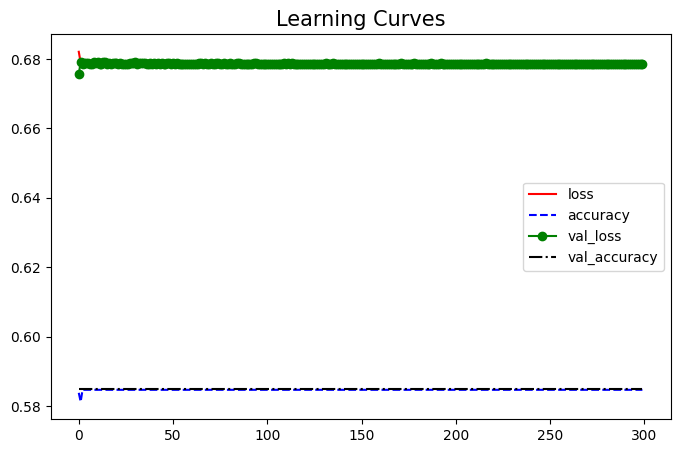

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


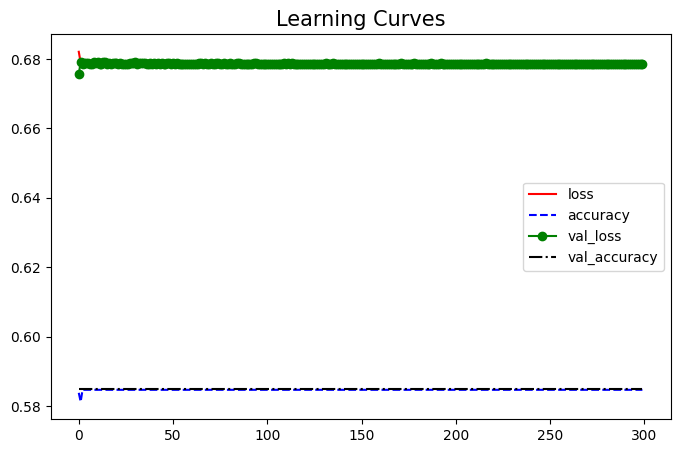

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


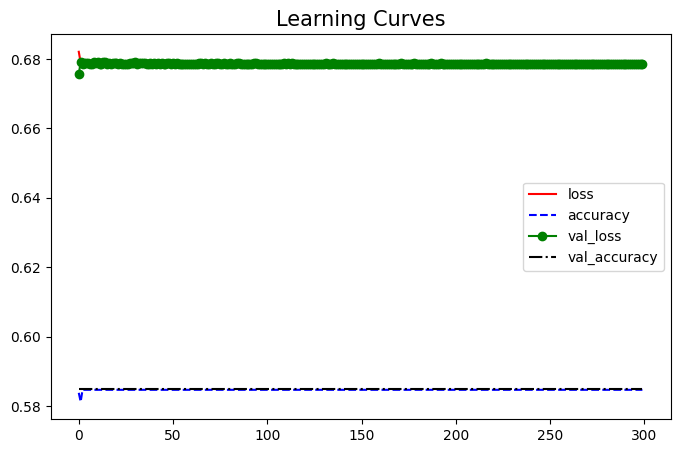

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


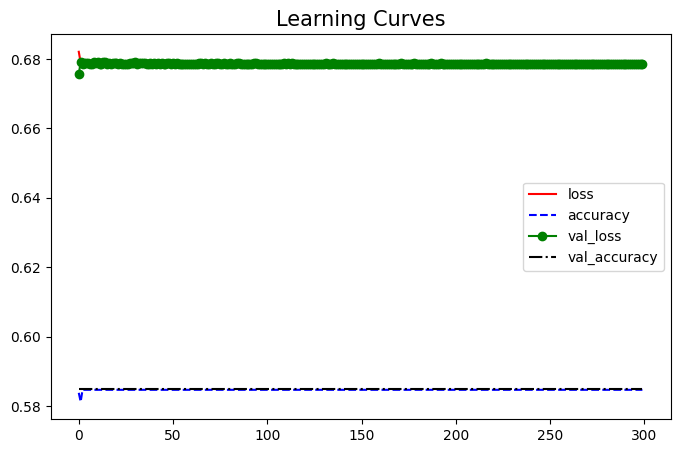

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


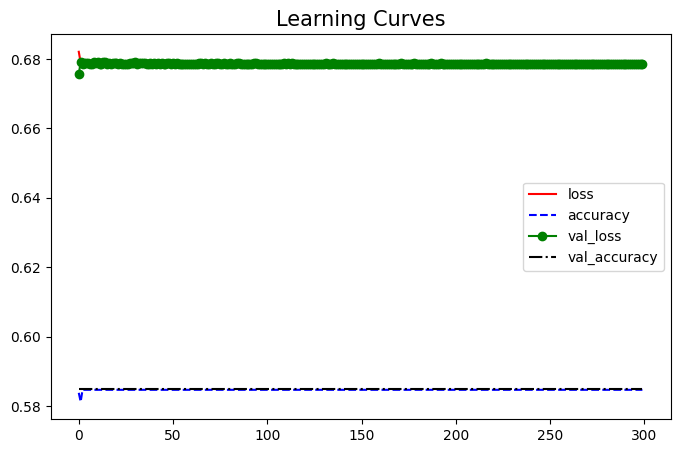

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


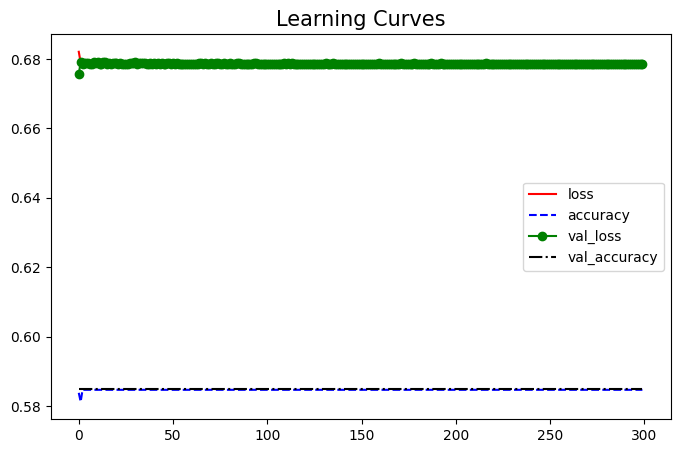

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


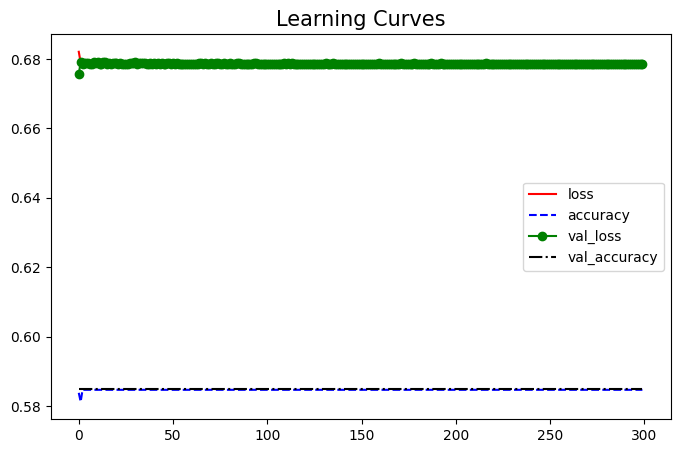

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


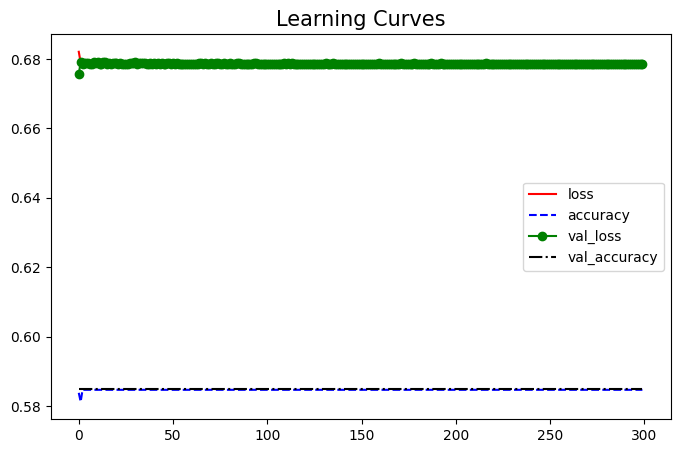

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


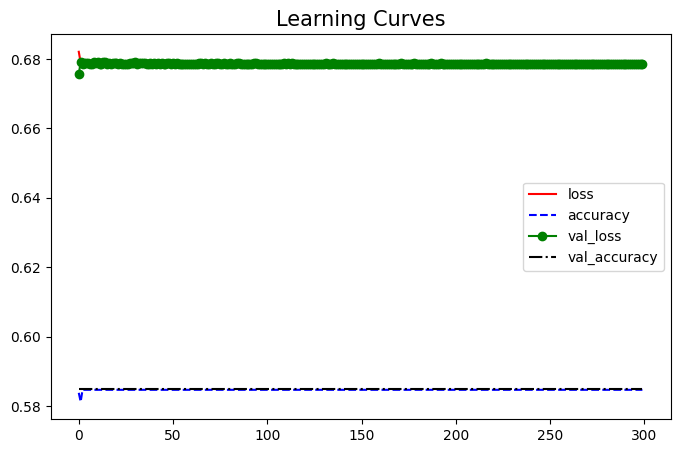

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


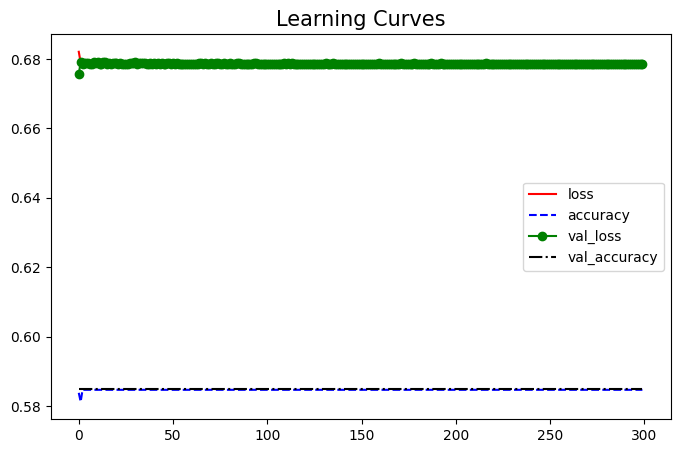

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 4-D AE (4 Layers)

#### 12 layer decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(4))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_26 (Dense)            (None, 60)                4560      
                                                                 
 dense_27 (Dense)            (None, 30)                1830      
                                                                 
 dense_28 (Dense)            (None, 15)                465       
                                                                 
 dense_29 (Dense)            (None, 3)                 48        
                                                                 
 dense_30 (Dense)            (None, 10)                40        
                                                                 
 dense_31 (Dense)            (None, 20)                220       
                                                                 
 dense_32 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 11s 20ms/step - loss: 0.6785 - accuracy: 0.5784 - val_loss: 0.6770 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6728 - accuracy: 0.5852 - val_loss: 0.6596 - val_accuracy: 0.6376
Epoch 3/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6798 - accuracy: 0.5801 - val_loss: 0.6559 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6727 - accuracy: 0.5832 - val_loss: 0.6766 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6702 - accuracy: 0.5801 - val_loss: 0.6599 - val_accuracy: 0.5860
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6780 - accuracy: 0.5847 - val_loss: 0.6790 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6761 - accuracy: 0.5850 - val_loss: 0.6618 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 6ms/step
The accuracy on testing dataset:  0.810091743119266


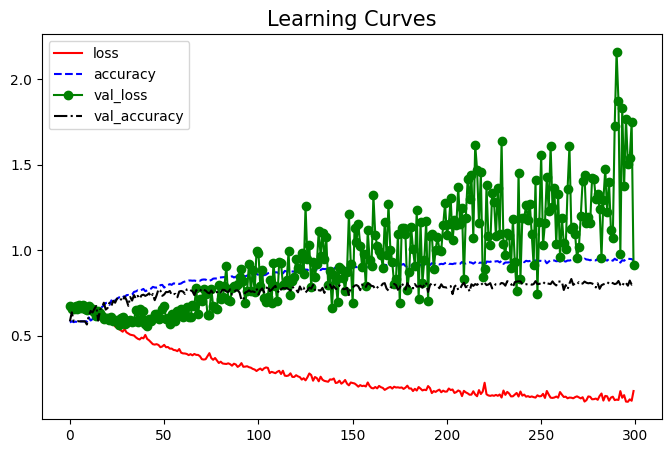

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(4))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


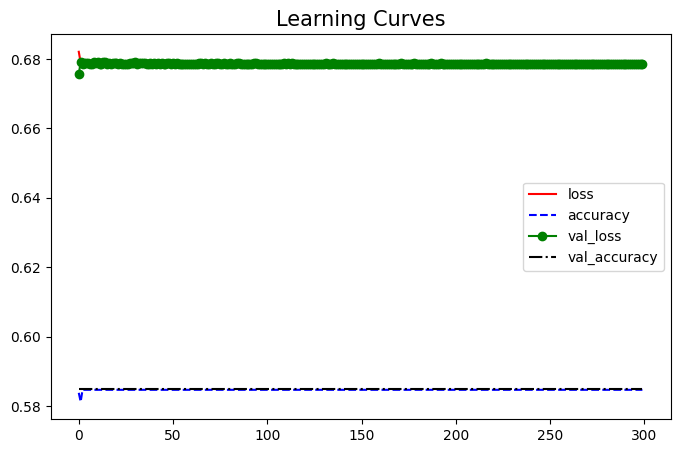

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(4))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


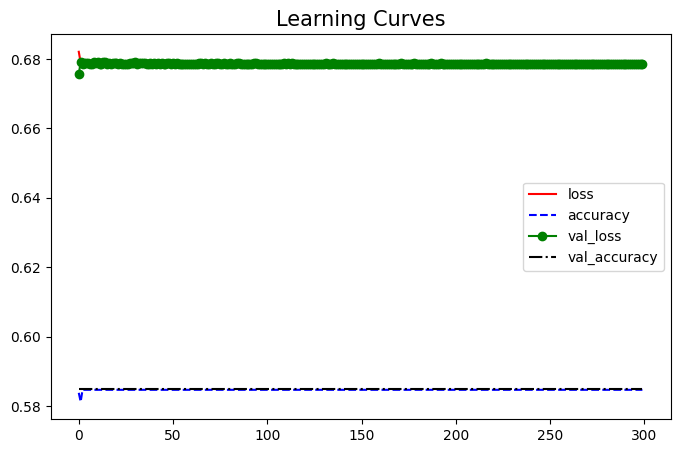

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(4))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


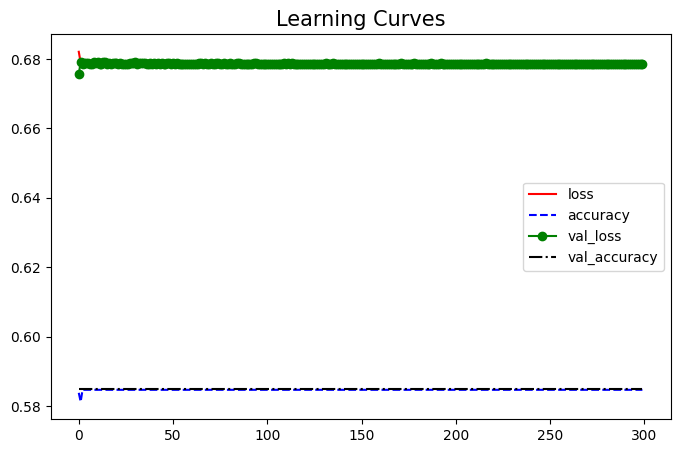

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(4))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


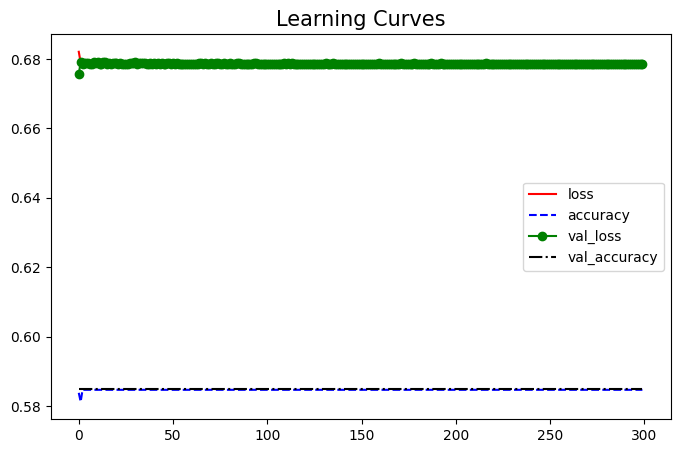

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(4))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


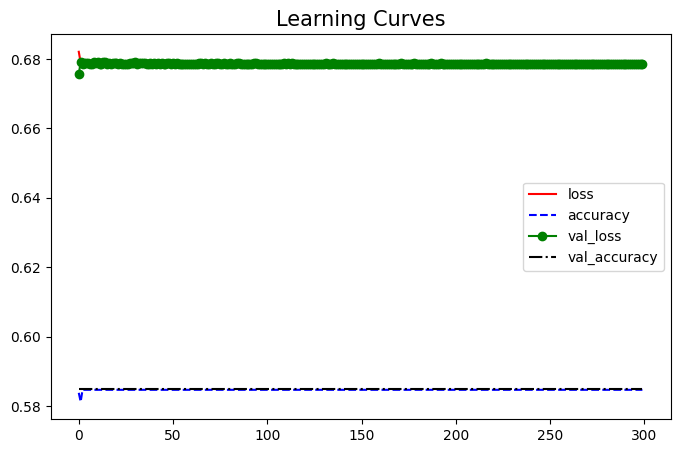

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(4))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


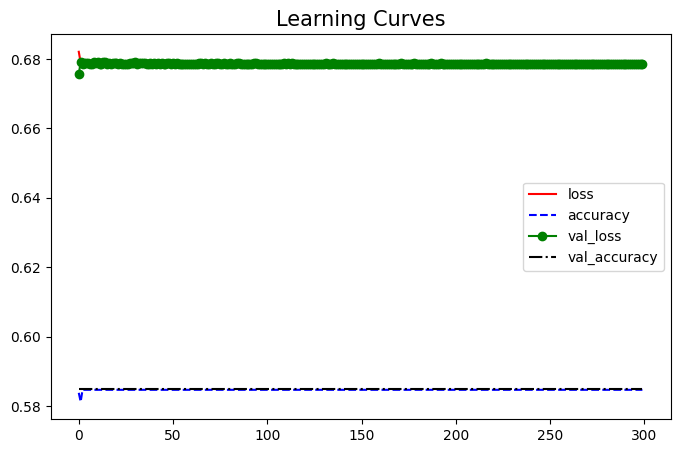

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(4))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


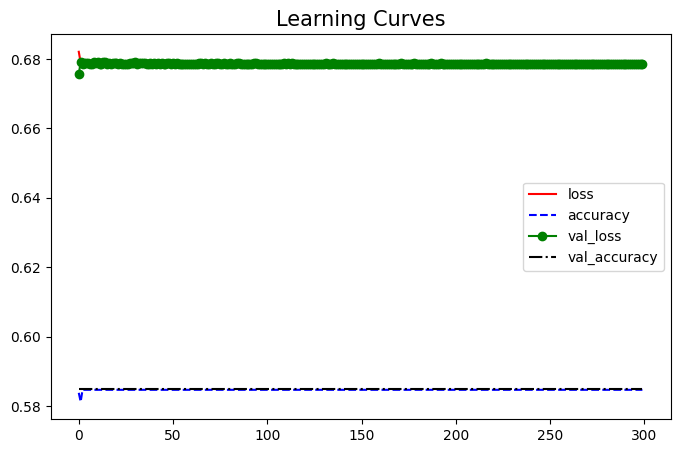

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(4))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


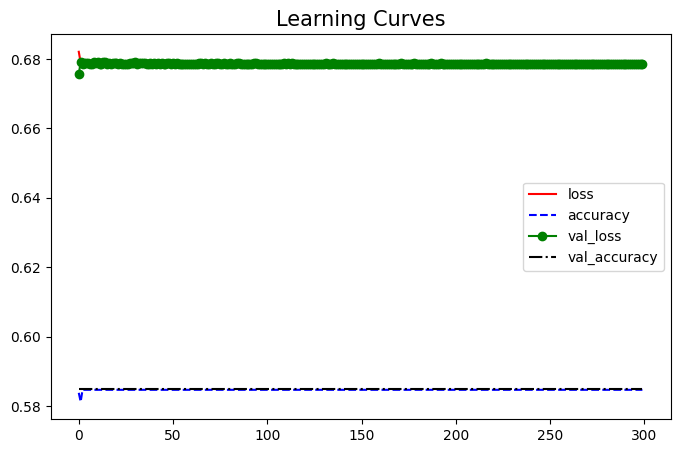

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(4))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


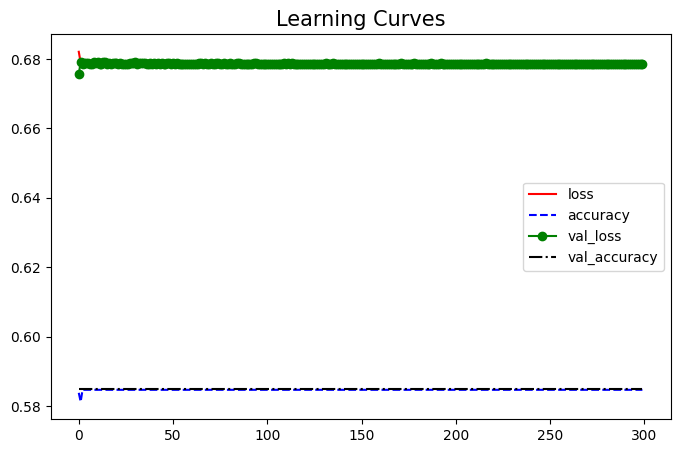

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(4))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


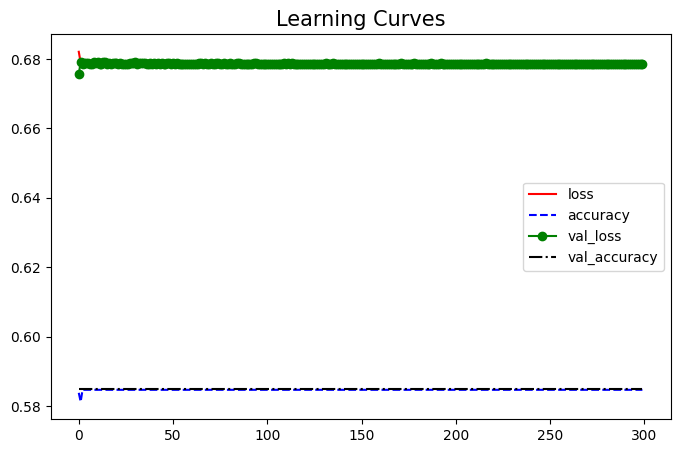

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 5-D AE (4 Layers)

#### 12 Layer Decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_41 (Dense)            (None, 60)                4560      
                                                                 
 dense_42 (Dense)            (None, 30)                1830      
                                                                 
 dense_43 (Dense)            (None, 15)                465       
                                                                 
 dense_44 (Dense)            (None, 5)                 80        
                                                                 
 dense_45 (Dense)            (None, 10)                60        
                                                                 
 dense_46 (Dense)            (None, 20)                220       
                                                                 
 dense_47 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 12s 20ms/step - loss: 0.6822 - accuracy: 0.5844 - val_loss: 0.6699 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6773 - accuracy: 0.5847 - val_loss: 0.6691 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6768 - accuracy: 0.5847 - val_loss: 0.6643 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 8s 22ms/step - loss: 0.6709 - accuracy: 0.5847 - val_loss: 0.6599 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6655 - accuracy: 0.5847 - val_loss: 0.6568 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 20ms/step - loss: 0.6645 - accuracy: 0.5847 - val_loss: 0.6573 - val_accuracy: 0.6411
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6481 - accuracy: 0.6332 - val_loss: 0.6297 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8412844036697248


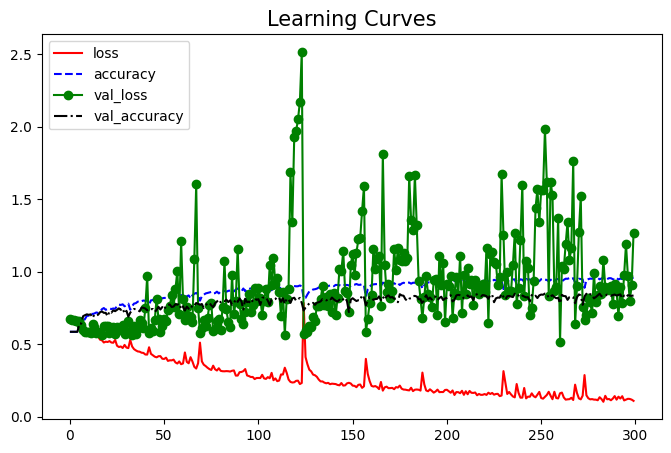

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


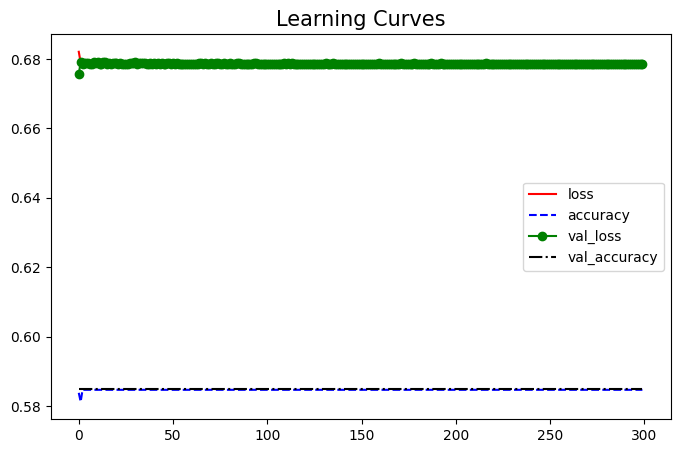

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


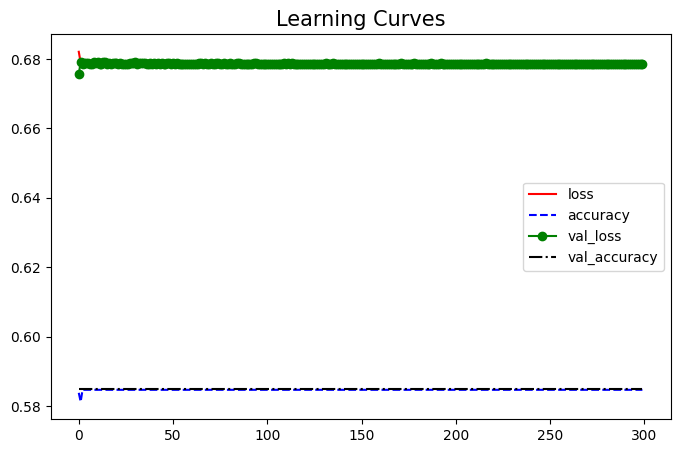

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


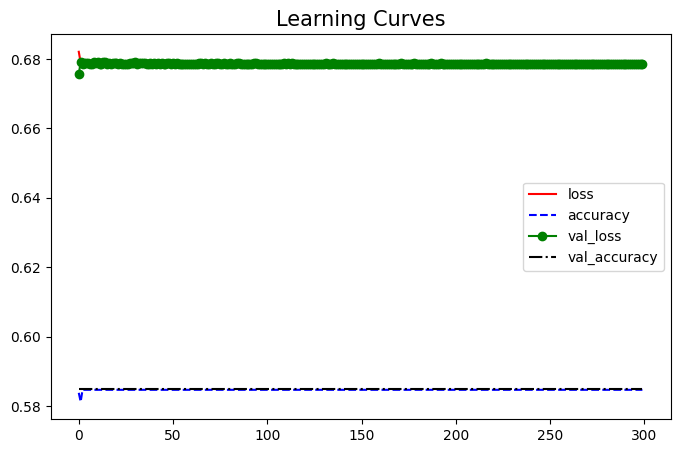

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


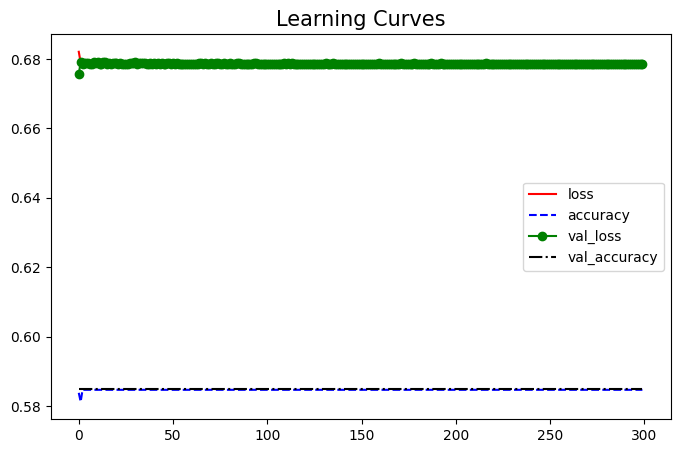

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


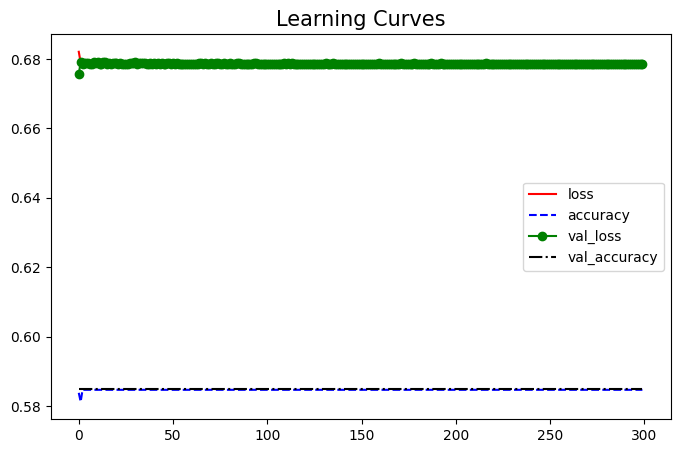

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


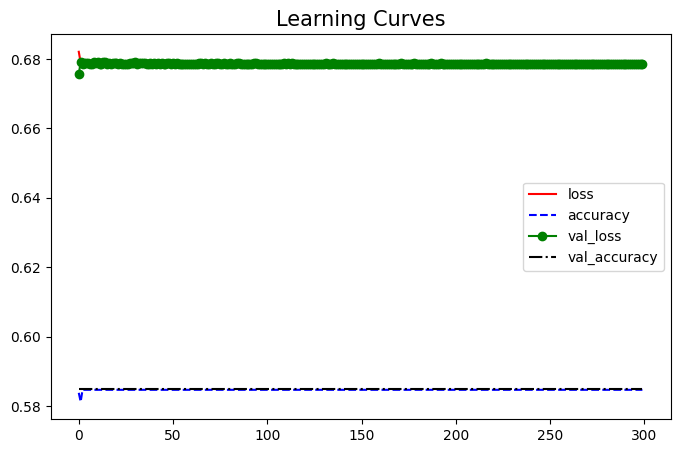

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


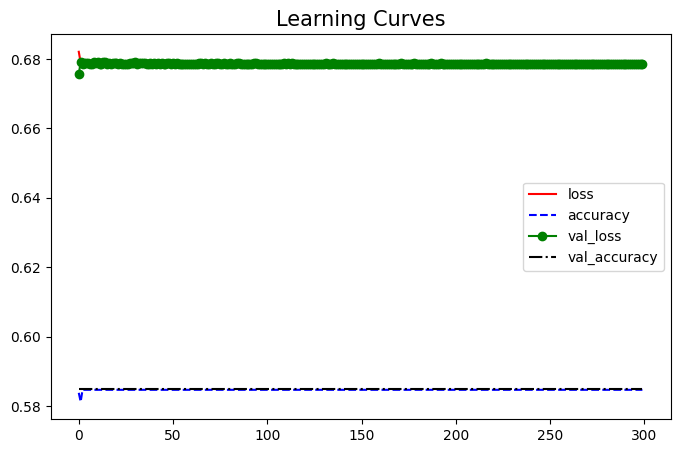

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


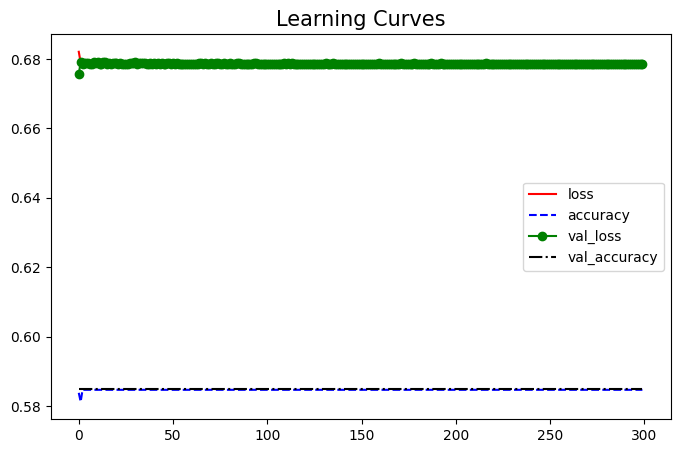

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


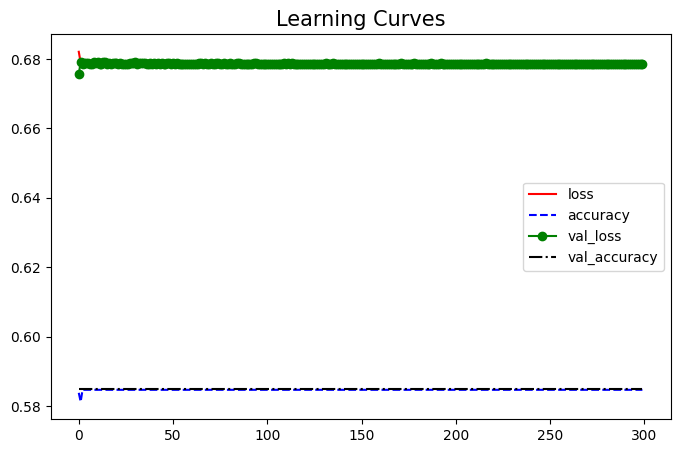

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


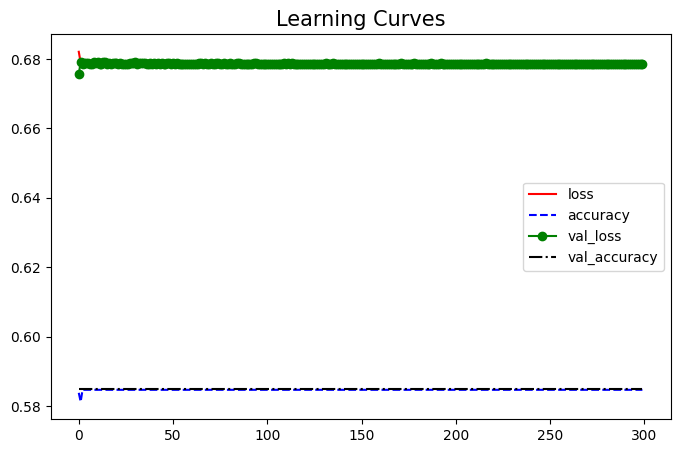

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 6-D AE (4 Layers)

#### 12 Layer Decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(6))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_41 (Dense)            (None, 60)                4560      
                                                                 
 dense_42 (Dense)            (None, 30)                1830      
                                                                 
 dense_43 (Dense)            (None, 15)                465       
                                                                 
 dense_44 (Dense)            (None, 5)                 80        
                                                                 
 dense_45 (Dense)            (None, 10)                60        
                                                                 
 dense_46 (Dense)            (None, 20)                220       
                                                                 
 dense_47 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 12s 20ms/step - loss: 0.6822 - accuracy: 0.5844 - val_loss: 0.6699 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6773 - accuracy: 0.5847 - val_loss: 0.6691 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6768 - accuracy: 0.5847 - val_loss: 0.6643 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 8s 22ms/step - loss: 0.6709 - accuracy: 0.5847 - val_loss: 0.6599 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6655 - accuracy: 0.5847 - val_loss: 0.6568 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 20ms/step - loss: 0.6645 - accuracy: 0.5847 - val_loss: 0.6573 - val_accuracy: 0.6411
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6481 - accuracy: 0.6332 - val_loss: 0.6297 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8412844036697248


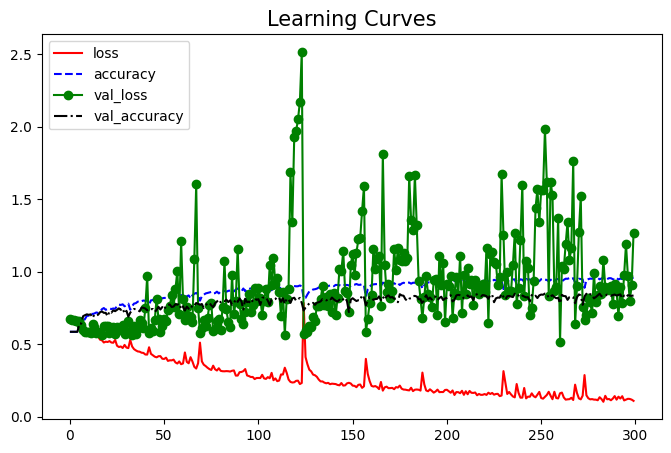

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(6))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


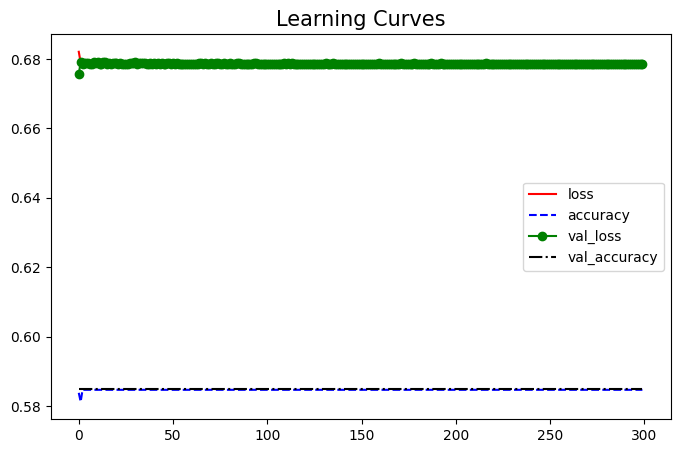

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(6))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


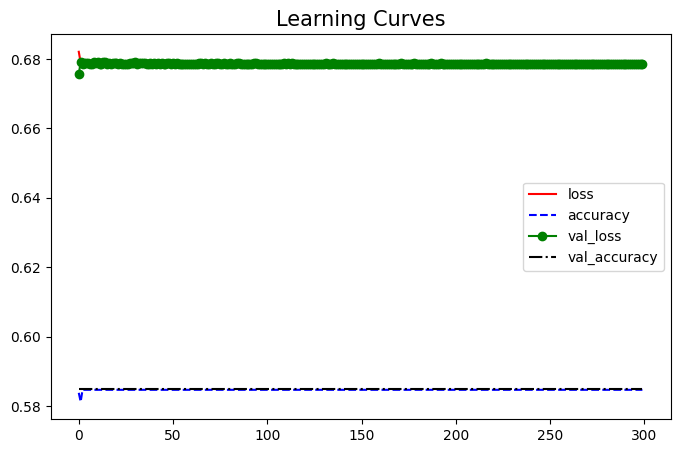

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(6))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


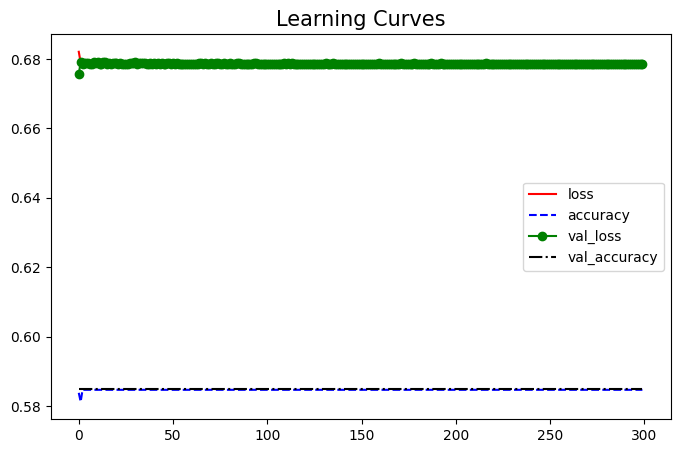

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(6))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


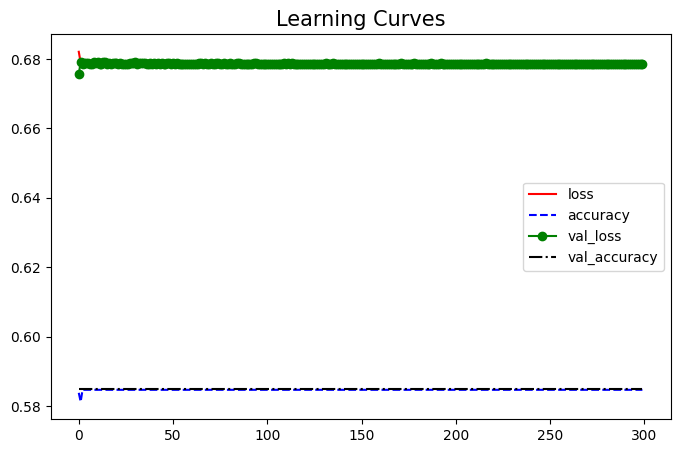

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(6))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


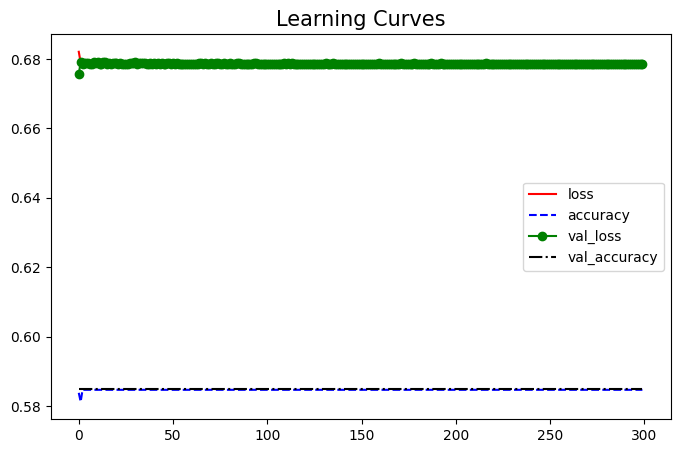

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(6))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


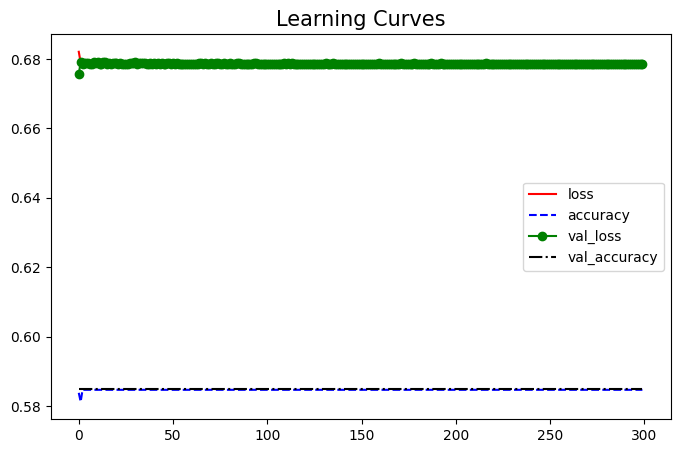

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(6))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


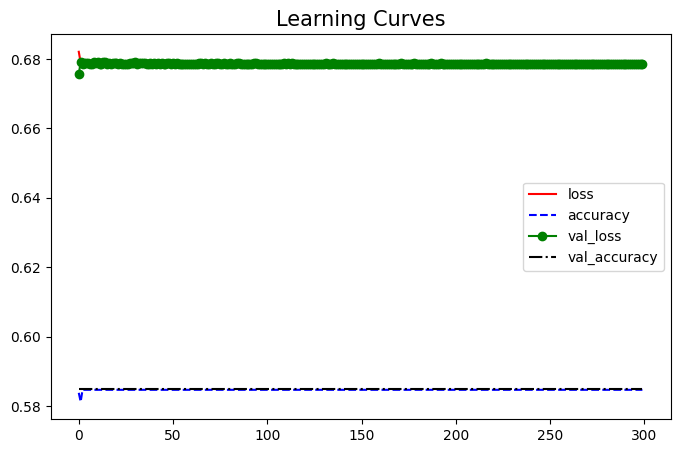

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(6))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


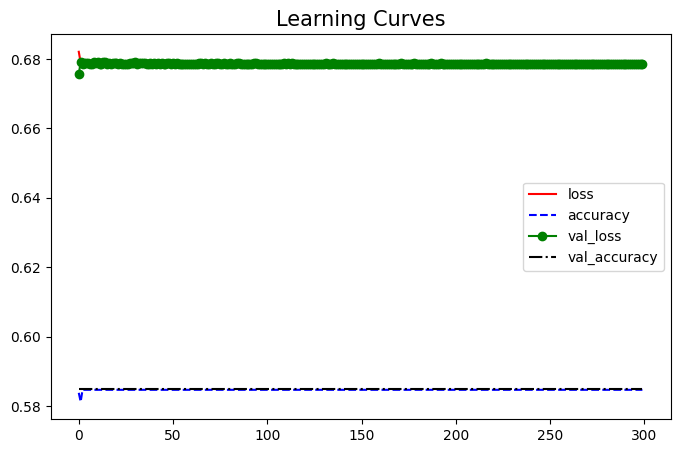

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(6))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


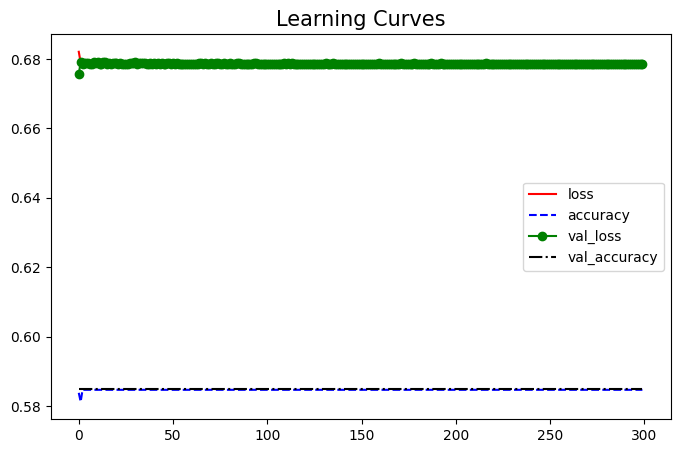

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(6))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


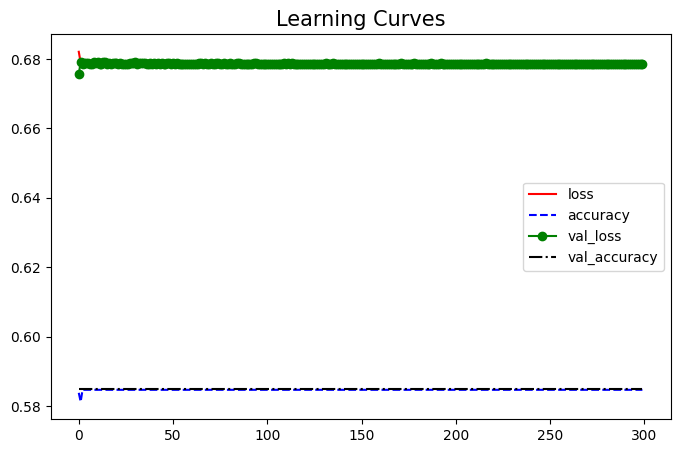

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 7-D AE (4 Layers)

#### 12 Layer Decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(7))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_41 (Dense)            (None, 60)                4560      
                                                                 
 dense_42 (Dense)            (None, 30)                1830      
                                                                 
 dense_43 (Dense)            (None, 15)                465       
                                                                 
 dense_44 (Dense)            (None, 5)                 80        
                                                                 
 dense_45 (Dense)            (None, 10)                60        
                                                                 
 dense_46 (Dense)            (None, 20)                220       
                                                                 
 dense_47 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 12s 20ms/step - loss: 0.6822 - accuracy: 0.5844 - val_loss: 0.6699 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6773 - accuracy: 0.5847 - val_loss: 0.6691 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6768 - accuracy: 0.5847 - val_loss: 0.6643 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 8s 22ms/step - loss: 0.6709 - accuracy: 0.5847 - val_loss: 0.6599 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6655 - accuracy: 0.5847 - val_loss: 0.6568 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 20ms/step - loss: 0.6645 - accuracy: 0.5847 - val_loss: 0.6573 - val_accuracy: 0.6411
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6481 - accuracy: 0.6332 - val_loss: 0.6297 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8412844036697248


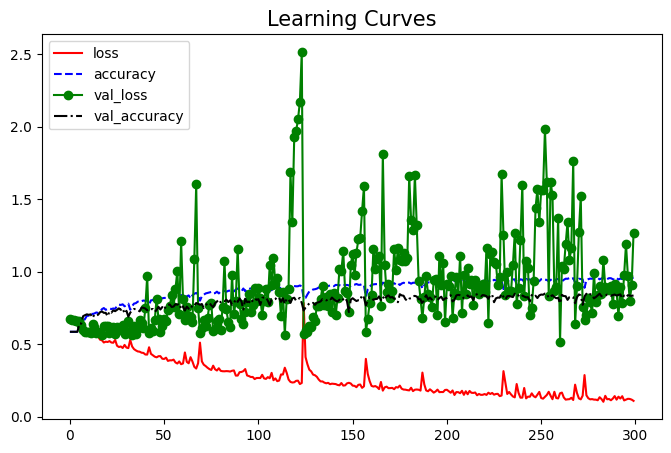

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(7))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


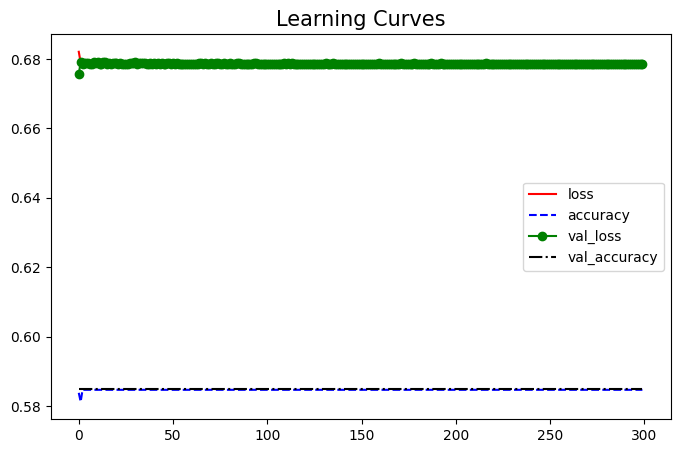

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(7))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


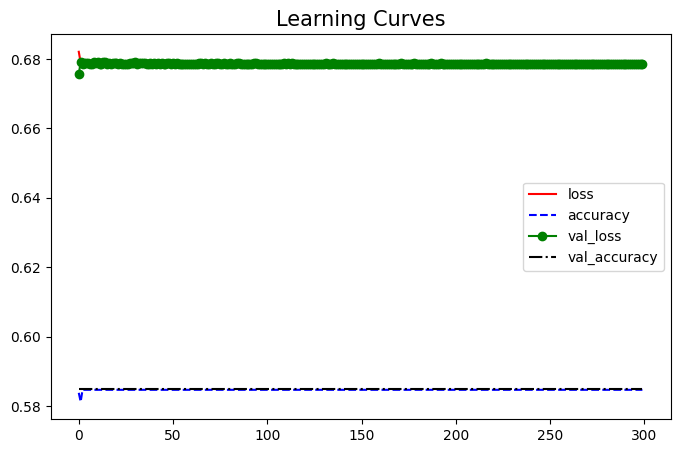

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(7))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


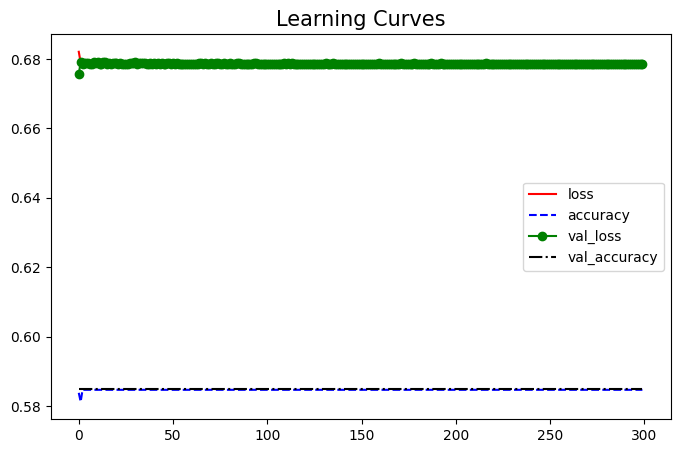

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(7))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


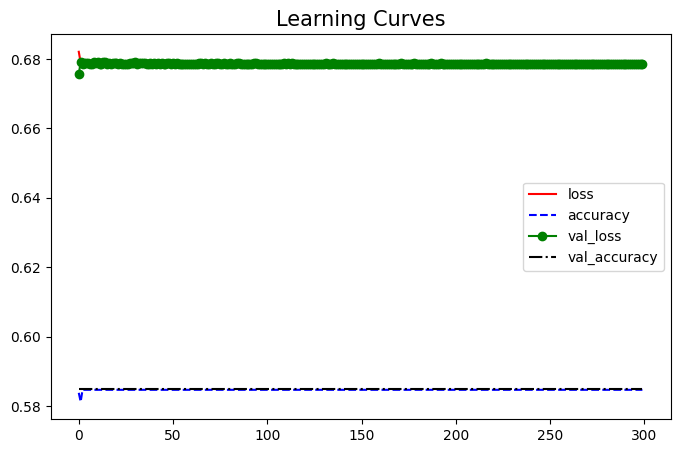

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(7))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


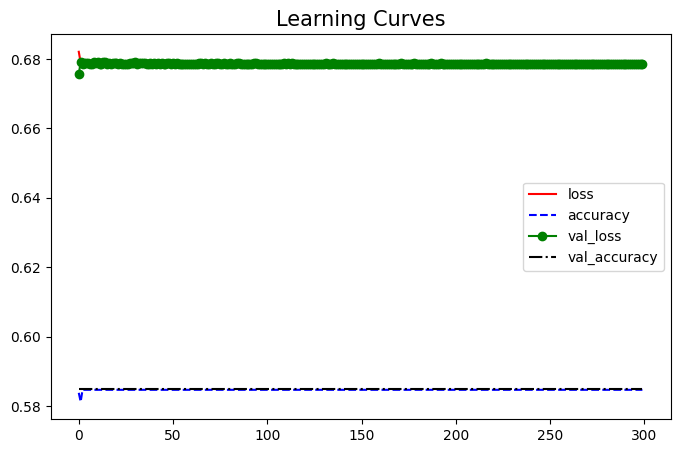

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(7))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


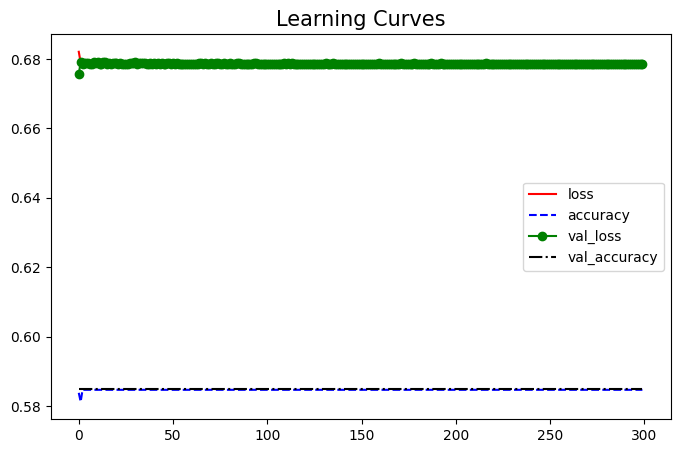

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(7))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


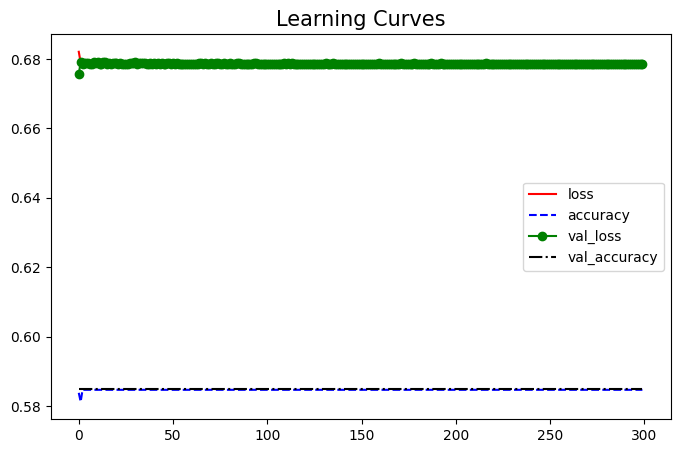

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(7))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


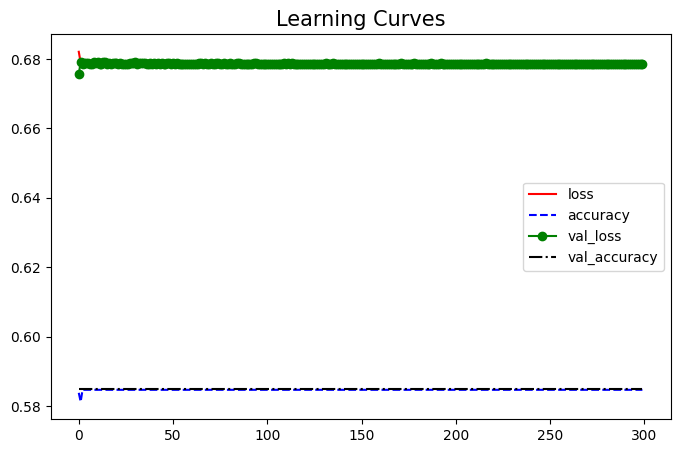

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(7))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


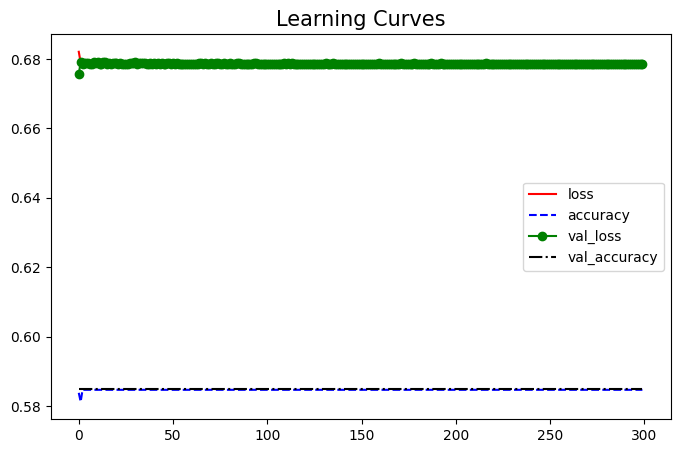

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(7))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


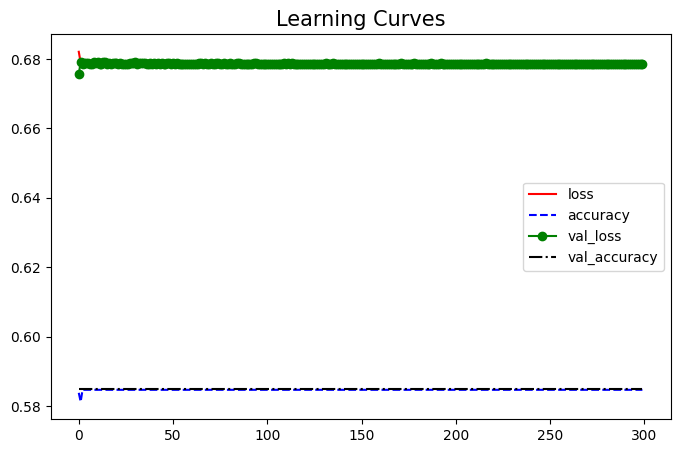

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 8-D AE (4 Layers)

#### 12 Layer Decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(8))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_41 (Dense)            (None, 60)                4560      
                                                                 
 dense_42 (Dense)            (None, 30)                1830      
                                                                 
 dense_43 (Dense)            (None, 15)                465       
                                                                 
 dense_44 (Dense)            (None, 5)                 80        
                                                                 
 dense_45 (Dense)            (None, 10)                60        
                                                                 
 dense_46 (Dense)            (None, 20)                220       
                                                                 
 dense_47 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 12s 20ms/step - loss: 0.6822 - accuracy: 0.5844 - val_loss: 0.6699 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6773 - accuracy: 0.5847 - val_loss: 0.6691 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6768 - accuracy: 0.5847 - val_loss: 0.6643 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 8s 22ms/step - loss: 0.6709 - accuracy: 0.5847 - val_loss: 0.6599 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6655 - accuracy: 0.5847 - val_loss: 0.6568 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 20ms/step - loss: 0.6645 - accuracy: 0.5847 - val_loss: 0.6573 - val_accuracy: 0.6411
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6481 - accuracy: 0.6332 - val_loss: 0.6297 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8412844036697248


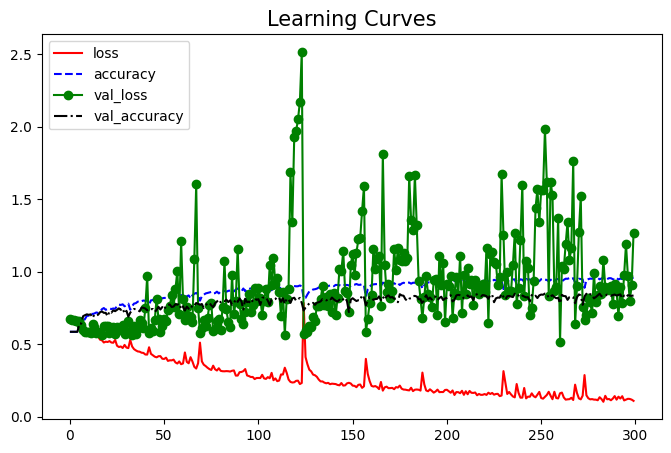

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(8))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


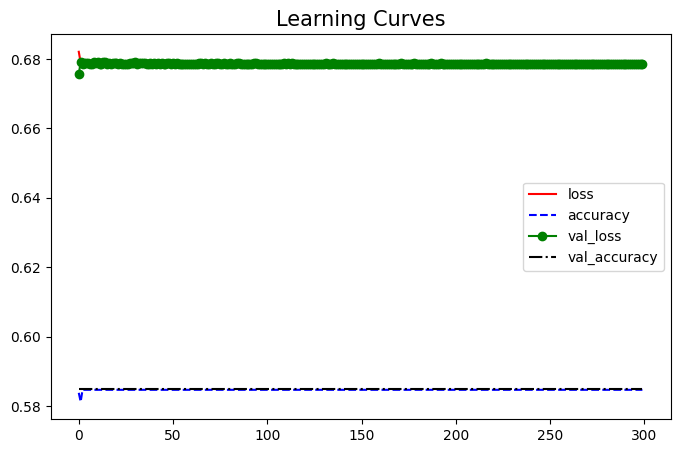

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(8))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


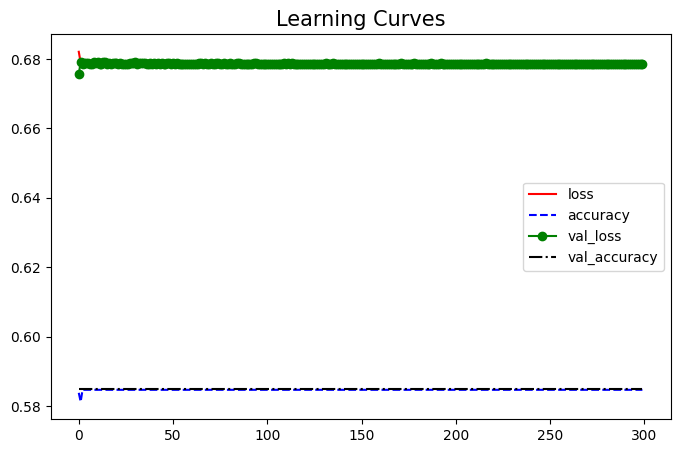

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(8))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


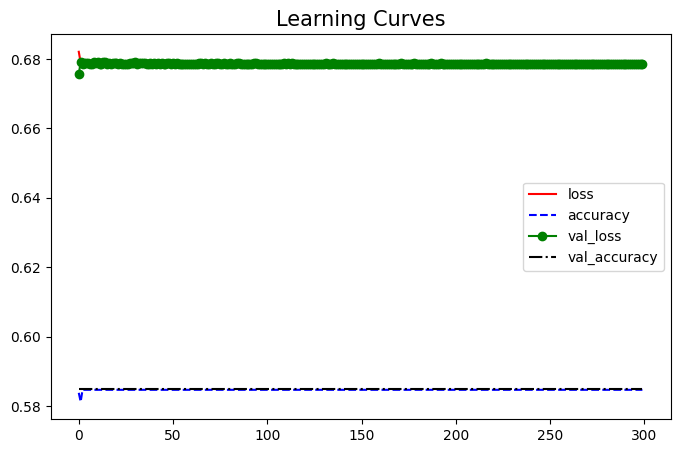

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(8))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


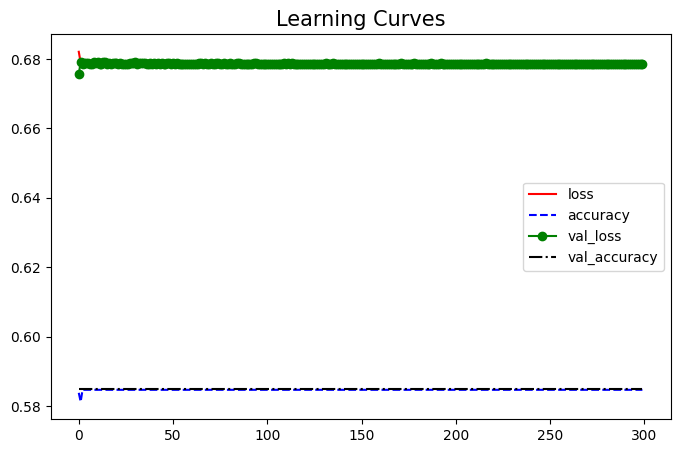

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(8))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


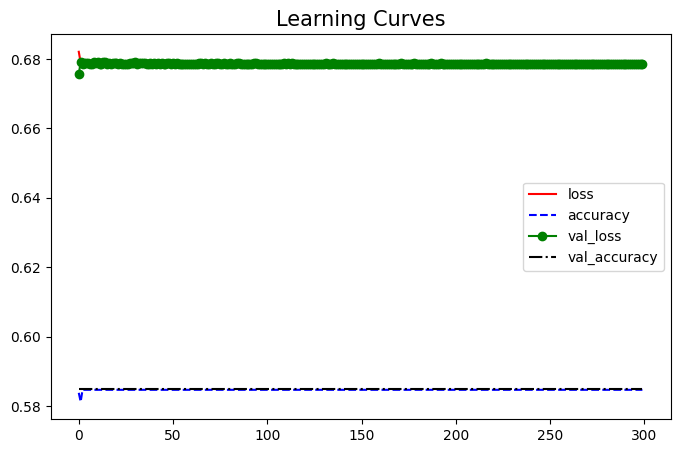

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(8))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


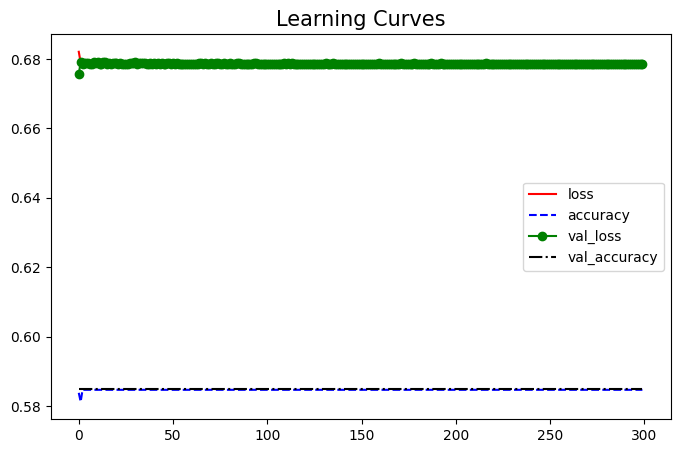

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(8))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


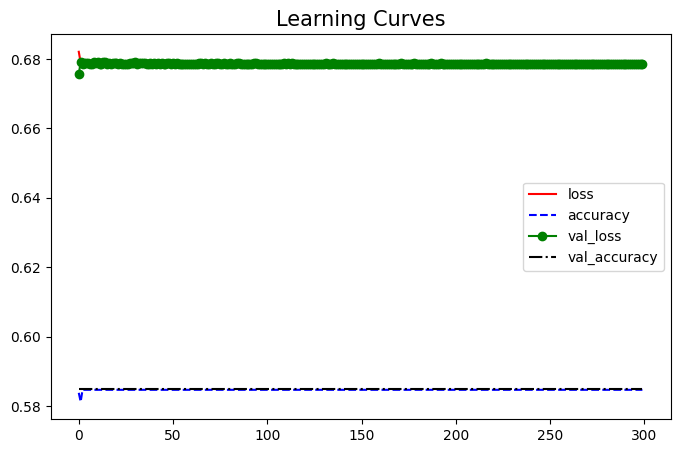

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(8))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


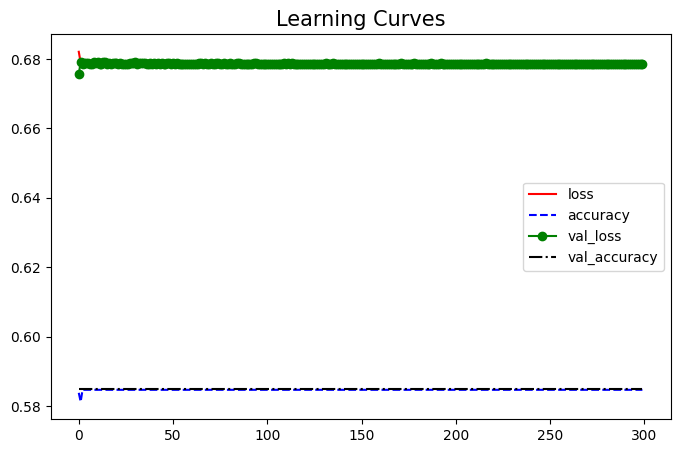

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(8))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


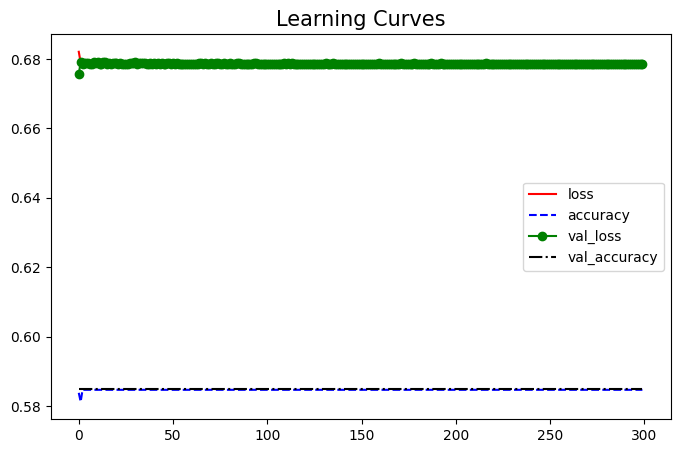

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(8))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


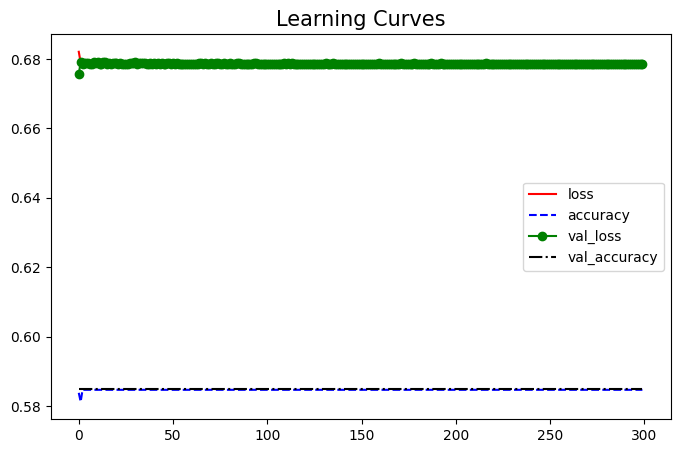

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 9-D AE (4 Layers)

#### 12 Layer Decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(9))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_41 (Dense)            (None, 60)                4560      
                                                                 
 dense_42 (Dense)            (None, 30)                1830      
                                                                 
 dense_43 (Dense)            (None, 15)                465       
                                                                 
 dense_44 (Dense)            (None, 5)                 80        
                                                                 
 dense_45 (Dense)            (None, 10)                60        
                                                                 
 dense_46 (Dense)            (None, 20)                220       
                                                                 
 dense_47 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 12s 20ms/step - loss: 0.6822 - accuracy: 0.5844 - val_loss: 0.6699 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6773 - accuracy: 0.5847 - val_loss: 0.6691 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6768 - accuracy: 0.5847 - val_loss: 0.6643 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 8s 22ms/step - loss: 0.6709 - accuracy: 0.5847 - val_loss: 0.6599 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6655 - accuracy: 0.5847 - val_loss: 0.6568 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 20ms/step - loss: 0.6645 - accuracy: 0.5847 - val_loss: 0.6573 - val_accuracy: 0.6411
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6481 - accuracy: 0.6332 - val_loss: 0.6297 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8412844036697248


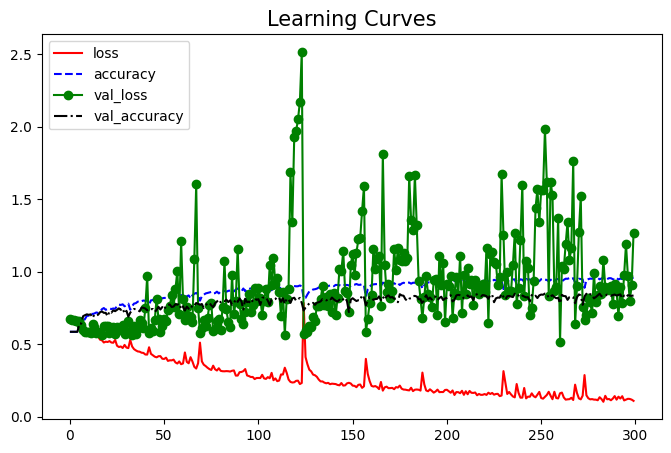

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(9))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


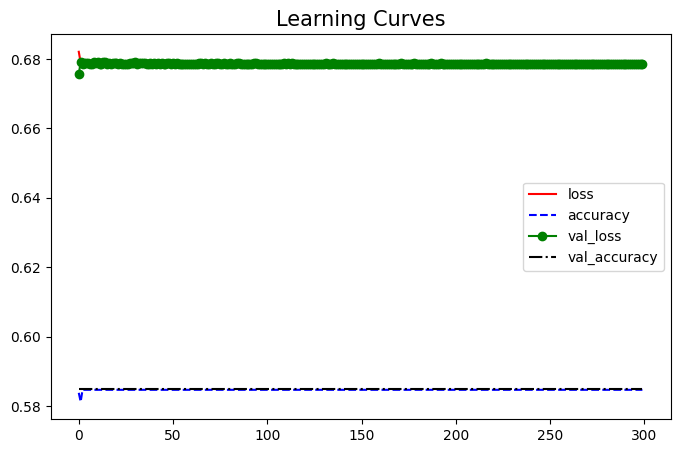

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(9))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


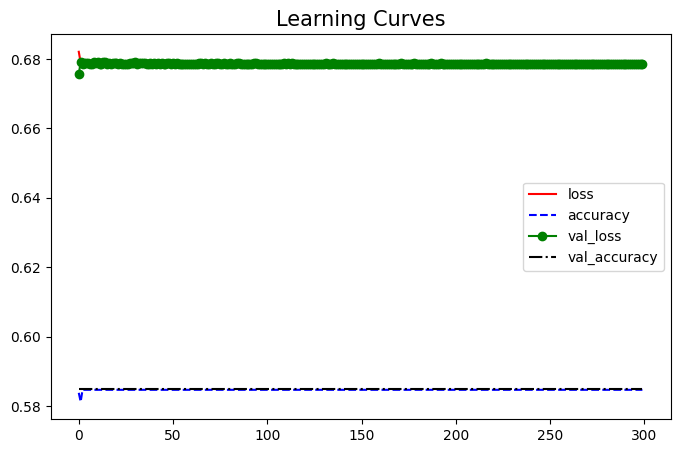

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(9))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


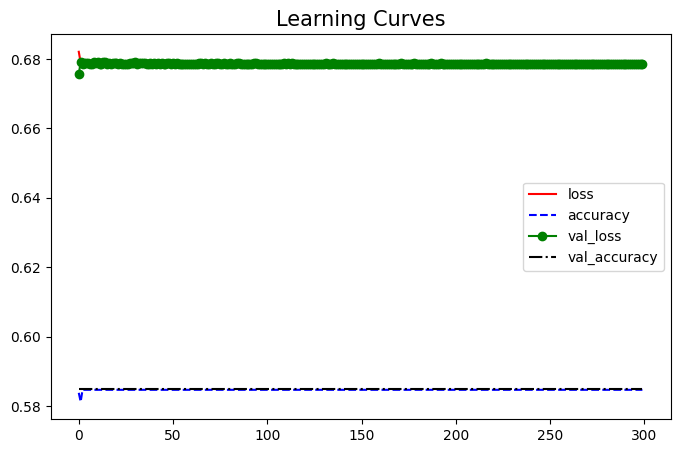

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(9))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


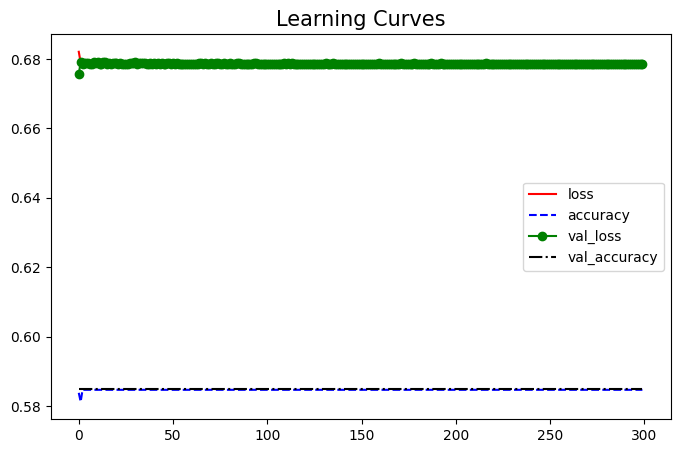

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(9))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


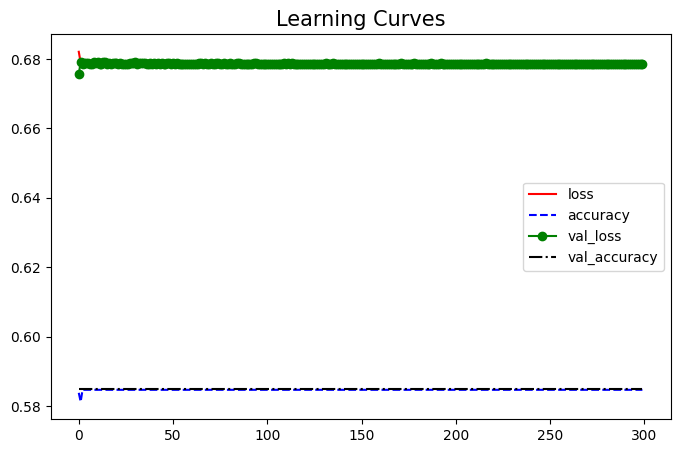

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(9))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


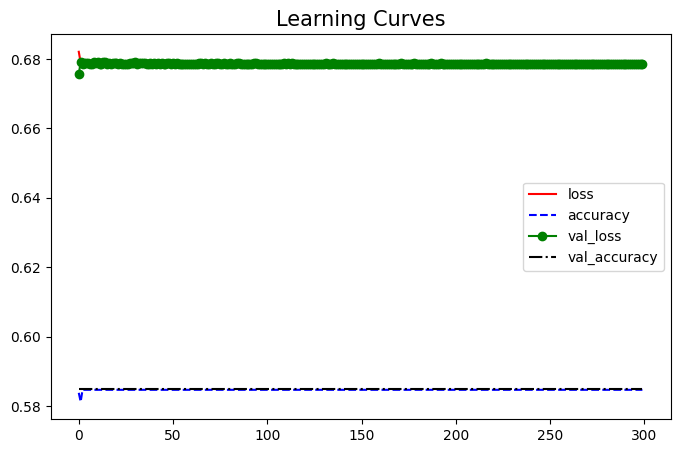

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(9))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


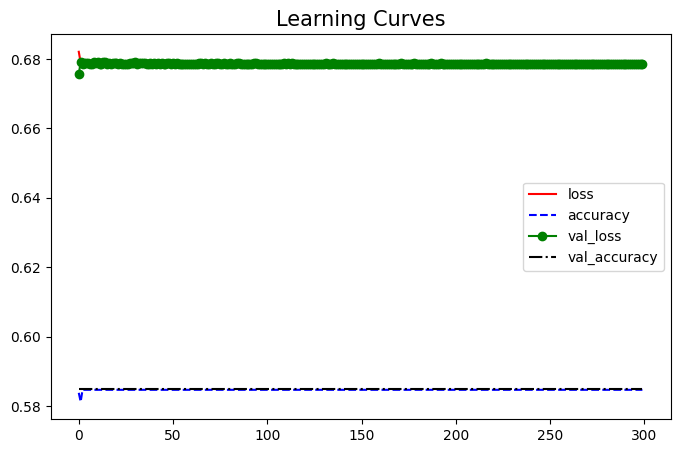

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(9))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


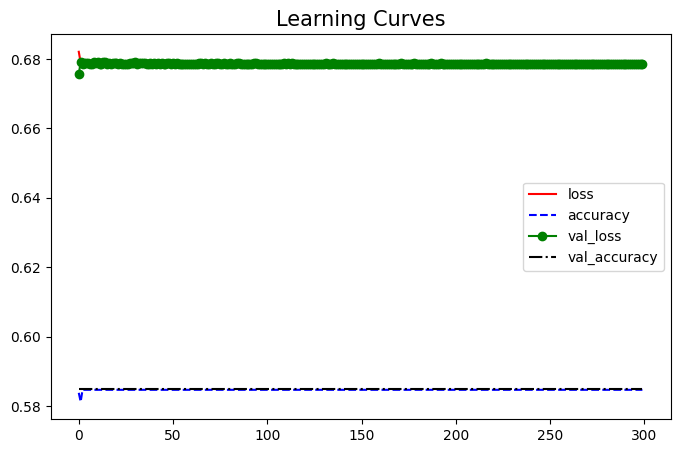

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(9))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


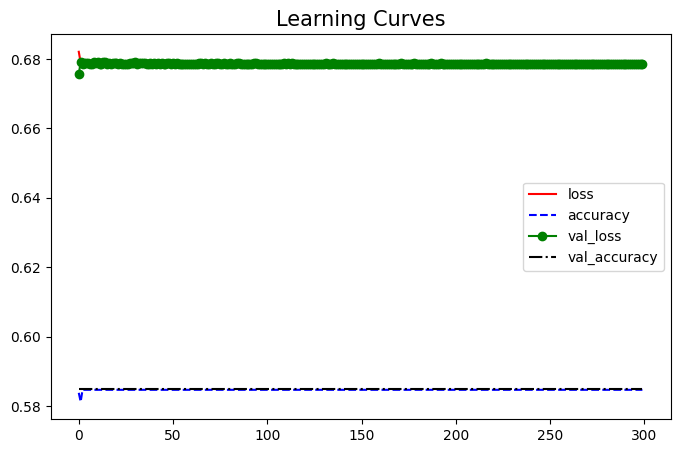

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(9))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


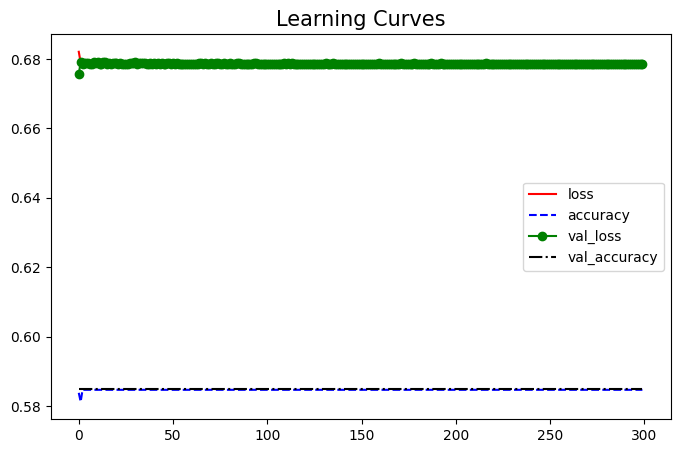

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 10-D AE (4 Layers)

#### 12 layer decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_56 (Dense)            (None, 60)                4560      
                                                                 
 dense_57 (Dense)            (None, 30)                1830      
                                                                 
 dense_58 (Dense)            (None, 15)                465       
                                                                 
 dense_59 (Dense)            (None, 10)                160       
                                                                 
 dense_60 (Dense)            (None, 10)                110       
                                                                 
 dense_61 (Dense)            (None, 20)                220       
                                                                 
 dense_62 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 7s 14ms/step - loss: 0.6793 - accuracy: 0.5824 - val_loss: 0.6741 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 3s 10ms/step - loss: 0.6722 - accuracy: 0.5832 - val_loss: 0.6594 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 3s 9ms/step - loss: 0.6715 - accuracy: 0.5933 - val_loss: 0.6529 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 3s 9ms/step - loss: 0.6648 - accuracy: 0.5847 - val_loss: 0.6489 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 5s 14ms/step - loss: 0.6617 - accuracy: 0.5927 - val_loss: 0.6486 - val_accuracy: 0.6021
Epoch 6/300
349/349 [==============================] - 4s 10ms/step - loss: 0.6743 - accuracy: 0.5852 - val_loss: 0.6699 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 3s 10ms/step - loss: 0.6645 - accuracy: 0.5847 - val_loss: 0.6547 - val_accuracy: 0

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8321100917431192


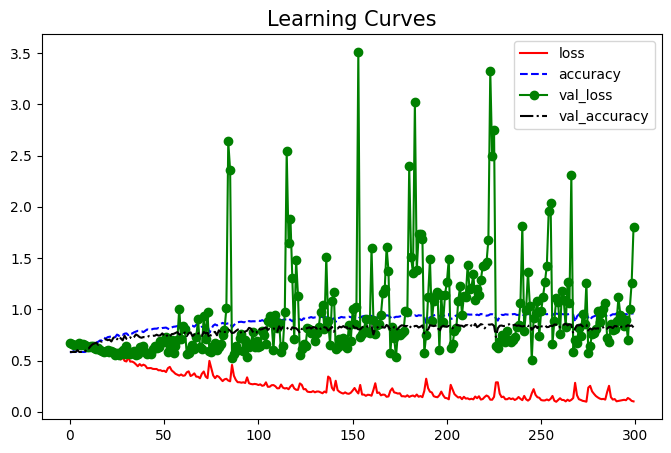

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


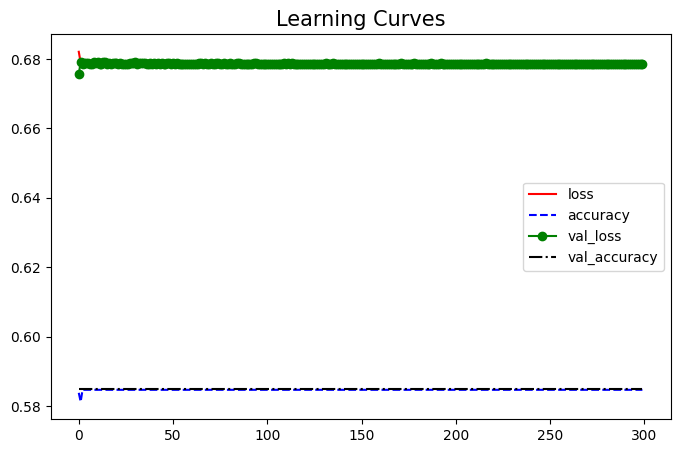

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


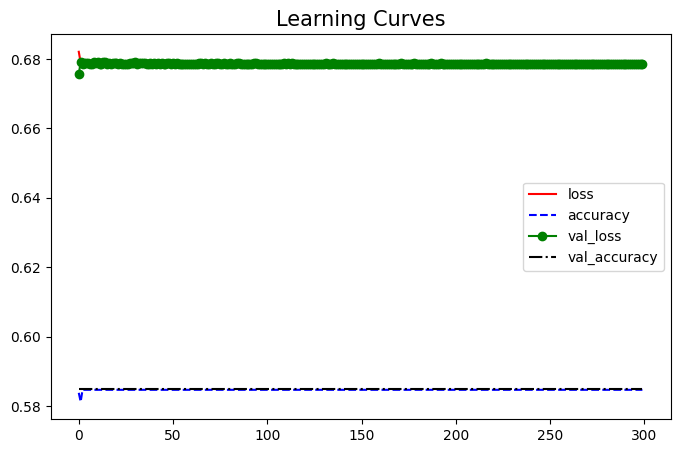

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


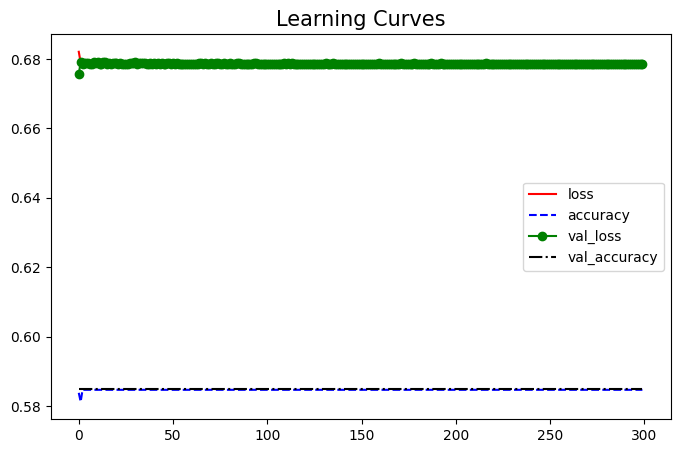

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


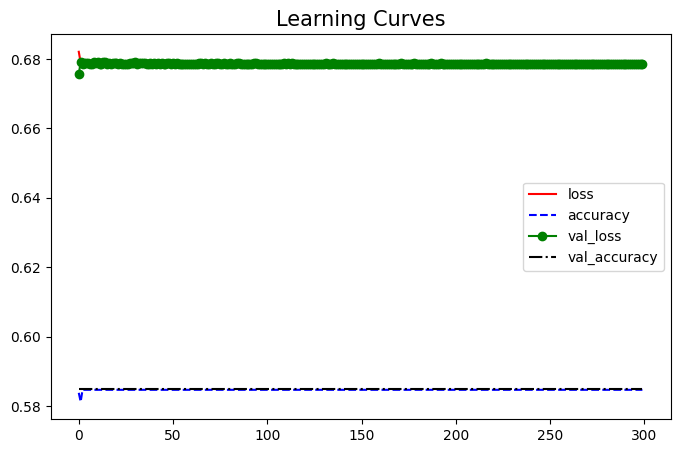

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


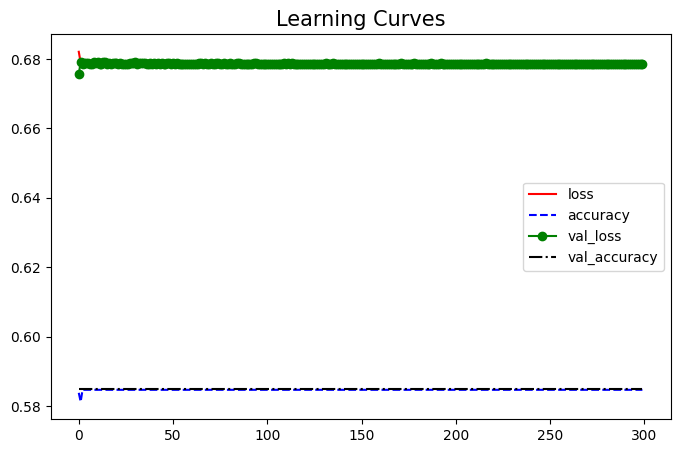

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


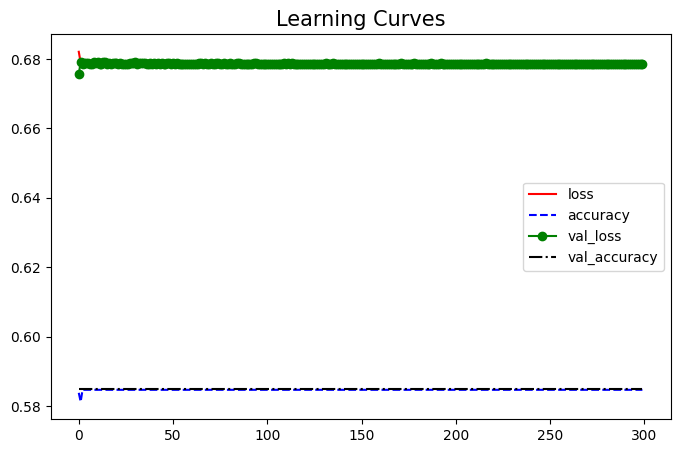

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


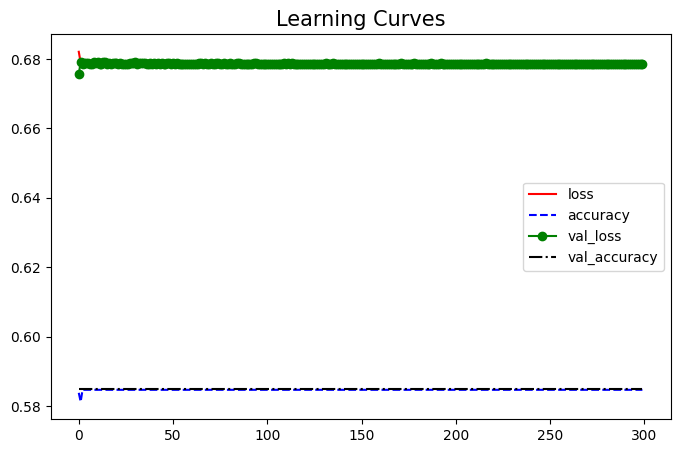

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


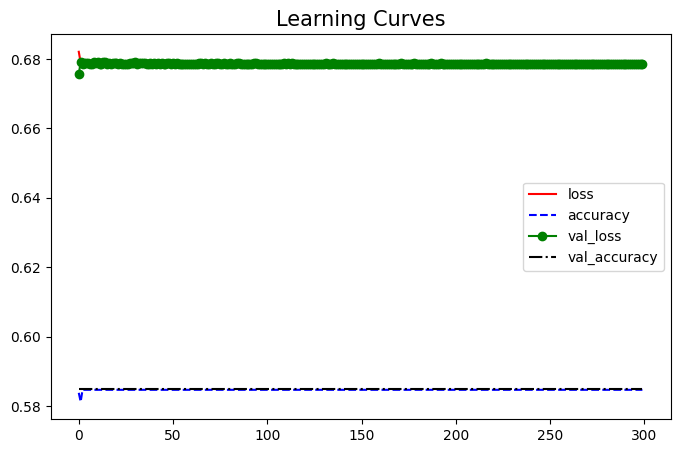

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


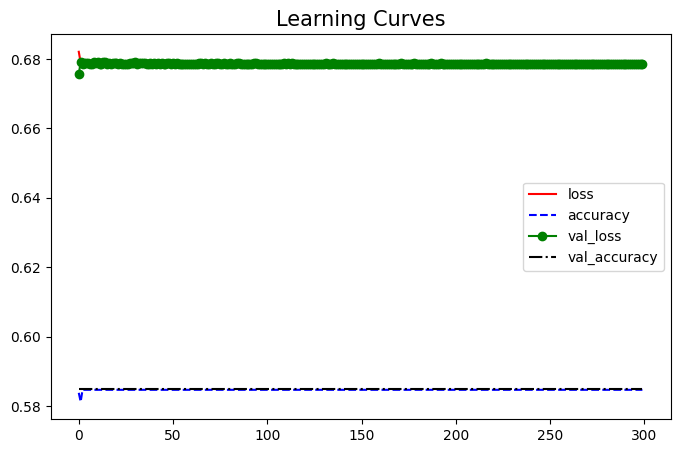

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


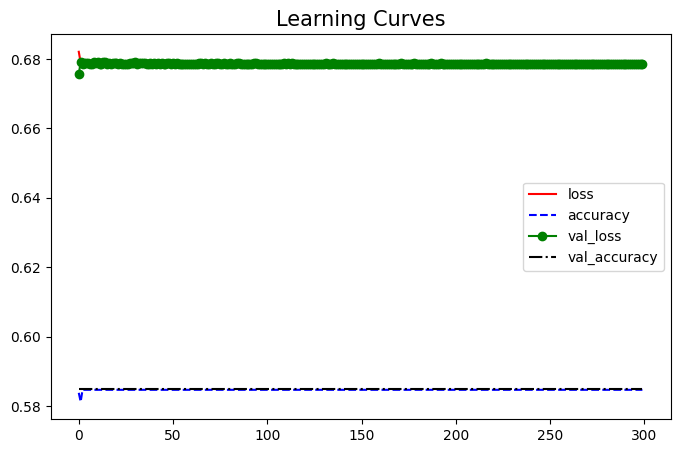

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 11-D AE (4 Layers)

#### 12 Layer Decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(11))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_41 (Dense)            (None, 60)                4560      
                                                                 
 dense_42 (Dense)            (None, 30)                1830      
                                                                 
 dense_43 (Dense)            (None, 15)                465       
                                                                 
 dense_44 (Dense)            (None, 5)                 80        
                                                                 
 dense_45 (Dense)            (None, 10)                60        
                                                                 
 dense_46 (Dense)            (None, 20)                220       
                                                                 
 dense_47 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 12s 20ms/step - loss: 0.6822 - accuracy: 0.5844 - val_loss: 0.6699 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6773 - accuracy: 0.5847 - val_loss: 0.6691 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6768 - accuracy: 0.5847 - val_loss: 0.6643 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 8s 22ms/step - loss: 0.6709 - accuracy: 0.5847 - val_loss: 0.6599 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6655 - accuracy: 0.5847 - val_loss: 0.6568 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 20ms/step - loss: 0.6645 - accuracy: 0.5847 - val_loss: 0.6573 - val_accuracy: 0.6411
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6481 - accuracy: 0.6332 - val_loss: 0.6297 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8412844036697248


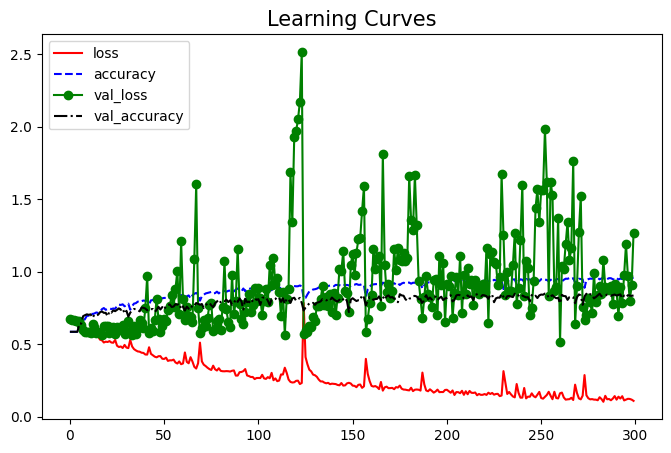

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(11))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


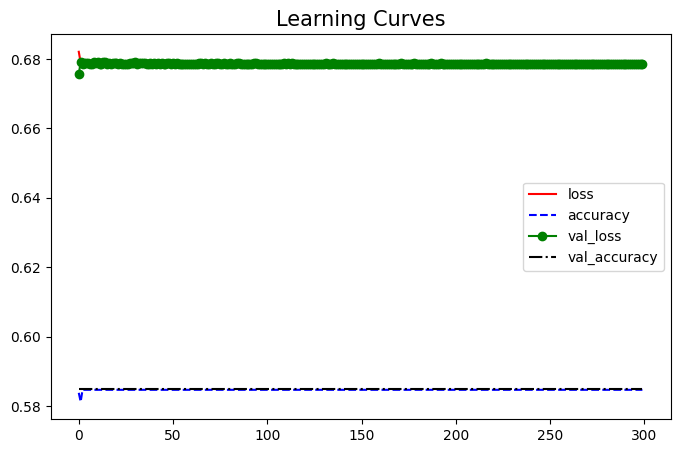

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(11))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


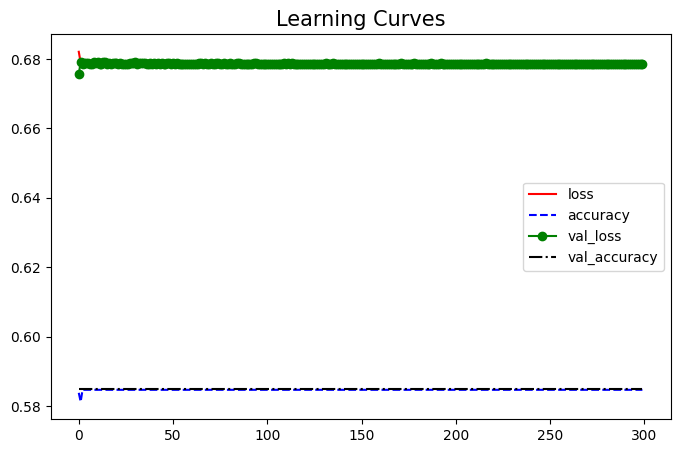

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(11))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


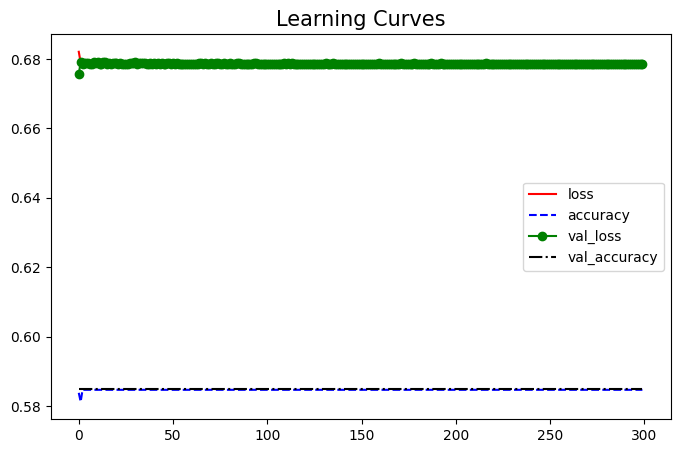

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(11))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


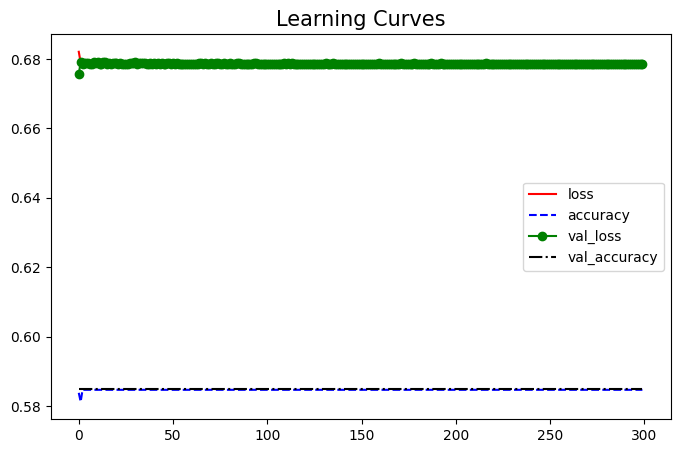

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(11))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


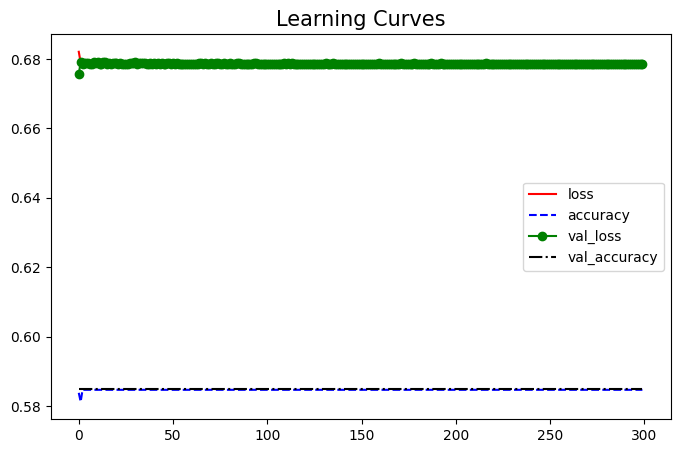

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(11))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


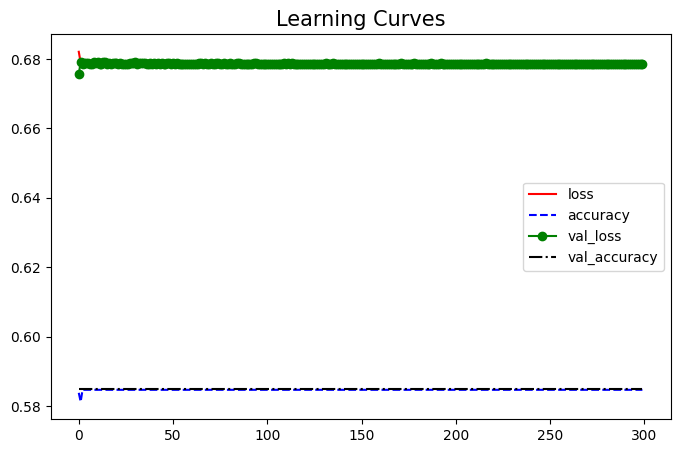

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(11))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


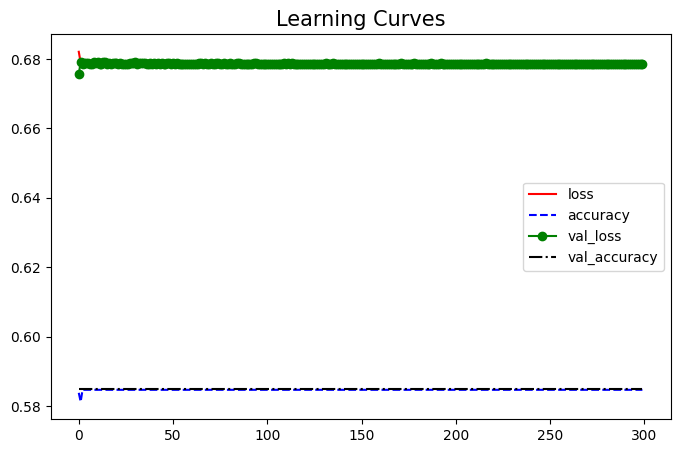

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(11))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


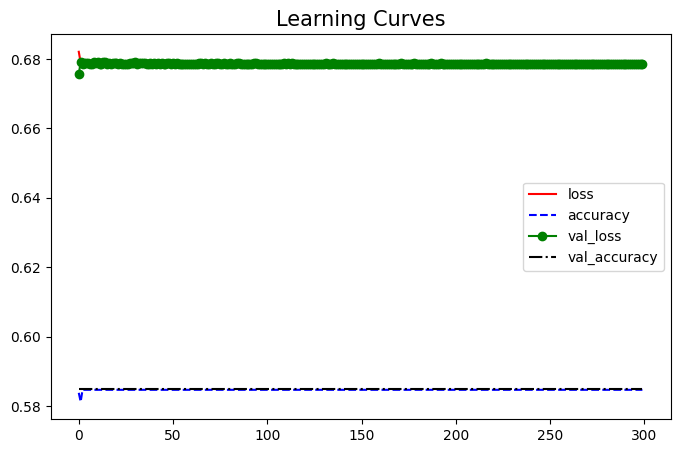

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(11))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


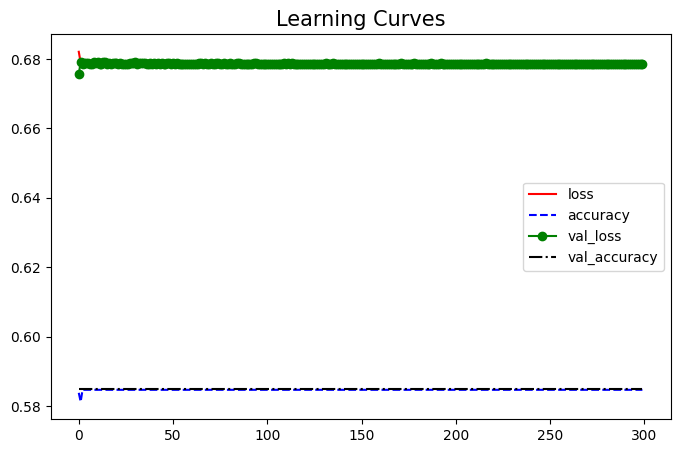

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(11))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


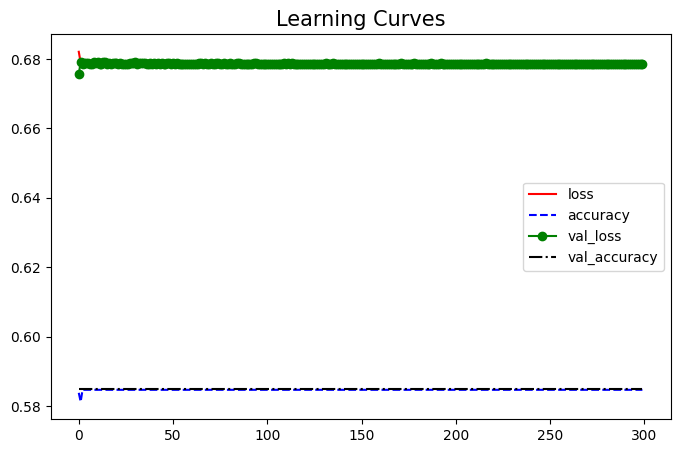

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 12-D AE (4 Layers)

#### 12 Layer Decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(12))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_41 (Dense)            (None, 60)                4560      
                                                                 
 dense_42 (Dense)            (None, 30)                1830      
                                                                 
 dense_43 (Dense)            (None, 15)                465       
                                                                 
 dense_44 (Dense)            (None, 5)                 80        
                                                                 
 dense_45 (Dense)            (None, 10)                60        
                                                                 
 dense_46 (Dense)            (None, 20)                220       
                                                                 
 dense_47 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 12s 20ms/step - loss: 0.6822 - accuracy: 0.5844 - val_loss: 0.6699 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6773 - accuracy: 0.5847 - val_loss: 0.6691 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6768 - accuracy: 0.5847 - val_loss: 0.6643 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 8s 22ms/step - loss: 0.6709 - accuracy: 0.5847 - val_loss: 0.6599 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6655 - accuracy: 0.5847 - val_loss: 0.6568 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 20ms/step - loss: 0.6645 - accuracy: 0.5847 - val_loss: 0.6573 - val_accuracy: 0.6411
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6481 - accuracy: 0.6332 - val_loss: 0.6297 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8412844036697248


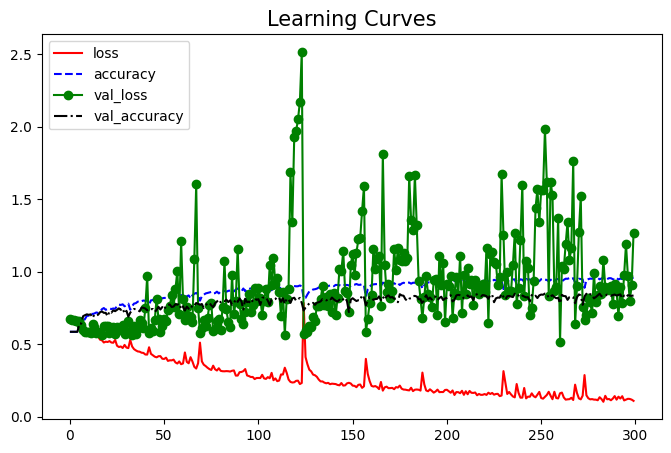

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(12))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


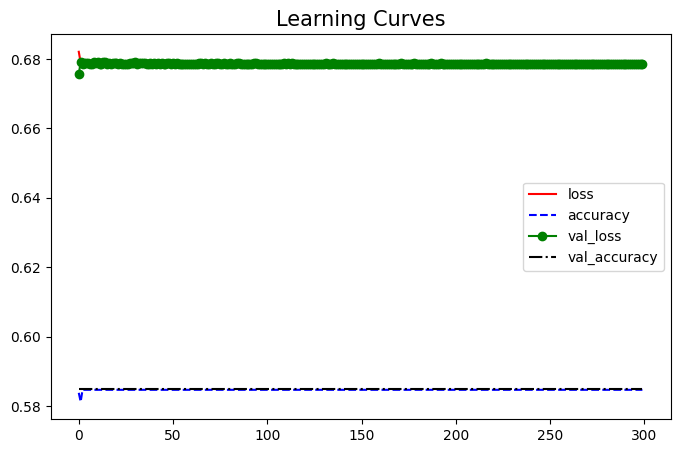

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(12))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


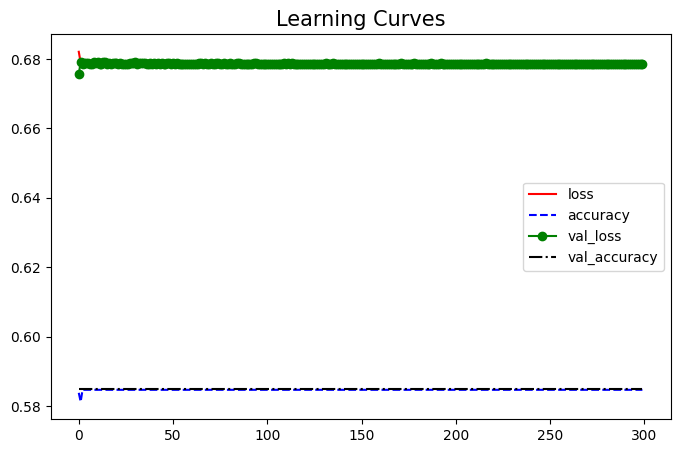

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(12))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


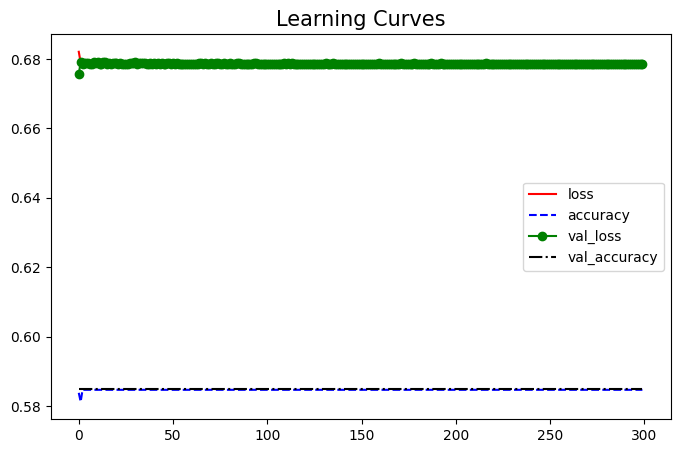

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(12))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


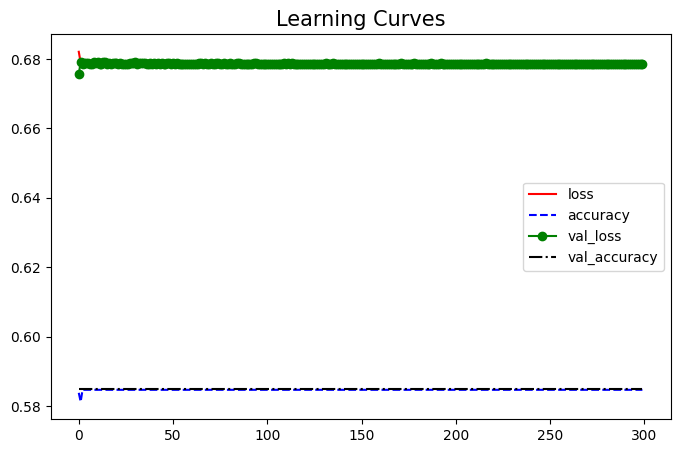

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(12))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


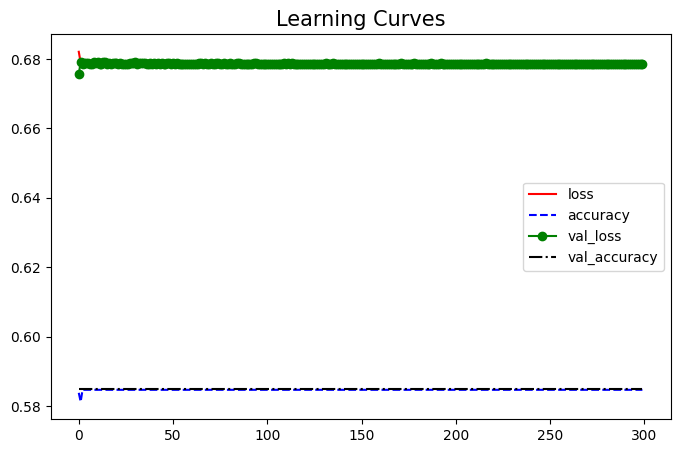

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(12))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


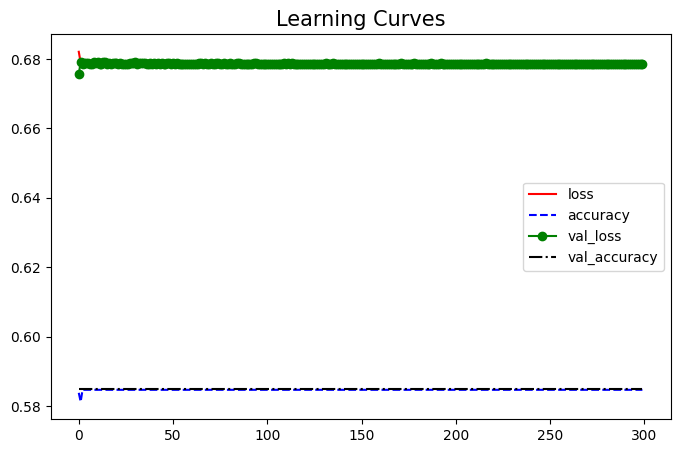

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(12))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


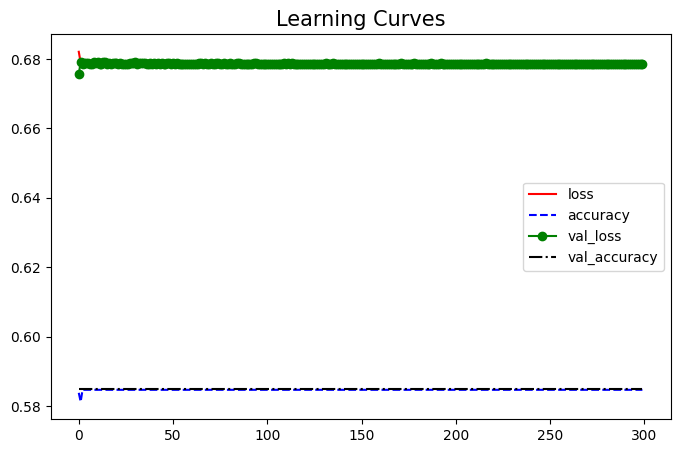

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(12))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


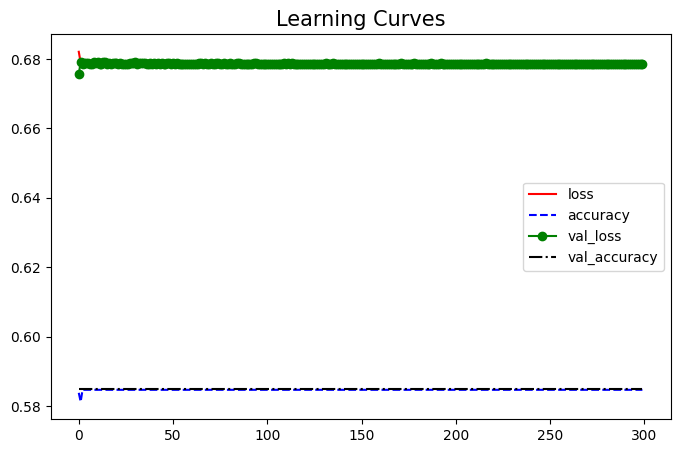

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(12))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


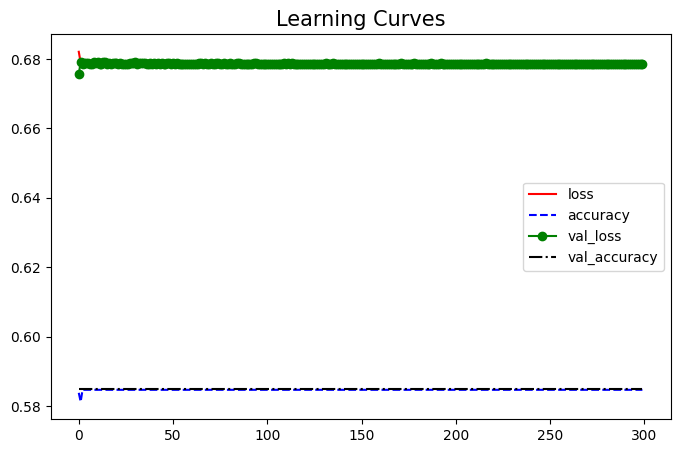

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(12))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


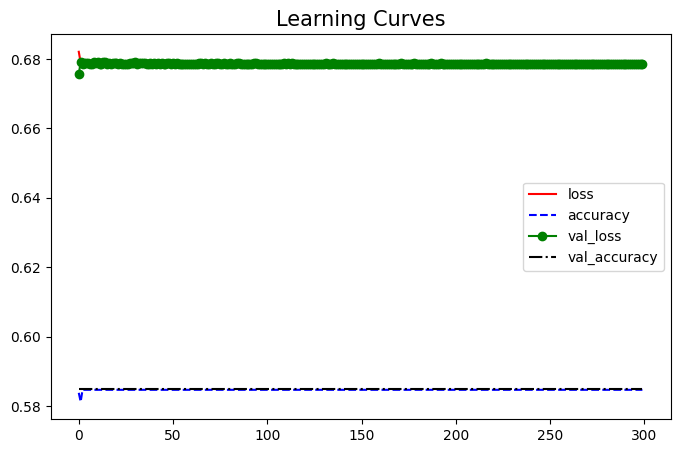

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 13-D AE (4 Layers)

#### 12 Layer Decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(13))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_41 (Dense)            (None, 60)                4560      
                                                                 
 dense_42 (Dense)            (None, 30)                1830      
                                                                 
 dense_43 (Dense)            (None, 15)                465       
                                                                 
 dense_44 (Dense)            (None, 5)                 80        
                                                                 
 dense_45 (Dense)            (None, 10)                60        
                                                                 
 dense_46 (Dense)            (None, 20)                220       
                                                                 
 dense_47 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 12s 20ms/step - loss: 0.6822 - accuracy: 0.5844 - val_loss: 0.6699 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6773 - accuracy: 0.5847 - val_loss: 0.6691 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6768 - accuracy: 0.5847 - val_loss: 0.6643 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 8s 22ms/step - loss: 0.6709 - accuracy: 0.5847 - val_loss: 0.6599 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6655 - accuracy: 0.5847 - val_loss: 0.6568 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 20ms/step - loss: 0.6645 - accuracy: 0.5847 - val_loss: 0.6573 - val_accuracy: 0.6411
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6481 - accuracy: 0.6332 - val_loss: 0.6297 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8412844036697248


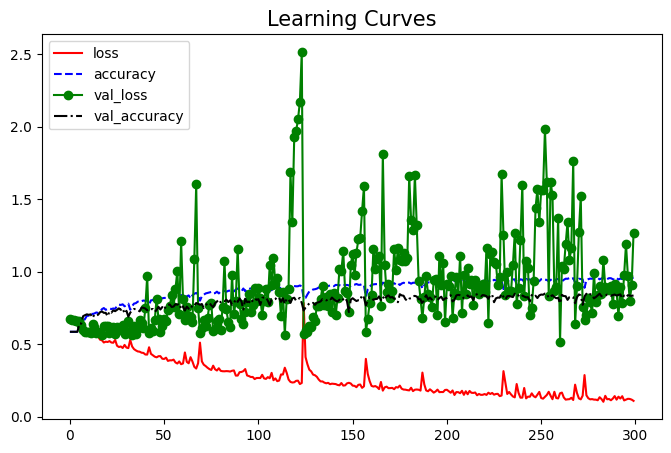

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(13))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


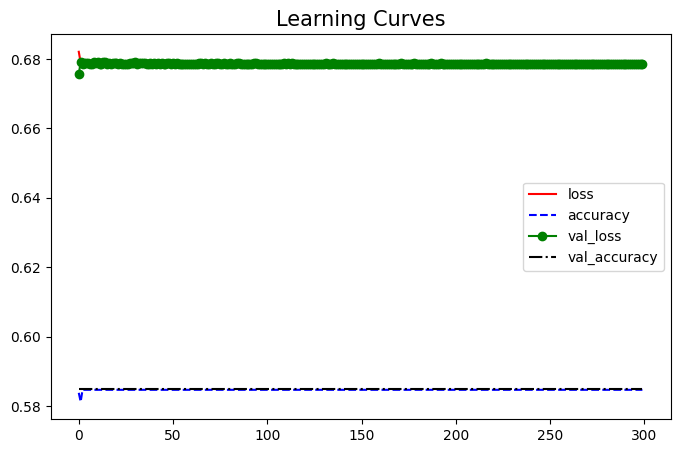

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(13))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


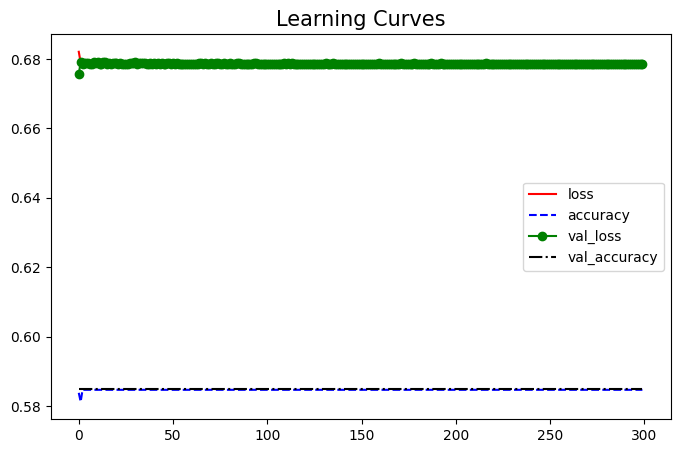

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(13))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


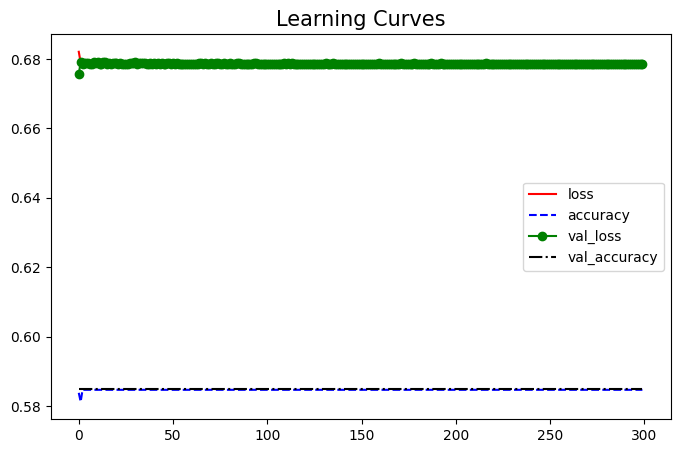

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(13))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


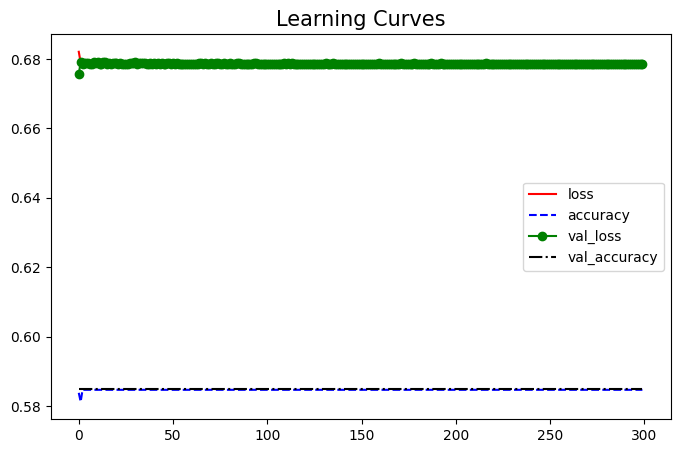

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(13))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


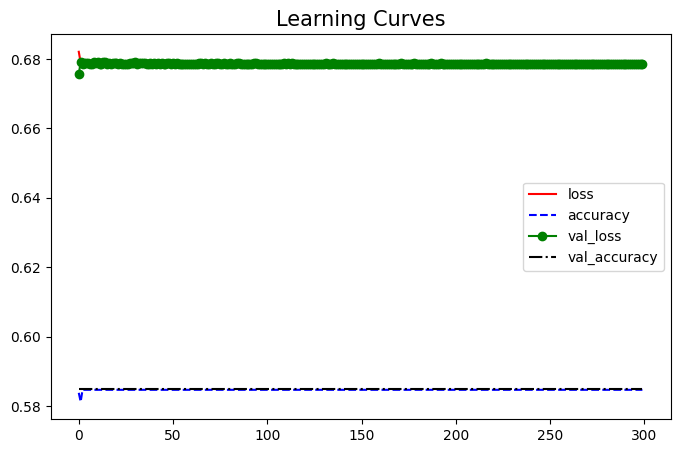

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(13))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


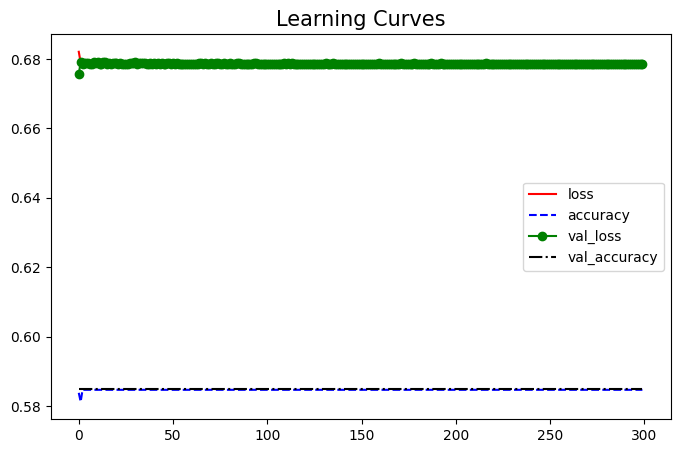

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(13))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


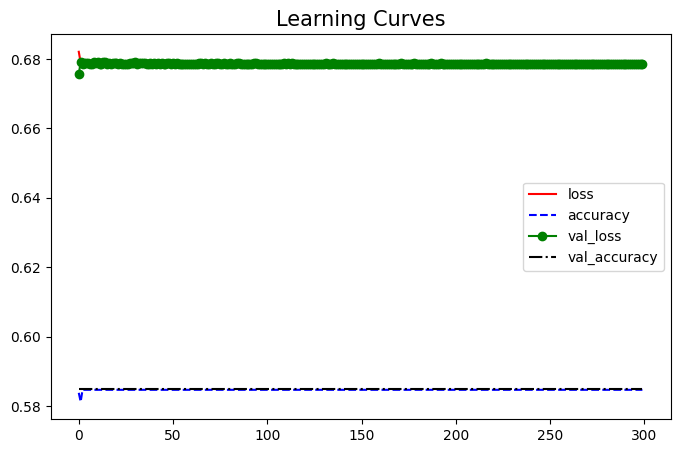

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(13))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


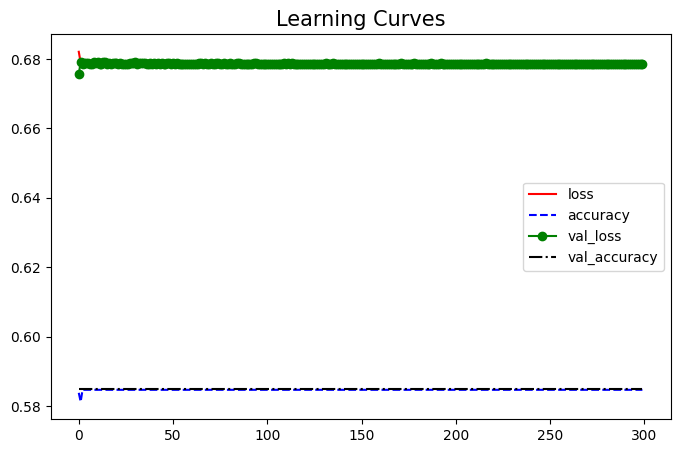

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(13))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


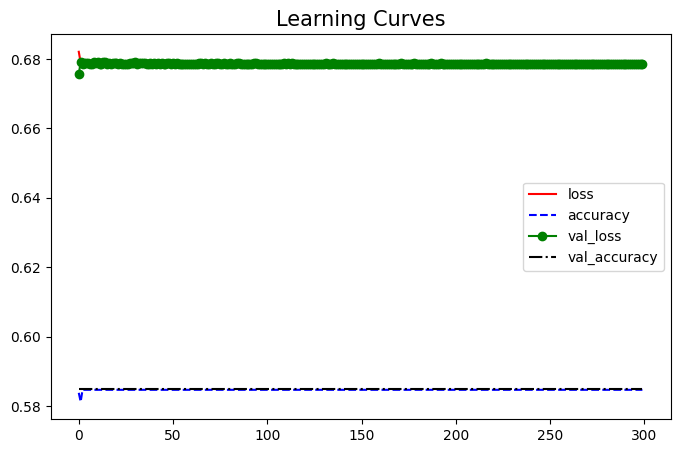

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(13))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


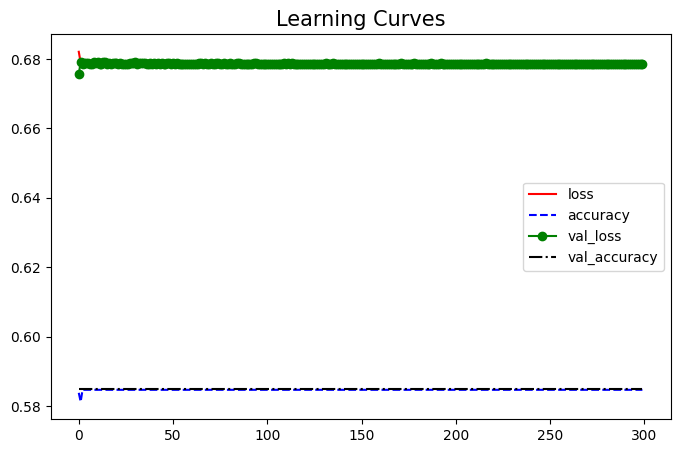

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 14-D AE (4 Layers)

#### 12 Layer Decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(14))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_41 (Dense)            (None, 60)                4560      
                                                                 
 dense_42 (Dense)            (None, 30)                1830      
                                                                 
 dense_43 (Dense)            (None, 15)                465       
                                                                 
 dense_44 (Dense)            (None, 5)                 80        
                                                                 
 dense_45 (Dense)            (None, 10)                60        
                                                                 
 dense_46 (Dense)            (None, 20)                220       
                                                                 
 dense_47 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 12s 20ms/step - loss: 0.6822 - accuracy: 0.5844 - val_loss: 0.6699 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6773 - accuracy: 0.5847 - val_loss: 0.6691 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6768 - accuracy: 0.5847 - val_loss: 0.6643 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 8s 22ms/step - loss: 0.6709 - accuracy: 0.5847 - val_loss: 0.6599 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6655 - accuracy: 0.5847 - val_loss: 0.6568 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 20ms/step - loss: 0.6645 - accuracy: 0.5847 - val_loss: 0.6573 - val_accuracy: 0.6411
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6481 - accuracy: 0.6332 - val_loss: 0.6297 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8412844036697248


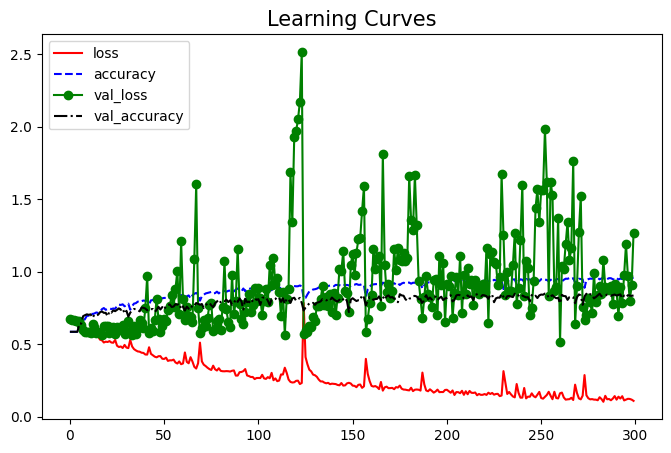

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(14))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


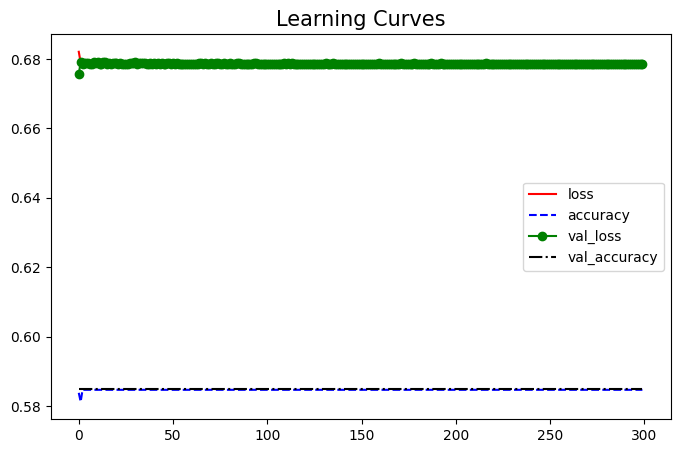

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(14))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


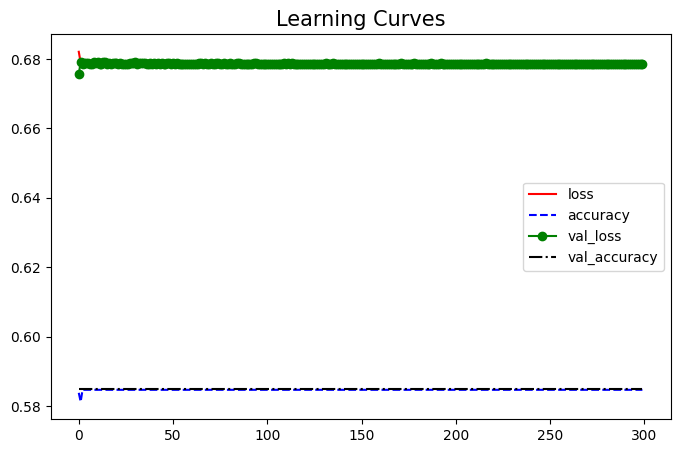

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(14))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


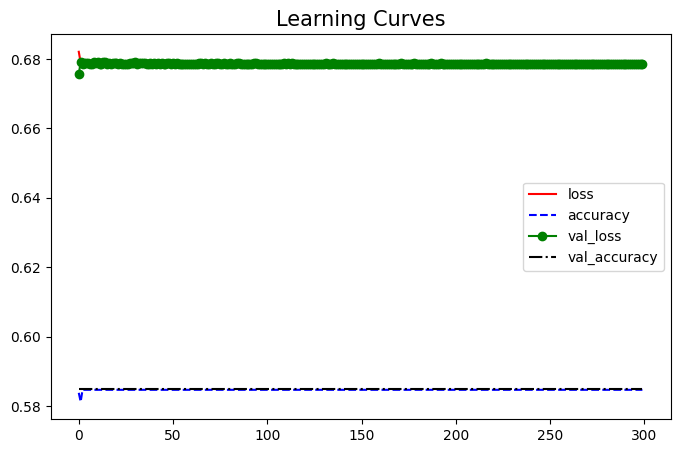

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(14))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


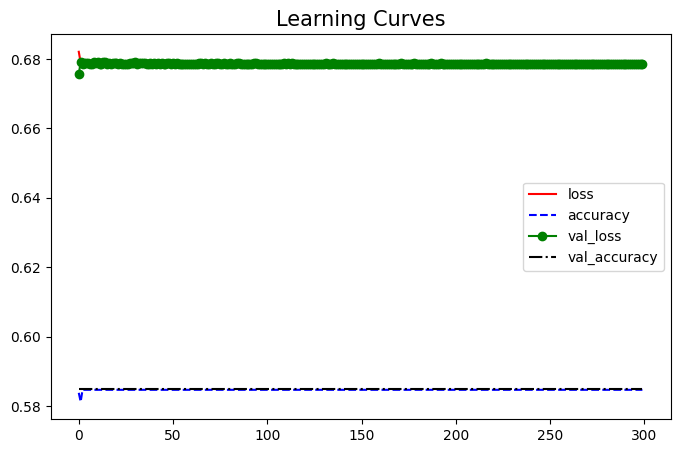

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(14))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


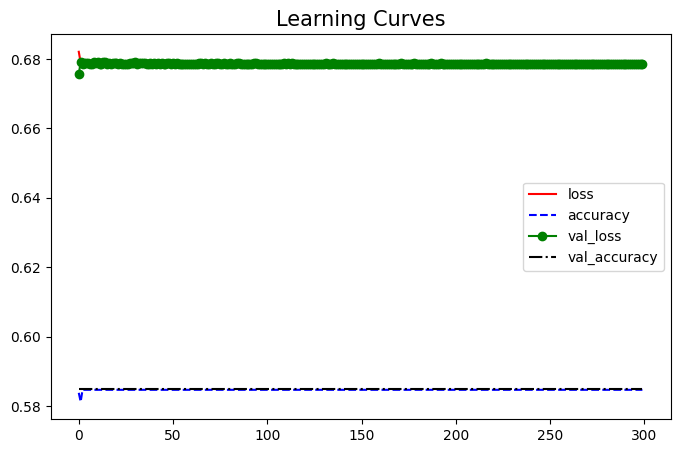

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(14))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


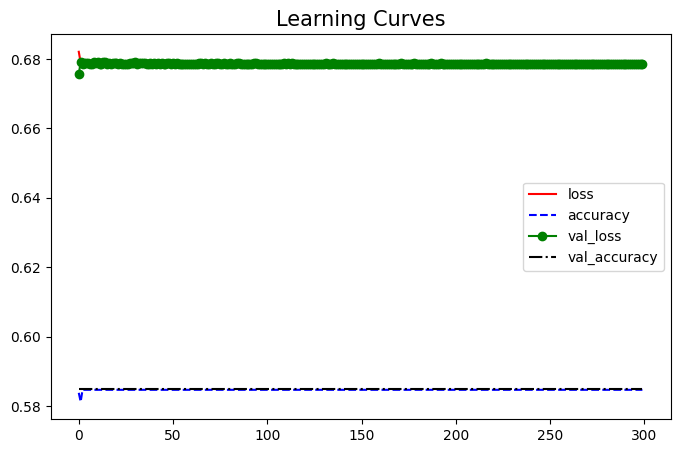

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(14))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


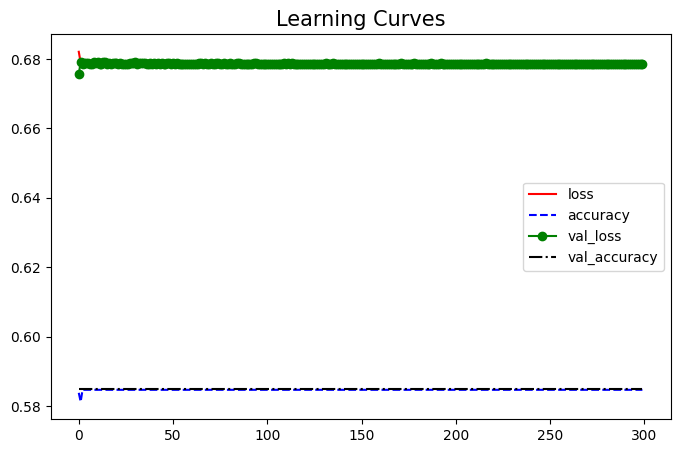

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(14))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


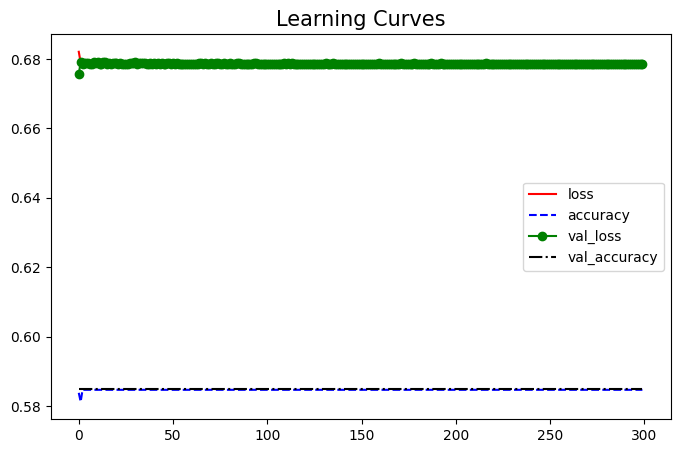

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(14))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


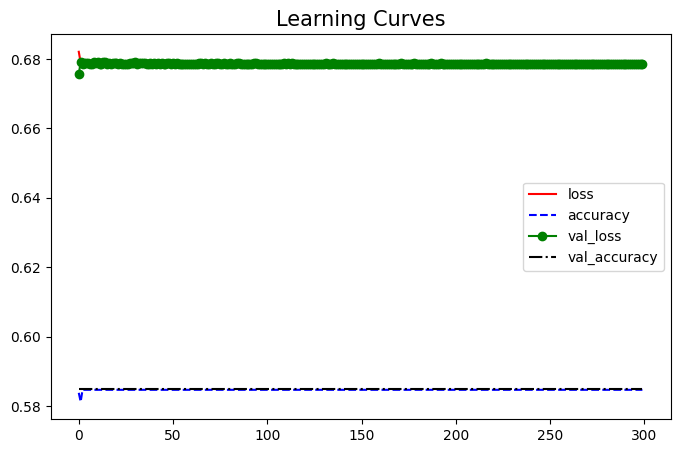

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(14))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


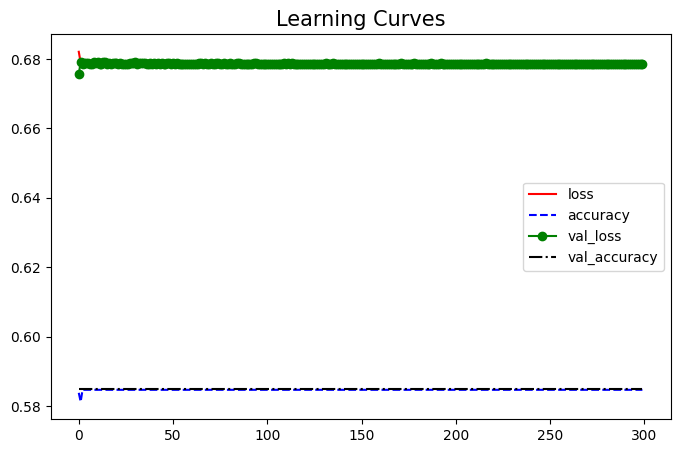

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 15-D AE (4 Layers)

#### 12 layer decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_71 (Dense)            (None, 60)                4560      
                                                                 
 dense_72 (Dense)            (None, 30)                1830      
                                                                 
 dense_73 (Dense)            (None, 20)                620       
                                                                 
 dense_74 (Dense)            (None, 15)                315       
                                                                 
 dense_75 (Dense)            (None, 10)                160       
                                                                 
 dense_76 (Dense)            (None, 20)                220       
                                                                 
 dense_77 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 8s 15ms/step - loss: 0.6797 - accuracy: 0.5838 - val_loss: 0.6666 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 3s 9ms/step - loss: 0.6729 - accuracy: 0.5881 - val_loss: 0.6690 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 3s 10ms/step - loss: 0.6666 - accuracy: 0.5993 - val_loss: 0.6733 - val_accuracy: 0.6227
Epoch 4/300
349/349 [==============================] - 4s 10ms/step - loss: 0.6645 - accuracy: 0.6019 - val_loss: 0.6616 - val_accuracy: 0.6170
Epoch 5/300
349/349 [==============================] - 5s 14ms/step - loss: 0.6546 - accuracy: 0.6237 - val_loss: 0.6422 - val_accuracy: 0.6468
Epoch 6/300
349/349 [==============================] - 3s 9ms/step - loss: 0.6454 - accuracy: 0.6470 - val_loss: 0.6479 - val_accuracy: 0.6330
Epoch 7/300
349/349 [==============================] - 3s 9ms/step - loss: 0.6515 - accuracy: 0.6217 - val_loss: 0.6711 - val_accuracy: 0.

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8174311926605504


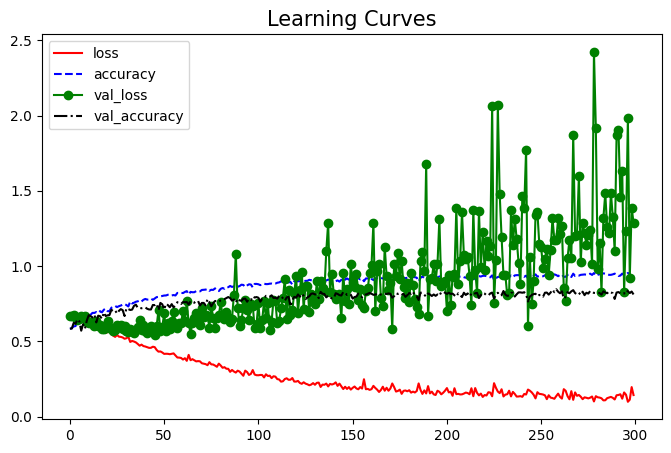

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


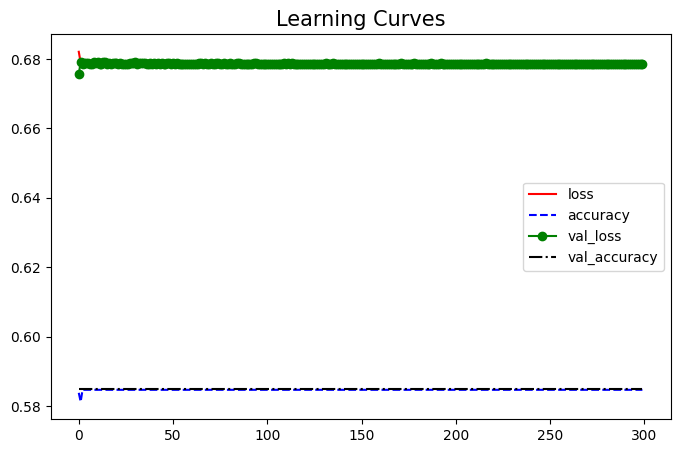

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


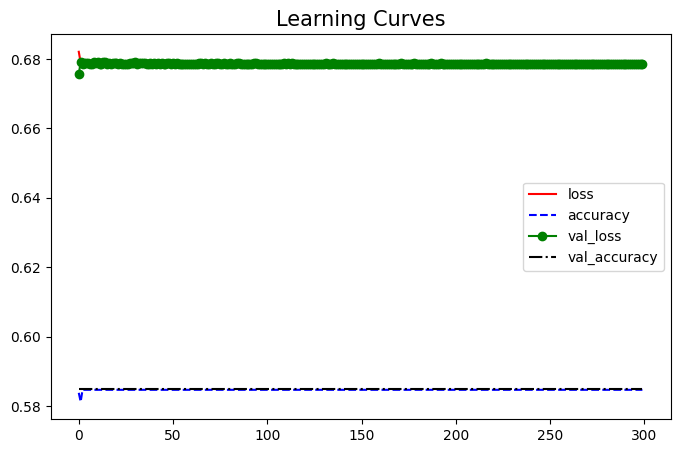

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


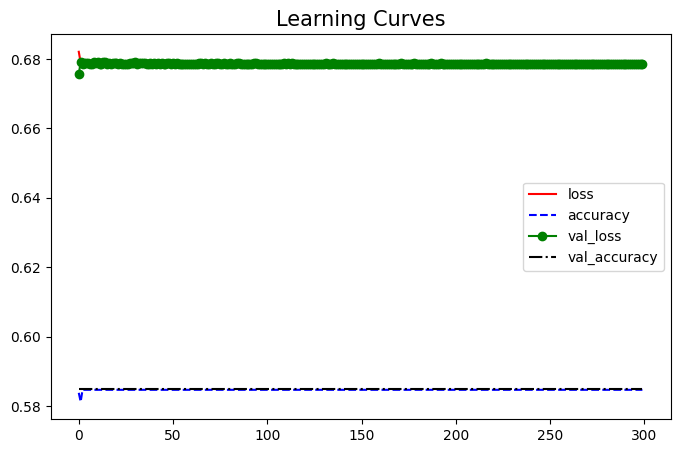

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


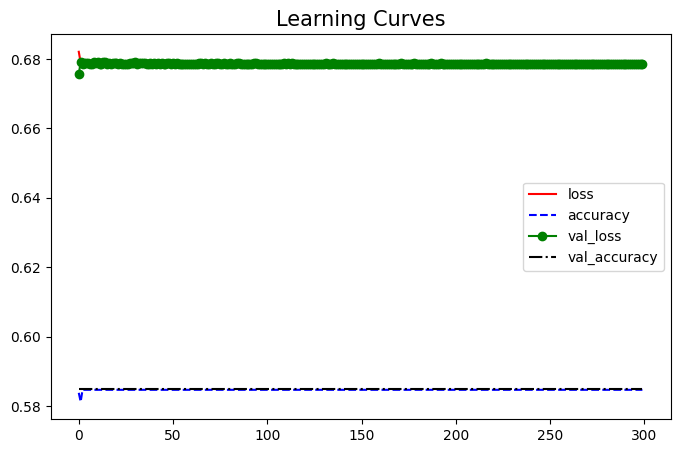

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


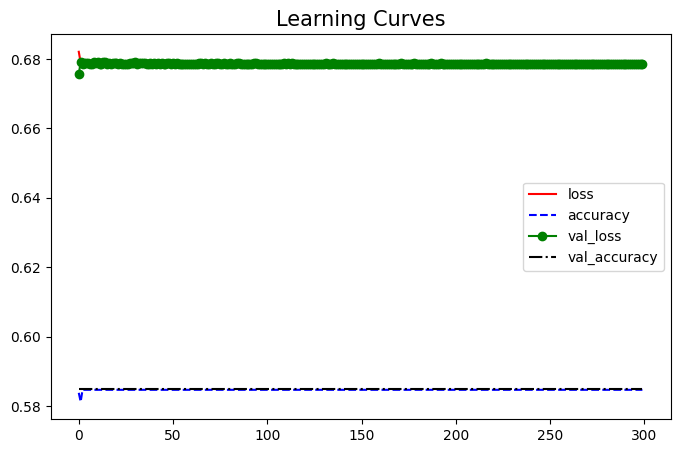

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


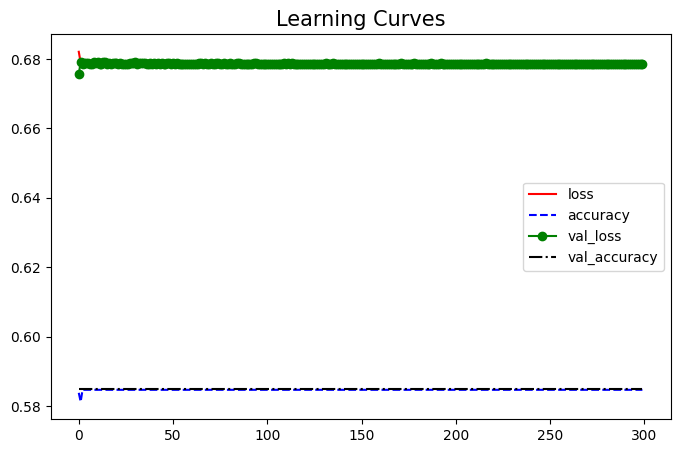

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


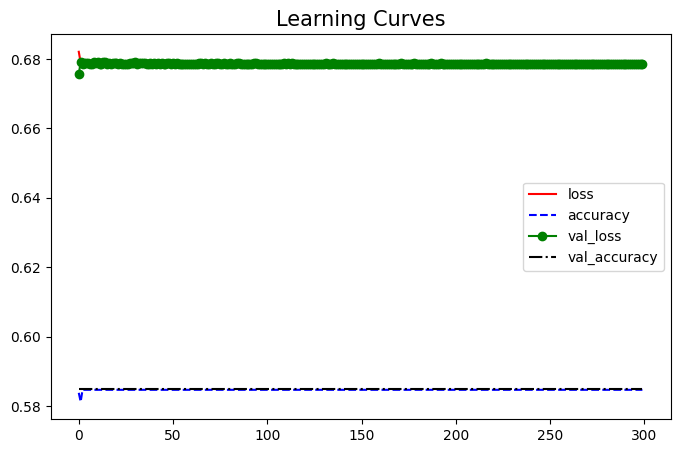

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


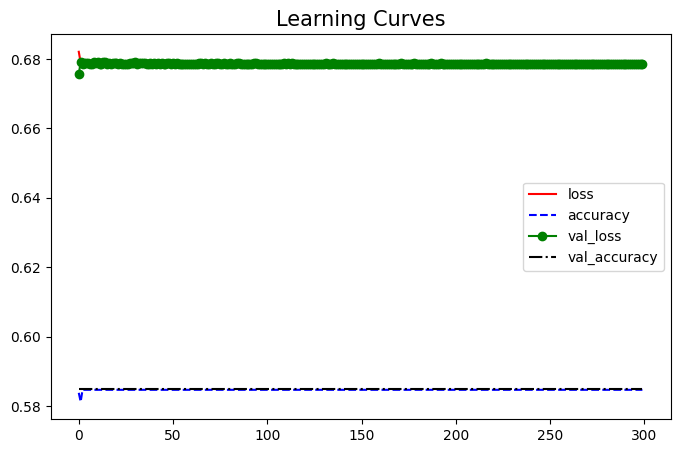

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


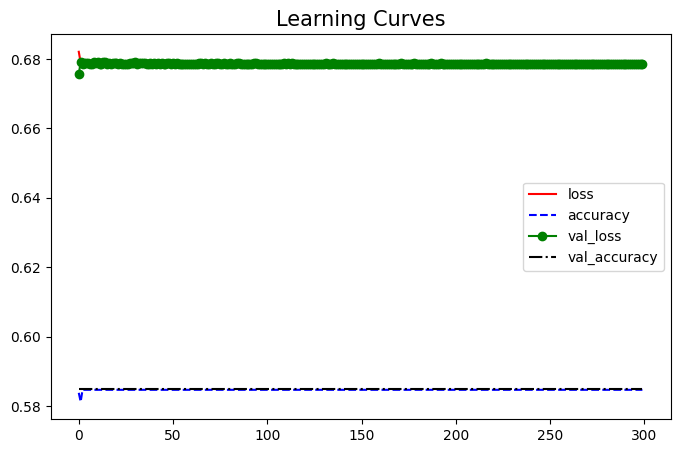

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


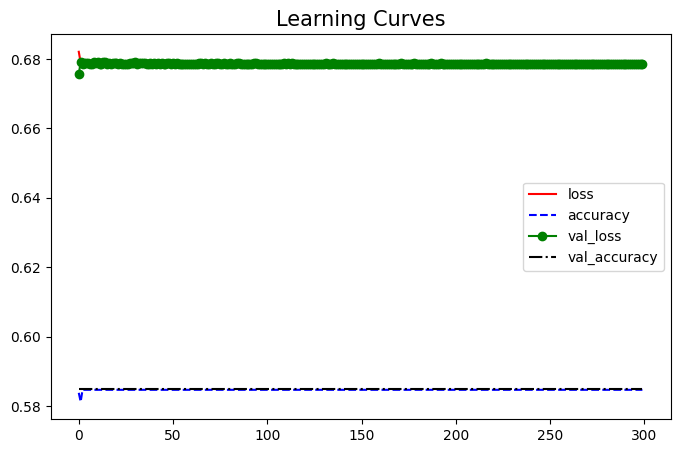

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 1-D AE (4 Layers)

#### 12 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


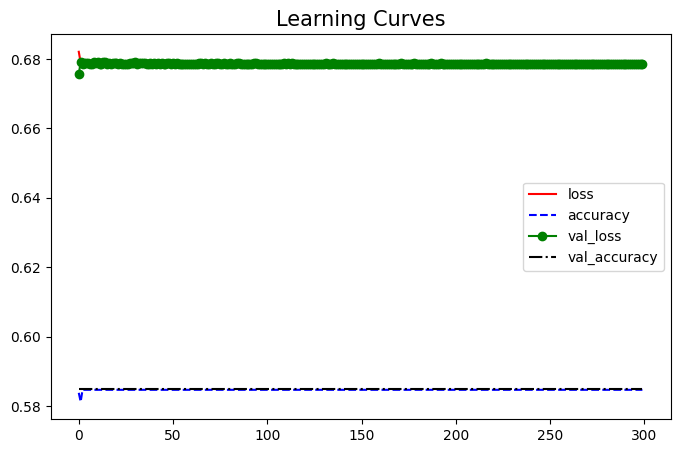

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


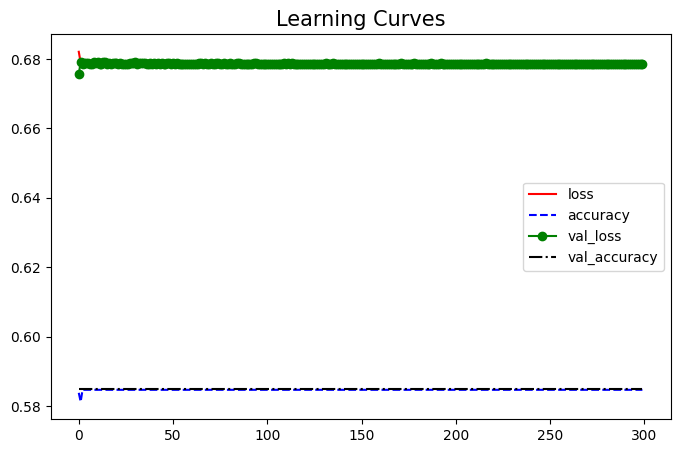

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


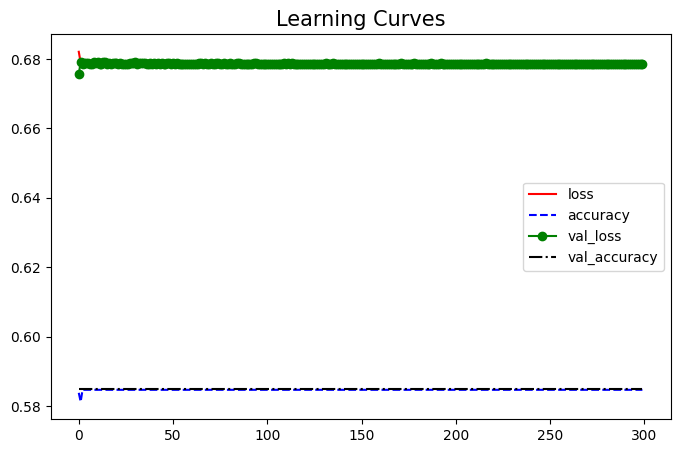

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


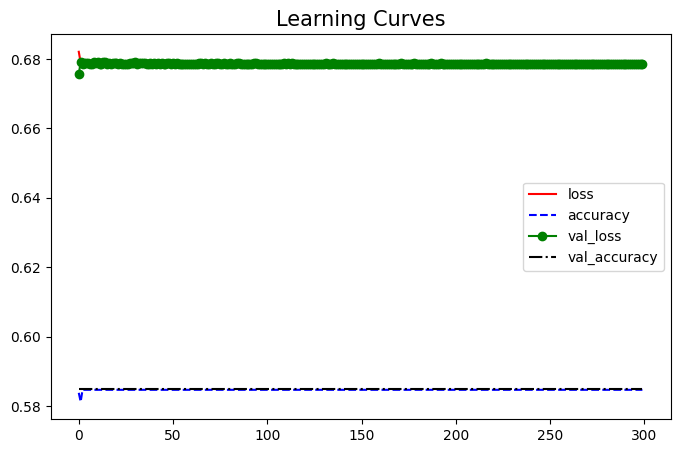

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


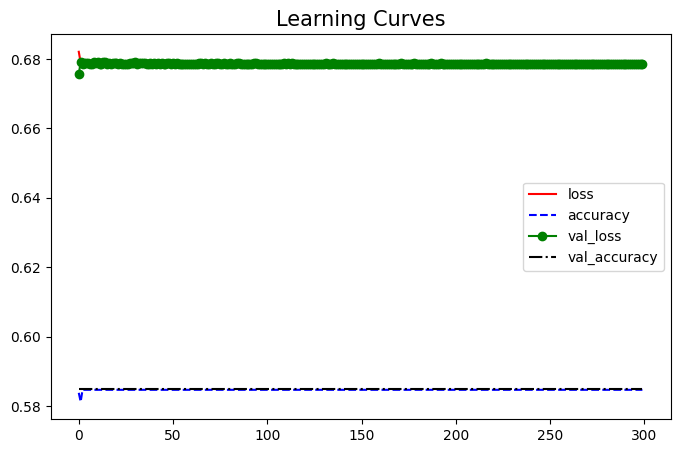

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


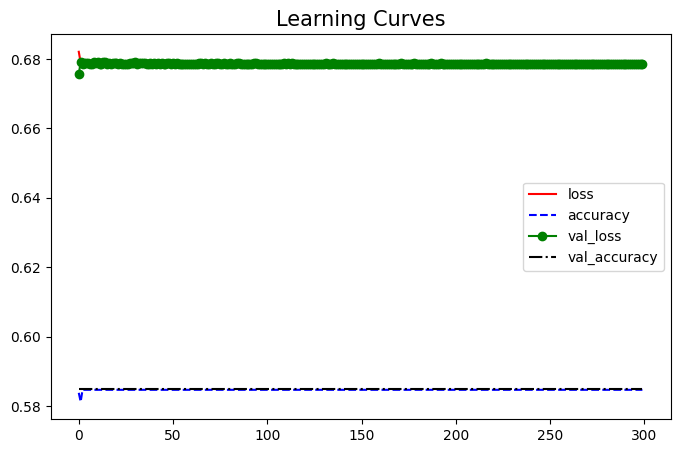

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


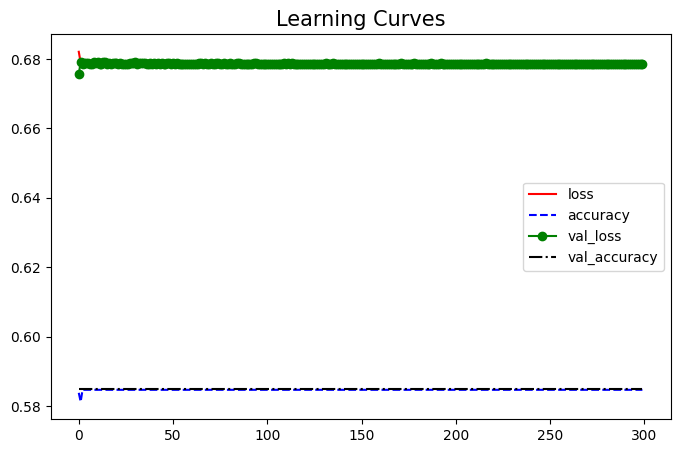

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


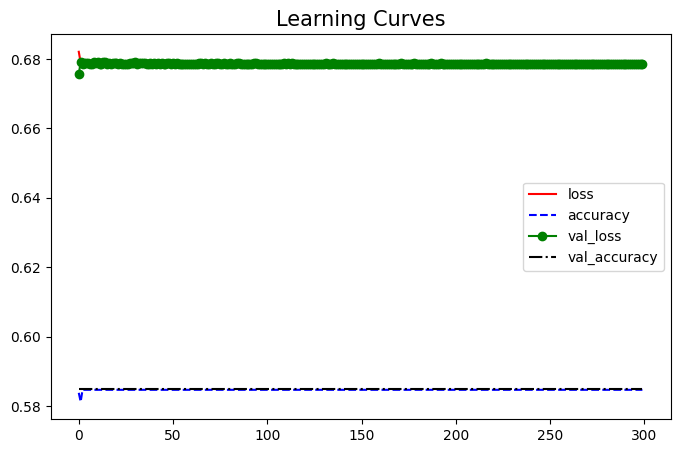

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


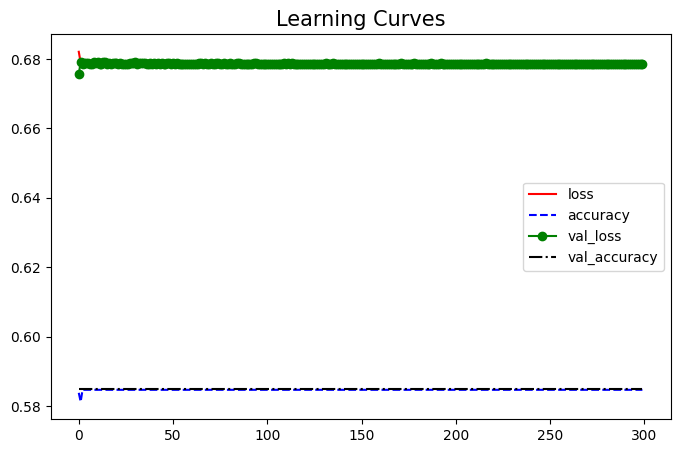

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


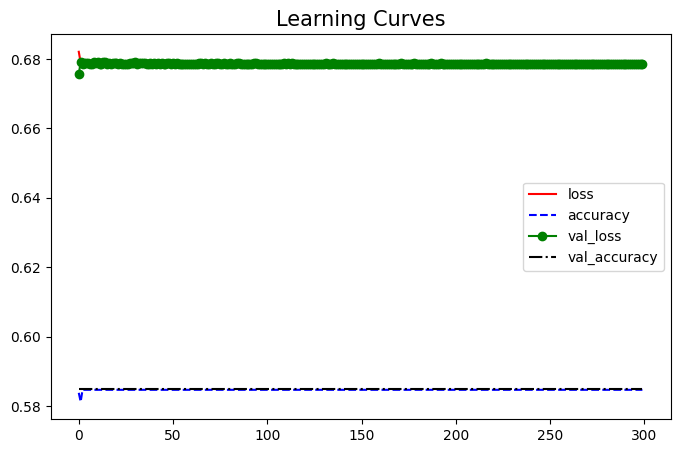

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(30,input_dim=75, activation='tanh'))
#model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


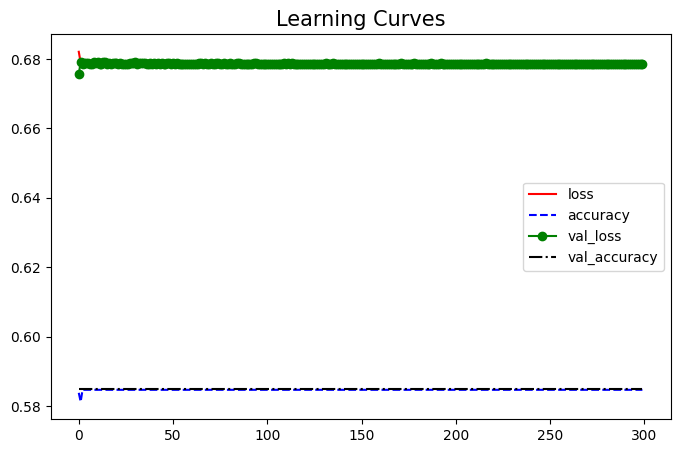

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 2-D AE (4 Layers)

#### 12 Layers Decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_48 (Dense)            (None, 60)                4560      
                                                                 
 dense_49 (Dense)            (None, 30)                1830      
                                                                 
 dense_50 (Dense)            (None, 15)                465       
                                                                 
 dense_51 (Dense)            (None, 2)                 32        
                                                                 
 dense_52 (Dense)            (None, 10)                30        
                                                                 
 dense_53 (Dense)            (None, 20)                220       
                                                                 
 dense_54 (Dense)            (None, 40)              

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 4s 6ms/step - loss: 0.6811 - accuracy: 0.5844 - val_loss: 0.6722 - val_accuracy: 0.5975
Epoch 2/300
349/349 [==============================] - 2s 5ms/step - loss: 0.6773 - accuracy: 0.5838 - val_loss: 0.6787 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 3s 8ms/step - loss: 0.6720 - accuracy: 0.5870 - val_loss: 0.6738 - val_accuracy: 0.5505
Epoch 4/300
349/349 [==============================] - 2s 5ms/step - loss: 0.6709 - accuracy: 0.5801 - val_loss: 0.6687 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 2s 5ms/step - loss: 0.6642 - accuracy: 0.5985 - val_loss: 0.6511 - val_accuracy: 0.6273
Epoch 6/300
349/349 [==============================] - 2s 5ms/step - loss: 0.6566 - accuracy: 0.6139 - val_loss: 0.6526 - val_accuracy: 0.6502
Epoch 7/300
349/349 [==============================] - 2s 5ms/step - loss: 0.6506 - accuracy: 0.6312 - val_loss: 0.6564 - val_accuracy: 0.6365

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 2ms/step
The accuracy on testing dataset:  0.8330275229357799


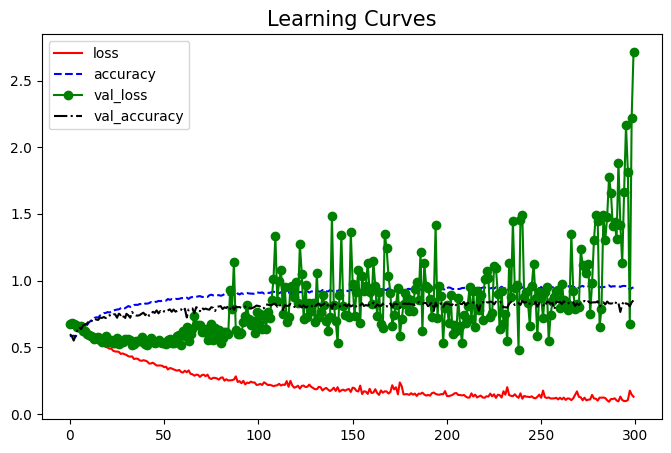

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(1))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


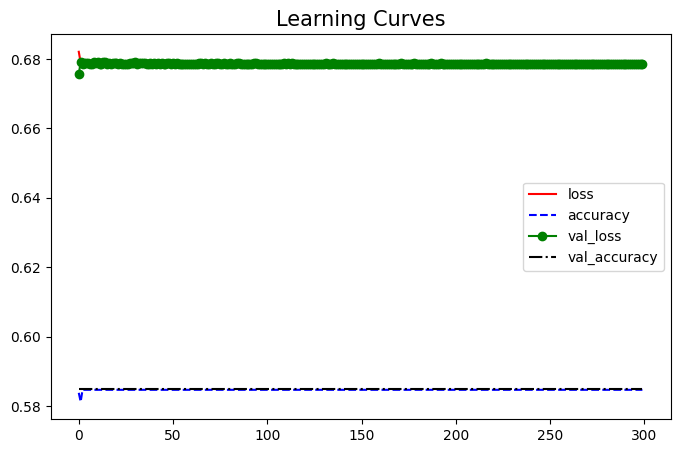

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


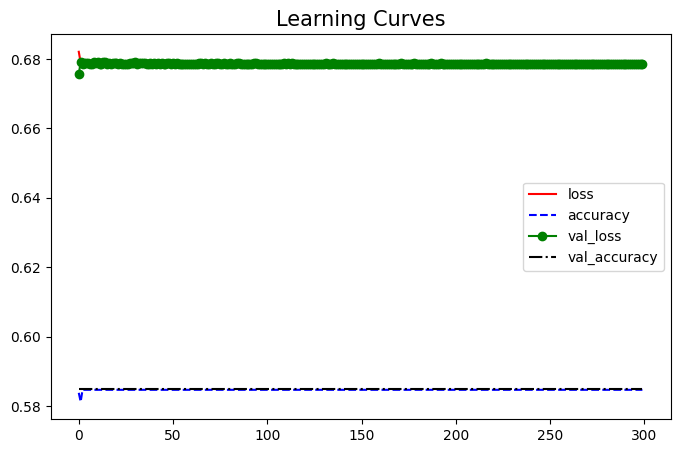

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


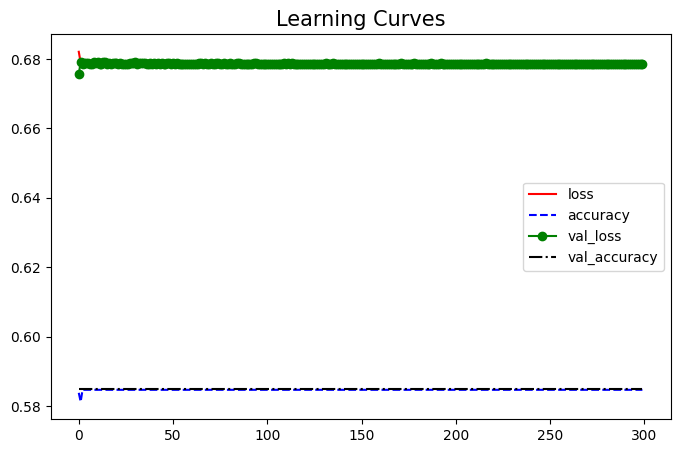

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


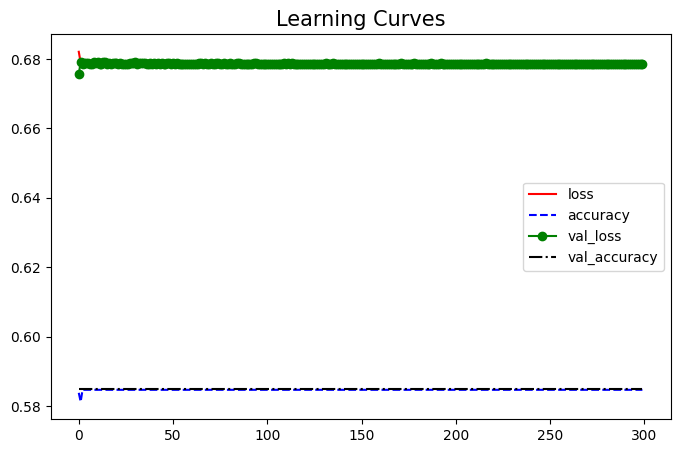

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


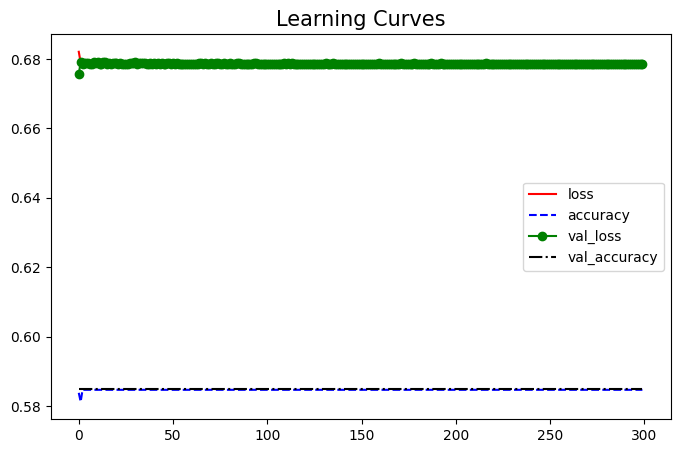

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


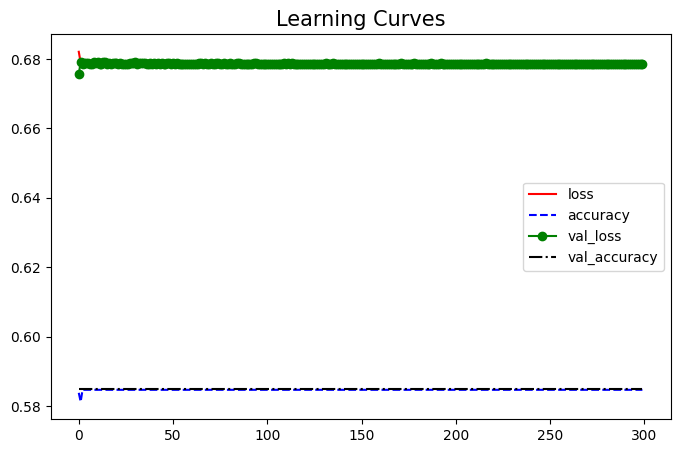

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


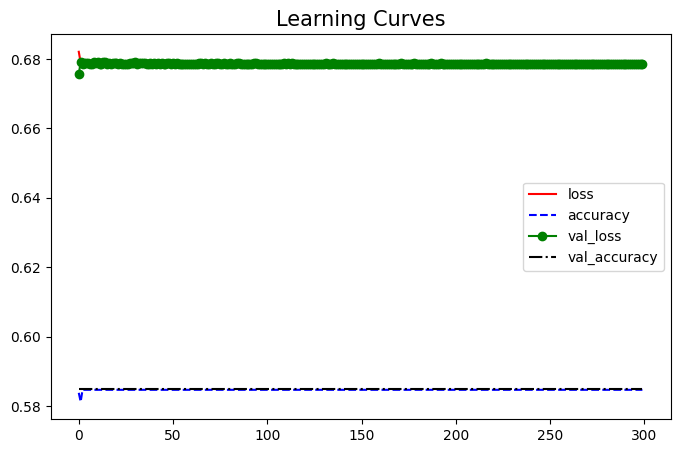

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


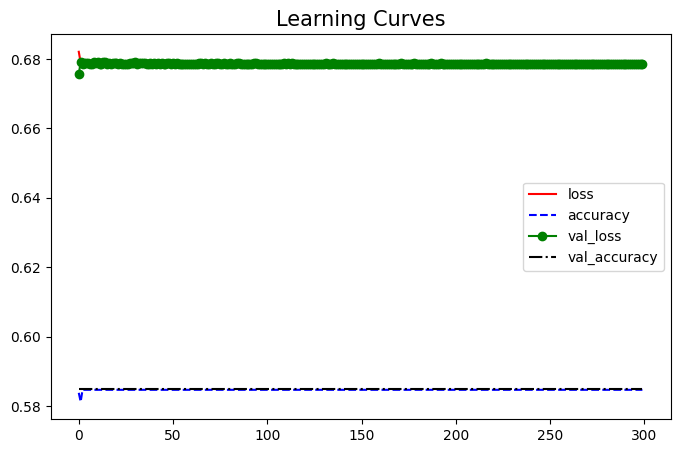

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


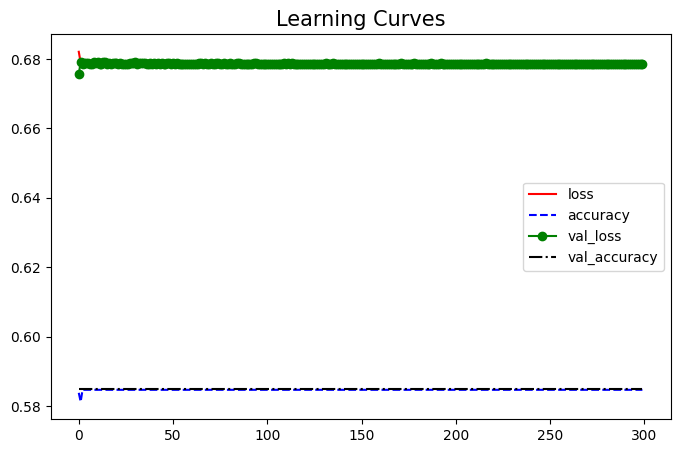

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


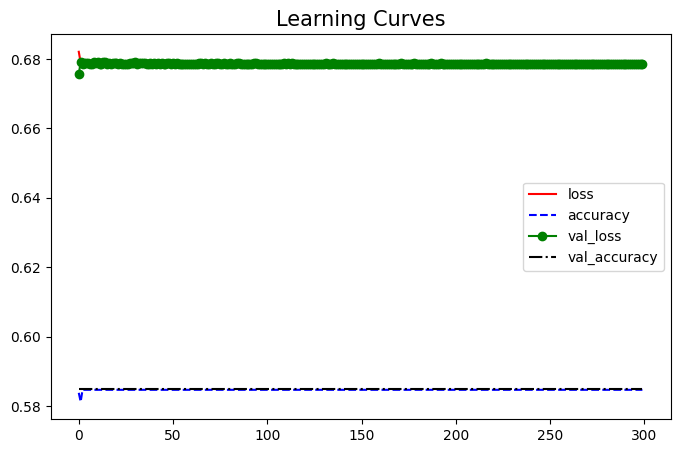

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(2))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


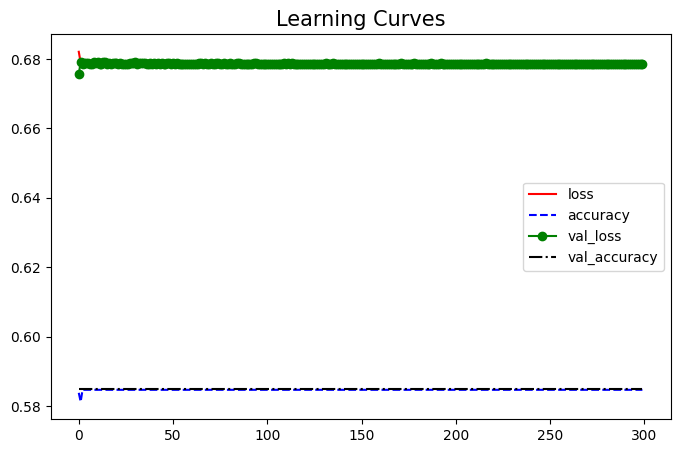

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 3-D AE (4 Layers)

#### 12 layer decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_26 (Dense)            (None, 60)                4560      
                                                                 
 dense_27 (Dense)            (None, 30)                1830      
                                                                 
 dense_28 (Dense)            (None, 15)                465       
                                                                 
 dense_29 (Dense)            (None, 3)                 48        
                                                                 
 dense_30 (Dense)            (None, 10)                40        
                                                                 
 dense_31 (Dense)            (None, 20)                220       
                                                                 
 dense_32 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 11s 20ms/step - loss: 0.6785 - accuracy: 0.5784 - val_loss: 0.6770 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6728 - accuracy: 0.5852 - val_loss: 0.6596 - val_accuracy: 0.6376
Epoch 3/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6798 - accuracy: 0.5801 - val_loss: 0.6559 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6727 - accuracy: 0.5832 - val_loss: 0.6766 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6702 - accuracy: 0.5801 - val_loss: 0.6599 - val_accuracy: 0.5860
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6780 - accuracy: 0.5847 - val_loss: 0.6790 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6761 - accuracy: 0.5850 - val_loss: 0.6618 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 6ms/step
The accuracy on testing dataset:  0.810091743119266


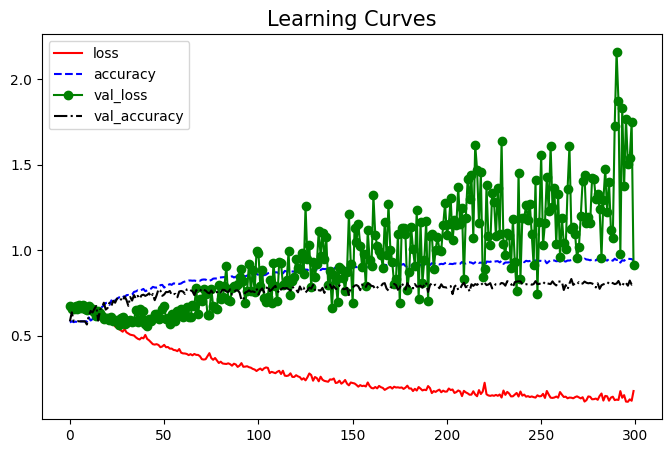

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


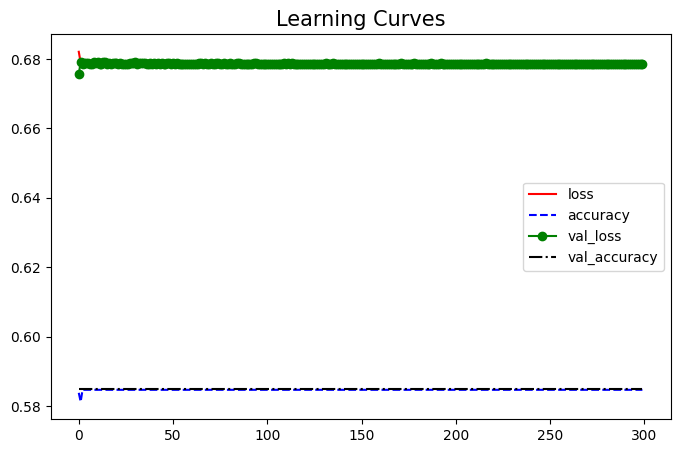

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


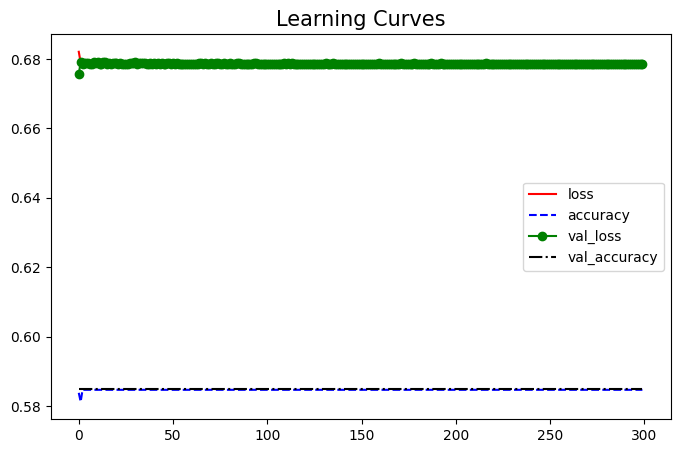

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


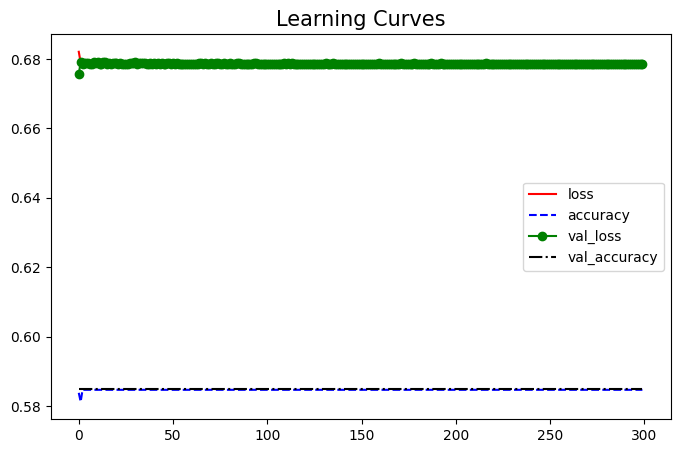

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


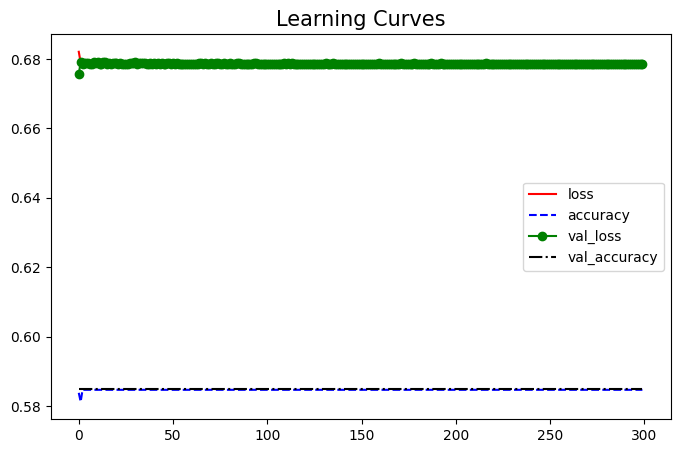

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


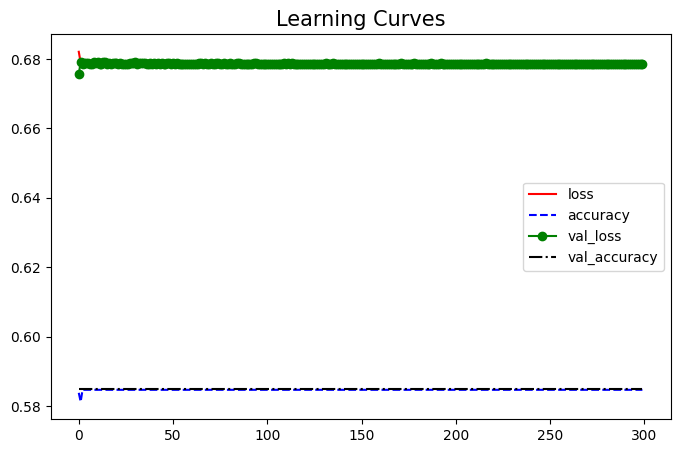

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


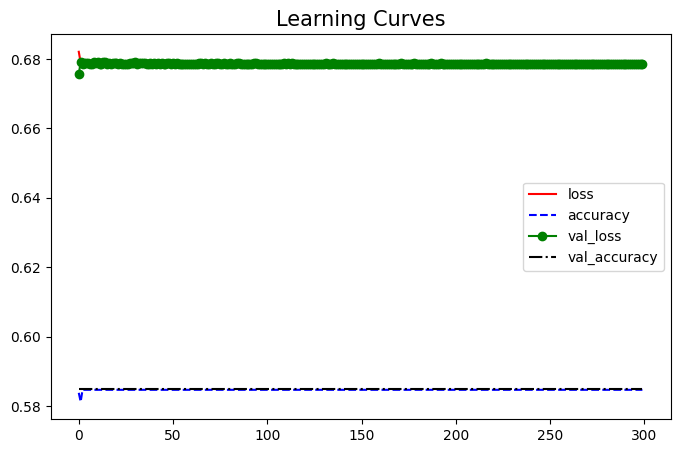

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


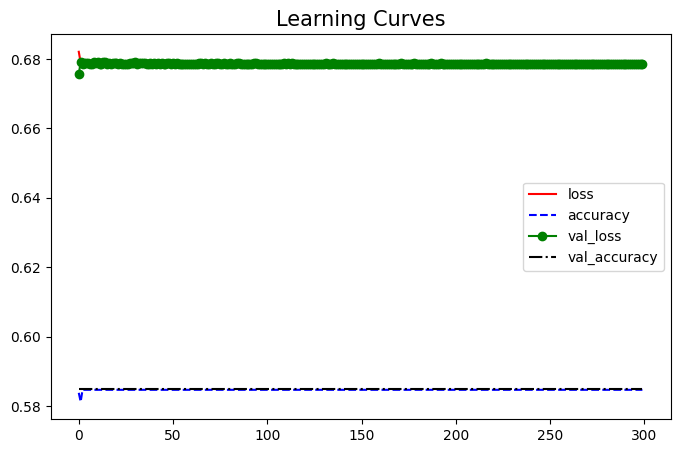

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


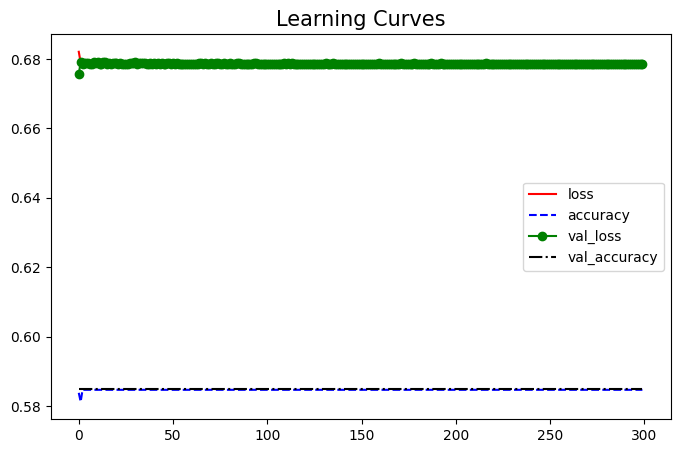

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


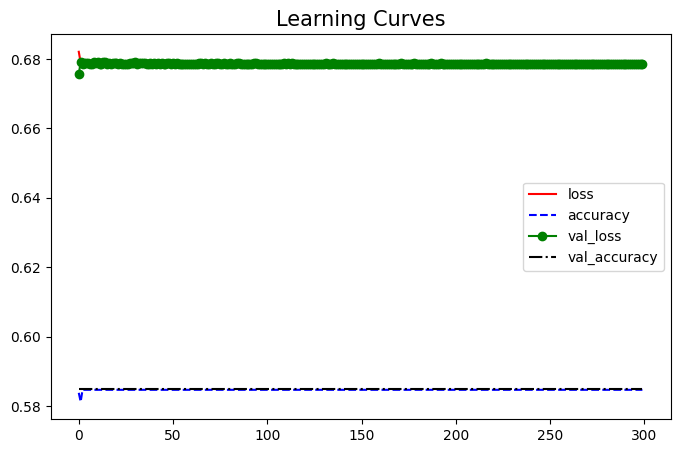

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(3))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


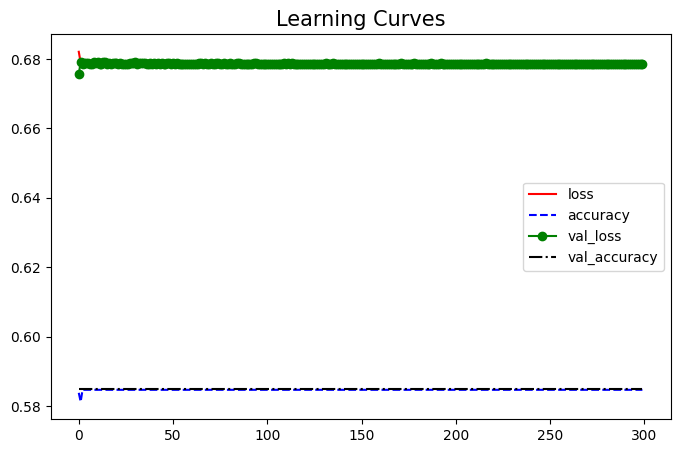

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 5-D AE (4 Layers)

#### 12 Layer Decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_41 (Dense)            (None, 60)                4560      
                                                                 
 dense_42 (Dense)            (None, 30)                1830      
                                                                 
 dense_43 (Dense)            (None, 15)                465       
                                                                 
 dense_44 (Dense)            (None, 5)                 80        
                                                                 
 dense_45 (Dense)            (None, 10)                60        
                                                                 
 dense_46 (Dense)            (None, 20)                220       
                                                                 
 dense_47 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 12s 20ms/step - loss: 0.6822 - accuracy: 0.5844 - val_loss: 0.6699 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6773 - accuracy: 0.5847 - val_loss: 0.6691 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 17ms/step - loss: 0.6768 - accuracy: 0.5847 - val_loss: 0.6643 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 8s 22ms/step - loss: 0.6709 - accuracy: 0.5847 - val_loss: 0.6599 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6655 - accuracy: 0.5847 - val_loss: 0.6568 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 20ms/step - loss: 0.6645 - accuracy: 0.5847 - val_loss: 0.6573 - val_accuracy: 0.6411
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6481 - accuracy: 0.6332 - val_loss: 0.6297 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8412844036697248


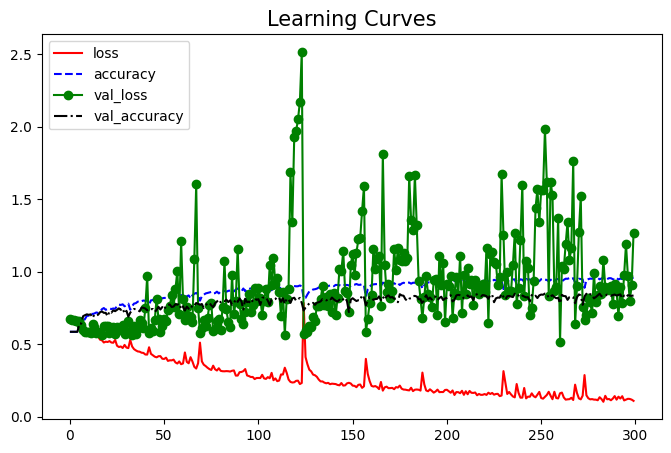

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


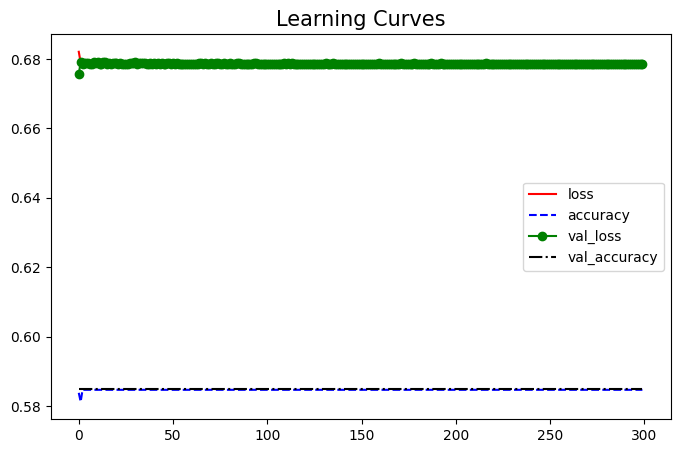

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


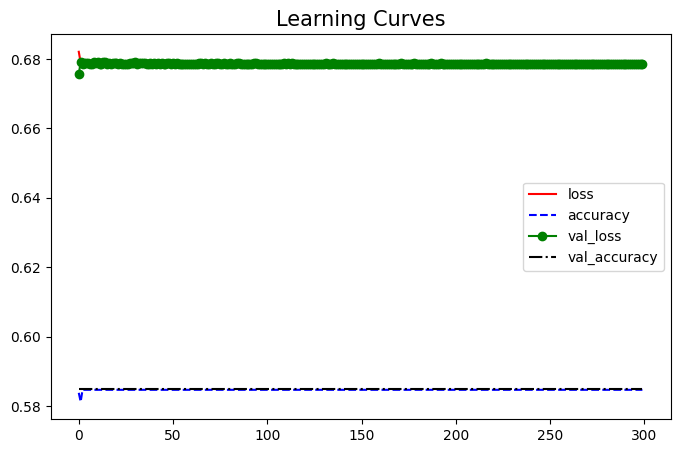

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


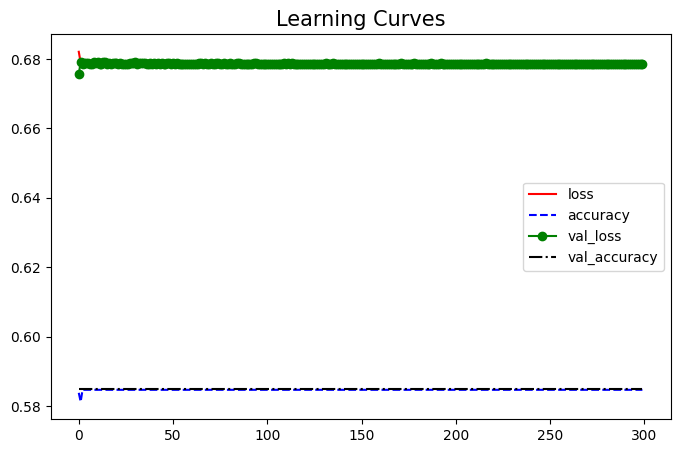

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


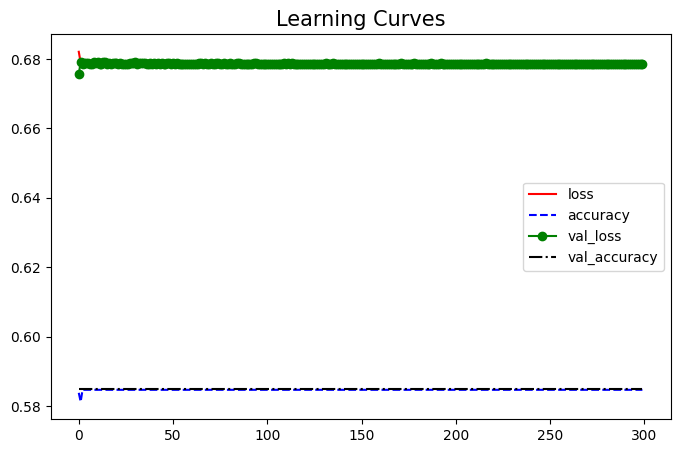

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


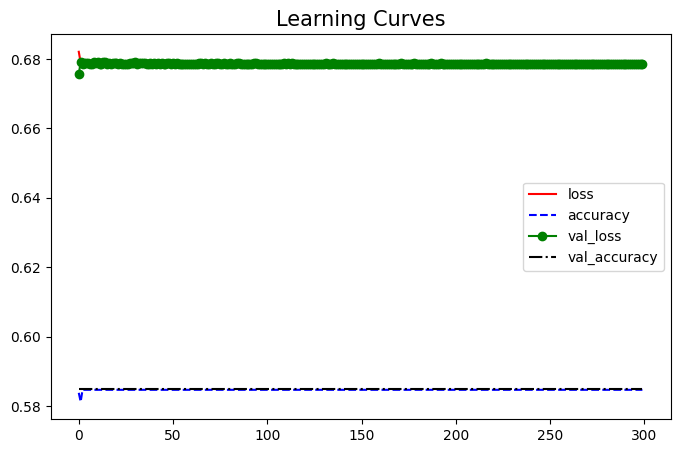

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


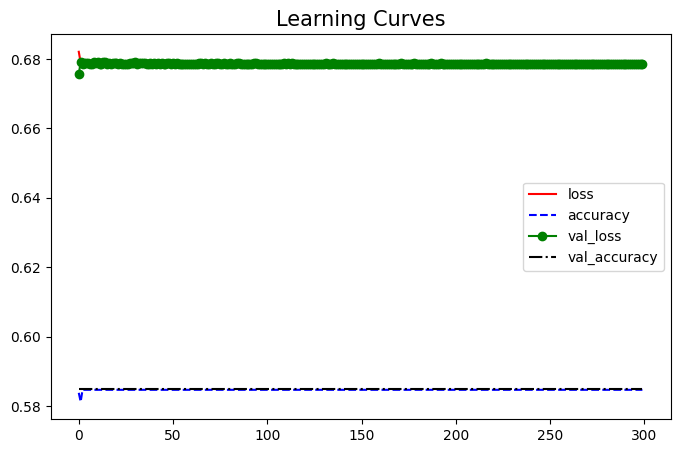

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


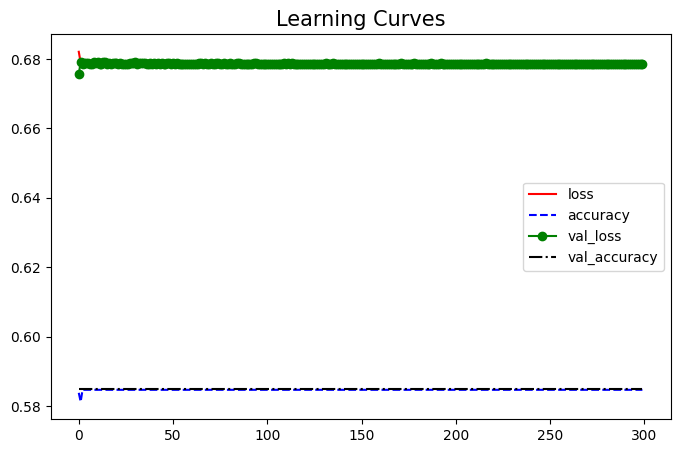

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


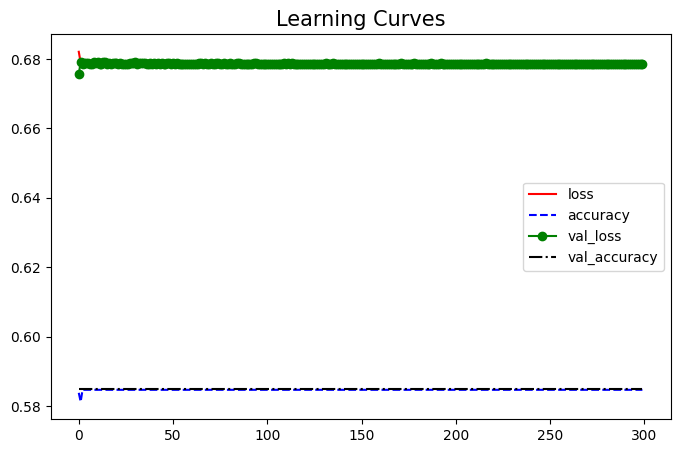

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


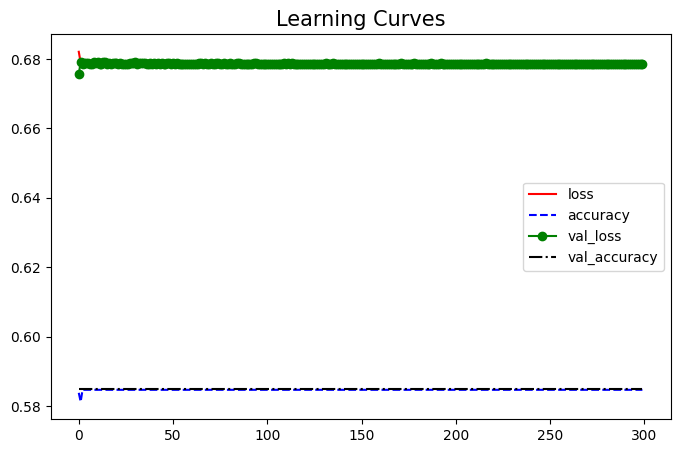

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(5))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


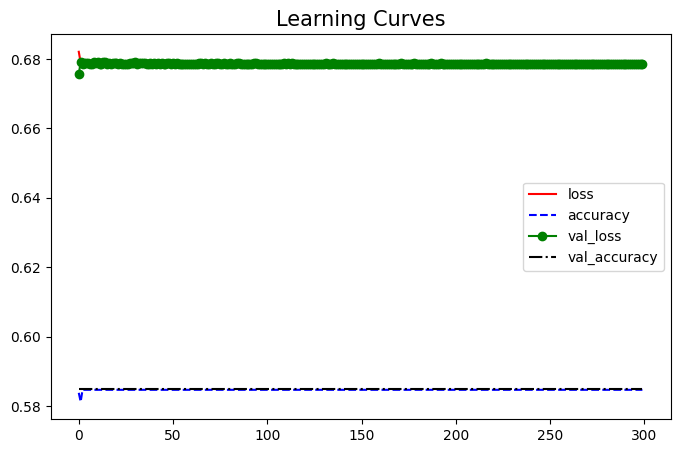

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 10-D AE (4 Layers)

#### 12 layer decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_56 (Dense)            (None, 60)                4560      
                                                                 
 dense_57 (Dense)            (None, 30)                1830      
                                                                 
 dense_58 (Dense)            (None, 15)                465       
                                                                 
 dense_59 (Dense)            (None, 10)                160       
                                                                 
 dense_60 (Dense)            (None, 10)                110       
                                                                 
 dense_61 (Dense)            (None, 20)                220       
                                                                 
 dense_62 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 7s 14ms/step - loss: 0.6793 - accuracy: 0.5824 - val_loss: 0.6741 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 3s 10ms/step - loss: 0.6722 - accuracy: 0.5832 - val_loss: 0.6594 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 3s 9ms/step - loss: 0.6715 - accuracy: 0.5933 - val_loss: 0.6529 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 3s 9ms/step - loss: 0.6648 - accuracy: 0.5847 - val_loss: 0.6489 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 5s 14ms/step - loss: 0.6617 - accuracy: 0.5927 - val_loss: 0.6486 - val_accuracy: 0.6021
Epoch 6/300
349/349 [==============================] - 4s 10ms/step - loss: 0.6743 - accuracy: 0.5852 - val_loss: 0.6699 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 3s 10ms/step - loss: 0.6645 - accuracy: 0.5847 - val_loss: 0.6547 - val_accuracy: 0

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8321100917431192


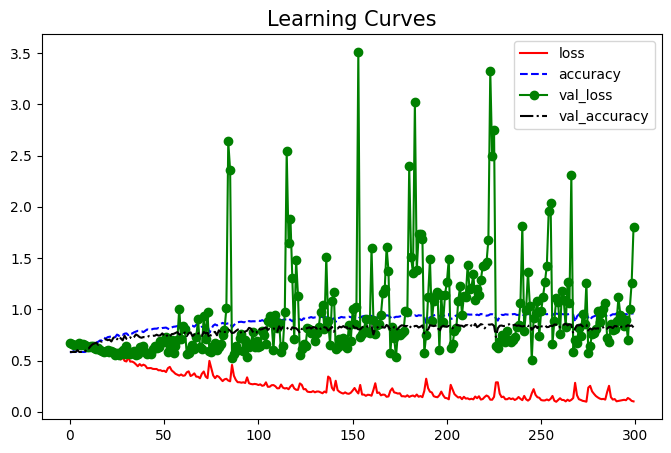

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


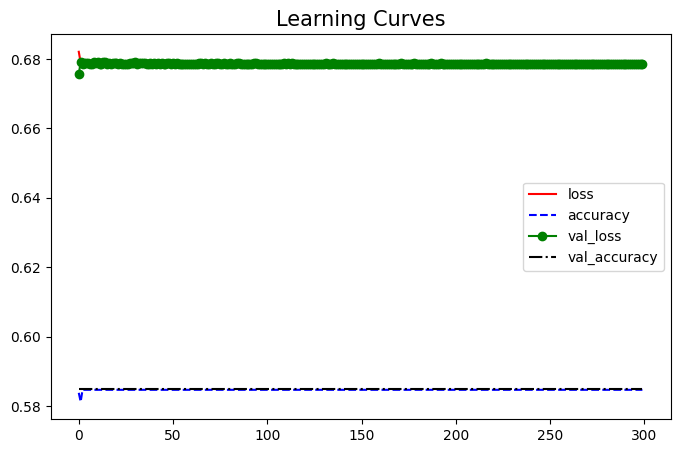

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


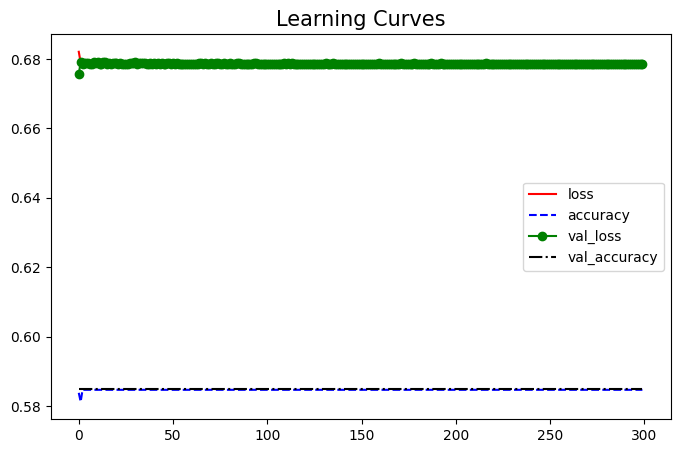

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


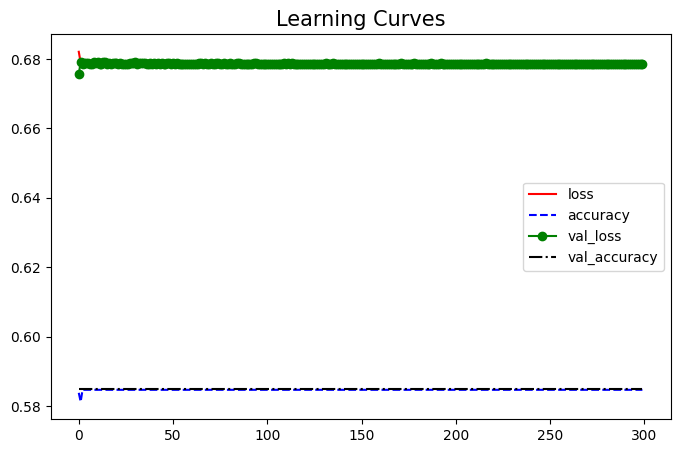

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


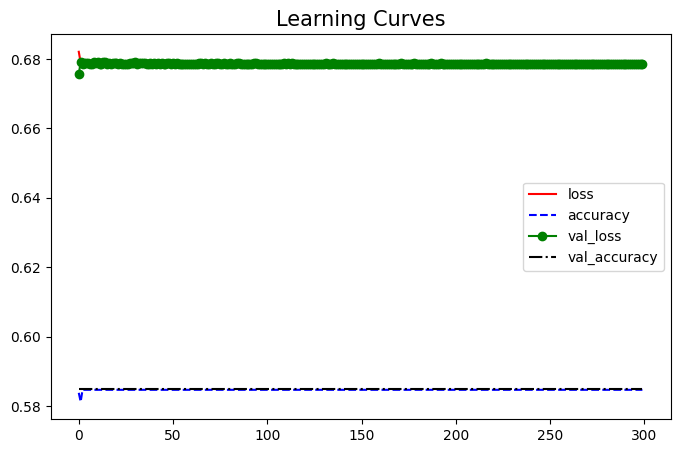

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


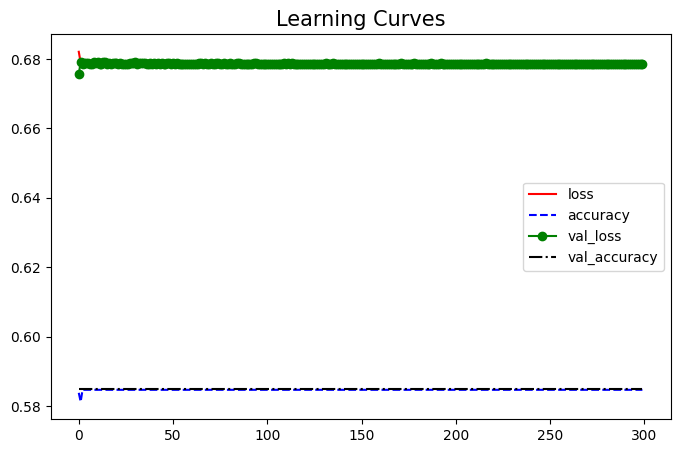

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


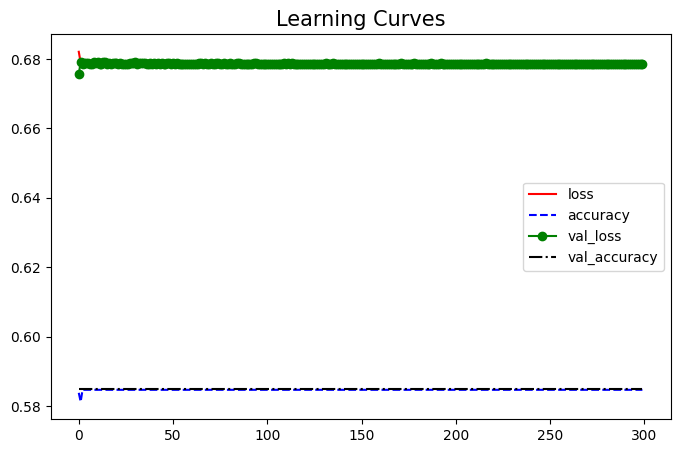

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


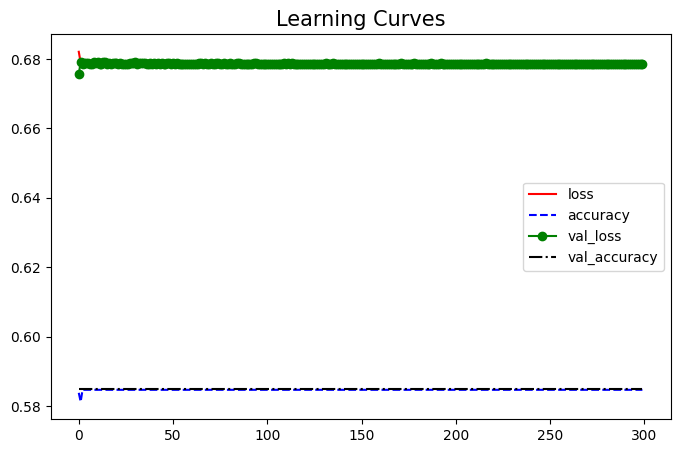

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


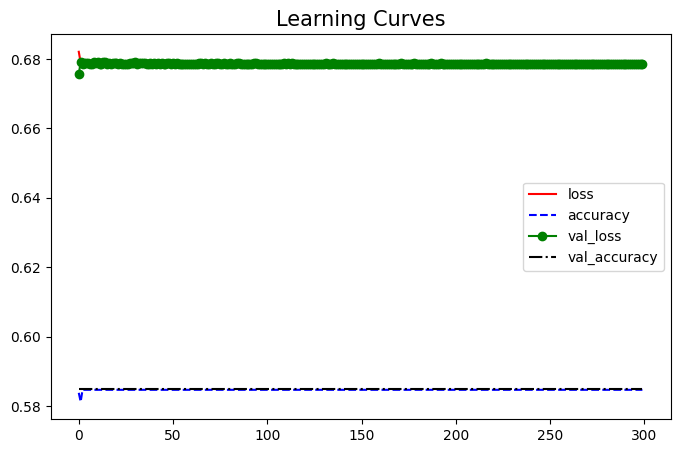

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


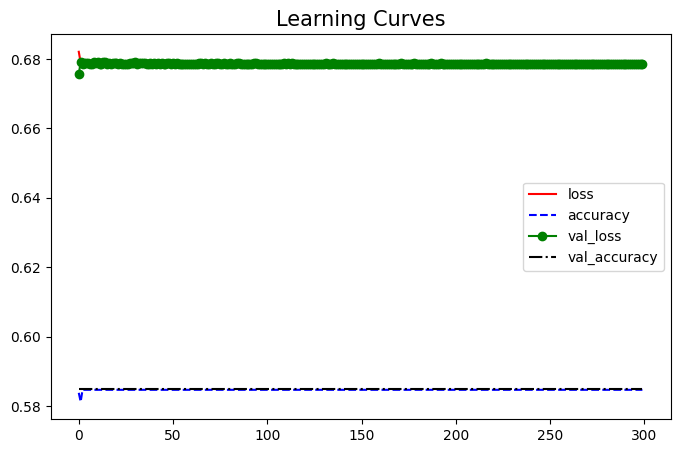

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(15,activation='tanh'))
model5d.add(Dense(10))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


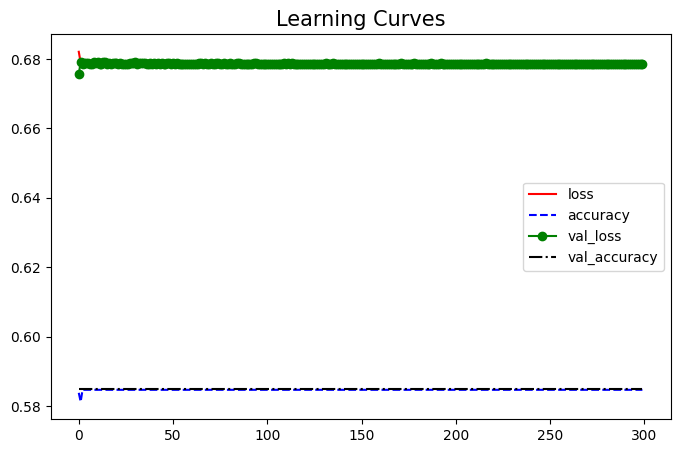

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

### 15-D AE (4 Layers)

#### 12 layer decoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))


model5d.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_71 (Dense)            (None, 60)                4560      
                                                                 
 dense_72 (Dense)            (None, 30)                1830      
                                                                 
 dense_73 (Dense)            (None, 20)                620       
                                                                 
 dense_74 (Dense)            (None, 15)                315       
                                                                 
 dense_75 (Dense)            (None, 10)                160       
                                                                 
 dense_76 (Dense)            (None, 20)                220       
                                                                 
 dense_77 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 8s 15ms/step - loss: 0.6797 - accuracy: 0.5838 - val_loss: 0.6666 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 3s 9ms/step - loss: 0.6729 - accuracy: 0.5881 - val_loss: 0.6690 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 3s 10ms/step - loss: 0.6666 - accuracy: 0.5993 - val_loss: 0.6733 - val_accuracy: 0.6227
Epoch 4/300
349/349 [==============================] - 4s 10ms/step - loss: 0.6645 - accuracy: 0.6019 - val_loss: 0.6616 - val_accuracy: 0.6170
Epoch 5/300
349/349 [==============================] - 5s 14ms/step - loss: 0.6546 - accuracy: 0.6237 - val_loss: 0.6422 - val_accuracy: 0.6468
Epoch 6/300
349/349 [==============================] - 3s 9ms/step - loss: 0.6454 - accuracy: 0.6470 - val_loss: 0.6479 - val_accuracy: 0.6330
Epoch 7/300
349/349 [==============================] - 3s 9ms/step - loss: 0.6515 - accuracy: 0.6217 - val_loss: 0.6711 - val_accuracy: 0.

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 0s 3ms/step
The accuracy on testing dataset:  0.8174311926605504


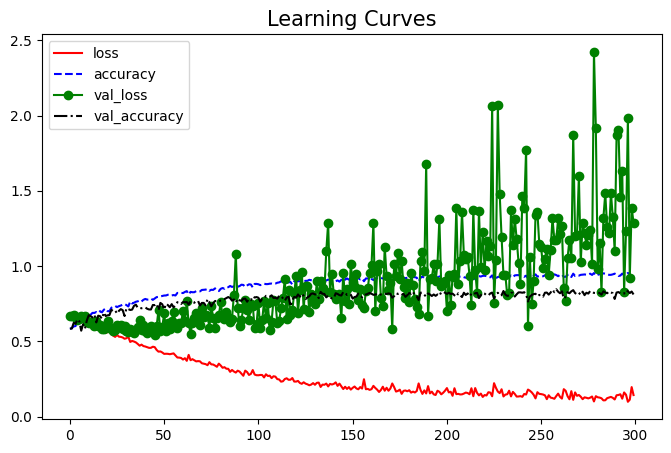

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 11 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


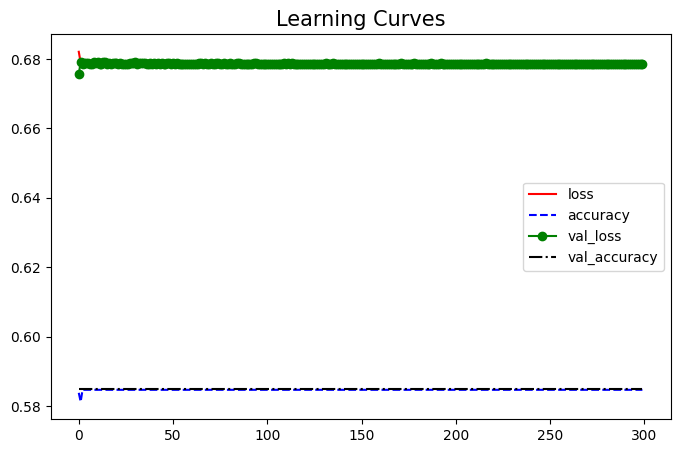

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 10 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


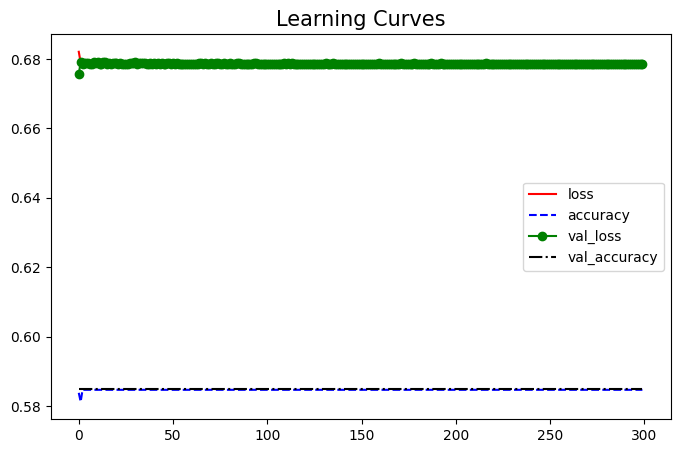

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 9 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


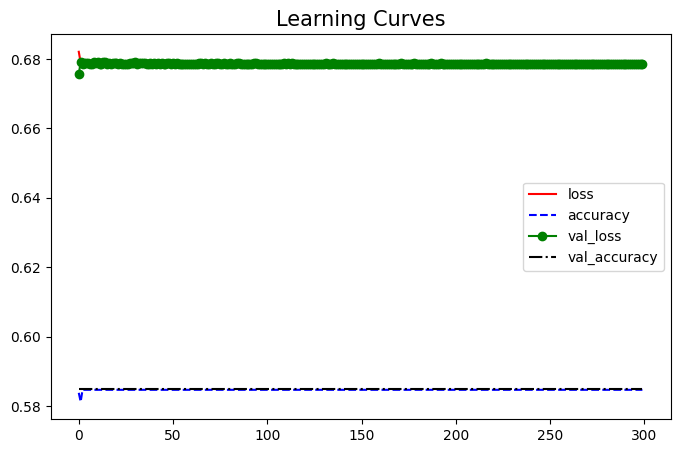

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 8 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


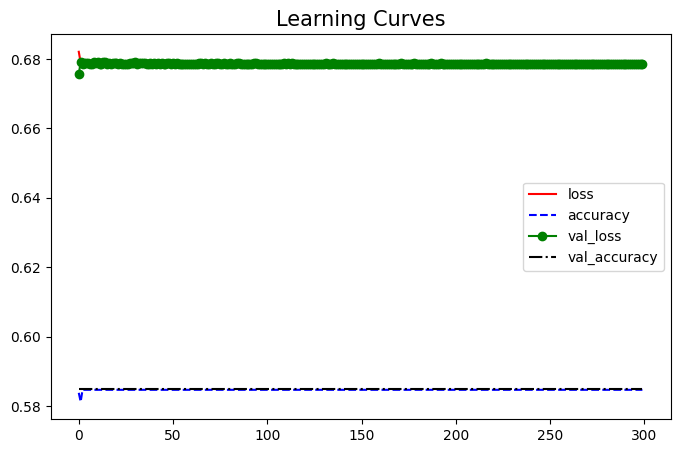

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 7 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


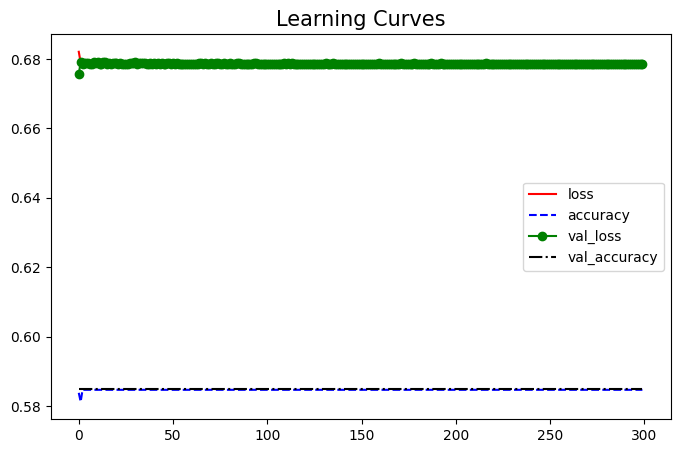

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 6 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


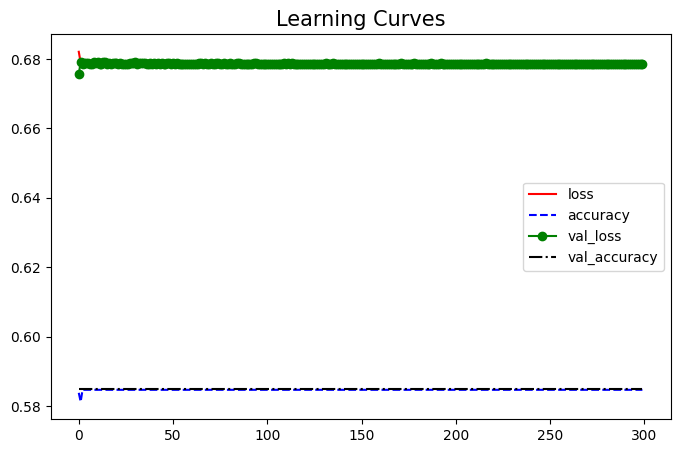

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 5 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


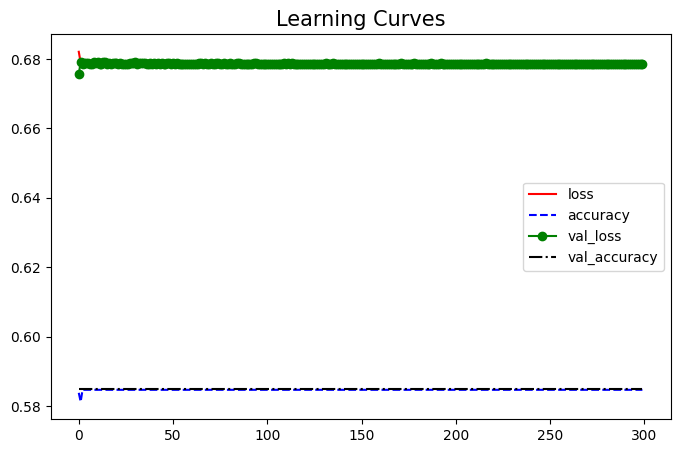

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 4 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


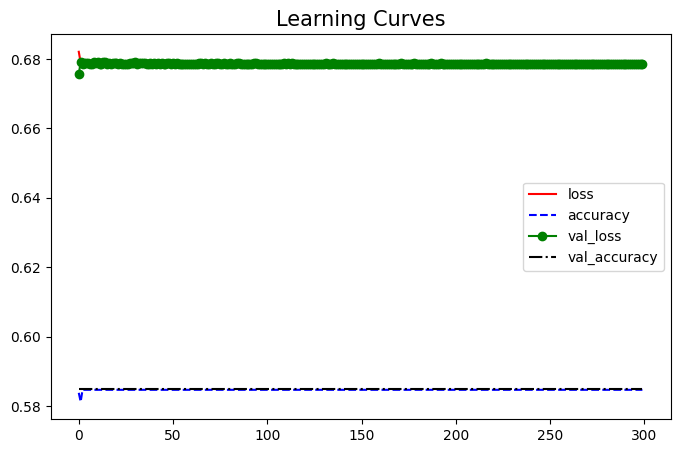

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 3 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


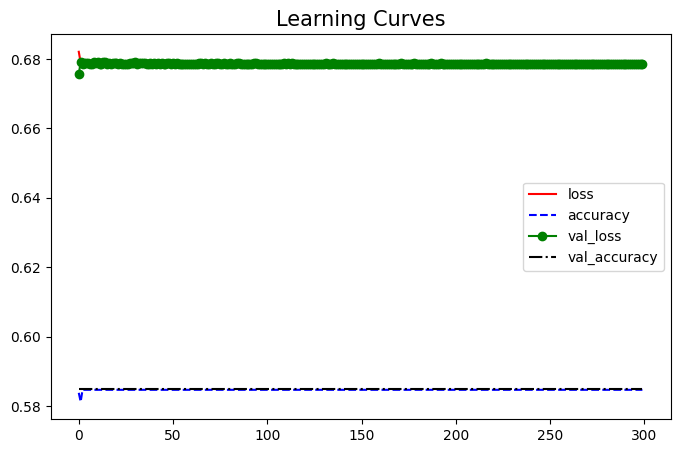

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);

#### 2 layer Encoder

In [ ]:
model5d = Sequential()
#model5d.add(Dense(225,input_dim = 75, activation='relu'))
model5d.add(Dense(60,input_dim=75, activation='tanh'))
model5d.add(Dense(30,activation='tanh'))
model5d.add(Dense(20,activation='tanh'))
model5d.add(Dense(15))
#model5d.add(Dense(10,activation='relu'))
#model5d.add(Dense(20,activation='relu'))
#model5d.add(Dense(40,activation='relu'))
#model5d.add(Dense(75,activation='relu'))
#model5d.add(Dense(225, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(400, activation='relu'))
#model5d.add(Dense(200, activation='relu'))
#model5d.add(Dense(100, activation='relu'))
#model5d.add(Dense(50, activation='relu'))
model5d.add(Dense(1, activation='sigmoid'))

model5d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 60)                4560      
                                                                 
 dense_12 (Dense)            (None, 30)                1830      
                                                                 
 dense_13 (Dense)            (None, 15)                465       
                                                                 
 dense_14 (Dense)            (None, 1)                 16        
                                                                 
 dense_15 (Dense)            (None, 10)                20        
                                                                 
 dense_16 (Dense)            (None, 20)                220       
                                                                 
 dense_17 (Dense)            (None, 40)               

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
model5d.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
trained_model = model5d.fit(train_data, train_label, batch_size = 10, epochs = 300, validation_data=(val_data, val_label))

Epoch 1/300
349/349 [==============================] - 13s 20ms/step - loss: 0.6821 - accuracy: 0.5838 - val_loss: 0.6757 - val_accuracy: 0.5849
Epoch 2/300
349/349 [==============================] - 5s 15ms/step - loss: 0.6790 - accuracy: 0.5812 - val_loss: 0.6792 - val_accuracy: 0.5849
Epoch 3/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6798 - accuracy: 0.5847 - val_loss: 0.6785 - val_accuracy: 0.5849
Epoch 4/300
349/349 [==============================] - 6s 18ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 5/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6792 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 6/300
349/349 [==============================] - 7s 19ms/step - loss: 0.6794 - accuracy: 0.5847 - val_loss: 0.6789 - val_accuracy: 0.5849
Epoch 7/300
349/349 [==============================] - 6s 16ms/step - loss: 0.6795 - accuracy: 0.5847 - val_loss: 0.6787 - val_accuracy

In [ ]:
from sklearn.metrics import accuracy_score

predict = model5d.predict(test_data)
predict = (predict > 0.5).astype(float)
print("The accuracy on testing dataset: ", accuracy_score(predict,test_label))

35/35 [==============================] - 1s 10ms/step
The accuracy on testing dataset:  0.5935779816513761


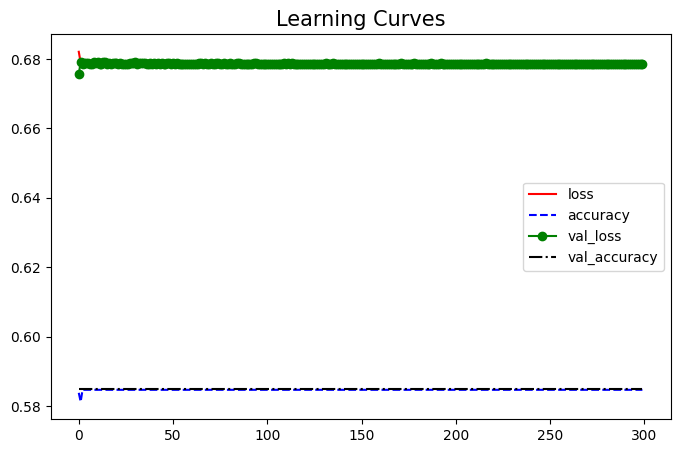

In [ ]:
import matplotlib.pyplot as plt
key_names = list(trained_model.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(trained_model.history[key_names[i]], colors[i], label=key_names[i])
plt.legend()
plt.title('Learning Curves', size=15);